## NLP Class Final Project Read Data

In [2]:
import pandas as pd
import numpy as np

In [3]:
import re
import string

In [4]:
pip install nltk

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [5]:
import nltk
from nltk.corpus import stopwords

In [6]:
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to C:\Users\Jason
[nltk_data]     Sjafrudin\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [2]:
%%time

df_news_final_project = pd.read_parquet('https://storage.googleapis.com/msca-bdp-data-open/news_final_project/news_final_project.parquet', engine='pyarrow')
df_news_final_project.shape

CPU times: total: 9.86 s
Wall time: 54.5 s


(200435, 5)

In [6]:
df_news_final_project = pd.read_parquet('C:/Users/Jason Sjafrudin/Desktop/NLP Class/news_final_project.parquet', engine='pyarrow')
df_news_final_project.shape

(200435, 5)

In [7]:
df_news_final_project

,url,date,language,title,text
0,http://galusaustralis.com/2020/02/486473/legal...,2020-02-26,en,LegalTech Artificial Intelligence Market 2019 ...,LegalTech Artificial Intelligence Market 2019 ...
1,http://newsparliament.com/2020/02/27/children-...,2020-02-27,en,Children With Autism Saw Their Learning and So...,\nChildren With Autism Saw Their Learning and ...
2,http://www.agoravox.it/Covid-19-un-messaggio-d...,2020-03-13,en,Covid-19: un messaggio dai ricercatori italian...,\n\n\nCovid-19: un messaggio dai ricercatori i...
3,http://www.desototimes.com/news/child-actor-cl...,2022-06-09,en,Child actor Claude Jarman Jr. looks back on hi...,\nChild actor Claude Jarman Jr. looks back on ...
4,http://www.millenniumpost.in/big-stories/ai-ex...,2020-08-07,en,Two dead as AI Express flight skids off Kozhik...,Two dead as AI Express flight skids off Kozhik...
...,...,...,...,...,...
200430,https://www.zdnet.com/article/google-cloud-exp...,2023-08-29,en,Google Cloud expands developer tools and data ...,\n\n\nGoogle Cloud expands developer tools and...
200431,https://yen.com.gh/business-economy/231589-twi...,2023-04-12,en,Twitter working on AI despite Musk call for gl...,\n\nTwitter working on AI despite Musk call fo...
200432,https://zeenews.india.com/companies/one-ai-kil...,2022-12-31,en,'One AI Killer app will emerge...': Nothing fo...,'One AI Killer app will emerge...': Nothing fo...
200433,https://zeenews.india.com/technology/openai-re...,2023-04-29,en,OpenAI Restores Access To ChatGPT In Italy Aft...,OpenAI Restores Access To ChatGPT In Italy Aft...


# Clean-up the noise, by eliminating newlines, tabs, remnants of web crawls, and other irrelevant text


In [8]:
# Filter articles for English language only
df_news_final_project_en = df_news_final_project[df_news_final_project['language'] == 'en']


print(f'Filtered sample contains {df_news_final_project_en.shape[0]:,} English articles')

Filtered sample contains 200,435 English articles


In [9]:
# Remove URLs from articles
df_news_final_project_en['text_no_url'] = df_news_final_project_en['text'].apply(lambda x: re.sub(r'(?:@|http?\://|https?\://|www)\S+', '', str(x)))

In [10]:
# Remove newlines from articles
df_news_final_project_en['text_no_newline'] = df_news_final_project_en['text_no_url'].apply(lambda x: re.sub(r'\n', '', str(x)))

In [11]:
# Remove hashtags from articles
df_news_final_project_en['text_no_hashtag'] = df_news_final_project_en['text_no_newline'].apply(lambda x: re.sub(r'#\S+', '', str(x)))

In [12]:
# Remove tabs from articles
df_news_final_project_en['text_no_tab'] = df_news_final_project_en['text_no_hashtag'].apply(lambda x: re.sub(r'\t', '', str(x)))

In [13]:
# Remove HTML Tags (remnants of web crawls 1) from articles
def remove_html_tags(text):
    clean_text = re.sub(r'<[^>]*>', '', text)
    return clean_text

df_news_final_project_en['text_html_tags'] = df_news_final_project_en['text_no_tab'].apply(remove_html_tags)

In [14]:
# Remove Script Content (remnants of web crawls 1) from articles

def remove_script_content(text):
    clean_text = re.sub(r'<script[^>]*>.*?</script>', '', text, flags=re.DOTALL)
    return clean_text

df_news_final_project_en['text_no_script_content'] = df_news_final_project_en['text_html_tags'].apply(remove_script_content)

In [15]:
#Remove extra white space
def remove_extra_whitespace(text):
    # Use regex to replace multiple whitespace characters with a single space
    cleaned_text = re.sub(r'\s+', ' ', text)
    return cleaned_text.strip()  # Remove leading and trailing whitespace


df_news_final_project_en['text_clean'] = df_news_final_project_en['text_no_script_content'].apply(remove_extra_whitespace)


In [16]:
df_news_final_project_extract = df_news_final_project_en[['url', 'date', 'title', 'text_clean']]

In [17]:
df_news_final_project_extract.to_csv('output_file.csv', index=False)

In [ ]:
df_news_final_project = pd.read_csv('C:/Users/Jason Sjafrudin/Desktop/NLP Class/output_file.csv')
df_news_final_project.shape

In [ ]:
df_news_final_project

In [ ]:
#Additional cleaning outside of NER Spacy

In [ ]:
#Remove punctuation and numbers
def remove_punctuation_and_numbers(text):
    text = ''.join([char for char in text if char not in string.punctuation])
    text = re.sub(r'\d+', '', text)  # Remove numbers
    return text

df_news_final_project['text_clean_2'] = df_news_final_project['text_clean'].apply(remove_punctuation_and_numbers)

In [ ]:
#Lowercase text
df_news_final_project['text_clean_2'] = df_news_final_project['text_clean_2'].str.lower()

In [11]:
stop_words = set(stopwords.words('english'))

# Remove stopwords
def remove_stopwords(text):
    words = text.split()  # Split the text into words
    filtered_words = [word for word in words if word.lower() not in stop_words]  # Remove stopwords
    return ' '.join(filtered_words)  # Join the words back into a sentence

# Apply the remove_stopwords function to the 'text_clean' column
df_news_final_project['text_clean_2'] = df_news_final_project['text_clean_2'].apply(remove_stopwords)


In [12]:
# Remove special characters
df_news_final_project['text_clean_2'] = df_news_final_project['text_clean_2'].map(lambda x: re.sub('[^a-zA-Z0-9 @ . , : - _]', '', str(x)))

In [13]:
df_news_final_project.to_csv('output_file.csv', index=False)

In [7]:
df_news_final_project = pd.read_csv('C:/Users/Jason Sjafrudin/Desktop/NLP Class/output_file.csv')
df_news_final_project.shape

(200435, 5)

In [8]:
df_news_final_project['text_clean'] = df_news_final_project['text_clean'].map(lambda x: re.sub('[^a-zA-Z0-9 @ . , : - _]', '', str(x)))

In [9]:
df_news_final_project

,url,date,title,text_clean,text_clean_2
0,http://galusaustralis.com/2020/02/486473/legal...,2020-02-26,LegalTech Artificial Intelligence Market 2019 ...,LegalTech Artificial Intelligence Market 2019 ...,legaltech artificial intelligence market techn...
1,http://newsparliament.com/2020/02/27/children-...,2020-02-27,Children With Autism Saw Their Learning and So...,Children With Autism Saw Their Learning and So...,children autism saw learning social skills boo...
2,http://www.agoravox.it/Covid-19-un-messaggio-d...,2020-03-13,Covid-19: un messaggio dai ricercatori italian...,Covid19: un messaggio dai ricercatori italiani...,covid un messaggio dai ricercatori italiani ai...
3,http://www.desototimes.com/news/child-actor-cl...,2022-06-09,Child actor Claude Jarman Jr. looks back on hi...,Child actor Claude Jarman Jr. looks back on hi...,child actor claude jarman jr looks back movie ...
4,http://www.millenniumpost.in/big-stories/ai-ex...,2020-08-07,Two dead as AI Express flight skids off Kozhik...,Two dead as AI Express flight skids off Kozhik...,two dead ai express flight skids kozhikode air...
...,...,...,...,...,...
200430,https://www.zdnet.com/article/google-cloud-exp...,2023-08-29,Google Cloud expands developer tools and data ...,Google Cloud expands developer tools and data ...,google cloud expands developer tools data anal...
200431,https://yen.com.gh/business-economy/231589-twi...,2023-04-12,Twitter working on AI despite Musk call for gl...,Twitter working on AI despite Musk call for gl...,twitter working ai despite musk call global pa...
200432,https://zeenews.india.com/companies/one-ai-kil...,2022-12-31,'One AI Killer app will emerge...': Nothing fo...,One AI Killer app will emerge...: Nothing foun...,one ai killer app emerge nothing founder carl ...
200433,https://zeenews.india.com/technology/openai-re...,2023-04-29,OpenAI Restores Access To ChatGPT In Italy Aft...,OpenAI Restores Access To ChatGPT In Italy Aft...,openai restores access chatgpt italy ban techn...


# Filter topic by keywords first (based on text)- 1% of content needs to be these keywords

In [10]:
# Define the words you want to search for
keywords = ['chatgpt', 'openai', 'machine', 'generative', 'data science', 'artificial intelligence', ' ai ', 'forecast']
# Use str.contains() with the '|' operator to search for any of the specified keywords
contains_title = df_news_final_project['text_clean'].str.contains('|'.join(keywords), case=False).sum()

In [10]:
keywords = ['chatgpt', 'openai', 'machine', 'generative', 'data science', 'artificial intelligence', ' ai ', 'forecast', 'conversational ai', 'image generation', 'algorithm']

In [11]:
contains_title

196105

In [12]:
mask = df_news_final_project['text_clean'].str.contains('|'.join(keywords), case=False)

In [13]:
df_news_final_project = df_news_final_project[mask]

In [14]:
df_news_final_project.info()

<class 'pandas.core.frame.DataFrame'>
Index: 196173 entries, 0 to 200434
Data columns (total 5 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   url           196173 non-null  object
 1   date          196173 non-null  object
 2   title         196173 non-null  object
 3   text_clean    196173 non-null  object
 4   text_clean_2  196173 non-null  object
dtypes: object(5)
memory usage: 9.0+ MB


In [15]:
df_news_final_project.loc[:, 'ID'] = df_news_final_project.index


C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_19800\2382617833.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_news_final_project.loc[:, 'ID'] = df_news_final_project.index


In [16]:
df_news_final_project

,url,date,title,text_clean,text_clean_2,ID
0,http://galusaustralis.com/2020/02/486473/legal...,2020-02-26,LegalTech Artificial Intelligence Market 2019 ...,LegalTech Artificial Intelligence Market 2019 ...,legaltech artificial intelligence market techn...,0
1,http://newsparliament.com/2020/02/27/children-...,2020-02-27,Children With Autism Saw Their Learning and So...,Children With Autism Saw Their Learning and So...,children autism saw learning social skills boo...,1
2,http://www.agoravox.it/Covid-19-un-messaggio-d...,2020-03-13,Covid-19: un messaggio dai ricercatori italian...,Covid19: un messaggio dai ricercatori italiani...,covid un messaggio dai ricercatori italiani ai...,2
4,http://www.millenniumpost.in/big-stories/ai-ex...,2020-08-07,Two dead as AI Express flight skids off Kozhik...,Two dead as AI Express flight skids off Kozhik...,two dead ai express flight skids kozhikode air...,4
5,http://www.nativestew.com/2023/11/ai-took-my-j...,2023-11-20,"Native Stew - Bahamas AI Art, Photos, Videos: ...","Native Stew Bahamas AI Art, Photos, Videos: A...",native stew bahamas ai art photos videos ai to...,5
...,...,...,...,...,...,...
200430,https://www.zdnet.com/article/google-cloud-exp...,2023-08-29,Google Cloud expands developer tools and data ...,Google Cloud expands developer tools and data ...,google cloud expands developer tools data anal...,200430
200431,https://yen.com.gh/business-economy/231589-twi...,2023-04-12,Twitter working on AI despite Musk call for gl...,Twitter working on AI despite Musk call for gl...,twitter working ai despite musk call global pa...,200431
200432,https://zeenews.india.com/companies/one-ai-kil...,2022-12-31,'One AI Killer app will emerge...': Nothing fo...,One AI Killer app will emerge...: Nothing foun...,one ai killer app emerge nothing founder carl ...,200432
200433,https://zeenews.india.com/technology/openai-re...,2023-04-29,OpenAI Restores Access To ChatGPT In Italy Aft...,OpenAI Restores Access To ChatGPT In Italy Aft...,openai restores access chatgpt italy ban techn...,200433


In [12]:
words_to_count = ['chatgpt', 'openai', 'machine', 'generative', 'data science', 'artificial intelligence', ' ai ', 'forecast']

# Create a regular expression pattern to match any of the words in the list
pattern = '|'.join(words_to_count)

# Count occurrences of words and store the counts in a new column 'Healthcare'
df_news_final_project['Key_Words'] = df_news_final_project['text_clean_2'].str.lower().str.count(pattern, flags=re.IGNORECASE)

In [13]:
df_news_final_project['Total_Words'] = df_news_final_project['text_clean_2'].str.split().apply(len)

In [14]:
df_news_final_project['Key_Words_Percentage'] = (df_news_final_project['Key_Words'] / df_news_final_project['Total_Words']) * 100

In [15]:
df_news_final_project[df_news_final_project['Key_Words_Percentage'] > 1]

,url,date,title,text_clean,text_clean_2,Key_Words,Total_Words,Key_Words_Percentage
0,http://galusaustralis.com/2020/02/486473/legal...,2020-02-26,LegalTech Artificial Intelligence Market 2019 ...,LegalTech Artificial Intelligence Market 2019 ...,legaltech artificial intelligence market techn...,28,669,4.185351
4,http://www.millenniumpost.in/big-stories/ai-ex...,2020-08-07,Two dead as AI Express flight skids off Kozhik...,Two dead as AI Express flight skids off Kozhik...,two dead ai express flight skids kozhikode air...,4,165,2.424242
5,http://www.nativestew.com/2023/11/ai-took-my-j...,2023-11-20,"Native Stew - Bahamas AI Art, Photos, Videos: ...","Native Stew Bahamas AI Art, Photos, Videos: A...",native stew bahamas ai art photos videos ai to...,6,149,4.026846
8,http://www.sbwire.com/press-releases/healthcar...,2022-10-06,Healthcare Artificial Intelligence Market Anal...,Healthcare Artificial Intelligence Market Anal...,healthcare artificial intelligence market anal...,22,552,3.985507
9,https://3wnews.org/industry/704499/artificial-...,2020-04-29,Artificial Intelligence As A Service Market : ...,Artificial Intelligence As A Service Market : ...,artificial intelligence service market opportu...,29,634,4.574132
...,...,...,...,...,...,...,...,...
200430,https://www.zdnet.com/article/google-cloud-exp...,2023-08-29,Google Cloud expands developer tools and data ...,Google Cloud expands developer tools and data ...,google cloud expands developer tools data anal...,55,1844,2.982646
200431,https://yen.com.gh/business-economy/231589-twi...,2023-04-12,Twitter working on AI despite Musk call for gl...,Twitter working on AI despite Musk call for gl...,twitter working ai despite musk call global pa...,19,661,2.874433
200432,https://zeenews.india.com/companies/one-ai-kil...,2022-12-31,'One AI Killer app will emerge...': Nothing fo...,One AI Killer app will emerge...: Nothing foun...,one ai killer app emerge nothing founder carl ...,7,553,1.265823
200433,https://zeenews.india.com/technology/openai-re...,2023-04-29,OpenAI Restores Access To ChatGPT In Italy Aft...,OpenAI Restores Access To ChatGPT In Italy Aft...,openai restores access chatgpt italy ban techn...,26,429,6.060606


In [16]:
df_news_final_project

,url,date,title,text_clean,text_clean_2,Key_Words,Total_Words,Key_Words_Percentage
0,http://galusaustralis.com/2020/02/486473/legal...,2020-02-26,LegalTech Artificial Intelligence Market 2019 ...,LegalTech Artificial Intelligence Market 2019 ...,legaltech artificial intelligence market techn...,28,669,4.185351
1,http://newsparliament.com/2020/02/27/children-...,2020-02-27,Children With Autism Saw Their Learning and So...,Children With Autism Saw Their Learning and So...,children autism saw learning social skills boo...,3,903,0.332226
2,http://www.agoravox.it/Covid-19-un-messaggio-d...,2020-03-13,Covid-19: un messaggio dai ricercatori italian...,Covid19: un messaggio dai ricercatori italiani...,covid un messaggio dai ricercatori italiani ai...,6,1358,0.441826
3,http://www.desototimes.com/news/child-actor-cl...,2022-06-09,Child actor Claude Jarman Jr. looks back on hi...,Child actor Claude Jarman Jr. looks back on hi...,child actor claude jarman jr looks back movie ...,0,1469,0.000000
4,http://www.millenniumpost.in/big-stories/ai-ex...,2020-08-07,Two dead as AI Express flight skids off Kozhik...,Two dead as AI Express flight skids off Kozhik...,two dead ai express flight skids kozhikode air...,4,165,2.424242
...,...,...,...,...,...,...,...,...
200430,https://www.zdnet.com/article/google-cloud-exp...,2023-08-29,Google Cloud expands developer tools and data ...,Google Cloud expands developer tools and data ...,google cloud expands developer tools data anal...,55,1844,2.982646
200431,https://yen.com.gh/business-economy/231589-twi...,2023-04-12,Twitter working on AI despite Musk call for gl...,Twitter working on AI despite Musk call for gl...,twitter working ai despite musk call global pa...,19,661,2.874433
200432,https://zeenews.india.com/companies/one-ai-kil...,2022-12-31,'One AI Killer app will emerge...': Nothing fo...,One AI Killer app will emerge...: Nothing foun...,one ai killer app emerge nothing founder carl ...,7,553,1.265823
200433,https://zeenews.india.com/technology/openai-re...,2023-04-29,OpenAI Restores Access To ChatGPT In Italy Aft...,OpenAI Restores Access To ChatGPT In Italy Aft...,openai restores access chatgpt italy ban techn...,26,429,6.060606


In [21]:
import matplotlib.pyplot as plt
import numpy as np


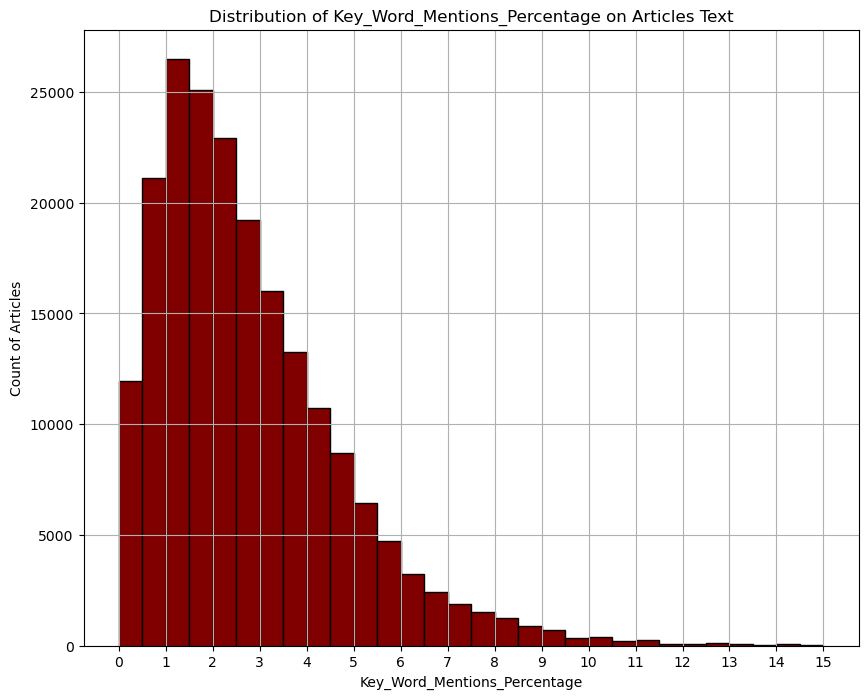

In [49]:

x_min = 0
x_max = 15

# Plot the distribution of Key_Word_Percentage column
plt.figure(figsize=(10, 8))
plt.hist(df_news_final_project['Key_Words_Percentage'], bins=30, range=(x_min, x_max), color='maroon', edgecolor='black')
plt.title('Distribution of Key_Word_Mentions_Percentage on Articles Text')
plt.xlabel('Key_Word_Mentions_Percentage')
plt.ylabel('Count of Articles')
plt.xticks(np.arange(x_min, x_max+1, 1))  # Set x-axis ticks in increments of 1
plt.grid(True)
plt.show()


In [50]:
df_news_final_project = df_news_final_project[df_news_final_project['Key_Words_Percentage'] > 1]

# Filter topic by keywords (based on title)- 1% of content needs to be these keywords

In [51]:
words_to_count = ['chatgpt', 'openai', 'machine', 'generative', 'data science', 'artificial intelligence', ' ai ', 'forecast']

# Create a regular expression pattern to match any of the words in the list
pattern = '|'.join(words_to_count)

# Count occurrences of words and store the counts in a new column 'Healthcare'
df_news_final_project['Key_Words'] = df_news_final_project['title'].str.lower().str.count(pattern, flags=re.IGNORECASE)

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_10584\4046143847.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_news_final_project['Key_Words'] = df_news_final_project['title'].str.lower().str.count(pattern, flags=re.IGNORECASE)


In [52]:
df_news_final_project['Total_Words'] = df_news_final_project['title'].str.split().apply(len)

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_10584\346418619.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_news_final_project['Total_Words'] = df_news_final_project['title'].str.split().apply(len)


In [53]:
df_news_final_project['Key_Words_Percentage'] = (df_news_final_project['Key_Words'] / df_news_final_project['Total_Words']) * 100

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_10584\3430381774.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_news_final_project['Key_Words_Percentage'] = (df_news_final_project['Key_Words'] / df_news_final_project['Total_Words']) * 100


In [54]:
df_news_final_project[df_news_final_project['Key_Words_Percentage'] > 3]

,url,date,title,text_clean,text_clean_2,Key_Words,Total_Words,Key_Words_Percentage
0,http://galusaustralis.com/2020/02/486473/legal...,2020-02-26,LegalTech Artificial Intelligence Market 2019 ...,LegalTech Artificial Intelligence Market 2019 ...,legaltech artificial intelligence market techn...,1,20,5.000000
4,http://www.millenniumpost.in/big-stories/ai-ex...,2020-08-07,Two dead as AI Express flight skids off Kozhik...,Two dead as AI Express flight skids off Kozhik...,two dead ai express flight skids kozhikode air...,1,10,10.000000
5,http://www.nativestew.com/2023/11/ai-took-my-j...,2023-11-20,"Native Stew - Bahamas AI Art, Photos, Videos: ...","Native Stew Bahamas AI Art, Photos, Videos: A...",native stew bahamas ai art photos videos ai to...,2,12,16.666667
8,http://www.sbwire.com/press-releases/healthcar...,2022-10-06,Healthcare Artificial Intelligence Market Anal...,Healthcare Artificial Intelligence Market Anal...,healthcare artificial intelligence market anal...,2,11,18.181818
9,https://3wnews.org/industry/704499/artificial-...,2020-04-29,Artificial Intelligence As A Service Market : ...,Artificial Intelligence As A Service Market : ...,artificial intelligence service market opportu...,1,19,5.263158
...,...,...,...,...,...,...,...,...
200430,https://www.zdnet.com/article/google-cloud-exp...,2023-08-29,Google Cloud expands developer tools and data ...,Google Cloud expands developer tools and data ...,google cloud expands developer tools data anal...,2,14,14.285714
200431,https://yen.com.gh/business-economy/231589-twi...,2023-04-12,Twitter working on AI despite Musk call for gl...,Twitter working on AI despite Musk call for gl...,twitter working ai despite musk call global pa...,1,13,7.692308
200432,https://zeenews.india.com/companies/one-ai-kil...,2022-12-31,'One AI Killer app will emerge...': Nothing fo...,One AI Killer app will emerge...: Nothing foun...,one ai killer app emerge nothing founder carl ...,1,25,4.000000
200433,https://zeenews.india.com/technology/openai-re...,2023-04-29,OpenAI Restores Access To ChatGPT In Italy Aft...,OpenAI Restores Access To ChatGPT In Italy Aft...,openai restores access chatgpt italy ban techn...,2,15,13.333333


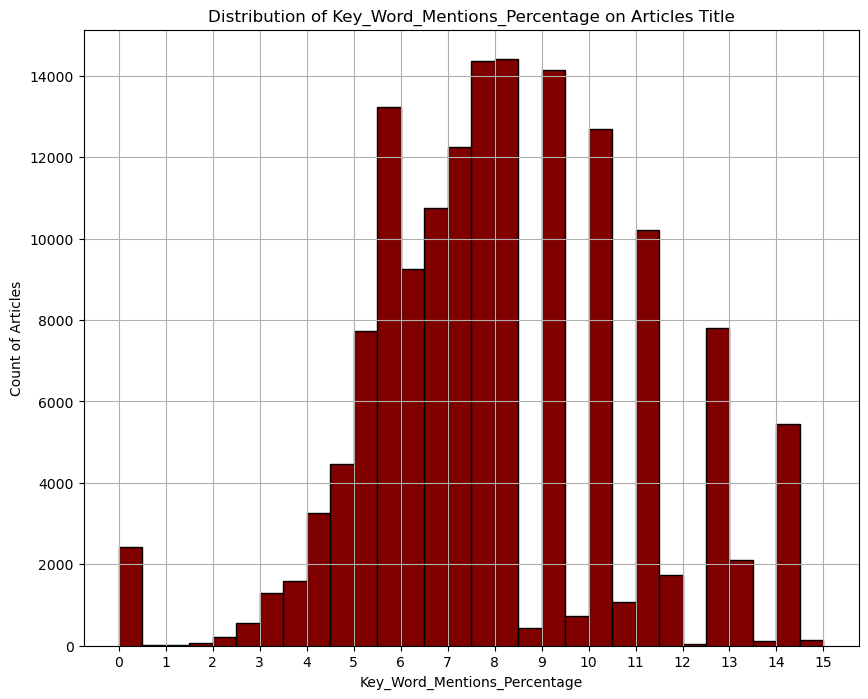

In [55]:

x_min = 0
x_max = 15

# Plot the distribution of Key_Word_Percentage column
plt.figure(figsize=(10, 8))
plt.hist(df_news_final_project['Key_Words_Percentage'], bins=30, range=(x_min, x_max), color='maroon', edgecolor='black')
plt.title('Distribution of Key_Word_Mentions_Percentage on Articles Title')
plt.xlabel('Key_Word_Mentions_Percentage')
plt.ylabel('Count of Articles')
plt.xticks(np.arange(x_min, x_max+1, 1))  # Set x-axis ticks in increments of 1
plt.grid(True)
plt.show()


In [26]:
df_news_final_project = df_news_final_project[df_news_final_project['Key_Words_Percentage'] > 3]

# K-Train LDA TOPIC TO IDENTIFY MAIN TOPICS AND ELIMINATE ROWS THAT DO NOT CONTAIN THAT TOPIC

In [27]:
import bokeh

print('Bokeh Version: ' + bokeh.__version__)

Bokeh Version: 3.2.1


In [28]:
import ktrain

print('Ktrain Version: ' + ktrain.__version__)


Ktrain Version: 0.40.0


In [29]:
import ktrain
from gensim.models.ldamodel import LdaModel
from gensim.corpora.dictionary import Dictionary
from gensim.models import CoherenceModel

In [30]:
texts = df_news_final_project['text_clean'].tolist()

In [31]:
len(texts)

164054

In [12]:
n_topics_values = [5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20]

# Initialize dictionaries to store coherence scores for each n_topics value
coherence_scores = {}

# Convert the texts to a list of lists of words
texts_tokenized = [text.split() for text in texts]

In [11]:
# Train topic models for each n_topics value and compute coherence scores
for n_topics in n_topics_values:
    # Create a dictionary and corpus
    dictionary = Dictionary(texts_tokenized)
    corpus = [dictionary.doc2bow(text) for text in texts_tokenized]

    # Train LDA model
    lda_model = LdaModel(corpus=corpus, id2word=dictionary, num_topics=n_topics)

    # Compute coherence score
    coherence_model_lda = CoherenceModel(model=lda_model, texts=texts_tokenized, dictionary=dictionary, coherence='c_v')
    coherence_score = coherence_model_lda.get_coherence()
    coherence_scores[n_topics] = coherence_score

# Print coherence scores for each n_topics value
for n_topics, score in coherence_scores.items():
    print(f"n_topics={n_topics}: Coherence Score={score}")

# Choose the best n_topics value based on the highest coherence score
best_n_topics = max(coherence_scores, key=coherence_scores.get)
print(f"Best n_topics value: {best_n_topics}")


n_topics=5: Coherence Score=0.40000528605486185
n_topics=6: Coherence Score=0.4392837156695863
n_topics=7: Coherence Score=0.41281924108471826
n_topics=8: Coherence Score=0.4779674532035439
n_topics=9: Coherence Score=0.46928120248174185
n_topics=10: Coherence Score=0.5235670085175481
n_topics=11: Coherence Score=0.5369059582106903
n_topics=12: Coherence Score=0.5029039292264236
n_topics=13: Coherence Score=0.5219283638051481
n_topics=14: Coherence Score=0.491829319871737913
n_topics=15: Coherence Score=0.49959401934357204
n_topics=16: Coherence Score=0.5129102180743672
n_topics=17: Coherence Score=0.44134332799390715
n_topics=18: Coherence Score=0.47817232194742606
n_topics=19: Coherence Score=0.50820237664230524
n_topics=20: Coherence Score=0.47129344874436915
Best n_topics value: 11


In [ ]:
#Checking 2 highest coherence score 

In [38]:
tm = ktrain.text.get_topic_model(
    texts=texts, 
    n_topics=10, 
    n_features=10000, 
    min_df=5, 
    max_df=0.5, 
    stop_words='english', 
    model_type='lda', 
    lda_max_iter=5, 
    verbose=1)

lang: en
preprocessing texts...



KeyboardInterrupt



In [ ]:
tm.build(texts, threshold=0.25)

In [37]:
tm.print_topics(show_counts=True)

topic:8 | count:28919 | gray group press release prnewswire platform alert music weather statements
topic:2 | count:24567 | like people chatgpt says work human make time using used
topic:1 | count:23709 | share openai tech india world ceo privacy government policy altman
topic:0 | count:20970 | cloud customer customers generative security solutions platform services digital models
topic:7 | count:16526 | chatgpt google users best search microsoft app features chatbot video
topic:3 | count:14164 | learning health research science machine medical healthcare care clinical systems
topic:4 | count:12457 | ago hours weather public days day associated file press school
topic:6 | count:10032 | market report global analysis growth research industry forecast key players
topic:9 | count:8910 | stock price stocks market trading shares insurance investment financial investors
topic:5 | count:3112 | products overviewview public consumer services entertainment releasesign industry uplog policy


In [32]:
tm = ktrain.text.get_topic_model(
    texts=texts, 
    n_topics=11, 
    n_features=10000, 
    min_df=5, 
    max_df=0.5, 
    stop_words='english', 
    model_type='lda', 
    lda_max_iter=5, 
    verbose=1)

lang: en
preprocessing texts...
fitting model...
iteration: 1 of max_iter: 5
iteration: 2 of max_iter: 5
iteration: 3 of max_iter: 5
iteration: 4 of max_iter: 5
iteration: 5 of max_iter: 5
done.


In [33]:
tm.build(texts, threshold=0.25)

done.


In [34]:
tm.print_topics(show_counts=True)

topic:4 | count:35033 | gray group press platform release prnewswire solutions customers generative music
topic:8 | count:28230 | chatgpt google best users search tech email microsoft app like
topic:10 | count:23443 | ago hours public weather days day says people chatgpt like
topic:6 | count:14679 | openai security tech systems companies privacy law altman risks ceo
topic:2 | count:14665 | learning models machine model human language cloud like systems using
topic:1 | count:10069 | market report analysis global growth research forecast industry key players
topic:3 | count:9710 | health medical science research healthcare care students clinical learning patients
topic:9 | count:8130 | digital industry customer services management companies global innovation technologies solutions
topic:0 | count:7777 | stock price market share stocks nasdaq trading investment shares investors
topic:7 | count:5638 | china forwardlooking statements republic october september july june january world
topic:

In [35]:
doc_topics=tm.get_doctopics()
tm.visualize_documents(doc_topics=tm.get_doctopics())


reducing to 2 dimensions...[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 162142 samples in 0.614s...
[t-SNE] Computed neighbors for 162142 samples in 173.691s...
[t-SNE] Computed conditional probabilities for sample 1000 / 162142
[t-SNE] Computed conditional probabilities for sample 2000 / 162142
[t-SNE] Computed conditional probabilities for sample 3000 / 162142
[t-SNE] Computed conditional probabilities for sample 4000 / 162142
[t-SNE] Computed conditional probabilities for sample 5000 / 162142
[t-SNE] Computed conditional probabilities for sample 6000 / 162142
[t-SNE] Computed conditional probabilities for sample 7000 / 162142
[t-SNE] Computed conditional probabilities for sample 8000 / 162142
[t-SNE] Computed conditional probabilities for sample 9000 / 162142
[t-SNE] Computed conditional probabilities for sample 10000 / 162142
[t-SNE] Computed conditional probabilities for sample 11000 / 162142
[t-SNE] Computed conditional probabilities for sample 12000 / 162142
[t-SNE]

Loading BokehJS ...

In [140]:
#9,0,7,5

In [117]:
df_news_final_project.reset_index(drop=True, inplace=True)
df_news_final_project

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column
0,http://galusaustralis.com/2020/02/486473/legaltech-artificial-intelligence-market-2019-technology-advancement-and-future-scope-casetext-inc-catalyst-repository-systems-ebrevia/,2020-02-26,"LegalTech Artificial Intelligence Market 2019 Technology Advancement and Future Scope – Casetext Inc., Catalyst Repository Systems, eBREVIA – Galus Australis","LegalTech Artificial Intelligence Market 2019 Technology Advancement and Future Scope Casetext Inc., Catalyst Repository Systems, eBREVIA Galus Australis Galus AustralisBusinessGeneral NewsHealthcareIndustryInternationalLifestyleSciTechWednesday, February 26 2020TrendingNeedle Counters Market Comprehensive Study by Companies Medline Industries, Boen HealthcareSkin Scrub Trays Market Comprehensive Study by Companies Medline Industries, BD, DeroyalGlobal Portable Handheld Electronic Game Mac...",legaltech artificial intelligence market technology advancement future scope casetext inc catalyst repository systems ebrevia galus australis galus australisbusinessgeneral newshealthcareindustryinternationallifestylescitechwednesday february trendingneedle counters market comprehensive study companies medline industries boen healthcareskin scrub trays market comprehensive study companies medline industries bd deroyalglobal portable handheld electronic game machine market outlook business ...,0,1,20,5.000000,AI in Marketing
1,http://www.millenniumpost.in/big-stories/ai-express-aircraft-skids-off-runaway-in-kozhikode-rescue-ops-on-414926,2020-08-07,Two dead as AI Express flight skids off Kozhikode airport,Two dead as AI Express flight skids off Kozhikode airportTopLoginSubscribeToggle navigationFeaturesDelhiKolkataNationOpinionEditorialBusinessSportsSunday PostBeyond BygoneEpic PowerIn RetrospectGlobal EyeInlandRoutesBeaconInsightGame OnSafariTrendingCandid TalkGastronomyFact FilesMapping the states of IndiaXsundaypostbeyondbygonesundaypostepicpowerfactfilesiansfeedssundaypostinretrospectmappingthestatesofindiapujaspecialReminiscencesponsoredsundaypostglobaleyefeaturesnationworldtechnologySaf...,two dead ai express flight skids kozhikode airporttoploginsubscribetoggle navigationfeaturesdelhikolkatanationopinioneditorialbusinesssportssunday postbeyond bygoneepic powerin retrospectglobal eyeinlandroutesbeaconinsightgame onsafaritrendingcandid talkgastronomyfact filesmapping states indiaxsundaypostbeyondbygonesundaypostepicpowerfactfilesiansfeedssundaypostinretrospectmappingthestatesofindiapujaspecialreminiscencesponsoredsundaypostglobaleyefeaturesnationworldtechnologysafarisundayposte...,4,1,10,10.000000,AI in Weather Related Information or Services
2,http://www.nativestew.com/2023/11/ai-took-my-job.html,2023-11-20,"Native Stew - Bahamas AI Art, Photos, Videos: AI Took My Job","Native Stew Bahamas AI Art, Photos, Videos: AI Took My JobPagesHomePeoplePlacesThingsMonday, November 20, 2023AI Took My Job AI Took My Job AI artA. Derek CatalanoatNovember 20, 2023Email ThisBlogThisShare to TwitterShare to FacebookShare to PinterestLabels:Art,PeopleNewer PostOlder PostHomeGo Fund MeMy daughterinlaw Gayle. Please help.TranslateAbout MeA. Derek CatalanoPhotos, videos and art featuring the people, places and things of The Bahamas. Ive traveled to many islands of The Bahamas...",native stew bahamas ai art photos videos ai took jobpageshomepeopleplacesthingsmonday november ai took job ai took job ai arta derek catalanoatnovember email thisblogthisshare twittershare facebookshare pinterestlabelsartpeoplenewer postolder posthomego fund memy daughterinlaw gayle please helptranslateabout mea derek catalanophotos videos art featuring people places things bahamas ive traveled many islands bahamas taking lots photos ive worked television many years experience video shooting...,5,2,12,16.666667,AI Applications and Technologies
3,http://www.sbwire.com/press-releases/healthcare-artificial-intelligence-market-next-big-thing-

In [118]:
# Get the topic assignments for each document
topic_predictions = tm.predict(texts, threshold=0.25)

topic_predictions= topic_predictions[0]

topic_4_indices = [i for i, topic_probabilities in enumerate(topic_predictions) if topic_probabilities.argmax() == 4]


# Get the corresponding rows/articles from the original DataFrame
topic_4_articles = df_news_final_project.iloc[topic_4_indices]

# Print the count of articles and display the articles if needed
print("Number of articles in Topic 0:", len(topic_4_articles))
topic_4_articles

Number of articles in Topic 0: 35033


,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column
95,https://itbusinessnet.com/2022/04/martech-outlook-magazine-recognizes-ai-media-group-as-a-top-10-analytics-company/,2022-04-28,MarTech Outlook Magazine Recognizes Ai Media Group As A Top 10 Analytics Company – IT Business Net,"MarTech Outlook Magazine Recognizes Ai Media Group As A Top 10 Analytics Company IT Business NetSkip to contentIT Business NetNews for IT ProfessionalsPrimary MenuIT Business NetAbout IT Business NetSearch for: Home2022AprilMarTech Outlook Magazine Recognizes Ai Media Group As A Top 10 Analytics Company News MarTech Outlook Magazine Recognizes Ai Media Group As A Top 10 Analytics Company NEW YORKBUSINESS WIREAi Media Group, a Blackstone portfolio company with headquarters in New York City, ...",martech outlook magazine recognizes ai media group top analytics company business netskip contentit business netnews professionalsprimary menuit business netabout business netsearch homeaprilmartech outlook magazine recognizes ai media group top analytics company news martech outlook magazine recognizes ai media group top analytics company new yorkbusiness wireai media group blackstone portfolio company headquarters new york city continues receive recognition industry leaders analytics digi...,116,1,17,5.882353,Generative AI in Music
190,https://venturebeat.com/2020/07/22/researchers-ai-aligns-sheet-music-with-midi-audio/?utm_source=feedburner&utm_medium=feed&utm_campaign=Feed%3A+venturebeat%2FSZYF+%28VentureBeat%29,2020-07-22,Researchers' AI aligns sheet music with MIDI audio | VentureBeat,Researchers AI aligns sheet music with MIDI audio VentureBeat VentureBeat HomepageThe MachineGamesBeatJobsBecome a MemberSign InLog OutVentureBeat HomepageMaking sense of AIVentureBeatARVRBig DataCloudCommerceDevEnterpriseEntrepreneurMarketingMediaMobileSecuritySocialTransportationThe MachineAIGamesBeatGamesEsportsPC GamingEventsUpcomingTransformMedia PartnerWebinarsGeneralNewslettersGot a news tipAdvertisePress ReleasesDealsJobsVB LabAboutContactPrivacy PolicyJoin the VentureBeat Community...,researchers ai aligns sheet music midi audio venturebeat venturebeat homepagethe machinegamesbeatjobsbecome membersign inlog outventurebeat homepagemaking sense aiventurebeatarvrbig datacloudcommercedeventerpriseentrepreneurmarketingmediamobilesecuritysocialtransportationthe machineaigamesbeatgamesesportspc gamingeventsupcomingtransformmedia partnerwebinarsgeneralnewslettersgot news tipadvertisepress releasesdealsjobsvb lababoutcontactprivacy policyjoin venturebeat community shareshare faceb...,238,1,10,10.000000,Generative AI in Music
200,https://www.01net.it/accenture-to-acquire-bridgei2i-expanding-capabilities-in-data-science-machine-learning-and-ai-powered-insights/,2021-10-12,"Accenture to Acquire BRIDGEi2i, Expanding Capabilities in Data Science, Machine Learning and AI-Powered Insights","Accenture to Acquire BRIDGEi2i, Expanding Capabilities in Data Science, Machine Learning and AIPowered Insights 5GBig DataCloudIoTProdottiHardwareMobileNetworking e TLCSicurezzaSoftwareStorageSoluzioniAgricolturaArchitettura DesignAutomotiveManufacturingRetaileHealthSmart HomeUtilitiesAppleDVBT2TestIntelligenza ArtificialeThink TankWhite paperIscriviti alla newsletter CercaThink TankWhite paperIscriviti alla newsletter 01net5GBig DataCloudIoTProdottiHardwareMobileNetworking e TLCSicurezzaSo...",accenture acquire bridgeii expanding capabilities data science machine learning aipowered insights gbig datacloudiotprodottihardwaremobilenetworking e tlcsicurezzasoftwarestoragesoluzioniagricolturaarchitettura designautomotivemanufacturingretailehealthsmart homeutilitiesappledvbttestintelligenza artificialethink tankwhite paperiscriviti alla newsletter cercathink tankwhite paperiscriviti alla newsletter netgbig datacloudiotprodottihardwaremobilenetworking e tlcsicurezzasoftwarestoragesoluzi...,248,2,14,14.285714,Generative AI in Music
201,https://www.01net.it

In [119]:
# Get the topic assignments for each document

topic_8_indices = [i for i, topic_probabilities in enumerate(topic_predictions) if topic_probabilities.argmax() == 8]


# Get the corresponding rows/articles from the original DataFrame
topic_8_articles = df_news_final_project.iloc[topic_8_indices]

# Print the count of articles and display the articles if needed
print("Number of articles in Topic 0:", len(topic_8_articles))
topic_8_articles

Number of articles in Topic 0: 28230


,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column
2,http://www.nativestew.com/2023/11/ai-took-my-job.html,2023-11-20,"Native Stew - Bahamas AI Art, Photos, Videos: AI Took My Job","Native Stew Bahamas AI Art, Photos, Videos: AI Took My JobPagesHomePeoplePlacesThingsMonday, November 20, 2023AI Took My Job AI Took My Job AI artA. Derek CatalanoatNovember 20, 2023Email ThisBlogThisShare to TwitterShare to FacebookShare to PinterestLabels:Art,PeopleNewer PostOlder PostHomeGo Fund MeMy daughterinlaw Gayle. Please help.TranslateAbout MeA. Derek CatalanoPhotos, videos and art featuring the people, places and things of The Bahamas. Ive traveled to many islands of The Bahamas...",native stew bahamas ai art photos videos ai took jobpageshomepeopleplacesthingsmonday november ai took job ai took job ai arta derek catalanoatnovember email thisblogthisshare twittershare facebookshare pinterestlabelsartpeoplenewer postolder posthomego fund memy daughterinlaw gayle please helptranslateabout mea derek catalanophotos videos art featuring people places things bahamas ive traveled many islands bahamas taking lots photos ive worked television many years experience video shooting...,5,2,12,16.666667,AI Applications and Technologies
6,https://9to5toys.com/2024/01/02/put-your-best-ai-self-forward-with-vidboard-creative-ai-presenter-at-40/,2024-01-02,Put your best AI self forward with vidBoard Creative AI Presenter at $40,Put your best AI self forward with vidBoard Creative AI Presenter at 40MenuninetofivetoyschevrondownSwitch SiteYouTubeFacebookTwitterInstagramPodcast Toggle searchSearch for:ninetofivegoogle9to5Googleninetofivemac9to5MacninetofiveelectrekElectrekninetofivedronedjDroneDJninetofivespaceexploredSpaceExploredAbout 9to5ToysDo Not Sell My InfoPrivacy SettingsDealsNewsAmazonAppleLEGOBest BuySmartphone AccessoriesTested with 9to5ToysTVsGamingYouTubeFacebookTwitterInstagramPodcast Put your best AI se...,put best ai self forward vidboard creative ai presenter menuninetofivetoyschevrondownswitch siteyoutubefacebooktwitterinstagrampodcast toggle searchsearch forninetofivegoogletogoogleninetofivemactomacninetofiveelectrekelectrekninetofivedronedjdronedjninetofivespaceexploredspaceexploredabout totoysdo sell infoprivacy settingsdealsnewsamazonapplelegobest buysmartphone accessoriestested totoystvsgamingyoutubefacebooktwitterinstagrampodcast put best ai self forward vidboard creative ai presenter...,12,2,13,15.384615,AI Applications and Technologies
14,https://bcfocus.com/artificial-intelligence-the-best-ally-of-human-resources-in-the-post-covid-era/,2021-06-30,"Artificial Intelligence, the best ally of Human Resources in the post-Covid era – BCFocus","Artificial Intelligence, the best ally of Human Resources in the postCovid era BCFocus Wednesday, June 30 2021Breaking NewsAfghanistan US Commander General Scott Miller warns Taliban to cease offensive or face airstrikes100 years of CPC: Imran Khan says US is pressuring Pakistan to take sides and downgrade relations with ChinaOver 80 of Spanish workers answer calls or emails outside of working hoursArtificial Intelligence, the best ally of Human Resources in the postCovid eraPlaybased learn...",artificial intelligence best ally human resources postcovid era bcfocus wednesday june breaking newsafghanistan us commander general scott miller warns taliban cease offensive face airstrikes years cpc imran khan says us pressuring pakistan take sides downgrade relations chinaover spanish workers answer calls emails outside working hoursartificial intelligence best ally human resources postcovid eraplaybased learning business experience entertains trains generates professional personal chan...,23,1,14,7.142857,AI Applications and Technologies
17,https://boxofficebuz.com/movie/je-vous-ai-compris,2022-11-23,Je vous ai compris | Box Office Buz,Je vous ai compris Box Office BuzHomeMoviesShowsTrailersNewsMore LoginNot AvailableJe vous ai comprisDirectorNot AvailableScr

In [120]:
# Get the topic assignments for each document

topic_10_indices = [i for i, topic_probabilities in enumerate(topic_predictions) if topic_probabilities.argmax() == 10]


# Get the corresponding rows/articles from the original DataFrame
topic_10_articles = df_news_final_project.iloc[topic_10_indices]

# Print the count of articles and display the articles if needed
print("Number of articles in Topic 0:", len(topic_10_articles))
topic_10_articles

Number of articles in Topic 0: 23443


,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column
1,http://www.millenniumpost.in/big-stories/ai-express-aircraft-skids-off-runaway-in-kozhikode-rescue-ops-on-414926,2020-08-07,Two dead as AI Express flight skids off Kozhikode airport,Two dead as AI Express flight skids off Kozhikode airportTopLoginSubscribeToggle navigationFeaturesDelhiKolkataNationOpinionEditorialBusinessSportsSunday PostBeyond BygoneEpic PowerIn RetrospectGlobal EyeInlandRoutesBeaconInsightGame OnSafariTrendingCandid TalkGastronomyFact FilesMapping the states of IndiaXsundaypostbeyondbygonesundaypostepicpowerfactfilesiansfeedssundaypostinretrospectmappingthestatesofindiapujaspecialReminiscencesponsoredsundaypostglobaleyefeaturesnationworldtechnologySaf...,two dead ai express flight skids kozhikode airporttoploginsubscribetoggle navigationfeaturesdelhikolkatanationopinioneditorialbusinesssportssunday postbeyond bygoneepic powerin retrospectglobal eyeinlandroutesbeaconinsightgame onsafaritrendingcandid talkgastronomyfact filesmapping states indiaxsundaypostbeyondbygonesundaypostepicpowerfactfilesiansfeedssundaypostinretrospectmappingthestatesofindiapujaspecialreminiscencesponsoredsundaypostglobaleyefeaturesnationworldtechnologysafarisundayposte...,4,1,10,10.000000,AI in Weather Related Information or Services
11,https://asapland.com/one-punch-man-a-fan-imagined-king-in-reality-thanks-to-artificial-intelligence/50626/,2020-07-24,One Punch Man: a fan imagined King in reality thanks to artificial intelligence - Asap Land,"One Punch Man: a fan imagined King in reality thanks to artificial intelligence Asap Land HomeAboutPrivacy PolicyCookie PolicyTerms of UseTeamContact July 24, 2020 HomeBusinessTechnologyGeneral NewsEntertainment One Punch Man: a fan imagined King in reality thanks to artificial intelligence Fortnite, Season 3: how to complete all the challenges of Week 6 ONE PIECE: a charming Carrot is the protagonist of a faithful cosplay Nintendo interested in new markets No longer just video games World ...",one punch man fan imagined king reality thanks artificial intelligence asap land homeaboutprivacy policycookie policyterms useteamcontact july homebusinesstechnologygeneral newsentertainment one punch man fan imagined king reality thanks artificial intelligence fortnite season complete challenges week one piece charming carrot protagonist faithful cosplay nintendo interested new markets longer video games world warcraft queen azshara comes life daniela loveiras cosplay formula canceled grand...,19,1,16,6.250000,AI in Weather Related Information or Services
58,https://en.cedarnews.net/74850/task/youtube-will-let-you-make-songs-with-ai-clones-of-singers/,2023-11-16,YouTube Will Let You Make Songs With AI Clones of Singers – Cedar News English,"YouTube Will Let You Make Songs With AI Clones of Singers Cedar News English Skip to contentThu. Nov 16th, 2023 HomeBreakingLebanonNewsPoliticsCrimesVideoEntertainmentAR News YouTube Will Let You Make Songs With AI Clones of Singers ByNov 16, 2023clones:, singers,, songs, youtube SOPA Images Getty Images Making music is about to get a whole lot easierand potentially a lot worse too. YouTube announced Thursday that itll be releasing a product using artificial intelligence that allows users ...",youtube let make songs ai clones singers cedar news english skip contentthu nov th homebreakinglebanonnewspoliticscrimesvideoentertainmentar news youtube let make songs ai clones singers bynov clones singers songs youtube sopa images getty images making music get whole lot easierand potentially lot worse youtube announced thursday itll releasing product using artificial intelligence allows users create songs prompt tool called dream tracks available users create second tracks youtube shorts...,69,1,15,6.666667,AI in Weather Related Information or Services
78,https://futurism.com/the-byte/openai-ceo-finally-watched-ex-machina,2023-06-03,"OpenAI CEO Says He Finally Watched ""Ex Machin

In [121]:
# Get the topic assignments for each document

topic_6_indices = [i for i, topic_probabilities in enumerate(topic_predictions) if topic_probabilities.argmax() == 6]


# Get the corresponding rows/articles from the original DataFrame
topic_6_articles = df_news_final_project.iloc[topic_6_indices]

# Print the count of articles and display the articles if needed
print("Number of articles in Topic 0:", len(topic_6_articles))
topic_6_articles

Number of articles in Topic 0: 14679


,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column
7,https://abc7chicago.com/ai-act-artificial-intelligence-european-union-technology-regulations/14170020/,2023-12-12,"The European Union releases the AI Act, the world's first set of regulations on artificial intelligence - ABC7 Chicago","The European Union releases the AI Act, the worlds first set of regulations on artificial intelligence ABC7 ChicagoWATCH LIVEChicago Suburban Cook Co.North SuburbsWest SuburbsSouth SuburbsNW IndianaEDITLog InWatchAppsLocal News Chicago Suburban Cook Co.North SuburbsWest SuburbsSouth SuburbsNW IndianaCategories TrafficLocal NewsU.S. WorldITeamPoliticsEntertainmentConsumer BusinessWeatherSafety TrackerABC7 SportsEquity ReportLocalishRace and CultureChicago ProudShopStation Info About ABC7...",european union releases ai act worlds first set regulations artificial intelligence abc chicagowatch livechicago suburban cook conorth suburbswest suburbssouth suburbsnw indianaeditlog inwatchappslocal news chicago suburban cook conorth suburbswest suburbssouth suburbsnw indianacategories trafficlocal newsus worlditeampoliticsentertainmentconsumer businessweathersafety trackerabc sportsequity reportlocalishrace culturechicago proudshopstation info abc chicagoabc newsteam bioscommunity journa...,14,2,19,10.526316,Ethical and Legal Implications of AI
9,https://arstechnica.com/tech-policy/2023/03/ftc-should-investigate-openai-and-halt-gpt-4-releases-ai-research-group-says/,2023-03-31,"GPT-4 poses too many risks and releases should be halted, AI group tells FTC | Ars Technica","GPT4 poses too many risks and releases should be halted, AI group tells FTC Ars TechnicaSkip to main contentBiz ITTechSciencePolicyCarsGaming CultureStoreForumsSubscribeClose Navigate StoreSubscribeVideosFeaturesReviewsRSS FeedsMobile SiteAbout ArsStaff DirectoryContact UsAdvertise with ArsReprints Filter by topic Biz ITTechSciencePolicyCarsGaming CultureStoreForums Settings Front page layout Grid List Site themelightdark Sign in AI conundrum GPT4 poses too many risks and releases shoul...",gpt poses many risks releases halted ai group tells ftc ars technicaskip main contentbiz ittechsciencepolicycarsgaming culturestoreforumssubscribeclose navigate storesubscribevideosfeaturesreviewsrss feedsmobile siteabout arsstaff directorycontact usadvertise arsreprints filter topic biz ittechsciencepolicycarsgaming culturestoreforums settings front page layout grid list site themelightdark sign ai conundrum gpt poses many risks releases halted ai group tells ftcopenai released gpt despite ...,17,1,17,5.882353,Ethical and Legal Implications of AI
10,https://arstechnica.com/tech-policy/2023/08/report-potential-nyt-lawsuit-could-force-openai-to-wipe-chatgpt-and-start-over/,2023-08-18,Report: Potential NYT lawsuit could force OpenAI to wipe ChatGPT and start over | Ars Technica,Report: Potential NYT lawsuit could force OpenAI to wipe ChatGPT and start over Ars TechnicaSkip to main contentBiz ITTechSciencePolicyCarsGaming CultureStoreForumsSubscribeClose Navigate StoreSubscribeVideosFeaturesReviewsRSS FeedsMobile SiteAbout ArsStaff DirectoryContact UsAdvertise with ArsReprints Filter by topic Biz ITTechSciencePolicyCarsGaming CultureStoreForums Settings Front page layout Grid List Site themelightdark Sign in Sizing up the competition Report: Potential NYT lawsu...,report potential nyt lawsuit could force openai wipe chatgpt start ars technicaskip main contentbiz ittechsciencepolicycarsgaming culturestoreforumssubscribeclose navigate storesubscribevideosfeaturesreviewsrss feedsmobile siteabout arsstaff directorycontact usadvertise arsreprints filter topic biz ittechsciencepolicycarsgaming culturestoreforums settings front page layout grid list site themelightdark sign sizing competition report potential nyt lawsuit could force openai wipe chatgpt start...,18,2,16,12.500000,Ethical and Legal Implications of AI
20,https://channeldailynews.com/news/hashtag-trendi

In [122]:
# Get the topic assignments for each document

topic_2_indices = [i for i, topic_probabilities in enumerate(topic_predictions) if topic_probabilities.argmax() == 2]


# Get the corresponding rows/articles from the original DataFrame
topic_2_articles = df_news_final_project.iloc[topic_2_indices]

# Print the count of articles and display the articles if needed
print("Number of articles in Topic 0:", len(topic_2_articles))
topic_2_articles

Number of articles in Topic 0: 14665


,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column
26,https://citylife.capetown/bs/science/need-to-map-an-iceberg-in-a-hundredth-of-a-second-ask-a-computer/451086/,2023-11-17,Nova AI tehnologija omogućava brzo mapiranje ledenih bregova na Antarktiku,"Nova AI tehnologija omoguava brzo mapiranje ledenih bregova na Antarktiku Preskoi na sadrajpet. 17. novembar 2023 City LifeOtkrivanje novih tehnologija i moi AI AIVijestiprostortehnologijasatelitnaukaAmerikiKontakt nauka Nova AI tehnologija omoguava brzo mapiranje ledenih bregova na Antarktiku ByVicky StavropoulouNovembar 15, 2023 Icebergs play a significant role in the Antarctic environment, impacting everything from sea levels to ocean physics and biology. Understanding their movements and...",nova ai tehnologija omoguava brzo mapiranje ledenih bregova na antarktiku preskoi na sadrajpet novembar city lifeotkrivanje novih tehnologija moi ai aivijestiprostortehnologijasatelitnaukaamerikikontakt nauka nova ai tehnologija omoguava brzo mapiranje ledenih bregova na antarktiku byvicky stavropoulounovembar icebergs play significant role antarctic environment impacting everything sea levels ocean physics biology understanding movements changes crucial tracking climate change maritime oper...,37,1,10,10.000000,Machine Learning Models for Human Tasks
29,https://citylife.capetown/eu/uncategorized/why-your-weather-forecasts-may-soon-become-much-more-accurate/450352/,2023-11-17,Revolutionizing Weather Prediction: Google's AI Model Outperforms Government Models,"Revolutionizing Weather Prediction: Googles AI Model Outperforms Government Models Eduki nagusira joanOsteguna 16ko azaroaren 2023a Hiriko BizitzaTeknologia berriak eta AIaren boterea ezagutaraztea AIBerriakSpaceTeknologiaSateliteaZientzia:USHarremanetarako Berriak Eguraldiaren iragarpena iraultzen: Googleren AI ereduak gobernu ereduak gainditzen ditu ByVicky StavropoulouAza 14, 2023 A groundbreaking study published in Science revealed that Googles new AIpowered weather prediction model has ...",revolutionizing weather prediction googles ai model outperforms government models eduki nagusira joanosteguna ko azaroaren hiriko bizitzateknologia berriak eta aiaren boterea ezagutaraztea aiberriakspaceteknologiasateliteazientziausharremanetarako berriak eguraldiaren iragarpena iraultzen googleren ai ereduak gobernu ereduak gainditzen ditu byvicky stavropoulouaza groundbreaking study published science revealed googles new aipowered weather prediction model consistently outperformed existing...,40,1,9,11.111111,Machine Learning Models for Human Tasks
31,https://citylife.capetown/ha/uncategorized/can-ai-have-human-feelings/520029/,2023-12-10,Shin AI na iya samun jin daɗin ɗan adam?,"Shin AI na iya samun jin dain an adam Tsallake zuwa contentRana 10 ga Disamba, 2023 Rayuwar GariBayyana Sabbin Fasaha da arfin AI AILabaraiSpaceTechnologyTauraron Dan AdamScienceAmurkalamba AIwucin gadi hankaliHealthLabaraiTechnology Shin AI na iya samun jin dain an adam ByMampho BresciaDec 8, 2023 Summary:Artificial Intelligence AI has made significant advancements in recent years, leading to the question of whether AI can possess human feelings. While AI systems can mimic human emotions to...",shin ai na iya samun jin dain an adam tsallake zuwa contentrana ga disamba rayuwar garibayyana sabbin fasaha da arfin ai ailabaraispacetechnologytauraron dan adamscienceamurkalamba aiwucin gadi hankalihealthlabaraitechnology shin ai na iya samun jin dain an adam bymampho bresciadec summaryartificial intelligence ai made significant advancements recent years leading question whether ai possess human feelings ai systems mimic human emotions extent true humanlike feelings remain beyond capabili...,42,1,9,11.111111,Machine Learning Models for Human Tasks
33,https://citylife.capetown/haw/uncategorized/why-is-it-called-science/491937/,2023-12-02,No ke aha i kapa ʻia ai ka ʻepekema?,"No ke aha i kapa ia ai ka epekema E lele i ka maioSat

In [123]:
# Get the topic assignments for each document

topic_1_indices = [i for i, topic_probabilities in enumerate(topic_predictions) if topic_probabilities.argmax() == 1]


# Get the corresponding rows/articles from the original DataFrame
topic_1_articles = df_news_final_project.iloc[topic_1_indices]

# Print the count of articles and display the articles if needed
print("Number of articles in Topic 0:", len(topic_1_articles))
topic_1_articles

Number of articles in Topic 0: 10069


,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column
0,http://galusaustralis.com/2020/02/486473/legaltech-artificial-intelligence-market-2019-technology-advancement-and-future-scope-casetext-inc-catalyst-repository-systems-ebrevia/,2020-02-26,"LegalTech Artificial Intelligence Market 2019 Technology Advancement and Future Scope – Casetext Inc., Catalyst Repository Systems, eBREVIA – Galus Australis","LegalTech Artificial Intelligence Market 2019 Technology Advancement and Future Scope Casetext Inc., Catalyst Repository Systems, eBREVIA Galus Australis Galus AustralisBusinessGeneral NewsHealthcareIndustryInternationalLifestyleSciTechWednesday, February 26 2020TrendingNeedle Counters Market Comprehensive Study by Companies Medline Industries, Boen HealthcareSkin Scrub Trays Market Comprehensive Study by Companies Medline Industries, BD, DeroyalGlobal Portable Handheld Electronic Game Mac...",legaltech artificial intelligence market technology advancement future scope casetext inc catalyst repository systems ebrevia galus australis galus australisbusinessgeneral newshealthcareindustryinternationallifestylescitechwednesday february trendingneedle counters market comprehensive study companies medline industries boen healthcareskin scrub trays market comprehensive study companies medline industries bd deroyalglobal portable handheld electronic game machine market outlook business ...,0,1,20,5.000000,AI in Marketing
3,http://www.sbwire.com/press-releases/healthcare-artificial-intelligence-market-next-big-thing-major-giants-general-electric-medtronic-aicure-apixio-1363690.htm,2022-10-06,Healthcare Artificial Intelligence Market Analysis and Forecast for Next 5 Years,"Healthcare Artificial Intelligence Market Analysis and Forecast for Next 5 Years SBWireSign UpLoginOur ServicePlans PricingNewsroomHelpAboutAMA Research amp Media LLP Email Alerts RSS Healthcare Artificial Intelligence Market Next Big Thing : Major Giants General Electric, Medtronic, AiCure, APIXIOHealthcare Artificial Intelligence Market 20222028 New Jersey, USA SBWIRE 10052022 Advance Market Analytics published a new research publication on Healthcare Artificial Intelligence Market Ins...",healthcare artificial intelligence market analysis forecast next years sbwiresign uploginour serviceplans pricingnewsroomhelpaboutama research amp media llp email alerts rss healthcare artificial intelligence market next big thing major giants general electric medtronic aicure apixiohealthcare artificial intelligence market new jersey usa sbwire advance market analytics published new research publication healthcare artificial intelligence market insights pages enriched selfexplained tables c...,8,2,11,18.181818,AI in Marketing
4,https://3wnews.org/industry/704499/artificial-intelligence-as-a-service-market-opportunities-market-analysis-outlook-to-2027/,2020-04-29,"Artificial Intelligence As A Service Market : Opportunities, Market Analysis & Outlook To 2027 – 3w Market News Reports","Artificial Intelligence As A Service Market : Opportunities, Market Analysis Outlook To 2027 3w Market News Reports Contact UsAbout Us 3w Market News Reports3rd Market Reports and AnalyticsNewsMarket ReportsIndustry AnalyticsIndustry ReportsMarket ResearchBusiness OpportunityEmerging TrendsGrowth Prospects HomeIndustryArtificial Intelligence As A Service Market : Opportunities, Market Analysis Outlook To 2027 Artificial Intelligence As A Service Market : Opportunities, Market Analysis Ou...",artificial intelligence service market opportunities market analysis outlook w market news reports contact usabout us w market news reportsrd market reports analyticsnewsmarket reportsindustry analyticsindustry reportsmarket researchbusiness opportunityemerging trendsgrowth prospects homeindustryartificial intelligence service market opportunities market analysis outlook artificial intelligence service market opportunities market analysis outlook posted april posted email pr

In [124]:
# Get the topic assignments for each document


topic_3_indices = [i for i, topic_probabilities in enumerate(topic_predictions) if topic_probabilities.argmax() == 3]


# Get the corresponding rows/articles from the original DataFrame
topic_3_articles = df_news_final_project.iloc[topic_3_indices]

# Print the count of articles and display the articles if needed
print("Number of articles in Topic 0:", len(topic_3_articles))
topic_3_articles

Number of articles in Topic 0: 9710


,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column
8,https://agenparl.eu/funding-boost-for-artificial-intelligence-in-nhs-to-speed-up-diagnosis-of-deadly-diseases/,2020-08-28,Funding boost for artificial intelligence in NHS to speed up diagnosis of deadly diseases — Agenparl,"Funding boost for artificial intelligence in NHS to speed up diagnosis of deadly diseases Agenparl sabato, Agosto 29, 2020Breaking News UK GOVERNMENT PROVIDES OVER 140 MILLION OF SUPPORT FOR EXPORTS TO GHANAFUNDING BOOST FOR ARTIFICIAL INTELLIGENCE IN NHS TO SPEED UP DIAGNOSIS OFSTRENGTHENING PUBLIC INVESTMENT MANAGEMENT IN THE EASTERN CARIBBEAN CURRENCY UNION: GETTING MORETACKLING PRIVATE OVERINDEBTEDNESS IN ASIA: ECONOMIC AND LEGAL ASPECTSDESTABILIZING STABILITY EXCHANGE RATE ARRANGEMENTS...",funding boost artificial intelligence nhs speed diagnosis deadly diseases agenparl sabato agosto breaking news uk government provides million support exports ghanafunding boost artificial intelligence nhs speed diagnosis ofstrengthening public investment management eastern caribbean currency union getting moretackling private overindebtedness asia economic legal aspectsdestabilizing stability exchange rate arrangements foreign currency debtcoordinating revenue incentive policies caribbeann...,15,1,16,6.250000,Data Science in Healthcare and Medicine
15,https://bigthink.com/health/harvard-ai-risk-pancreatic-cancer/,2023-07-15,Harvard AI predicts who is at risk of pancreatic cancer - Big Think,Harvard AI predicts who is at risk of pancreatic cancer Big Think Skip to content Video The Big Think InterviewYour Brain on MoneyPlaylistsExplore the Library Big Questions Will true AI turn against usDo we have free willWhy are there conspiracy theoriesIs religion helping or hurting usAre we alone in the universeShould we trust science Big Thinkers Michio KakuNeil deGrasse TysonMichelle ThallerZena HitzSteven PinkerPaul BloomRay KurzweilCornel WestHelen Fisher Sections NeuropsychThinkingLe...,harvard ai predicts risk pancreatic cancer big think skip content video big think interviewyour brain moneyplaylistsexplore library big questions true ai turn usdo free willwhy conspiracy theoriesis religion helping hurting usare alone universeshould trust science big thinkers michio kakuneil degrasse tysonmichelle thallerzena hitzsteven pinkerpaul bloomray kurzweilcornel westhelen fisher sections neuropsychthinkingleadershipsmart skillshigh culturethe pastthe presentthe futurelifehealthhard...,24,1,13,7.692308,Data Science in Healthcare and Medicine
35,https://citylife.capetown/is/science/e-tongue-ai-model-to-help-predict-bitterness-of-medicines/394712/,2023-10-04,"Researchers Use ""Electric Tongue"" and AI Model to Predict Bitterness of Drugs","Researchers Use Electric Tongue and AI Model to Predict Bitterness of Drugs Sleppa yfir innihaldmivikud. 4. oktber 2023 BorgarlfAfhjpa nja tkni og kraft gervigreindar AIFrttirSpaceTkniSatelliteVsindiUSHafa samband Vsindi Vsindamenn nota raftungu og gervigreindarlkan til a sp fyrir um biturleika eiturlyfja ByRbert AndrsOktber 2, 2023A team of researchers from University College London UCL has developed a method using an electric tongue and artificial intelligence AI to predict the bitterness...",researchers use electric tongue ai model predict bitterness drugs sleppa yfir innihaldmivikud oktber borgarlfafhjpa nja tkni og kraft gervigreindar aifrttirspacetknisatellitevsindiushafa samband vsindi vsindamenn nota raftungu og gervigreindarlkan til a sp fyrir um biturleika eiturlyfja byrbert andrsoktber team researchers university college london ucl developed method using electric tongue artificial intelligence ai predict bitterness drugs taste plays crucial role ensuring individuals con...,46,1,12,8.333333,Data Science in Healthcare and Medicine
41,https://citylife.capetown/ms/science/ai-detected-a-supernova-all-on-its-own/401023/,2023-10-18,Sistem Pengesanan Supernova Berbantukan AI Memperkemas Penyelidikan

In [125]:
# Get the topic assignments for each document


topic_9_indices = [i for i, topic_probabilities in enumerate(topic_predictions) if topic_probabilities.argmax() == 9]


# Get the corresponding rows/articles from the original DataFrame
topic_9_articles = df_news_final_project.iloc[topic_9_indices]

# Print the count of articles and display the articles if needed
print("Number of articles in Topic 0:", len(topic_9_articles))
topic_9_articles

Number of articles in Topic 0: 8130


,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column
12,https://auto.economictimes.indiatimes.com/amp/news/auto-technology/tech-mahindra-and-anyverse-partner-to-accelerate-ai-adoption-in-auto-industry/102802999,2023-08-17,"Tech Mahindra and Anyverse partner to accelerate AI Adoption in auto industry, ET Auto","Tech Mahindra and Anyverse partner to accelerate AI Adoption in auto industry, ET Auto Get AppHomeNewsExclusivesEventsMore LoginGoLeaders SpeakWebinarsEV Future MobilityTechnologyPassenger VehiclesAuto ComponentsCommercial VehicleTwo WheelersConsumerET AutolyticsIndustryDealersTrendsAutopreneurInterviewsAutologueMasterClassesNewslettersAbout UsContact UsSmart Factory Summit 2023The Future of Manufacturing, 26 Sep, Hyatt Regency, DelhiETAuto EV Conclave 2023 8th EditionPlug in to a New Growt...",tech mahindra anyverse partner accelerate ai adoption auto industry et auto get apphomenewsexclusiveseventsmore logingoleaders speakwebinarsev future mobilitytechnologypassenger vehiclesauto componentscommercial vehicletwo wheelersconsumeret autolyticsindustrydealerstrendsautopreneurinterviewsautologuemasterclassesnewslettersabout uscontact ussmart factory summit future manufacturing sep hyatt regency delhietauto ev conclave th editionplug new growth phase nov hyatt regency delhiget rich dat...,20,1,14,7.142857,Customer Service and Management Solutions in Digital Industry
23,https://citylife.capetown/ai/a-i-s-inroads-in-publishing-touch-off-fear-and-creativity/312019/,2023-08-02,The Impact of Artificial Intelligence on the Publishing Industry,"The Impact of Artificial Intelligence on the Publishing Industry Skip to contentWed. Aug 2nd, 2023 CityLifeThe Power of AI Models AIDronesMilitaryNewsSatellite TelephonySatellite InternetSpaceTechnologyContact AI The Impact of Artificial Intelligence on the Publishing Industry ByMampho Brescia Aug 2, 2023 The rise of technology, particularly artificial intelligence AI, has the potential to significantly impact the publishing industry. In the past, the industry has adapted to disruptions such...",impact artificial intelligence publishing industry skip contentwed aug nd citylifethe power ai models aidronesmilitarynewssatellite telephonysatellite internetspacetechnologycontact ai impact artificial intelligence publishing industry bymampho brescia aug rise technology particularly artificial intelligence ai potential significantly impact publishing industry past industry adapted disruptions arrival amazon rise ebooks selfpublishing however emergence ai expected bring wideranging transfor...,34,1,9,11.111111,Customer Service and Management Solutions in Digital Industry
25,https://citylife.capetown/ai/twilio-calls-on-openai-for-generative-ai/318437/,2023-08-04,Twilio integrates with OpenAI to enhance customer engagement platform capabilities,"Twilio integrates with OpenAI to enhance customer engagement platform capabilities Skip to contentFri. Aug 4th, 2023 CityLifeThe Power of AI Models AIDronesMilitaryNewsSatellite TelephonySatellite InternetSpaceTechnologyContact AI Twilio integrates with OpenAI to enhance customer engagement platform capabilities ByRobert Andrew Aug 3, 2023 Twilio has announced a new integration with generative AI leader OpenAI to further enhance its customer engagement platform capabilities. This integration...",twilio integrates openai enhance customer engagement platform capabilities skip contentfri aug th citylifethe power ai models aidronesmilitarynewssatellite telephonysatellite internetspacetechnologycontact ai twilio integrates openai enhance customer engagement platform capabilities byrobert andrew aug twilio announced new integration generative ai leader openai enhance customer engagement platform capabilities integration brings openais gpt model twilio engage platform enabling organization...,36,1,10,10.000000,Customer Service and Management Solutions in Digital Industry
32,https://citylife.capetown/haw/uncategorized/is-600

In [126]:
# Get the topic assignments for each document


topic_0_indices = [i for i, topic_probabilities in enumerate(topic_predictions) if topic_probabilities.argmax() == 0]


# Get the corresponding rows/articles from the original DataFrame
topic_0_articles = df_news_final_project.iloc[topic_0_indices]

# Print the count of articles and display the articles if needed
print("Number of articles in Topic 0:", len(topic_0_articles))
topic_0_articles

Number of articles in Topic 0: 7777


,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column
72,https://finance.yahoo.com/news/barbers-firefighters-most-ai-proof-093702299.html,2023-11-01,The biggest winners — and losers — in the coming AI job apocalypse,The biggest winners and losers in the coming AI job apocalypse HOME MAIL NEWS FINANCE SPORTS ENTERTAINMENT LIFE SEARCH SHOPPING YAHOO PLUS MORE... Yahoo Finance Sign in Mail Sign in to view your mail Finance Watchlists My Portfolio Markets YF Chartbook Calendars Trending Tickers Stocks: Most Actives Stocks: Gainers Stocks: Losers Top ETFs Futures World Indices Currencies Top Mutual Funds Options: Highest Open Interest Options: Highest Implied Volatility US Treasury Bonds Rates Currency Con...,biggest winners losers coming ai job apocalypse home mail news finance sports entertainment life search shopping yahoo plus yahoo finance sign mail sign view mail finance watchlists portfolio markets yf chartbook calendars trending tickers stocks actives stocks gainers stocks losers top etfs futures world indices currencies top mutual funds options highest open interest options highest implied volatility us treasury bonds rates currency converter news latest news yahoo finance originals st...,85,1,13,7.692308,Stock Market and Investment
74,https://finance.yahoo.com/news/saudi-data-ai-authority-sdaia-040000516.html,2022-09-27,"Saudi Data, AI Authority (SDAIA) and Ministry of Energy Partner with IBM to Accelerate Sustainability Initiatives in Saudi Arabia Using AI","Saudi Data, AI Authority SDAIA and Ministry of Energy Partner with IBM to Accelerate Sustainability Initiatives in Saudi Arabia Using AI HOME MAIL NEWS FINANCE SPORTS ENTERTAINMENT LIFE SEARCH SHOPPING YAHOO PLUS MORE... Yahoo Finance Sign in Mail Sign in to view your mail Finance Finance Watchlists Watchlists My Portfolio My Portfolio Cryptocurrencies Cryptocurrencies Yahoo Finance Plus Yahoo Finance Plus DashboardDashboard Research ReportsResearch Reports Investment IdeasInvestment Ideas C...",saudi data ai authority sdaia ministry energy partner ibm accelerate sustainability initiatives saudi arabia using ai home mail news finance sports entertainment life search shopping yahoo plus yahoo finance sign mail sign view mail finance finance watchlists watchlists portfolio portfolio cryptocurrencies cryptocurrencies yahoo finance plus yahoo finance plus dashboarddashboard research reportsresearch reports investment ideasinvestment ideas community insightscommunity insights webinarsweb...,89,1,21,4.761905,Stock Market and Investment
75,https://finance.yahoo.com/news/us-looking-nvidia-ai-chips-215020196.html,2023-12-11,"US Is Looking Into Nvidia’s AI Chips for China, Raimondo Says","US Is Looking Into Nvidias AI Chips for China, Raimondo Says HOME MAIL NEWS FINANCE SPORTS ENTERTAINMENT LIFE SEARCH SHOPPING YAHOO PLUS MORE... Yahoo Finance Sign in Mail Sign in to view your mail Finance Watchlists My Portfolio Markets YF Chartbook Calendars Trending Tickers Stocks: Most Actives Stocks: Gainers Stocks: Losers Top ETFs Futures World Indices Currencies Top Mutual Funds Options: Highest Open Interest Options: Highest Implied Volatility US Treasury Bonds Rates Currency Convert...",us looking nvidias ai chips china raimondo says home mail news finance sports entertainment life search shopping yahoo plus yahoo finance sign mail sign view mail finance watchlists portfolio markets yf chartbook calendars trending tickers stocks actives stocks gainers stocks losers top etfs futures world indices currencies top mutual funds options highest open interest options highest implied volatility us treasury bonds rates currency converter news latest news newsroom stock market news e...,91,1,11,9.090909,Stock Market and Investment
91,https://investorplace.com/2020/06/invest-in-sapientx-ai-alexa-siri-startup/?utm_source=feedburner&utm_medium=feed&utm_campaign=Feed%3A+InvestorPlace+%28InvestorPlace%29,2020-06-26,\t\tInvest in SapientX for AI Tech That T

In [127]:
# Get the topic assignments for each document


topic_7_indices = [i for i, topic_probabilities in enumerate(topic_predictions) if topic_probabilities.argmax() == 7]


# Get the corresponding rows/articles from the original DataFrame
topic_7_articles = df_news_final_project.iloc[topic_7_indices]

# Print the count of articles and display the articles if needed
print("Number of articles in Topic 0:", len(topic_7_articles))
topic_7_articles

Number of articles in Topic 0: 5638


,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column
13,https://autobabes.com.au/pic-of-the-day-bella-dante-features-in-edition-105-the-sexy-ai-edition-2/,2023-07-12,Pic of the Day; Bella Dante Features in Edition 105 – The Sexy AI Edition : autobabes.com.au i-Magazine,Pic of the Day Bella Dante Features in Edition 105 The Sexy AI Edition : autobabes.com.au iMagazine FacebookTwitterInstagram HomeiMagCurrent EditionBack Issue Editionsautobabes.ASIA Magautobabes.asia Ed 1autobabes.asia Ed 2GIRLSSubmission FormPic of the DayFeatured GalleriesNudeModel SubmissionsCARSAMG MercedesAston MartinAudiBentleyBMWChevroletDodgeFerrariFord FPVHennesseyHSV HoldenJaguarKoenigseggLamborghiniLexusMcLarenMaseratiNissanOther SupercarsPorscheLIFESTYLEMOTORSPORTOther StuffC...,pic day bella dante features edition sexy ai edition autobabescomau imagazine facebooktwitterinstagram homeimagcurrent editionback issue editionsautobabesasia magautobabesasia ed autobabesasia ed girlssubmission formpic dayfeatured galleriesnudemodel submissionscarsamg mercedesaston martinaudibentleybmwchevroletdodgeferrariford fpvhennesseyhsv holdenjaguarkoenigsegglamborghinilexusmclarenmaseratinissanother supercarsporschelifestylemotorsportother stuffcontact latest news pic day bella dant...,21,1,18,5.555556,China’s Future
59,https://en.yna.co.kr/view/AEN20230609006400320,2023-06-09,OpenAI CEO Sam Altman says he's ready to invest in S. Korean startups | Yonhap News Agency,OpenAI CEO Sam Altman says hes ready to invest in S. Korean startups Yonhap News AgencyGo to ContentsGo to NavigationSEARCHHistoryEnglishEspaolFranaisFacebookTwitterRSS FeedNewsAll HeadlinesNationalPoliticsDiplomacyDefenseNationalNorth KoreaEconomyEconomyFinanceHealthLatest NewsOn the RecordMAsCorporate NewsroomEarningsStartupsFocusFeatureStocksCultureEntertainmentMoviesKpopArtsCultureSportsImagesKwaveGeneralNorth KoreaGraphicsVideosKorea NowTop NewsMost ViewedKorean Newspaper HeadlinesToda...,openai ceo sam altman says hes ready invest korean startups yonhap news agencygo contentsgo navigationsearchhistoryenglishespaolfranaisfacebooktwitterrss feednewsall headlinesnationalpoliticsdiplomacydefensenationalnorth koreaeconomyeconomyfinancehealthlatest newson recordmascorporate newsroomearningsstartupsfocusfeaturestockscultureentertainmentmovieskpopartsculturesportsimageskwavegeneralnorth koreagraphicsvideoskorea nowtop newsmost viewedkorean newspaper headlinestoday korean historyyonh...,70,1,17,5.882353,China’s Future
69,https://executivegov.com/2022/03/darpa-program-to-work-on-ai-algorithm-capable-of-making-difficult-decisions/,2022-03-05,New DARPA Program to Work on Trusted AI Algorithm Capable of Making Difficult Decisions,"New DARPA Program to Work on Trusted AI Algorithm Capable of Making Difficult Decisions Wait, dont miss out on the latest GovCon industry newsSign Up Now ExecutiveGov provides you with Daily Updates and News BriefingsJOIN US NOWBy clicking Join us now you agree to receive emails, promotions and general messages from ExecutiveGov. In addition, you also agree to ExecutiveGovs Privacy Policy and Terms Conditions.xDigital News Coverage of Government Contracting and Federal Policy Landscape Adve...",new darpa program work trusted ai algorithm capable making difficult decisions wait dont miss latest govcon industry newssign executivegov provides daily updates news briefingsjoin us nowby clicking join us agree receive emails promotions general messages executivegov addition also agree executivegovs privacy policy terms conditionsxdigital news coverage government contracting federal policy landscape advertisements latest newsacquisition procurementagenciesdodintelligencedhscivilianspacecyb...,81,1,14,7.142857,China’s Future
89,https://indianautosblog.com/gm-invests-in-ai-and-battery-materials-innovator-mitra-chem-p326135,2023-08-17,GM Invests in AI and Battery Materials Innovator Mitra Chem,GM Invests in AI and Battery Materials Innovator Mitra ChemHO

In [128]:
# Get the topic assignments for each document

topic_5_indices = [i for i, topic_probabilities in enumerate(topic_predictions) if topic_probabilities.argmax() == 5]


# Get the corresponding rows/articles from the original DataFrame
topic_5_articles = df_news_final_project.iloc[topic_5_indices]

# Print the count of articles and display the articles if needed
print("Number of articles in Topic 0:", len(topic_5_articles))
topic_5_articles

Number of articles in Topic 0: 4768


,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column
308,https://www.dtnext.in/technology/meta-to-require-advertisers-to-disclose-ads-created-via-ai-on-political-issues-747076,2023-11-08,Meta to require advertisers to disclose ads created via AI on political issues,"Meta to require advertisers to disclose ads created via AI on political issues All SectionsHeadlinesChennaiTamil NaduNationWorldBusinessCinemaSportsLifestyleTechnologyEdit OpinionsAbout UsContact UsTerms of UsePrivacy PolicySubscription DTNEXT Daily Thanthi Pukaar Petti Thanthi TV MOREBegin typing your search... Home TechnologyMeta to require advertisers to disclose ads created via AI on political issuesWere announcing a new policy to help people understand when a social issue, election, or...",meta require advertisers disclose ads created via ai political issues sectionsheadlineschennaitamil nadunationworldbusinesscinemasportslifestyletechnologyedit opinionsabout uscontact usterms useprivacy policysubscription dtnext daily thanthi pukaar petti thanthi tv morebegin typing search home technologymeta require advertisers disclose ads created via ai political issueswere announcing new policy help people understand social issue election political advertisement facebook instagram digital...,382,1,13,7.692308,Industry Overview and Product Releases
309,https://www.dvidshub.net/audio/73412/voices-darpa-podcast-episode-66-create-ai-tech-we-can-trust,2023-04-04,"DVIDS - Audio - Voices from DARPA podcast, Episode 66: How to Create AI Tech We Can Trust","DVIDS Audio Voices from DARPA podcast, Episode 66: How to Create AI Tech We Can Trust Maintenance window scheduled to begin at February 14th 2200 est. until 0400 est. February 15th REGISTERLOGINe.g. yourname Remember meForgot Password HomeSECRETARY OF DEFENSE LLOYD J. AUSTIN IIICombatant CommandsHoliday Greetings MapFeaturesCoronavirus UpdateDVI Records CenterContentImagesVideoNewsAudioGraphicsPublicationsPodcastsWebcastsSeriesStoriesStorytellersTell Your StoryMedia AwardsHometown HeroesUn...",dvids audio voices darpa podcast episode create ai tech trust maintenance window scheduled begin february th est est february th registerlogineg yourname remember meforgot password homesecretary defense lloyd j austin iiicombatant commandsholiday greetings mapfeaturescoronavirus updatedvi records centercontentimagesvideonewsaudiographicspublicationspodcastswebcastsseriesstoriesstorytellerstell storymedia awardshometown heroesunitsnewswiremedia requestscreate requestmedia press kit registerlo...,383,1,18,5.555556,Industry Overview and Product Releases
310,https://www.economist.com/podcasts/2021/03/04/is-ai-capable-of-falling-in-love,2021-03-04,The Economist Asks: Kazuo Ishiguro - Is AI capable of falling in love? | Podcasts | The Economist,The Economist Asks: Kazuo Ishiguro Is AI capable of falling in love Podcasts The EconomistSkip to contentMenuWeekly editionSearchSubscribeSign inFeaturedCoronavirusThe Biden presidencyClimate changeBrexitThe World in 20211843 magazineSectionsThe world this weekLeadersLettersBriefingUnited StatesThe AmericasAsiaChinaMiddle East AfricaEuropeBritainInternationalBusinessFinance economicsScience technologyBooks artsGraphic detailObituarySpecial reportsTechnology QuarterlyEssayBy Invitation...,economist asks kazuo ishiguro ai capable falling love podcasts economistskip contentmenuweekly editionsearchsubscribesign infeaturedcoronavirusthe biden presidencyclimate changebrexitthe world magazinesectionsthe world weekleaderslettersbriefingunited statesthe americasasiachinamiddle east africaeuropebritaininternationalbusinessfinance economicsscience technologybooks artsgraphic detailobituaryspecial reportstechnology quarterlyessayby invitationschools briefthe world ifopen futureprosperot...,385,1,18,5.555556,Industry Overview and Product Releases
311,https://www.einpresswire.com/article/595713608/sonasoft-corp-sells-cornerstone-to-focus-on-ai,2022-10-13,Sonasoft Corp Sells 

In [67]:
pd.set_option('display.max_colwidth', 500)

In [132]:
topic_1_articles

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column
0,http://galusaustralis.com/2020/02/486473/legaltech-artificial-intelligence-market-2019-technology-advancement-and-future-scope-casetext-inc-catalyst-repository-systems-ebrevia/,2020-02-26,"LegalTech Artificial Intelligence Market 2019 Technology Advancement and Future Scope – Casetext Inc., Catalyst Repository Systems, eBREVIA – Galus Australis","LegalTech Artificial Intelligence Market 2019 Technology Advancement and Future Scope Casetext Inc., Catalyst Repository Systems, eBREVIA Galus Australis Galus AustralisBusinessGeneral NewsHealthcareIndustryInternationalLifestyleSciTechWednesday, February 26 2020TrendingNeedle Counters Market Comprehensive Study by Companies Medline Industries, Boen HealthcareSkin Scrub Trays Market Comprehensive Study by Companies Medline Industries, BD, DeroyalGlobal Portable Handheld Electronic Game Mac...",legaltech artificial intelligence market technology advancement future scope casetext inc catalyst repository systems ebrevia galus australis galus australisbusinessgeneral newshealthcareindustryinternationallifestylescitechwednesday february trendingneedle counters market comprehensive study companies medline industries boen healthcareskin scrub trays market comprehensive study companies medline industries bd deroyalglobal portable handheld electronic game machine market outlook business ...,0,1,20,5.000000,AI in Marketing
3,http://www.sbwire.com/press-releases/healthcare-artificial-intelligence-market-next-big-thing-major-giants-general-electric-medtronic-aicure-apixio-1363690.htm,2022-10-06,Healthcare Artificial Intelligence Market Analysis and Forecast for Next 5 Years,"Healthcare Artificial Intelligence Market Analysis and Forecast for Next 5 Years SBWireSign UpLoginOur ServicePlans PricingNewsroomHelpAboutAMA Research amp Media LLP Email Alerts RSS Healthcare Artificial Intelligence Market Next Big Thing : Major Giants General Electric, Medtronic, AiCure, APIXIOHealthcare Artificial Intelligence Market 20222028 New Jersey, USA SBWIRE 10052022 Advance Market Analytics published a new research publication on Healthcare Artificial Intelligence Market Ins...",healthcare artificial intelligence market analysis forecast next years sbwiresign uploginour serviceplans pricingnewsroomhelpaboutama research amp media llp email alerts rss healthcare artificial intelligence market next big thing major giants general electric medtronic aicure apixiohealthcare artificial intelligence market new jersey usa sbwire advance market analytics published new research publication healthcare artificial intelligence market insights pages enriched selfexplained tables c...,8,2,11,18.181818,AI in Marketing
4,https://3wnews.org/industry/704499/artificial-intelligence-as-a-service-market-opportunities-market-analysis-outlook-to-2027/,2020-04-29,"Artificial Intelligence As A Service Market : Opportunities, Market Analysis & Outlook To 2027 – 3w Market News Reports","Artificial Intelligence As A Service Market : Opportunities, Market Analysis Outlook To 2027 3w Market News Reports Contact UsAbout Us 3w Market News Reports3rd Market Reports and AnalyticsNewsMarket ReportsIndustry AnalyticsIndustry ReportsMarket ResearchBusiness OpportunityEmerging TrendsGrowth Prospects HomeIndustryArtificial Intelligence As A Service Market : Opportunities, Market Analysis Outlook To 2027 Artificial Intelligence As A Service Market : Opportunities, Market Analysis Ou...",artificial intelligence service market opportunities market analysis outlook w market news reports contact usabout us w market news reportsrd market reports analyticsnewsmarket reportsindustry analyticsindustry reportsmarket researchbusiness opportunityemerging trendsgrowth prospects homeindustryartificial intelligence service market opportunities market analysis outlook artificial intelligence service market opportunities market analysis outlook posted april posted email pr

In [130]:
df_news_final_project['new_column'] = df_news_final_project['url'].isin(topic_0_articles['url']).map({True: 'Stock Market and Investment', False: None})
df_news_final_project.loc[df_news_final_project['url'].isin(topic_1_articles['url']), 'new_column'] = 'AI in Marketing'

df_news_final_project.loc[df_news_final_project['url'].isin(topic_2_articles['url']), 'new_column'] = 'Machine Learning Models for Human Tasks '
df_news_final_project.loc[df_news_final_project['url'].isin(topic_3_articles['url']), 'new_column'] = 'Data Science in Healthcare and Medicine'
df_news_final_project.loc[df_news_final_project['url'].isin(topic_4_articles['url']), 'new_column'] = 'Generative AI in Music'
df_news_final_project.loc[df_news_final_project['url'].isin(topic_5_articles['url']), 'new_column'] = 'Industry Overview and Product Releases'
df_news_final_project.loc[df_news_final_project['url'].isin(topic_6_articles['url']), 'new_column'] = 'Ethical and Legal Implications of AI'
df_news_final_project.loc[df_news_final_project['url'].isin(topic_7_articles['url']), 'new_column'] = 'China’s Future'
df_news_final_project.loc[df_news_final_project['url'].isin(topic_8_articles['url']), 'new_column'] = 'AI Applications and Technologies'
df_news_final_project.loc[df_news_final_project['url'].isin(topic_9_articles['url']), 'new_column'] = 'Customer Service and Management Solutions in Digital Industry'
df_news_final_project.loc[df_news_final_project['url'].isin(topic_10_articles['url']), 'new_column'] = 'AI in Weather Related Information or Services'


In [149]:
df_news_final_project[df_news_final_project['new_column'] == 'China’s Future']


,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column
13,https://autobabes.com.au/pic-of-the-day-bella-dante-features-in-edition-105-the-sexy-ai-edition-2/,2023-07-12,Pic of the Day; Bella Dante Features in Edition 105 – The Sexy AI Edition : autobabes.com.au i-Magazine,Pic of the Day Bella Dante Features in Edition 105 The Sexy AI Edition : autobabes.com.au iMagazine FacebookTwitterInstagram HomeiMagCurrent EditionBack Issue Editionsautobabes.ASIA Magautobabes.asia Ed 1autobabes.asia Ed 2GIRLSSubmission FormPic of the DayFeatured GalleriesNudeModel SubmissionsCARSAMG MercedesAston MartinAudiBentleyBMWChevroletDodgeFerrariFord FPVHennesseyHSV HoldenJaguarKoenigseggLamborghiniLexusMcLarenMaseratiNissanOther SupercarsPorscheLIFESTYLEMOTORSPORTOther StuffC...,pic day bella dante features edition sexy ai edition autobabescomau imagazine facebooktwitterinstagram homeimagcurrent editionback issue editionsautobabesasia magautobabesasia ed autobabesasia ed girlssubmission formpic dayfeatured galleriesnudemodel submissionscarsamg mercedesaston martinaudibentleybmwchevroletdodgeferrariford fpvhennesseyhsv holdenjaguarkoenigsegglamborghinilexusmclarenmaseratinissanother supercarsporschelifestylemotorsportother stuffcontact latest news pic day bella dant...,21,1,18,5.555556,China’s Future
59,https://en.yna.co.kr/view/AEN20230609006400320,2023-06-09,OpenAI CEO Sam Altman says he's ready to invest in S. Korean startups | Yonhap News Agency,OpenAI CEO Sam Altman says hes ready to invest in S. Korean startups Yonhap News AgencyGo to ContentsGo to NavigationSEARCHHistoryEnglishEspaolFranaisFacebookTwitterRSS FeedNewsAll HeadlinesNationalPoliticsDiplomacyDefenseNationalNorth KoreaEconomyEconomyFinanceHealthLatest NewsOn the RecordMAsCorporate NewsroomEarningsStartupsFocusFeatureStocksCultureEntertainmentMoviesKpopArtsCultureSportsImagesKwaveGeneralNorth KoreaGraphicsVideosKorea NowTop NewsMost ViewedKorean Newspaper HeadlinesToda...,openai ceo sam altman says hes ready invest korean startups yonhap news agencygo contentsgo navigationsearchhistoryenglishespaolfranaisfacebooktwitterrss feednewsall headlinesnationalpoliticsdiplomacydefensenationalnorth koreaeconomyeconomyfinancehealthlatest newson recordmascorporate newsroomearningsstartupsfocusfeaturestockscultureentertainmentmovieskpopartsculturesportsimageskwavegeneralnorth koreagraphicsvideoskorea nowtop newsmost viewedkorean newspaper headlinestoday korean historyyonh...,70,1,17,5.882353,China’s Future
69,https://executivegov.com/2022/03/darpa-program-to-work-on-ai-algorithm-capable-of-making-difficult-decisions/,2022-03-05,New DARPA Program to Work on Trusted AI Algorithm Capable of Making Difficult Decisions,"New DARPA Program to Work on Trusted AI Algorithm Capable of Making Difficult Decisions Wait, dont miss out on the latest GovCon industry newsSign Up Now ExecutiveGov provides you with Daily Updates and News BriefingsJOIN US NOWBy clicking Join us now you agree to receive emails, promotions and general messages from ExecutiveGov. In addition, you also agree to ExecutiveGovs Privacy Policy and Terms Conditions.xDigital News Coverage of Government Contracting and Federal Policy Landscape Adve...",new darpa program work trusted ai algorithm capable making difficult decisions wait dont miss latest govcon industry newssign executivegov provides daily updates news briefingsjoin us nowby clicking join us agree receive emails promotions general messages executivegov addition also agree executivegovs privacy policy terms conditionsxdigital news coverage government contracting federal policy landscape advertisements latest newsacquisition procurementagenciesdodintelligencedhscivilianspacecyb...,81,1,14,7.142857,China’s Future
89,https://indianautosblog.com/gm-invests-in-ai-and-battery-materials-innovator-mitra-chem-p326135,2023-08-17,GM Invests in AI and Battery Materials Innovator Mitra Chem,GM Invests in AI and Battery Materials Innovator Mitra ChemHO

In [244]:
df_news_final_project_fil = df_news_final_project[~df_news_final_project['new_column'].isin(["Customer Service and Management Solutions in Digital Industry", 
                                                                                          "China’s Future",
                                                                                          "Industry Overview and Product Releases",
                                                                                          "Stock Market and Investment"])]

In [245]:
df_news_final_project_fil[df_news_final_project_fil['new_column'] == "China's Future"]


,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column


In [246]:
df_news_final_project_fil.info()

<class 'pandas.core.frame.DataFrame'>
Index: 137741 entries, 0 to 164053
Data columns (total 10 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   url                   137741 non-null  object 
 1   date                  137741 non-null  object 
 2   title                 137741 non-null  object 
 3   text_clean            137741 non-null  object 
 4   text_clean_2          137741 non-null  object 
 5   ID                    137741 non-null  int64  
 6   Key_Words             137741 non-null  int64  
 7   Total_Words           137741 non-null  int64  
 8   Key_Words_Percentage  137741 non-null  float64
 9   new_column            135829 non-null  object 
dtypes: float64(1), int64(3), object(6)
memory usage: 11.6+ MB


In [164]:
texts = df_news_final_project_fil['title'].tolist()

In [ ]:
n_topics_values = [5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20]

# Initialize dictionaries to store coherence scores for each n_topics value
coherence_scores = {}

# Convert the texts to a list of lists of words
texts_tokenized = [text.split() for text in texts]

In [12]:
# Train topic models for each n_topics value and compute coherence scores
for n_topics in n_topics_values:
    # Create a dictionary and corpus
    dictionary = Dictionary(texts_tokenized)
    corpus = [dictionary.doc2bow(text) for text in texts_tokenized]

    # Train LDA model
    lda_model = LdaModel(corpus=corpus, id2word=dictionary, num_topics=n_topics)

    # Compute coherence score
    coherence_model_lda = CoherenceModel(model=lda_model, texts=texts_tokenized, dictionary=dictionary, coherence='c_v')
    coherence_score = coherence_model_lda.get_coherence()
    coherence_scores[n_topics] = coherence_score

# Print coherence scores for each n_topics value
for n_topics, score in coherence_scores.items():
    print(f"n_topics={n_topics}: Coherence Score={score}")

# Choose the best n_topics value based on the highest coherence score
best_n_topics = max(coherence_scores, key=coherence_scores.get)
print(f"Best n_topics value: {best_n_topics}")

n_topics=5: Coherence Score=0.3681920742927617
n_topics=6: Coherence Score=0.41913758537361536
n_topics=7: Coherence Score=0.37756897009655654
n_topics=8: Coherence Score=0.4172819827302245
n_topics=9: Coherence Score=0.38728192091828173
n_topics=10: Coherence Score=0.3402817216113055
n_topics=11: Coherence Score=0.3272743987291822
n_topics=12: Coherence Score=0.33929102187098654
n_topics=13: Coherence Score=0.33415507398682719
n_topics=14: Coherence Score=0.3867282913468197
n_topics=15: Coherence Score=0.3497703719277415
n_topics=16: Coherence Score=0.3669942371928387
n_topics=17: Coherence Score=0.3623764856281926
n_topics=18: Coherence Score=0.3387202305755536
n_topics=19: Coherence Score=0.34182819200730117
n_topics=20: Coherence Score=0.3535777602817219
Best n_topics value: 6


In [ ]:
#trying 2 highest coherence score, 8 and 6

In [165]:
tm = ktrain.text.get_topic_model(
    texts=texts, 
    n_topics=8, 
    n_features=10000, 
    min_df=5, 
    max_df=0.5, 
    stop_words='english', 
    model_type='lda', 
    lda_max_iter=5, 
    verbose=1)

lang: en
preprocessing texts...
fitting model...
iteration: 1 of max_iter: 5
iteration: 2 of max_iter: 5
iteration: 3 of max_iter: 5
iteration: 4 of max_iter: 5
iteration: 5 of max_iter: 5
done.


In [166]:
tm.build(texts, threshold=0.25)

done.


In [167]:
tm.print_topics(show_counts=True)

topic:7 | count:17348 | intelligence artificial market global growth research industry analysis future report
topic:3 | count:16566 | chatgpt tech use chatbot china meta search big create microsoft
topic:5 | count:15461 | new generative launches help unveils digital health innovation capabilities model
topic:6 | count:14920 | platform announces business world solutions solution nvidia launch partners edge
topic:1 | count:14362 | openai microsoft times says company ceo altman chief sam risks
topic:2 | count:13910 | com using product tools study media uses make voice tool
topic:4 | count:12245 | google data learning machine science cloud million amazon services raises
topic:0 | count:12031 | news technology nasdaq latest india app financial stock music daily


In [168]:
tm = ktrain.text.get_topic_model(
    texts=texts, 
    n_topics=6, 
    n_features=10000, 
    min_df=5, 
    max_df=0.5, 
    stop_words='english', 
    model_type='lda', 
    lda_max_iter=5, 
    verbose=1)

lang: en
preprocessing texts...
fitting model...
iteration: 1 of max_iter: 5
iteration: 2 of max_iter: 5
iteration: 3 of max_iter: 5
iteration: 4 of max_iter: 5
iteration: 5 of max_iter: 5
done.


In [169]:
tm.build(texts, threshold=0.25)

done.


In [170]:
tm.print_topics(show_counts=True)

topic:5 | count:30614 | generative data launches platform new announces solutions cloud science unveils
topic:3 | count:23127 | chatgpt google tech microsoft new times chatbot india china model
topic:2 | count:21241 | com using new help product tool tools human study media
topic:0 | count:20861 | intelligence artificial news technology use nasdaq health latest new stock
topic:4 | count:20097 | market learning global machine intelligence artificial growth research industry analysis
topic:1 | count:20036 | openai world says company news ceo business technology altman chief


In [177]:
tm = ktrain.text.get_topic_model(
    texts=texts, 
    n_topics=11, 
    n_features=10000, 
    min_df=5, 
    max_df=0.5, 
    stop_words='english', 
    model_type='lda', 
    lda_max_iter=5, 
    verbose=1)

lang: en
preprocessing texts...
fitting model...
iteration: 1 of max_iter: 5
iteration: 2 of max_iter: 5
iteration: 3 of max_iter: 5
iteration: 4 of max_iter: 5
iteration: 5 of max_iter: 5
done.


In [178]:
tm.build(texts, threshold=0.25)

done.


In [259]:
tm.print_topics(show_counts=True)

topic:7 | count:11562 | market global growth industry artificial intelligence analysis report forecast software
topic:5 | count:9742 | new generative launches platform unveils digital capabilities innovation power customer
topic:0 | count:8894 | chatgpt use news india human latest make financial summit experts
topic:1 | count:8872 | openai times says company ceo chatbot microsoft altman sam work
topic:9 | count:8856 | intelligence artificial nasdaq health security uses risks care stock improve
topic:3 | count:7770 | news business tech technology china meta chief daily big create
topic:4 | count:7519 | google learning machine microsoft cloud nvidia ibm amazon edge services
topic:2 | count:7234 | using product tool medical study media introduces voice clinical hunt
topic:10 | count:6172 | data science help research partners analytics app amp group partner
topic:8 | count:5908 | com solutions future technology tools partnership smart advanced music marketing
topic:6 | count:5473 | announc

In [61]:
pd.set_option('display.max_colwidth', 500)

In [92]:
# Get the topic assignments for each document
topic_predictions = tm.predict(texts, threshold=0.25)

topic_predictions= topic_predictions[0]

topic_2_indices = [i for i, topic_probabilities in enumerate(topic_predictions) if topic_probabilities.argmax() == 2]


# Get the corresponding rows/articles from the original DataFrame
topic_2_articles = df_news_final_project.iloc[topic_2_indices]

# Print the count of articles and display the articles if needed
print("Number of articles in Topic 0:", len(topic_2_articles))
topic_2_articles

Number of articles in Topic 0: 15075


,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage
23,https://bcfocus.com/artificial-intelligence-the-best-ally-of-human-resources-in-the-post-covid-era/,2021-06-30,"Artificial Intelligence, the best ally of Human Resources in the post-Covid era – BCFocus","Artificial Intelligence, the best ally of Human Resources in the post-Covid era – BCFocus Wednesday, June 30 2021Breaking NewsAfghanistan US Commander General Scott Miller warns Taliban to cease offensive or face airstrikes100 years of CPC: Imran Khan says US is pressuring Pakistan to take sides and downgrade relations with ChinaOver 80% of Spanish workers answer calls or emails outside of working hoursArtificial Intelligence, the best ally of Human Resources in the post-Covid era“Play-based...",artificial intelligence best ally human resources postcovid era bcfocus wednesday june breaking newsafghanistan us commander general scott miller warns taliban cease offensive face airstrikes years cpc imran khan says us pressuring pakistan take sides downgrade relations chinaover spanish workers answer calls emails outside working hoursartificial intelligence best ally human resources postcovid eraplaybased learning business experience entertains trains generates professional personal chan...,23,1,14,7.142857
24,https://bigthink.com/health/harvard-ai-risk-pancreatic-cancer/,2023-07-15,Harvard AI predicts who is at risk of pancreatic cancer - Big Think,Harvard AI predicts who is at risk of pancreatic cancer - Big Think Skip to content Video The Big Think InterviewYour Brain on MoneyPlaylistsExplore the Library Big Questions Will true AI turn against us?Do we have free will?Why are there conspiracy theories?Is religion helping or hurting us?Are we alone in the universe?Should we trust science? Big Thinkers Michio KakuNeil deGrasse TysonMichelle ThallerZena HitzSteven PinkerPaul BloomRay KurzweilCornel WestHelen Fisher Sections NeuropsychThi...,harvard ai predicts risk pancreatic cancer big think skip content video big think interviewyour brain moneyplaylistsexplore library big questions true ai turn usdo free willwhy conspiracy theoriesis religion helping hurting usare alone universeshould trust science big thinkers michio kakuneil degrasse tysonmichelle thallerzena hitzsteven pinkerpaul bloomray kurzweilcornel westhelen fisher sections neuropsychthinkingleadershipsmart skillshigh culturethe pastthe presentthe futurelifehealthhard...,24,1,13,7.692308
35,https://citylife.capetown/ai/local-governments-are-using-a-i-to-send-kids-to-magnet-school-or-set-bail-for-convicts-and-theyre-not-even-trying-to-regulate-it/324583/,2023-08-06,State Legislators Prioritize AI Regulation for Government Systems,"State Legislators Prioritize AI Regulation for Government Systems Skip to contentSun. Aug 6th, 2023 CityLifeThe Power of AI Models AIDronesMilitaryNewsSatellite TelephonySatellite InternetSpaceTechnologyContact AI State Legislators Prioritize AI Regulation for Government Systems ByMampho Brescia Aug 5, 2023 State lawmakers across the United States are taking measures to regulate artificial intelligence (AI) technology. Their focus is primarily on the use of AI within their state governments ...",state legislators prioritize ai regulation government systems skip contentsun aug th citylifethe power ai models aidronesmilitarynewssatellite telephonysatellite internetspacetechnologycontact ai state legislators prioritize ai regulation government systems bymampho brescia aug state lawmakers across united states taking measures regulate artificial intelligence ai technology focus primarily use ai within state governments prevent discrimination potential harms still supporting advancements ...,35,1,8,12.500000
37,https://citylife.capetown/bs/science/need-to-map-an-iceberg-in-a-hundredth-of-a-second-ask-a-computer/451086/,2023-11-17,Nova AI tehnologija omogućava brzo mapiranje ledenih bregova na Antarktiku,"Nova AI tehnologija omogućava brzo mapiranje ledenih bregova na

In [174]:
#REMOVE THE ROWS IN TOPIC 2
# Get the list of URLs in topic_0_articles
topic_0_urls = topic_2_articles['url'].tolist()

# Filter out rows where the URL is present in topic_0_urls
df_news_final_project = df_news_final_project[~df_news_final_project['url'].isin(topic_0_urls)]

In [93]:
df_news_final_project.info()

<class 'pandas.core.frame.DataFrame'>
Index: 112202 entries, 0 to 200434
Data columns (total 9 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   url                   112202 non-null  object 
 1   date                  112202 non-null  object 
 2   title                 112202 non-null  object 
 3   text_clean            112202 non-null  object 
 4   text_clean_2          112202 non-null  object 
 5   ID                    112202 non-null  int64  
 6   Key_Words             112202 non-null  int64  
 7   Total_Words           112202 non-null  int64  
 8   Key_Words_Percentage  112202 non-null  float64
dtypes: float64(1), int64(3), object(5)
memory usage: 8.6+ MB


In [ ]:
df_news_final_project.to_csv('output_file2.csv', index=False)

In [7]:
filtered_df = pd.read_csv('C:/Users/Jason Sjafrudin/Desktop/NLP Class/output_file2.csv')
filtered_df.shape

(112202, 9)

In [ ]:
##YELP Model is really bad, so gonna try with Flair

In [ ]:
##Building Flair Model

In [6]:
pip install flair


Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [7]:
import flair

# Check the version of Flair
print(flair.__version__)

C:\ProgramData\anaconda3\Lib\site-packages\transformers\utils\generic.py:260: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
C:\ProgramData\anaconda3\Lib\site-packages\transformers\utils\generic.py:260: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(


0.13.1


In [8]:
from tqdm import tqdm
from flair.models import TextClassifier
from flair.data import Sentence
import pandas as pd

# Load the pre-trained sentiment analysis model
classifier = TextClassifier.load("en-sentiment")

In [9]:
from flair.models import TextClassifier
from flair.data import Sentence
classifier = TextClassifier.load('en-sentiment')
sentence = Sentence('He is a boy.')
classifier.predict(sentence)
# print sentence with predicted labels
print('Sentence above is: ', sentence.labels)

Sentence above is:  ['Sentence[5]: "He is a boy."'/'POSITIVE' (0.7698)]


In [82]:
sentence = Sentence('With Artificial Intelligence the conclusions can be approximate without human intervention. It provides well defines output, and enhances the ability to gain information. In addition to this, AI recognises the patterns and makes own logic out of it. Artificial Intelligence is used in diagnosis, treatment development, drug ndevelopment, personalised medicine, patient monitoring and care.')
classifier.predict(sentence)
# print sentence with predicted labels
print('Sentence above is: ', sentence.labels)
sentence.labels[0].value


Sentence above is:  ['Sentence[64]: "With Artificial Intelligence the conclusions can be approximate without human intervention. It provides well defines output, and enhances the ability to gain information. In addition to this, AI recognises the patterns and makes own logic out of it. Artificial Intelligence is used in diagnosis, treatment development, drug ndevelopment, personalised medicine, patient monitoring and care."'/'POSITIVE' (0.9997)]


'POSITIVE'

In [76]:
sentence.labels[0].value

'POSITIVE'

In [ ]:
'With Artificial Intelligence the conclusions can be approximate without human intervention.'

In [ ]:
'It provides well defines output, and enhances the ability to gain information.'

In [ ]:
'In addition to this, AI recognises the patterns and makes own logic out of it.''

In [ ]:
def count_words(text):
    """
    Count the total number of words in the given text.
    
    Parameters:
    text (str): The input text.
    
    Returns:
    int: The total number of words in the text.
    """
    # Split the text into words using whitespace as a delimiter and count the number of words
    return len(text.split())

In [ ]:
df_news_final_project_fil.to_csv('output_file5.csv', index=False)

In [274]:
filtered_df = pd.read_csv('C:/Users/Jason Sjafrudin/Desktop/NLP Class/output_file5.csv')

filtered_df.shape

(143379, 10)

In [275]:
filtered_df = filtered_df[filtered_df['new_column'] != "China’s Future"]


In [276]:
filtered_df.shape

(137741, 10)

In [ ]:
filtered_df1= filtered_df

In [ ]:
import numpy as np

# Calculate the number of rows for each section
num_rows = len(filtered_df1)
num_rows_per_section = num_rows // 3

# Determine the indices for splitting the DataFrame
split_indices = [num_rows_per_section, 2 * num_rows_per_section]

# Split the DataFrame into three sections
df1 = filtered_df1.iloc[:split_indices[0]]
df2 = filtered_df1.iloc[split_indices[0]:split_indices[1]]
df3 = filtered_df1.iloc[split_indices[1]:]

# Alternatively, you can use np.split() function to split the DataFrame directly
# df1, df2, df3 = np.split(filtered_df1, [split_indices[0], split_indices[1]])

# Display the lengths of the resulting DataFrames
print("Length of df1:", len(df1))
print("Length of df2:", len(df2))
print("Length of df3:", len(df3))

In [ ]:
# Function to predict sentiment for a given sentence
def predict_sentiment(text):
    # Create a Flair Sentence object
    sentence = Sentence(text)
    # Predict sentiment
    classifier.predict(sentence)
    # Return sentiment label and score
    return sentence.labels[0].value, sentence.labels[0].score

# Apply the function to each row in the DataFrame
df1['sentiment'], df1['score'] = zip(*df1['text_clean'].map(predict_sentiment))


In [ ]:
df1.to_csv('output_file1000.csv', index=False)

In [ ]:
# Function to predict sentiment for a given sentence
def predict_sentiment(text):
    # Create a Flair Sentence object
    sentence = Sentence(text)
    # Predict sentiment
    classifier.predict(sentence)
    # Return sentiment label
    return sentence.labels[0].value

# Apply the function to each row in the DataFrame
df2['sentiment'] = df2['text_clean'].apply(predict_sentiment)

In [ ]:
df2.to_csv('output_file1001.csv', index=False)

In [ ]:
# Function to predict sentiment for a given sentence
def predict_sentiment(text):
    # Create a Flair Sentence object
    sentence = Sentence(text)
    # Predict sentiment
    classifier.predict(sentence)
    # Return sentiment label
    return sentence.labels[0].value

# Apply the function to each row in the DataFrame
df3['sentiment'] = df3['text_clean'].apply(predict_sentiment)

In [ ]:
df3.to_csv('output_file1002.csv', index=False)

In [18]:
df1 = pd.read_csv('C:/Users/Jason Sjafrudin/Desktop/NLP Class/output_file1000.csv')


In [19]:
df2 = pd.read_csv('C:/Users/Jason Sjafrudin/Desktop/NLP Class/output_file1001.csv')


In [20]:
df3 = pd.read_csv('C:/Users/Jason Sjafrudin/Desktop/NLP Class/output_file1002.csv')


In [21]:
df1.drop(columns=['score'], inplace=True)

In [22]:
df1

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column,sentiment
0,http://galusaustralis.com/2020/02/486473/legal...,2020-02-26,LegalTech Artificial Intelligence Market 2019 ...,LegalTech Artificial Intelligence Market 2019 ...,legaltech artificial intelligence market techn...,0,1,20,5.000000,AI in Marketing,POSITIVE
1,http://www.millenniumpost.in/big-stories/ai-ex...,2020-08-07,Two dead as AI Express flight skids off Kozhik...,Two dead as AI Express flight skids off Kozhik...,two dead ai express flight skids kozhikode air...,4,1,10,10.000000,AI in Weather Related Information or Services,NEGATIVE
2,http://www.nativestew.com/2023/11/ai-took-my-j...,2023-11-20,"Native Stew - Bahamas AI Art, Photos, Videos: ...","Native Stew Bahamas AI Art, Photos, Videos: A...",native stew bahamas ai art photos videos ai to...,5,2,12,16.666667,AI Applications and Technologies,POSITIVE
3,http://www.sbwire.com/press-releases/healthcar...,2022-10-06,Healthcare Artificial Intelligence Market Anal...,Healthcare Artificial Intelligence Market Anal...,healthcare artificial intelligence market anal...,8,2,11,18.181818,AI in Marketing,POSITIVE
4,https://3wnews.org/industry/704499/artificial-...,2020-04-29,Artificial Intelligence As A Service Market : ...,Artificial Intelligence As A Service Market : ...,artificial intelligence service market opportu...,9,1,19,5.263158,AI in Marketing,POSITIVE
...,...,...,...,...,...,...,...,...,...,...,...
45908,https://www.lokmattimes.com/lifestyle/4-skills...,2022-06-04,4 skills that won’t be replaced by AI in the f...,4 skills that wont be replaced by AI in the fu...,skills wont replaced ai future hindidownload a...,66896,1,13,7.692308,Data Science in Healthcare and Medicine,POSITIVE
45909,https://www.lx.com/science-tech/is-the-world-r...,2022-05-06,Is the World Ready for an AI That Can Create I...,Is the World Ready for an AI That Can Create I...,world ready ai create images look real lxwatc...,66897,1,16,6.250000,AI Applications and Technologies,POSITIVE
45910,https://www.macrumors.com/2023/03/18/top-stori...,2023-03-18,"Top Stories: iPhone 15 Pro Pricing, New iOS 16...","Top Stories: iPhone 15 Pro Pricing, New iOS 16...",top stories iphone pro pricing new ios beta si...,66898,1,17,5.882353,Machine Learning Models for Human Tasks,NEGATIVE
45911,https://www.macrumors.com/2023/05/25/chatgpt-a...,2023-05-25,OpenAI's Official ChatGPT App for iPhone Expan...,OpenAIs Official ChatGPT App for iPhone Expand...,openais official chatgpt app iphone expands co...,66899,2,12,16.666667,AI Applications and Technologies,POSITIVE


In [23]:
df2

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column,sentiment
0,https://www.marketscreener.com/quote/stock/PAY...,2022-10-14,Paycor Acquires Talenya to Extend Industry-lea...,Paycor Acquires Talenya to Extend Industrylead...,paycor acquires talenya extend industryleading...,66902,1,13,7.692308,AI in Marketing,POSITIVE
1,https://www.marketscreener.com/quote/stock/SHI...,2023-03-02,ShiftPixy Announces Integration of OpenAI Tech...,ShiftPixy Announces Integration of OpenAI Tech...,shiftpixy announces integration openai technol...,66903,1,14,7.142857,Generative AI in Music,POSITIVE
2,https://www.marketwatch.com/story/tech-flat-am...,2023-05-20,Tech Flat Amid AI Optimism -- Tech Roundup - M...,Tech Flat Amid AI Optimism Tech Roundup Mark...,tech flat amid ai optimism tech roundup market...,66906,1,10,10.000000,Machine Learning Models for Human Tasks,NEGATIVE
3,https://www.mccourier.com/medical-artificial-i...,2021-03-02,Medical Artificial Intelligence Market by Manu...,Medical Artificial Intelligence Market by Manu...,medical artificial intelligence market manufac...,66908,2,18,11.111111,Data Science in Healthcare and Medicine,POSITIVE
4,https://www.meritalk.com/articles/house-senate...,2023-06-21,"House, Senate Bills Aim to Create National AI ...","House, Senate Bills Aim to Create National AI ...",house senate bills aim create national ai comm...,66909,1,11,9.090909,AI in Marketing,POSITIVE
...,...,...,...,...,...,...,...,...,...,...,...
45908,https://www.producthunt.com/posts/ai-image-gen...,2023-09-10,AI Image Generator - Text to image generator ...,AI Image Generator Text to image generator P...,ai image generator text image generator produc...,134035,1,11,9.090909,Generative AI in Music,POSITIVE
45909,https://www.producthunt.com/posts/autoreviews-ai,2023-05-30,AutoReviews AI - Revolutionizing Customer Fee...,AutoReviews AI Revolutionizing Customer Feedb...,autoreviews ai revolutionizing customer feedba...,134036,1,12,8.333333,Generative AI in Music,POSITIVE
45910,https://www.producthunt.com/posts/belva,2023-07-20,"Belva - AI phone calls, for everyone | Produ...","Belva AI phone calls, for everyone Product H...",belva ai phone calls everyone product huntprod...,134037,1,10,10.000000,AI Applications and Technologies,POSITIVE
45911,https://www.producthunt.com/posts/hermition,2021-10-03,"Hermition - AI powered smart accounting, fina...","Hermition AI powered smart accounting, financ...",hermition ai powered smart accounting finance ...,134038,1,13,7.692308,Ethical and Legal Implications of AI,POSITIVE


In [24]:
df3

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column,sentiment
0,https://www.producthunt.com/posts/pixalto,2023-06-10,Pixalto - AI photo enhancer and editor | Prod...,Pixalto AI photo enhancer and editor Product...,pixalto ai photo enhancer editor product huntp...,134040,1,10,10.000000,AI Applications and Technologies,POSITIVE
1,https://www.producthunt.com/posts/recap-346b21...,2023-05-08,Recap - Smart Split and Summarize with ChatGP...,Recap Smart Split and Summarize with ChatGPT ...,recap smart split summarize chatgpt product hu...,134041,1,11,9.090909,AI in Weather Related Information or Services,POSITIVE
2,https://www.producthunt.com/posts/uppbeat-ai-p...,2023-05-30,Uppbeat AI Playlist Generator - GPT-powered m...,Uppbeat AI Playlist Generator GPTpowered musi...,uppbeat ai playlist generator gptpowered music...,134042,1,14,7.142857,Generative AI in Music,POSITIVE
3,https://www.prweb.com/releases/sorcero-ai-plat...,2024-01-22,Sorcero AI Platform™ Unlocks Complete Product ...,Sorcero AI Platform Unlocks Complete Product I...,sorcero ai platform unlocks complete product i...,134043,1,15,6.666667,Generative AI in Music,POSITIVE
4,https://www.prweek.com/article/1846956/chatgpt...,2023-11-08,ChatGPT makers OpenAI promise to pay legal fee...,ChatGPT makers OpenAI promise to pay legal fee...,chatgpt makers openai promise pay legal fees c...,134044,2,16,12.500000,Generative AI in Music,POSITIVE
...,...,...,...,...,...,...,...,...,...,...,...
45910,https://www.zdnet.com/article/google-cloud-exp...,2023-08-29,Google Cloud expands developer tools and data ...,Google Cloud expands developer tools and data ...,google cloud expands developer tools data anal...,200430,2,14,14.285714,NaN,POSITIVE
45911,https://yen.com.gh/business-economy/231589-twi...,2023-04-12,Twitter working on AI despite Musk call for gl...,Twitter working on AI despite Musk call for gl...,twitter working ai despite musk call global pa...,200431,1,13,7.692308,NaN,NEGATIVE
45912,https://zeenews.india.com/companies/one-ai-kil...,2022-12-31,'One AI Killer app will emerge...': Nothing fo...,One AI Killer app will emerge...: Nothing foun...,one ai killer app emerge nothing founder carl ...,200432,1,25,4.000000,NaN,NEGATIVE
45913,https://zeenews.india.com/technology/openai-re...,2023-04-29,OpenAI Restores Access To ChatGPT In Italy Aft...,OpenAI Restores Access To ChatGPT In Italy Aft...,openai restores access chatgpt italy ban techn...,200433,2,15,13.333333,NaN,POSITIVE


In [25]:

# Append df2 and df3 to df1
filtered_df1 = pd.concat([df1, df2, df3], ignore_index=True)

# The ignore_index=True parameter resets the index of the resulting DataFrame

# Display the resulting DataFrame
filtered_df1

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column,sentiment
0,http://galusaustralis.com/2020/02/486473/legal...,2020-02-26,LegalTech Artificial Intelligence Market 2019 ...,LegalTech Artificial Intelligence Market 2019 ...,legaltech artificial intelligence market techn...,0,1,20,5.000000,AI in Marketing,POSITIVE
1,http://www.millenniumpost.in/big-stories/ai-ex...,2020-08-07,Two dead as AI Express flight skids off Kozhik...,Two dead as AI Express flight skids off Kozhik...,two dead ai express flight skids kozhikode air...,4,1,10,10.000000,AI in Weather Related Information or Services,NEGATIVE
2,http://www.nativestew.com/2023/11/ai-took-my-j...,2023-11-20,"Native Stew - Bahamas AI Art, Photos, Videos: ...","Native Stew Bahamas AI Art, Photos, Videos: A...",native stew bahamas ai art photos videos ai to...,5,2,12,16.666667,AI Applications and Technologies,POSITIVE
3,http://www.sbwire.com/press-releases/healthcar...,2022-10-06,Healthcare Artificial Intelligence Market Anal...,Healthcare Artificial Intelligence Market Anal...,healthcare artificial intelligence market anal...,8,2,11,18.181818,AI in Marketing,POSITIVE
4,https://3wnews.org/industry/704499/artificial-...,2020-04-29,Artificial Intelligence As A Service Market : ...,Artificial Intelligence As A Service Market : ...,artificial intelligence service market opportu...,9,1,19,5.263158,AI in Marketing,POSITIVE
...,...,...,...,...,...,...,...,...,...,...,...
137736,https://www.zdnet.com/article/google-cloud-exp...,2023-08-29,Google Cloud expands developer tools and data ...,Google Cloud expands developer tools and data ...,google cloud expands developer tools data anal...,200430,2,14,14.285714,NaN,POSITIVE
137737,https://yen.com.gh/business-economy/231589-twi...,2023-04-12,Twitter working on AI despite Musk call for gl...,Twitter working on AI despite Musk call for gl...,twitter working ai despite musk call global pa...,200431,1,13,7.692308,NaN,NEGATIVE
137738,https://zeenews.india.com/companies/one-ai-kil...,2022-12-31,'One AI Killer app will emerge...': Nothing fo...,One AI Killer app will emerge...: Nothing foun...,one ai killer app emerge nothing founder carl ...,200432,1,25,4.000000,NaN,NEGATIVE
137739,https://zeenews.india.com/technology/openai-re...,2023-04-29,OpenAI Restores Access To ChatGPT In Italy Aft...,OpenAI Restores Access To ChatGPT In Italy Aft...,openai restores access chatgpt italy ban techn...,200433,2,15,13.333333,NaN,POSITIVE


In [264]:


# Assuming filtered_df1 is your DataFrame
pivot_df = filtered_df1.pivot_table(index=['date', 'new_column'], columns='sentiment', aggfunc='size', fill_value=0).reset_index()

# Assuming filtered_df1 is your DataFrame
pivot_df['date'] = pd.to_datetime(pivot_df['date'])

# Extract year and month
pivot_df['year'] = pivot_df['date'].dt.year
pivot_df['month'] = pivot_df['date'].dt.month


pivot_df = pivot_df.drop(columns=['date'])
pivot_df

sentiment,new_column,NEGATIVE,POSITIVE,year,month
0,AI Applications and Technologies,1,3,2020,1
1,AI in Marketing,1,0,2020,1
2,AI in Weather Related Information or Services,1,0,2020,1
3,Data Science in Healthcare and Medicine,0,1,2020,1
4,Ethical and Legal Implications of AI,1,0,2020,1
...,...,...,...,...,...
9851,AI in Weather Related Information or Services,5,14,2024,2
9852,Data Science in Healthcare and Medicine,4,5,2024,2
9853,Ethical and Legal Implications of AI,5,4,2024,2
9854,Generative AI in Music,9,19,2024,2


In [265]:
new_df = pivot_df.groupby(['year', 'month']).agg({'NEGATIVE': 'sum', 'POSITIVE': 'sum'}).reset_index()
new_df

sentiment,year,month,NEGATIVE,POSITIVE
0,2020,1,389,728
1,2020,2,309,659
2,2020,3,200,950
3,2020,4,195,977
4,2020,5,247,721
5,2020,6,174,474
6,2020,7,197,546
7,2020,8,254,755
8,2020,9,226,654
9,2020,10,259,843


In [253]:
import matplotlib.pyplot as plt


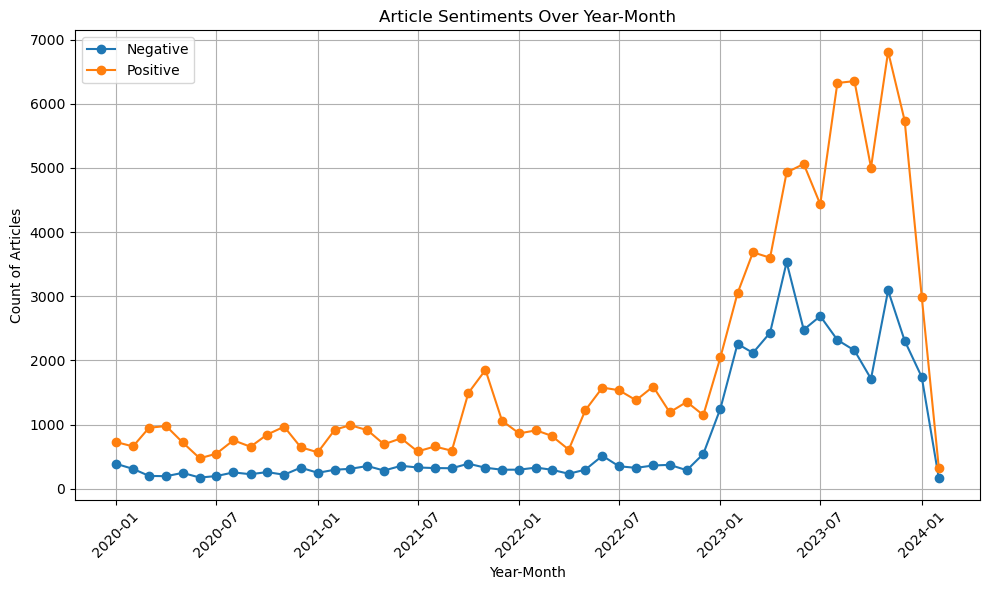

In [266]:

# Convert 'year' and 'month' columns to datetime format and create a new 'year-month' column
new_df['year-month'] = pd.to_datetime(new_df['year'].astype(str) + '-' + new_df['month'].astype(str))

# Plot the line graph
plt.figure(figsize=(10, 6))

# Plot line for '0'
plt.plot(new_df['year-month'], new_df['NEGATIVE'], label='Negative', marker='o')

# Plot line for '1'
plt.plot(new_df['year-month'], new_df['POSITIVE'], label='Positive', marker='o')

# Set labels and title
plt.xlabel('Year-Month')
plt.ylabel('Count of Articles')
plt.title('Article Sentiments Over Year-Month')
plt.xticks(rotation=45)
plt.legend()

# Show plot
plt.grid(True)
plt.tight_layout()
plt.show()

In [267]:

# Create a pivot table with 'year' and 'month' as regular columns
pivot_df1 = pivot_df.pivot_table(index=['year', 'month'], columns='new_column', values='POSITIVE', aggfunc='sum', dropna=False)

# Reset the index to convert 'year' and 'month' index levels into regular columns
pivot_df1.reset_index(inplace=True)
pivot_df1

new_column,year,month,AI Applications and Technologies,AI in Marketing,AI in Weather Related Information or Services,Data Science in Healthcare and Medicine,Ethical and Legal Implications of AI,Generative AI in Music,Machine Learning Models for Human Tasks
0,2020,1,144.0,56.0,135.0,54.0,87.0,173.0,79.0
1,2020,2,127.0,63.0,121.0,43.0,79.0,155.0,71.0
2,2020,3,208.0,72.0,166.0,69.0,101.0,235.0,99.0
3,2020,4,191.0,72.0,182.0,71.0,102.0,243.0,116.0
4,2020,5,126.0,57.0,129.0,56.0,79.0,180.0,94.0
5,2020,6,94.0,32.0,79.0,38.0,53.0,138.0,40.0
6,2020,7,102.0,40.0,104.0,43.0,52.0,143.0,62.0
7,2020,8,131.0,62.0,127.0,47.0,101.0,205.0,82.0
8,2020,9,136.0,42.0,117.0,39.0,61.0,183.0,76.0
9,2020,10,186.0,56.0,137.0,65.0,93.0,213.0,93.0


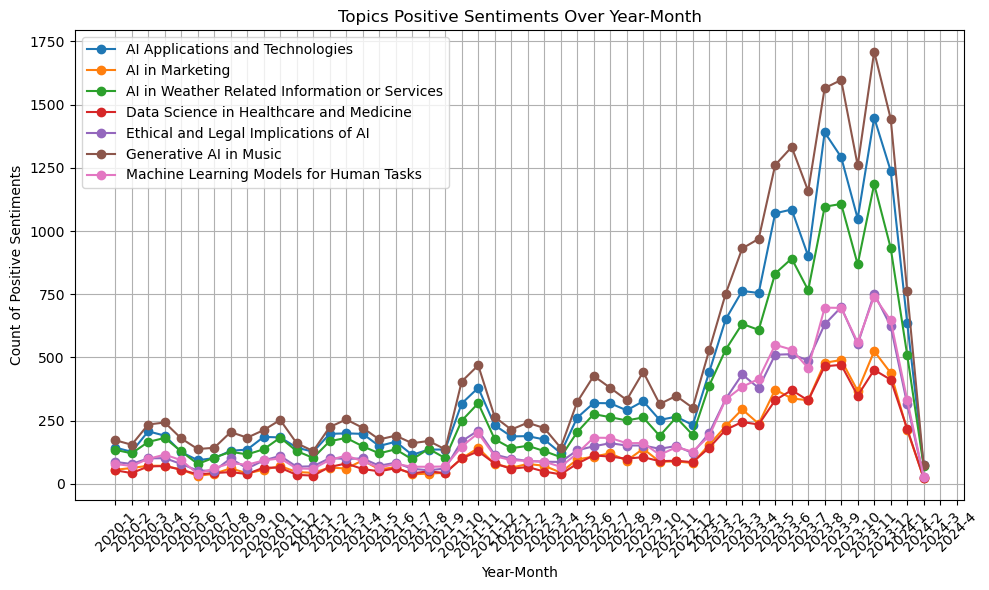

In [268]:

# Combine 'year' and 'month' columns into a single 'year-month' column
pivot_df1['year-month'] = pivot_df1['year'].astype(str) + '-' + pivot_df1['month'].astype(str)

# Plot the line chart
plt.figure(figsize=(10, 6))

# Iterate over each topic column and plot it as a separate line
for column in pivot_df1.columns[2:9]:
    plt.plot(pivot_df1['year-month'], pivot_df1[column], label=column, marker='o')

# Set labels and title
plt.xlabel('Year-Month')
plt.ylabel('Count of Positive Sentiments')
plt.title('Topics Positive Sentiments Over Year-Month')
plt.xticks(rotation=45)
plt.legend()

# Show plot
plt.grid(True)
plt.tight_layout()
plt.show()

In [269]:

# Create a pivot table with 'year' and 'month' as regular columns
pivot_df0 = pivot_df.pivot_table(index=['year', 'month'], columns='new_column', values='NEGATIVE', aggfunc='sum', dropna=False)

# Reset the index to convert 'year' and 'month' index levels into regular columns
pivot_df0.reset_index(inplace=True)
pivot_df0

new_column,year,month,AI Applications and Technologies,AI in Marketing,AI in Weather Related Information or Services,Data Science in Healthcare and Medicine,Ethical and Legal Implications of AI,Generative AI in Music,Machine Learning Models for Human Tasks
0,2020,1,87.0,25.0,53.0,32.0,42.0,113.0,37.0
1,2020,2,57.0,23.0,54.0,16.0,33.0,81.0,45.0
2,2020,3,35.0,14.0,48.0,16.0,21.0,41.0,25.0
3,2020,4,40.0,17.0,30.0,10.0,24.0,55.0,19.0
4,2020,5,46.0,18.0,49.0,17.0,27.0,65.0,25.0
5,2020,6,29.0,9.0,31.0,13.0,22.0,52.0,18.0
6,2020,7,32.0,11.0,31.0,14.0,25.0,60.0,24.0
7,2020,8,41.0,21.0,56.0,20.0,27.0,65.0,24.0
8,2020,9,47.0,19.0,39.0,9.0,19.0,69.0,24.0
9,2020,10,54.0,14.0,47.0,21.0,33.0,59.0,31.0


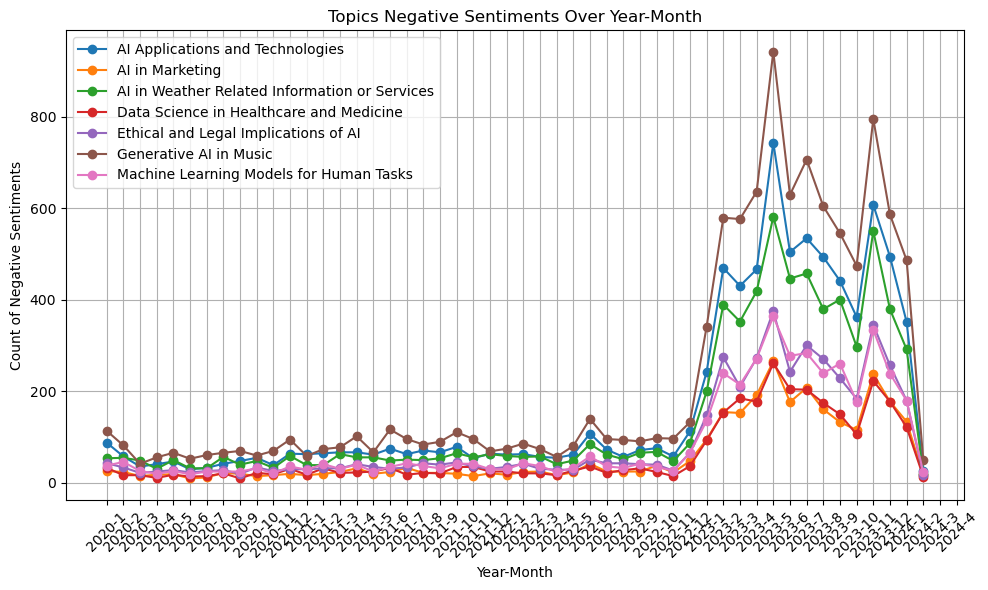

In [270]:

# Combine 'year' and 'month' columns into a single 'year-month' column
pivot_df0['year-month'] = pivot_df0['year'].astype(str) + '-' + pivot_df0['month'].astype(str)

# Plot the line chart
plt.figure(figsize=(10, 6))

# Iterate over each topic column and plot it as a separate line
for column in pivot_df0.columns[2:9]:
    plt.plot(pivot_df0['year-month'], pivot_df0[column], label=column, marker='o')

# Set labels and title
plt.xlabel('Year-Month')
plt.ylabel('Count of Negative Sentiments')
plt.title('Topics Negative Sentiments Over Year-Month')
plt.xticks(rotation=45)
plt.legend()

# Show plot
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
FILTER

## Healthcare Industry

In [277]:
keywords =['healthcare', 'medical', 'medicare', 'medicine', 'hospital', 'cancer', 'disease', 'sick', 'health care', 'diet', 'dieting', 'dietitian', 'wellness', 'health', 'drug', 'protein', 'clinical', 'doctor', 'nurse', 'fitness', 'surgeon', 'pharmacist', 'therapy', 'physical therapist', 'laboratories', 'cardiology', 'neurology', 'orthopedics', 'pediatrics', 'geriatrics', 'obstetrics', 'gynecology', 'radiology', 'radiologist', 'physical therapist', 'oncology', 'pharmaceutical', 'biotechnology', 'acupuncture', 'dentist', 'psychologist']

contains_title = filtered_df['title'].str.contains('|'.join(keywords), case=False).sum()

In [278]:
contains_title

9220

In [279]:
mask = filtered_df['title'].str.contains('|'.join(keywords), case=False)

In [280]:
filtered_df2 = filtered_df[mask]


In [281]:
filtered_df2

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column
3,http://www.sbwire.com/press-releases/healthcare-artificial-intelligence-market-next-big-thing-major-giants-general-electric-medtronic-aicure-apixio-1363690.htm,2022-10-06,Healthcare Artificial Intelligence Market Analysis and Forecast for Next 5 Years,"Healthcare Artificial Intelligence Market Analysis and Forecast for Next 5 Years SBWireSign UpLoginOur ServicePlans PricingNewsroomHelpAboutAMA Research amp Media LLP Email Alerts RSS Healthcare Artificial Intelligence Market Next Big Thing : Major Giants General Electric, Medtronic, AiCure, APIXIOHealthcare Artificial Intelligence Market 20222028 New Jersey, USA SBWIRE 10052022 Advance Market Analytics published a new research publication on Healthcare Artificial Intelligence Market Ins...",healthcare artificial intelligence market analysis forecast next years sbwiresign uploginour serviceplans pricingnewsroomhelpaboutama research amp media llp email alerts rss healthcare artificial intelligence market next big thing major giants general electric medtronic aicure apixiohealthcare artificial intelligence market new jersey usa sbwire advance market analytics published new research publication healthcare artificial intelligence market insights pages enriched selfexplained tables c...,8,2,11,18.181818,AI in Marketing
8,https://agenparl.eu/funding-boost-for-artificial-intelligence-in-nhs-to-speed-up-diagnosis-of-deadly-diseases/,2020-08-28,Funding boost for artificial intelligence in NHS to speed up diagnosis of deadly diseases — Agenparl,"Funding boost for artificial intelligence in NHS to speed up diagnosis of deadly diseases Agenparl sabato, Agosto 29, 2020Breaking News UK GOVERNMENT PROVIDES OVER 140 MILLION OF SUPPORT FOR EXPORTS TO GHANAFUNDING BOOST FOR ARTIFICIAL INTELLIGENCE IN NHS TO SPEED UP DIAGNOSIS OFSTRENGTHENING PUBLIC INVESTMENT MANAGEMENT IN THE EASTERN CARIBBEAN CURRENCY UNION: GETTING MORETACKLING PRIVATE OVERINDEBTEDNESS IN ASIA: ECONOMIC AND LEGAL ASPECTSDESTABILIZING STABILITY EXCHANGE RATE ARRANGEMENTS...",funding boost artificial intelligence nhs speed diagnosis deadly diseases agenparl sabato agosto breaking news uk government provides million support exports ghanafunding boost artificial intelligence nhs speed diagnosis ofstrengthening public investment management eastern caribbean currency union getting moretackling private overindebtedness asia economic legal aspectsdestabilizing stability exchange rate arrangements foreign currency debtcoordinating revenue incentive policies caribbeann...,15,1,16,6.250000,Data Science in Healthcare and Medicine
14,https://bigthink.com/health/harvard-ai-risk-pancreatic-cancer/,2023-07-15,Harvard AI predicts who is at risk of pancreatic cancer - Big Think,Harvard AI predicts who is at risk of pancreatic cancer Big Think Skip to content Video The Big Think InterviewYour Brain on MoneyPlaylistsExplore the Library Big Questions Will true AI turn against usDo we have free willWhy are there conspiracy theoriesIs religion helping or hurting usAre we alone in the universeShould we trust science Big Thinkers Michio KakuNeil deGrasse TysonMichelle ThallerZena HitzSteven PinkerPaul BloomRay KurzweilCornel WestHelen Fisher Sections NeuropsychThinkingLe...,harvard ai predicts risk pancreatic cancer big think skip content video big think interviewyour brain moneyplaylistsexplore library big questions true ai turn usdo free willwhy conspiracy theoriesis religion helping hurting usare alone universeshould trust science big thinkers michio kakuneil degrasse tysonmichelle thallerzena hitzsteven pinkerpaul bloomray kurzweilcornel westhelen fisher sections neuropsychthinkingleadershipsmart skillshigh culturethe pastthe presentthe futurelifehealthhard...,24,1,13,7.692308,Data Science in Healthcare and Medicine
30,https://citylife.capetown/is/science/e-tongue-ai-model-to-help-predict-bitterness-of-medicines/394712/,2023-10-04,"Researchers Use ""

In [282]:
# List of words to count occurrences for
words_to_count = ['healthcare', 'medical', 'medicare', 'medicine', 'hospital', 'cancer', 'disease', 'sick', 'health care', 'diet', 'dieting', 'dietitian', 'wellness', 'health', 'drug', 'protein', 'clinical', 'doctor', 'nurse', 'fitness', 'surgeon', 'pharmacist', 'therapy', 'physical therapist', 'laboratories', 'cardiology', 'neurology', 'orthopedics', 'pediatrics', 'geriatrics', 'obstetrics', 'gynecology', 'radiology', 'radiologist', 'physical therapist', 'oncology', 'pharmaceutical', 'biotechnology', 'acupuncture', 'dentist', 'psychologist']

# Create a regular expression pattern to match any of the words in the list
pattern = '|'.join(words_to_count)

# Count occurrences of words and store the counts in a new column 'Healthcare'
filtered_df2['Healthcare'] = filtered_df2['title'].str.lower().str.count(pattern, flags=re.IGNORECASE)

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\77675755.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Healthcare'] = filtered_df2['title'].str.lower().str.count(pattern, flags=re.IGNORECASE)


In [283]:
filtered_df2['Total_Words'] = filtered_df2['title'].str.split().apply(len)

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\1354618017.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Total_Words'] = filtered_df2['title'].str.split().apply(len)


In [284]:
filtered_df2['Healthcare_Percentage'] = (filtered_df2['Healthcare'] / filtered_df2['Total_Words']) * 100

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\240730045.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Healthcare_Percentage'] = (filtered_df2['Healthcare'] / filtered_df2['Total_Words']) * 100


In [285]:
pd.set_option('display.max_colwidth', 500)

In [286]:
healthcare_articles = filtered_df2[filtered_df2['Healthcare_Percentage'] > 1]
healthcare_articles.info()

<class 'pandas.core.frame.DataFrame'>
Index: 9220 entries, 3 to 143371
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   url                    9220 non-null   object 
 1   date                   9220 non-null   object 
 2   title                  9220 non-null   object 
 3   text_clean             9220 non-null   object 
 4   text_clean_2           9220 non-null   object 
 5   ID                     9220 non-null   int64  
 6   Key_Words              9220 non-null   int64  
 7   Total_Words            9220 non-null   int64  
 8   Key_Words_Percentage   9220 non-null   float64
 9   new_column             9098 non-null   object 
 10  Healthcare             9220 non-null   int64  
 11  Healthcare_Percentage  9220 non-null   float64
dtypes: float64(2), int64(4), object(6)
memory usage: 936.4+ KB


In [287]:
healthcare_articles['date'] = pd.to_datetime(healthcare_articles['date'])
healthcare_articles['year'] = healthcare_articles['date'].dt.year
healthcare_articles['month'] = healthcare_articles['date'].dt.month

In [288]:
healthcare_articles['year'].unique()

array([2022, 2020, 2023, 2021, 2024])

In [169]:
pd.set_option('display.max_colwidth', None)

In [289]:
filtered_df100 = filtered_df1[['url', 'date', 'sentiment']]

# Convert the 'date' column in both DataFrames to the same data type
healthcare_articles['date'] = pd.to_datetime(healthcare_articles['date'])
filtered_df100['date'] = pd.to_datetime(filtered_df100['date'])

# Merge the DataFrames
merged_df = pd.merge(healthcare_articles, filtered_df100[['url', 'date', 'sentiment']], on=['url', 'date'], how='left')


C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\154487493.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df100['date'] = pd.to_datetime(filtered_df100['date'])


In [290]:
merged_df

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column,Healthcare,Healthcare_Percentage,year,month,sentiment
0,http://www.sbwire.com/press-releases/healthcare-artificial-intelligence-market-next-big-thing-major-giants-general-electric-medtronic-aicure-apixio-1363690.htm,2022-10-06,Healthcare Artificial Intelligence Market Analysis and Forecast for Next 5 Years,"Healthcare Artificial Intelligence Market Analysis and Forecast for Next 5 Years SBWireSign UpLoginOur ServicePlans PricingNewsroomHelpAboutAMA Research amp Media LLP Email Alerts RSS Healthcare Artificial Intelligence Market Next Big Thing : Major Giants General Electric, Medtronic, AiCure, APIXIOHealthcare Artificial Intelligence Market 20222028 New Jersey, USA SBWIRE 10052022 Advance Market Analytics published a new research publication on Healthcare Artificial Intelligence Market Ins...",healthcare artificial intelligence market analysis forecast next years sbwiresign uploginour serviceplans pricingnewsroomhelpaboutama research amp media llp email alerts rss healthcare artificial intelligence market next big thing major giants general electric medtronic aicure apixiohealthcare artificial intelligence market new jersey usa sbwire advance market analytics published new research publication healthcare artificial intelligence market insights pages enriched selfexplained tables c...,8,2,11,18.181818,AI in Marketing,1,9.090909,2022,10,POSITIVE
1,https://agenparl.eu/funding-boost-for-artificial-intelligence-in-nhs-to-speed-up-diagnosis-of-deadly-diseases/,2020-08-28,Funding boost for artificial intelligence in NHS to speed up diagnosis of deadly diseases — Agenparl,"Funding boost for artificial intelligence in NHS to speed up diagnosis of deadly diseases Agenparl sabato, Agosto 29, 2020Breaking News UK GOVERNMENT PROVIDES OVER 140 MILLION OF SUPPORT FOR EXPORTS TO GHANAFUNDING BOOST FOR ARTIFICIAL INTELLIGENCE IN NHS TO SPEED UP DIAGNOSIS OFSTRENGTHENING PUBLIC INVESTMENT MANAGEMENT IN THE EASTERN CARIBBEAN CURRENCY UNION: GETTING MORETACKLING PRIVATE OVERINDEBTEDNESS IN ASIA: ECONOMIC AND LEGAL ASPECTSDESTABILIZING STABILITY EXCHANGE RATE ARRANGEMENTS...",funding boost artificial intelligence nhs speed diagnosis deadly diseases agenparl sabato agosto breaking news uk government provides million support exports ghanafunding boost artificial intelligence nhs speed diagnosis ofstrengthening public investment management eastern caribbean currency union getting moretackling private overindebtedness asia economic legal aspectsdestabilizing stability exchange rate arrangements foreign currency debtcoordinating revenue incentive policies caribbeann...,15,1,16,6.250000,Data Science in Healthcare and Medicine,1,6.250000,2020,8,POSITIVE
2,https://bigthink.com/health/harvard-ai-risk-pancreatic-cancer/,2023-07-15,Harvard AI predicts who is at risk of pancreatic cancer - Big Think,Harvard AI predicts who is at risk of pancreatic cancer Big Think Skip to content Video The Big Think InterviewYour Brain on MoneyPlaylistsExplore the Library Big Questions Will true AI turn against usDo we have free willWhy are there conspiracy theoriesIs religion helping or hurting usAre we alone in the universeShould we trust science Big Thinkers Michio KakuNeil deGrasse TysonMichelle ThallerZena HitzSteven PinkerPaul BloomRay KurzweilCornel WestHelen Fisher Sections NeuropsychThinkingLe...,harvard ai predicts risk pancreatic cancer big think skip content video big think interviewyour brain moneyplaylistsexplore library big questions true ai turn usdo free willwhy conspiracy theoriesis religion helping hurting usare alone universeshould trust science big thinkers michio kakuneil degrasse tysonmichelle thallerzena hitzsteven pinkerpaul bloomray kurzweilcornel westhelen fisher sections neuropsychthinkingleadershipsmart skillshigh culturethe pastthe presentthe futurelifehealthhard...,24,1,13,7.692308,Data Science in Healthcare and Medicine,1,7.692308,2023,7,NEGATIVE
3

In [297]:
# Assuming filtered_df1 is your DataFrame
pivot_df = merged_df.pivot_table(index=['year', 'month'], columns='sentiment', aggfunc='size', fill_value=0).reset_index()


# Define a function to derive the 'Majority_Sentiment' column
def derive_sentiment(row):
    if row['NEGATIVE'] > row['POSITIVE']:
        return 'NEGATIVE'
    elif row['POSITIVE'] > row['NEGATIVE']:
        return 'POSITIVE'
    else:
        return 'NEUTRAL'  # Handle the case where '0' and '1' are equal

# Apply the function to each row to derive the 'Majority_Sentiment' column
pivot_df['Majority_Sentiment'] = pivot_df.apply(derive_sentiment, axis=1)
pivot_df

sentiment,year,month,NEGATIVE,POSITIVE,Majority_Sentiment
0,2020,1,37,66,POSITIVE
1,2020,2,17,57,POSITIVE
2,2020,3,12,110,POSITIVE
3,2020,4,17,93,POSITIVE
4,2020,5,11,65,POSITIVE
5,2020,6,15,53,POSITIVE
6,2020,7,8,36,POSITIVE
7,2020,8,9,56,POSITIVE
8,2020,9,25,86,POSITIVE
9,2020,10,24,91,POSITIVE


In [298]:
import matplotlib.pyplot as plt
import seaborn as sns 
from matplotlib.colors import ListedColormap

In [299]:
grouped_df_v2 = pivot_df.groupby('year')[['NEGATIVE', 'POSITIVE']].sum()


grouped_df_v2['total'] = grouped_df_v2['NEGATIVE'] + grouped_df_v2['POSITIVE']
grouped_df_v2['percentage_0'] = grouped_df_v2['NEGATIVE'] / grouped_df_v2['total'] * 100
grouped_df_v2['percentage_1'] = grouped_df_v2['POSITIVE'] / grouped_df_v2['total'] * 100
grouped_df_v2

sentiment,NEGATIVE,POSITIVE,total,percentage_0,percentage_1
year,,,,,
2020,203,890,1093,18.572736,81.427264
2021,266,1231,1497,17.768871,82.231129
2022,305,1673,1978,15.419616,84.580384
2023,791,3708,4499,17.581685,82.418315
2024,32,121,153,20.915033,79.084967


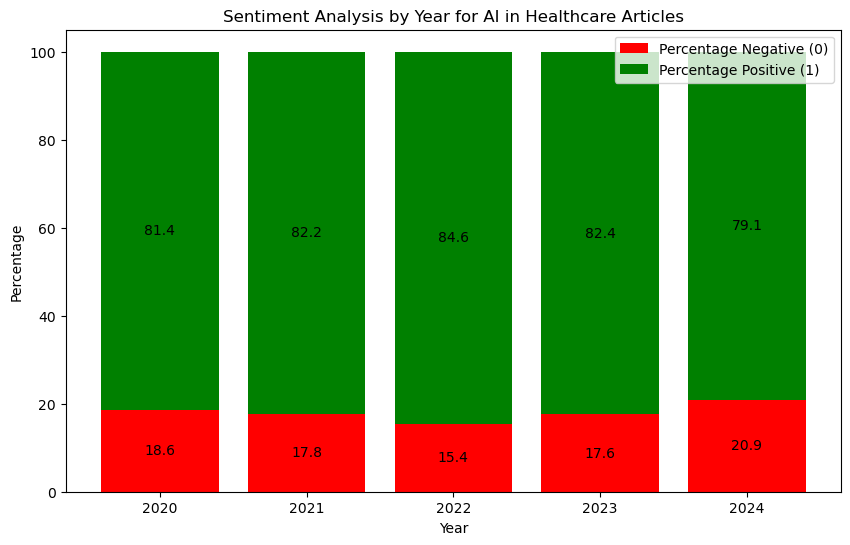

In [300]:
# Plotting
plt.figure(figsize=(10, 6))

# Stacked bar plot with custom colors
bar1 = plt.bar(grouped_df_v2.index, grouped_df_v2['percentage_0'], label='Percentage Negative (0)', color='red')
bar2 = plt.bar(grouped_df_v2.index, grouped_df_v2['percentage_1'], bottom=grouped_df_v2['percentage_0'], label='Percentage Positive (1)', color='green')

# Adding labels on top of each bar
for bars in [bar1, bar2]:
    for bar in bars:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width() / 2, bar.get_y() + bar.get_height() / 2, round(yval, 1),
                 va='center', ha='center')

# Adding labels and title
plt.xlabel('Year')
plt.ylabel('Percentage')
plt.title('Sentiment Analysis by Year for AI in Healthcare Articles')
plt.legend()

# Set the x-ticks to actual year values
plt.xticks(grouped_df_v2.index)  # Assuming the index contains the actual year values

# Display the plot
plt.show()

In [301]:
import matplotlib.ticker as mtick


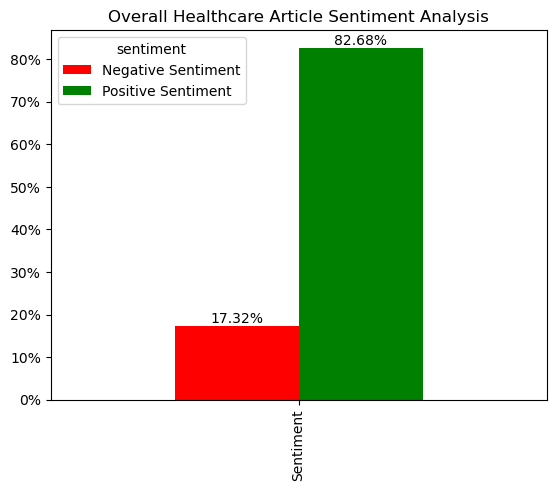

In [302]:
# Summing all values into a single row
sum_row = grouped_df_v2.sum(axis=0)

# Creating a new DataFrame with the summed values
new_df = pd.DataFrame(sum_row).transpose()
new_df = new_df[['NEGATIVE', 'POSITIVE', 'total']]
new_df['Negative Sentiment'] = round(new_df['NEGATIVE']/new_df['total'] *100,2)
new_df['Positive Sentiment'] = round(new_df['POSITIVE']/new_df['total'] *100,2)
new_df = new_df[['Negative Sentiment', 'Positive Sentiment']]


# Custom labels for the x-axis
custom_labels = ['Sentiment']
new_df.index = custom_labels


# Plotting with specified colors
ax = new_df.plot(kind='bar', color=['red', 'green'])


# Adding labels inside the bars
for p in ax.patches:
    ax.annotate(f'{p.get_height():.2f}%', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 5), 
                textcoords='offset points')

# Adding title
plt.title('Overall Healthcare Article Sentiment Analysis')

# Formatting y-axis as percentage
ax.yaxis.set_major_formatter(mtick.PercentFormatter())
plt.show()

In [372]:
import matplotlib.pyplot as plt
import seaborn as sns 
from matplotlib.colors import ListedColormap

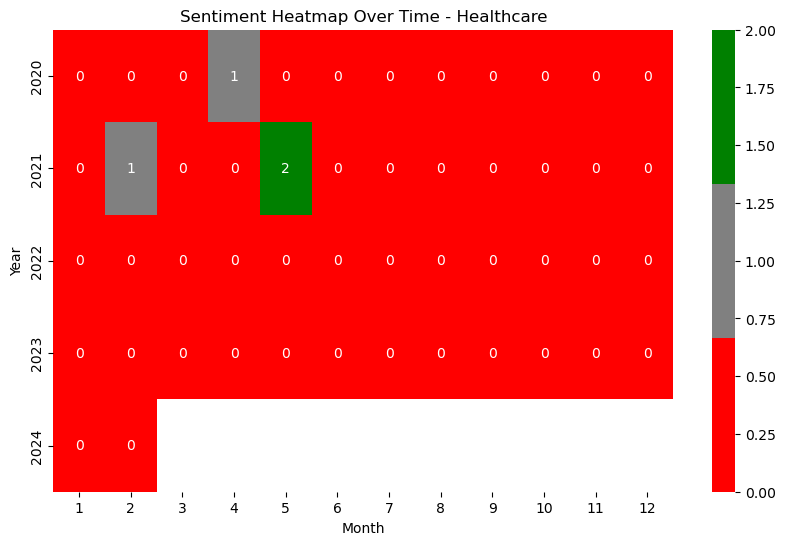

In [373]:
# Pivot the DataFrame to have 'year' as rows, 'month' as columns, and 'Majority_Sentiment' as values
pivot_df = grouped_df.pivot_table(index='year', columns='month', values='Majority_Sentiment')
pivot_df = pivot_df.apply(pd.to_numeric)

# Creating a custom colormap
custom_colors = ['red', 'grey', 'green']
cmap = ListedColormap(custom_colors)

# Plot the heatmap with custom colormap
plt.figure(figsize=(10, 6))
sns.heatmap(pivot_df, cmap=cmap, annot=True, fmt='g', cbar=True)
plt.title('Sentiment Heatmap Over Time - Healthcare')
plt.xlabel('Month')
plt.ylabel('Year')
plt.show()

In [67]:
pd.set_option('display.max_colwidth', 500)

In [ ]:
['finance', 'fintech', 'financial', 'bank', 'banking', 'real estate', 'tax', 'stock market', 'capital market', 'risk management', 'hedge fund', 'wall street', 'investment firm', 'brokerage', 'transaction', 'money laundering', 'payments', 'credit', 'debit card', 'loan', ' lender ', 'mutual fund', 'exchange-traded', 'interest rate', 'venture capital', 'wealth management']

## Financial Industry

In [303]:
keywords = ['finance', 'fintech', 'financial', 'bank', 'banking', 'bank teller', 'real estate', 'tax', 'tax advisor', 'stock market', 'capital market', 'risk management', 'hedge fund', 'wall street', 'investment firm', 'brokerage', 'transaction', 'money laundering', 'payments', 'credit', 'debit card', 'loan', 'lender', 'mutual fund', 'exchange-traded', 'interest rate', 'venture capital', 'wealth management', 'investor', 'accountant', 'auditor', 'financial analyst', 'financial planner', 'investment banker']
contains_title = filtered_df['title'].str.contains('|'.join(keywords), case=False).sum()

In [304]:
contains_title

5128

In [305]:
mask = filtered_df['title'].str.contains('|'.join(keywords), case=False)

In [306]:
filtered_df2 = filtered_df[mask]

In [307]:
filtered_df2

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column
191,https://www.americanbankingnews.com/2022/02/21/decentralized-machine-learning-market-cap-hits-176603-83-dml.html,2022-02-21,"Decentralized Machine Learning Market Cap Hits $176,603.83 (DML) - American Banking News","Decentralized Machine Learning Market Cap Hits 176,603.83 DML American Banking NewsSkip to main contentHomeAboutNewsletterPrivacyContact Analyst RatingsDividendsEarningsGuidanceHighs and LowsIPOSOptionsSEC Filings HomeAboutNewsletterPrivacyContactAnalyst RatingsDividendsEarningsGuidanceHighs and LowsIPOSOptionsSEC FilingsDecentralized Machine Learning Market Cap Hits 176,603.83 DMLPosted by ABMN Staff on Feb 21st, 2022Share on TwitterShare on FacebookShare on LinkedInShare on StocktwitsDece...",decentralized machine learning market cap hits dml american banking newsskip main contenthomeaboutnewsletterprivacycontact analyst ratingsdividendsearningsguidancehighs lowsiposoptionssec filings homeaboutnewsletterprivacycontactanalyst ratingsdividendsearningsguidancehighs lowsiposoptionssec filingsdecentralized machine learning market cap hits dmlposted abmn staff feb st share twittershare facebookshare linkedinshare stocktwitsdecentralized machine learning currencydml traded higher us dol...,274,1,12,8.333333,AI Applications and Technologies
206,https://www.biznews.com/global-investing/2023/11/26/tyler-cowen-ai-boom-reshapes-real-estate-winners-losers,2023-11-27,🔒 Tyler Cowen: AI boom reshapes real estate winners and losers,Tyler Cowen: AI boom reshapes real estate winners and losersSkip to content BizNews PremiumThe world is changing fast and to keep up you need local knowledge with global context.Try BizNews Premium BizNews PremiumThe world is changing fast and to keep up you need local knowledge with global context.Try BizNews Premium Menu HomeBNC archivesRegister BNC ManagementGlobal CitizenGlobal InvestingSA InvestingWealth AdvisorsOpinionInterviewsMailboxThought LeadersUndictatedGood HopeSponsoredArticle...,tyler cowen ai boom reshapes real estate winners losersskip content biznews premiumthe world changing fast keep need local knowledge global contexttry biznews premium biznews premiumthe world changing fast keep need local knowledge global contexttry biznews premium menu homebnc archivesregister bnc managementglobal citizenglobal investingsa investingwealth advisorsopinioninterviewsmailboxthought leadersundictatedgood hopesponsoredarticlesboardroom talk tyler cowen ai boom reshapes real est...,297,1,11,9.090909,Generative AI in Music
210,https://www.bnnbloomberg.ca/hedge-funds-are-deploying-chatgpt-to-handle-all-the-grunt-work-1.1926967,2023-06-02,Hedge Funds Are Deploying ChatGPT to Handle All the Grunt Work - BNN Bloomberg,Hedge Funds Are Deploying ChatGPT to Handle All the Grunt Work BNN Bloomberg currentBoardShortName MarketsIndicesCurrenciesEnergyMetalsdata.symbol reutersRICLabelFormat:group.RICS data.netChng number: 4 data.netChng number: 2 data displayCurrencySymbol data.price number: 4 data.price number: 2 data.symbol reutersRICLabelFormat:group.RICS data.netChng number: 4 data.netChng number: 2 data displayCurrencySymbol data.price number: 4 data.price number: 2 MarketsAs of: timeStamp.date...,hedge funds deploying chatgpt handle grunt work bnn bloomberg currentboardshortname marketsindicescurrenciesenergymetalsdatasymbol reutersriclabelformatgrouprics datanetchng number datanetchng number data displaycurrencysymbol dataprice number dataprice number datasymbol reutersriclabelformatgrouprics datanetchng number datanetchng number data displaycurrencysymbol dataprice number dataprice number marketsas timestampdate timestamptimemarkets currentboardshortname marketsindicescurrenciesene...,304,1,14,7.142857,AI in Weather Related Information or Services
242,https://www.com-unik.info/2022/04/25/matrix-ai-network-one-day-volume-reaches-550187-00-man.html,2022-04-25,"Matrix AI Network One Day Volume Reaches $550,187

In [308]:
# List of words to count occurrences for
words_to_count = ['finance', 'fintech', 'financial', 'bank', 'banking', 'bank teller', 'real estate', 'tax', 'tax advisor', 'stock market', 'capital market', 'risk management', 'hedge fund', 'wall street', 'investment firm', 'brokerage', 'transaction', 'money laundering', 'payments', 'credit', 'debit card', 'loan', 'lender', 'mutual fund', 'exchange-traded', 'interest rate', 'venture capital', 'wealth management', 'investor', 'accountant', 'auditor', 'financial analyst', 'financial planner', 'investment banker']

# Create a regular expression pattern to match any of the words in the list
pattern = '|'.join(words_to_count)

# Count occurrences of words and store the counts in a new column 'Healthcare'
filtered_df2['Healthcare'] = filtered_df2['title'].str.lower().str.count(pattern, flags=re.IGNORECASE)

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\888619805.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Healthcare'] = filtered_df2['title'].str.lower().str.count(pattern, flags=re.IGNORECASE)


In [309]:
filtered_df2['Total_Words'] = filtered_df2['title'].str.split().apply(len)

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\1354618017.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Total_Words'] = filtered_df2['title'].str.split().apply(len)


In [310]:
filtered_df2['Healthcare_Percentage'] = (filtered_df2['Healthcare'] / filtered_df2['Total_Words']) * 100

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\240730045.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Healthcare_Percentage'] = (filtered_df2['Healthcare'] / filtered_df2['Total_Words']) * 100


In [311]:
financial_articles = filtered_df2[filtered_df2['Healthcare_Percentage'] > 1]
financial_articles.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5128 entries, 191 to 143268
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   url                    5128 non-null   object 
 1   date                   5128 non-null   object 
 2   title                  5128 non-null   object 
 3   text_clean             5128 non-null   object 
 4   text_clean_2           5128 non-null   object 
 5   ID                     5128 non-null   int64  
 6   Key_Words              5128 non-null   int64  
 7   Total_Words            5128 non-null   int64  
 8   Key_Words_Percentage   5128 non-null   float64
 9   new_column             5060 non-null   object 
 10  Healthcare             5128 non-null   int64  
 11  Healthcare_Percentage  5128 non-null   float64
dtypes: float64(2), int64(4), object(6)
memory usage: 520.8+ KB


In [312]:
financial_articles['date'] = pd.to_datetime(financial_articles['date'])
financial_articles['year'] = financial_articles['date'].dt.year
financial_articles['month'] = financial_articles['date'].dt.month

In [313]:
financial_articles['year'].unique()

array([2022, 2023, 2024, 2021, 2020])

In [314]:
financial_articles

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column,Healthcare,Healthcare_Percentage,year,month
191,https://www.americanbankingnews.com/2022/02/21/decentralized-machine-learning-market-cap-hits-176603-83-dml.html,2022-02-21,"Decentralized Machine Learning Market Cap Hits $176,603.83 (DML) - American Banking News","Decentralized Machine Learning Market Cap Hits 176,603.83 DML American Banking NewsSkip to main contentHomeAboutNewsletterPrivacyContact Analyst RatingsDividendsEarningsGuidanceHighs and LowsIPOSOptionsSEC Filings HomeAboutNewsletterPrivacyContactAnalyst RatingsDividendsEarningsGuidanceHighs and LowsIPOSOptionsSEC FilingsDecentralized Machine Learning Market Cap Hits 176,603.83 DMLPosted by ABMN Staff on Feb 21st, 2022Share on TwitterShare on FacebookShare on LinkedInShare on StocktwitsDece...",decentralized machine learning market cap hits dml american banking newsskip main contenthomeaboutnewsletterprivacycontact analyst ratingsdividendsearningsguidancehighs lowsiposoptionssec filings homeaboutnewsletterprivacycontactanalyst ratingsdividendsearningsguidancehighs lowsiposoptionssec filingsdecentralized machine learning market cap hits dmlposted abmn staff feb st share twittershare facebookshare linkedinshare stocktwitsdecentralized machine learning currencydml traded higher us dol...,274,1,12,8.333333,AI Applications and Technologies,1,8.333333,2022,2
206,https://www.biznews.com/global-investing/2023/11/26/tyler-cowen-ai-boom-reshapes-real-estate-winners-losers,2023-11-27,🔒 Tyler Cowen: AI boom reshapes real estate winners and losers,Tyler Cowen: AI boom reshapes real estate winners and losersSkip to content BizNews PremiumThe world is changing fast and to keep up you need local knowledge with global context.Try BizNews Premium BizNews PremiumThe world is changing fast and to keep up you need local knowledge with global context.Try BizNews Premium Menu HomeBNC archivesRegister BNC ManagementGlobal CitizenGlobal InvestingSA InvestingWealth AdvisorsOpinionInterviewsMailboxThought LeadersUndictatedGood HopeSponsoredArticle...,tyler cowen ai boom reshapes real estate winners losersskip content biznews premiumthe world changing fast keep need local knowledge global contexttry biznews premium biznews premiumthe world changing fast keep need local knowledge global contexttry biznews premium menu homebnc archivesregister bnc managementglobal citizenglobal investingsa investingwealth advisorsopinioninterviewsmailboxthought leadersundictatedgood hopesponsoredarticlesboardroom talk tyler cowen ai boom reshapes real est...,297,1,11,9.090909,Generative AI in Music,1,9.090909,2023,11
210,https://www.bnnbloomberg.ca/hedge-funds-are-deploying-chatgpt-to-handle-all-the-grunt-work-1.1926967,2023-06-02,Hedge Funds Are Deploying ChatGPT to Handle All the Grunt Work - BNN Bloomberg,Hedge Funds Are Deploying ChatGPT to Handle All the Grunt Work BNN Bloomberg currentBoardShortName MarketsIndicesCurrenciesEnergyMetalsdata.symbol reutersRICLabelFormat:group.RICS data.netChng number: 4 data.netChng number: 2 data displayCurrencySymbol data.price number: 4 data.price number: 2 data.symbol reutersRICLabelFormat:group.RICS data.netChng number: 4 data.netChng number: 2 data displayCurrencySymbol data.price number: 4 data.price number: 2 MarketsAs of: timeStamp.date...,hedge funds deploying chatgpt handle grunt work bnn bloomberg currentboardshortname marketsindicescurrenciesenergymetalsdatasymbol reutersriclabelformatgrouprics datanetchng number datanetchng number data displaycurrencysymbol dataprice number dataprice number datasymbol reutersriclabelformatgrouprics datanetchng number datanetchng number data displaycurrencysymbol dataprice number dataprice number marketsas timestampdate timestamptimemarkets currentboardshortname marketsindicescurrenciesene...,304,1,14,7.142857,AI in Weather Related Information or Services,1,7.142857,2023,6
242,https://www.com-unik.info/2022/04/25/matrix-ai-network-one-

In [315]:
pd.set_option('display.max_colwidth', 500)

In [316]:
filtered_df100 = filtered_df1[['url', 'date', 'sentiment']]

# Convert the 'date' column in both DataFrames to the same data type
financial_articles['date'] = pd.to_datetime(financial_articles['date'])
filtered_df100['date'] = pd.to_datetime(filtered_df100['date'])

# Merge the DataFrames
merged_df = pd.merge(financial_articles, filtered_df100[['url', 'date', 'sentiment']], on=['url', 'date'], how='left')


C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\3513402376.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df100['date'] = pd.to_datetime(filtered_df100['date'])


In [317]:
# Assuming filtered_df1 is your DataFrame
pivot_df = merged_df.pivot_table(index=['year', 'month'], columns='sentiment', aggfunc='size', fill_value=0).reset_index()



# Define a function to derive the 'Majority_Sentiment' column
def derive_sentiment(row):
    if row['NEGATIVE'] > row['POSITIVE']:
        return 'NEGATIVE'
    elif row['POSITIVE'] > row['NEGATIVE']:
        return 'POSITIVE'
    else:
        return 'NEUTRAL'  # Handle the case where '0' and '1' are equal

# Apply the function to each row to derive the 'Majority_Sentiment' column
pivot_df['Majority_Sentiment'] = pivot_df.apply(derive_sentiment, axis=1)
pivot_df

sentiment,year,month,NEGATIVE,POSITIVE,Majority_Sentiment
0,2020,1,18,32,POSITIVE
1,2020,2,21,51,POSITIVE
2,2020,3,16,46,POSITIVE
3,2020,4,16,34,POSITIVE
4,2020,5,14,25,POSITIVE
5,2020,6,5,19,POSITIVE
6,2020,7,10,15,POSITIVE
7,2020,8,12,17,POSITIVE
8,2020,9,8,19,POSITIVE
9,2020,10,11,40,POSITIVE


In [318]:
grouped_df_v2 = pivot_df.groupby('year')[['NEGATIVE', 'POSITIVE']].sum()


grouped_df_v2['total'] = grouped_df_v2['NEGATIVE'] + grouped_df_v2['POSITIVE']
grouped_df_v2['percentage_0'] = grouped_df_v2['NEGATIVE'] / grouped_df_v2['total'] * 100
grouped_df_v2['percentage_1'] = grouped_df_v2['POSITIVE'] / grouped_df_v2['total'] * 100
grouped_df_v2

sentiment,NEGATIVE,POSITIVE,total,percentage_0,percentage_1
year,,,,,
2020,146,360,506,28.853755,71.146245
2021,415,444,859,48.311991,51.688009
2022,309,502,811,38.101110,61.898890
2023,986,1817,2803,35.176597,64.823403
2024,61,88,149,40.939597,59.060403


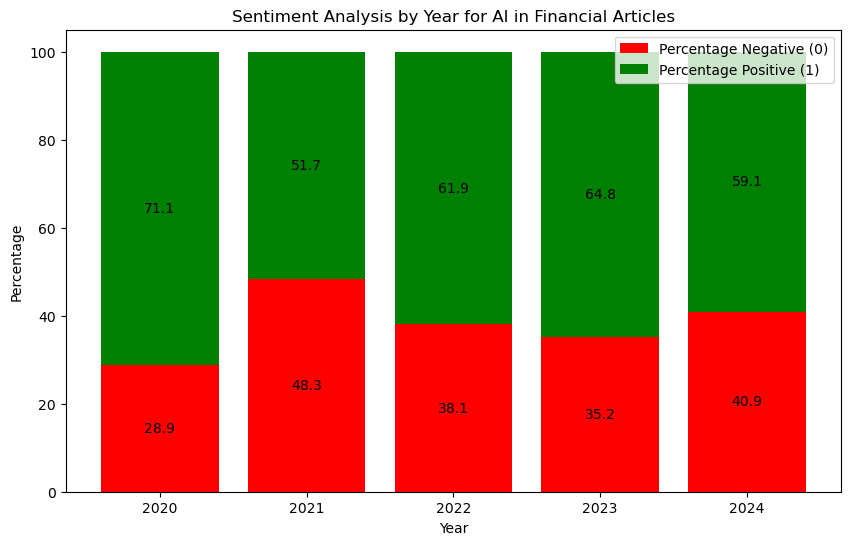

In [319]:
# Plotting
plt.figure(figsize=(10, 6))

# Stacked bar plot with custom colors
bar1 = plt.bar(grouped_df_v2.index, grouped_df_v2['percentage_0'], label='Percentage Negative (0)', color='red')
bar2 = plt.bar(grouped_df_v2.index, grouped_df_v2['percentage_1'], bottom=grouped_df_v2['percentage_0'], label='Percentage Positive (1)', color='green')

# Adding labels on top of each bar
for bars in [bar1, bar2]:
    for bar in bars:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width() / 2, bar.get_y() + bar.get_height() / 2, round(yval, 1),
                 va='center', ha='center')

# Adding labels and title
plt.xlabel('Year')
plt.ylabel('Percentage')
plt.title('Sentiment Analysis by Year for AI in Financial Articles')
plt.legend()

# Set the x-ticks to actual year values
plt.xticks(grouped_df_v2.index)  # Assuming the index contains the actual year values

# Display the plot
plt.show()

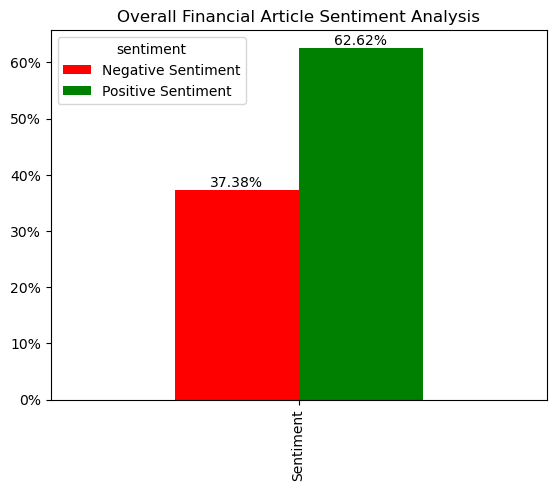

In [320]:
# Summing all values into a single row
sum_row = grouped_df_v2.sum(axis=0)

# Creating a new DataFrame with the summed values
new_df = pd.DataFrame(sum_row).transpose()
new_df = new_df[['NEGATIVE', 'POSITIVE', 'total']]
new_df['Negative Sentiment'] = round(new_df['NEGATIVE']/new_df['total'] *100,2)
new_df['Positive Sentiment'] = round(new_df['POSITIVE']/new_df['total'] *100,2)
new_df = new_df[['Negative Sentiment', 'Positive Sentiment']]


# Custom labels for the x-axis
custom_labels = ['Sentiment']
new_df.index = custom_labels


# Plotting with specified colors
ax = new_df.plot(kind='bar', color=['red', 'green'])


# Adding labels inside the bars
for p in ax.patches:
    ax.annotate(f'{p.get_height():.2f}%', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 5), 
                textcoords='offset points')

# Adding title
plt.title('Overall Financial Article Sentiment Analysis')

# Formatting y-axis as percentage
ax.yaxis.set_major_formatter(mtick.PercentFormatter())
plt.show()

## Education Industry

In [321]:
keywords = ['education', 'teacher', 'tutor', 'academic advisor', 'pupils', 'students', 'classroom', 'professor', 'homework', 'teaching', 'elementary school', 'public school', 'private school', 'school', 'coursework', 'curriculum', "bachelor's", "master’s", 'principal', 'academic', 'lecturer']
contains_title = filtered_df['title'].str.contains('|'.join(keywords), case=False).sum()

In [322]:
contains_title

3568

In [323]:
mask = filtered_df['title'].str.contains('|'.join(keywords), case=False)

In [324]:
filtered_df2 = filtered_df[mask]

In [325]:
filtered_df2

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column
43,https://digiday.com/media-buying/trade-school-founder-genna-franconi-on-the-influencer-content-business-and-future-of-ai/,2023-07-10,Trade School founder Genna Franconi on the influencer content business and future of AI - Digiday,"Trade School founder Genna Franconi on the influencer content business and future of AI Digiday Subscribe LoginHi, ReaderDigiday homepageFAQAccount OverviewLogoutNewsDigiday PodcastsEventsAwardsNewsDigiday PodcastsEventsAwardsHot TopicsThe Programmatic PublisherThe Programmatic MarketerMarketing on PlatformsLife Beyond the CookieBrands in CultureGaming EsportsModern NewsroomAll Topics LoginSubscribeMy AccountLogoutSpecial ProjectsDigiday ResearchWTF Series As users, marketers undertake Thr...",trade school founder genna franconi influencer content business future ai digiday subscribe loginhi readerdigiday homepagefaqaccount overviewlogoutnewsdigiday podcastseventsawardsnewsdigiday podcastseventsawardshot topicsthe programmatic publisherthe programmatic marketermarketing platformslife beyond cookiebrands culturegaming esportsmodern newsroomall topics loginsubscribemy accountlogoutspecial projectsdigiday researchwtf series users marketers undertake threads pread experimentationmedia...,64,1,16,6.250000,AI Applications and Technologies
86,https://ktla.com/news/nexstar-media-wire/professor-attempts-to-fail-students-after-falsely-accusing-them-of-using-chatgpt-to-cheat/,2023-05-18,Professor attempts to fail students after falsely accusing them of using ChatGPT to cheat | KTLA,Professor attempts to fail students after falsely accusing them of using ChatGPT to cheat KTLASkip to contentKTLALos Angeles67LIVE NOWKTLA 5 News at Noon Sign UpLos Angeles67LIVESponsored By Toggle MenuOpen NavigationClose NavigationSearchPlease enter a search term.Primary MenuWatch Live NewsLocal NewsEntertainmentConsumer NewsCaliforniaNational World NewsMy Very Own StoryInside California PoliticsFoodSportsKTLA Mobile AppGet Breaking News AlertsEmail NewslettersTechnologyAutomotive NewsBe...,professor attempts fail students falsely accusing using chatgpt cheat ktlaskip contentktlalos angeleslive nowktla news noon sign uplos angeleslivesponsored toggle menuopen navigationclose navigationsearchplease enter search termprimary menuwatch live newslocal newsentertainmentconsumer newscalifornianational world newsmy storyinside california politicsfoodsportsktla mobile appget breaking news alertsemail newsletterstechnologyautomotive newsbestreviewsbestreviews daily dealsregional news par...,129,1,16,6.250000,AI in Weather Related Information or Services
125,https://sciencein.me/2020/04/14/artificial-intelligence-ai-in-education-market-report-2020-performance-outlook-competitive-landscape-trends-and-opportunities-statistical-forecasts-2026/,2020-04-14,"Artificial Intelligence (AI) in Education Market Report 2020, Performance Outlook, Competitive Landscape, Trends and Opportunities, Statistical Forecasts 2026 – Science In Me","Artificial Intelligence AI in Education Market Report 2020, Performance Outlook, Competitive Landscape, Trends and Opportunities, Statistical Forecasts 2026 Science In MePress Enter to skip to contentSearchSearch Science In Me Our WritersAbout UsContact UsTerms and ConditionsPrivacy PolicyScience In MeApril 14, 2020Science, Space, Satellite and Energy Markets open menu BackApplied SciencesAstronomyEarth and EnvironmentEnergyHealthNASASpaceTechnologySatelliteAll NewsArtificial Intelligence A...",artificial intelligence ai education market report performance outlook competitive landscape trends opportunities statistical forecasts science mepress enter skip contentsearchsearch science writersabout uscontact usterms conditionsprivacy policyscience meapril science space satellite energy markets open menu backapplied sciencesastronomyearth environmentenergyhealthnasaspacetechnologysatelliteall newsartificial intelligence ai edu

In [326]:
# List of words to count occurrences for
words_to_count = ['education', 'teacher', 'tutor', 'academic advisor', 'pupils', 'students', 'classroom', 'professor', 'homework', 'teaching', 'elementary school', 'public school', 'private school', 'school', 'coursework', 'curriculum', "bachelor's", "master’s", 'principal', 'academic', 'lecturer']

# Create a regular expression pattern to match any of the words in the list
pattern = '|'.join(words_to_count)

# Count occurrences of words and store the counts in a new column 'Healthcare'
filtered_df2['Healthcare'] = filtered_df2['title'].str.lower().str.count(pattern, flags=re.IGNORECASE)

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\1609342902.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Healthcare'] = filtered_df2['title'].str.lower().str.count(pattern, flags=re.IGNORECASE)


In [327]:
filtered_df2['Total_Words'] = filtered_df2['title'].str.split().apply(len)

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\1354618017.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Total_Words'] = filtered_df2['title'].str.split().apply(len)


In [328]:
filtered_df2['Healthcare_Percentage'] = (filtered_df2['Healthcare'] / filtered_df2['Total_Words']) * 100

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\240730045.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Healthcare_Percentage'] = (filtered_df2['Healthcare'] / filtered_df2['Total_Words']) * 100


In [329]:
education_articles = filtered_df2[filtered_df2['Healthcare_Percentage'] > 1]
education_articles.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3568 entries, 43 to 143351
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   url                    3568 non-null   object 
 1   date                   3568 non-null   object 
 2   title                  3568 non-null   object 
 3   text_clean             3568 non-null   object 
 4   text_clean_2           3568 non-null   object 
 5   ID                     3568 non-null   int64  
 6   Key_Words              3568 non-null   int64  
 7   Total_Words            3568 non-null   int64  
 8   Key_Words_Percentage   3568 non-null   float64
 9   new_column             3510 non-null   object 
 10  Healthcare             3568 non-null   int64  
 11  Healthcare_Percentage  3568 non-null   float64
dtypes: float64(2), int64(4), object(6)
memory usage: 362.4+ KB


In [330]:
education_articles['date'] = pd.to_datetime(education_articles['date'])
education_articles['year'] = education_articles['date'].dt.year
education_articles['month'] = education_articles['date'].dt.month

In [331]:
education_articles['year'].unique()

array([2023, 2020, 2021, 2024, 2022])

In [332]:
education_articles

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column,Healthcare,Healthcare_Percentage,year,month
43,https://digiday.com/media-buying/trade-school-founder-genna-franconi-on-the-influencer-content-business-and-future-of-ai/,2023-07-10,Trade School founder Genna Franconi on the influencer content business and future of AI - Digiday,"Trade School founder Genna Franconi on the influencer content business and future of AI Digiday Subscribe LoginHi, ReaderDigiday homepageFAQAccount OverviewLogoutNewsDigiday PodcastsEventsAwardsNewsDigiday PodcastsEventsAwardsHot TopicsThe Programmatic PublisherThe Programmatic MarketerMarketing on PlatformsLife Beyond the CookieBrands in CultureGaming EsportsModern NewsroomAll Topics LoginSubscribeMy AccountLogoutSpecial ProjectsDigiday ResearchWTF Series As users, marketers undertake Thr...",trade school founder genna franconi influencer content business future ai digiday subscribe loginhi readerdigiday homepagefaqaccount overviewlogoutnewsdigiday podcastseventsawardsnewsdigiday podcastseventsawardshot topicsthe programmatic publisherthe programmatic marketermarketing platformslife beyond cookiebrands culturegaming esportsmodern newsroomall topics loginsubscribemy accountlogoutspecial projectsdigiday researchwtf series users marketers undertake threads pread experimentationmedia...,64,1,16,6.250000,AI Applications and Technologies,1,6.250000,2023,7
86,https://ktla.com/news/nexstar-media-wire/professor-attempts-to-fail-students-after-falsely-accusing-them-of-using-chatgpt-to-cheat/,2023-05-18,Professor attempts to fail students after falsely accusing them of using ChatGPT to cheat | KTLA,Professor attempts to fail students after falsely accusing them of using ChatGPT to cheat KTLASkip to contentKTLALos Angeles67LIVE NOWKTLA 5 News at Noon Sign UpLos Angeles67LIVESponsored By Toggle MenuOpen NavigationClose NavigationSearchPlease enter a search term.Primary MenuWatch Live NewsLocal NewsEntertainmentConsumer NewsCaliforniaNational World NewsMy Very Own StoryInside California PoliticsFoodSportsKTLA Mobile AppGet Breaking News AlertsEmail NewslettersTechnologyAutomotive NewsBe...,professor attempts fail students falsely accusing using chatgpt cheat ktlaskip contentktlalos angeleslive nowktla news noon sign uplos angeleslivesponsored toggle menuopen navigationclose navigationsearchplease enter search termprimary menuwatch live newslocal newsentertainmentconsumer newscalifornianational world newsmy storyinside california politicsfoodsportsktla mobile appget breaking news alertsemail newsletterstechnologyautomotive newsbestreviewsbestreviews daily dealsregional news par...,129,1,16,6.250000,AI in Weather Related Information or Services,2,12.500000,2023,5
125,https://sciencein.me/2020/04/14/artificial-intelligence-ai-in-education-market-report-2020-performance-outlook-competitive-landscape-trends-and-opportunities-statistical-forecasts-2026/,2020-04-14,"Artificial Intelligence (AI) in Education Market Report 2020, Performance Outlook, Competitive Landscape, Trends and Opportunities, Statistical Forecasts 2026 – Science In Me","Artificial Intelligence AI in Education Market Report 2020, Performance Outlook, Competitive Landscape, Trends and Opportunities, Statistical Forecasts 2026 Science In MePress Enter to skip to contentSearchSearch Science In Me Our WritersAbout UsContact UsTerms and ConditionsPrivacy PolicyScience In MeApril 14, 2020Science, Space, Satellite and Energy Markets open menu BackApplied SciencesAstronomyEarth and EnvironmentEnergyHealthNASASpaceTechnologySatelliteAll NewsArtificial Intelligence A...",artificial intelligence ai education market report performance outlook competitive landscape trends opportunities statistical forecasts science mepress enter skip contentsearchsearch science writersabout uscontact usterms conditionsprivacy policyscience meapril science space satellite energy markets open menu backapplied sciencesastronomyearth environm

In [333]:
filtered_df100 = filtered_df1[['url', 'date', 'sentiment']]

# Convert the 'date' column in both DataFrames to the same data type
education_articles['date'] = pd.to_datetime(education_articles['date'])
filtered_df100['date'] = pd.to_datetime(filtered_df100['date'])

# Merge the DataFrames
merged_df = pd.merge(education_articles, filtered_df100[['url', 'date', 'sentiment']], on=['url', 'date'], how='left')


C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\1343192814.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df100['date'] = pd.to_datetime(filtered_df100['date'])


In [334]:
# Assuming filtered_df1 is your DataFrame
pivot_df = merged_df.pivot_table(index=['year', 'month'], columns='sentiment', aggfunc='size', fill_value=0).reset_index()

# Rename columns
pivot_df.columns.name = None  # Remove the name of the columns axis
pivot_df.columns = ['year', 'month', 'NEGATIVE', 'POSITIVE']


# Define a function to derive the 'Majority_Sentiment' column
def derive_sentiment(row):
    if row['NEGATIVE'] > row['POSITIVE']:
        return 'NEGATIVE'
    elif row['POSITIVE'] > row['NEGATIVE']:
        return 'POSITIVE'
    else:
        return 'NEUTRAL'  # Handle the case where '0' and '1' are equal

# Apply the function to each row to derive the 'Majority_Sentiment' column
pivot_df['Majority_Sentiment'] = pivot_df.apply(derive_sentiment, axis=1)
pivot_df

,year,month,NEGATIVE,POSITIVE,Majority_Sentiment
0,2020,1,0,16,POSITIVE
1,2020,2,6,16,POSITIVE
2,2020,3,4,32,POSITIVE
3,2020,4,1,27,POSITIVE
4,2020,5,2,16,POSITIVE
5,2020,6,3,9,POSITIVE
6,2020,7,8,15,POSITIVE
7,2020,8,5,18,POSITIVE
8,2020,9,10,50,POSITIVE
9,2020,10,5,30,POSITIVE


In [335]:
grouped_df_v2 = pivot_df.groupby('year')[['NEGATIVE', 'POSITIVE']].sum()


grouped_df_v2['total'] = grouped_df_v2['NEGATIVE'] + grouped_df_v2['POSITIVE']
grouped_df_v2['percentage_0'] = grouped_df_v2['NEGATIVE'] / grouped_df_v2['total'] * 100
grouped_df_v2['percentage_1'] = grouped_df_v2['POSITIVE'] / grouped_df_v2['total'] * 100
grouped_df_v2

,NEGATIVE,POSITIVE,total,percentage_0,percentage_1
year,,,,,
2020,53,275,328,16.158537,83.841463
2021,62,242,304,20.394737,79.605263
2022,66,245,311,21.221865,78.778135
2023,1030,1490,2520,40.873016,59.126984
2024,18,87,105,17.142857,82.857143


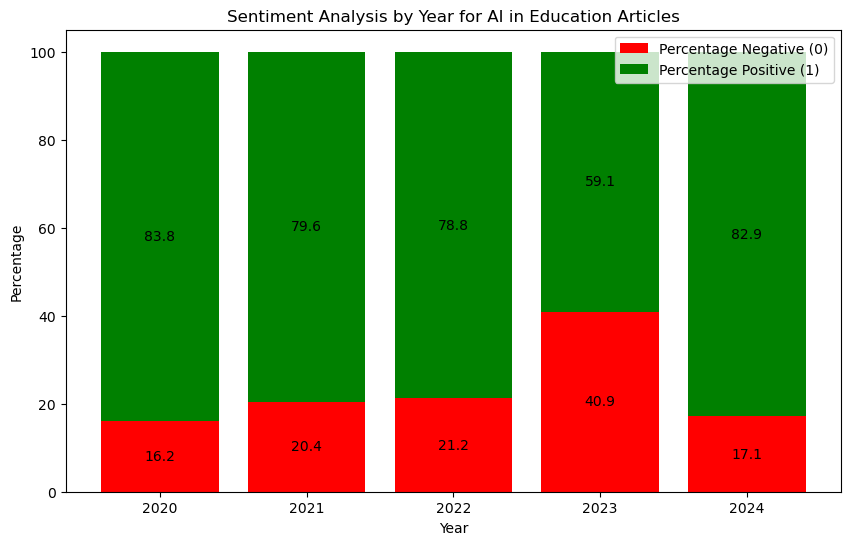

In [336]:
# Plotting
plt.figure(figsize=(10, 6))

# Stacked bar plot with custom colors
bar1 = plt.bar(grouped_df_v2.index, grouped_df_v2['percentage_0'], label='Percentage Negative (0)', color='red')
bar2 = plt.bar(grouped_df_v2.index, grouped_df_v2['percentage_1'], bottom=grouped_df_v2['percentage_0'], label='Percentage Positive (1)', color='green')

# Adding labels on top of each bar
for bars in [bar1, bar2]:
    for bar in bars:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width() / 2, bar.get_y() + bar.get_height() / 2, round(yval, 1),
                 va='center', ha='center')

# Adding labels and title
plt.xlabel('Year')
plt.ylabel('Percentage')
plt.title('Sentiment Analysis by Year for AI in Education Articles')
plt.legend()

# Set the x-ticks to actual year values
plt.xticks(grouped_df_v2.index)  # Assuming the index contains the actual year values

# Display the plot
plt.show()

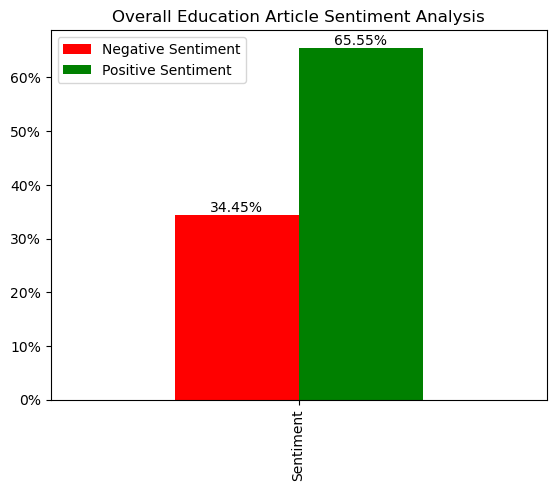

In [337]:
# Summing all values into a single row
sum_row = grouped_df_v2.sum(axis=0)

# Creating a new DataFrame with the summed values
new_df = pd.DataFrame(sum_row).transpose()
new_df = new_df[['NEGATIVE', 'POSITIVE', 'total']]
new_df['Negative Sentiment'] = round(new_df['NEGATIVE']/new_df['total'] *100,2)
new_df['Positive Sentiment'] = round(new_df['POSITIVE']/new_df['total'] *100,2)
new_df = new_df[['Negative Sentiment', 'Positive Sentiment']]


# Custom labels for the x-axis
custom_labels = ['Sentiment']
new_df.index = custom_labels


# Plotting with specified colors
ax = new_df.plot(kind='bar', color=['red', 'green'])


# Adding labels inside the bars
for p in ax.patches:
    ax.annotate(f'{p.get_height():.2f}%', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 5), 
                textcoords='offset points')

# Adding title
plt.title('Overall Education Article Sentiment Analysis')

# Formatting y-axis as percentage
ax.yaxis.set_major_formatter(mtick.PercentFormatter())
plt.show()

In [ ]:
data science

In [ ]:
['software development', 'programming', 'software engineer', 'software developer', 'coding', 'software design ', 'data structure', 'scripting', 'version control', ' git ', 'github', 'debugging' , 'software as a service', 'cloud computing', 'web development', 'web Developer', 'big data', 'cybersecurity', 'devops', 'ai in data science', 'ai engineer', 'data engineers', 'information technology', 'ai data scientist', 'ai in tech']

## Software Development Industry

In [338]:
keywords = ['software development', 'programming', 'software engineer', 'software developer', 'coding', 'software design', 'data structure', 'scripting', 'version control', ' git ', 'github', 'debugging', 'software as a service', 'cloud computing', 'web development', 'web developer', 'big data', ' UX ', ' UI ', 'UI/UX', 'UX/UI', 'cybersecurity', 'cybersecurity analyst', 'devops', 'ai in data science', 'ai engineer', 'data engineers', 'data scientist', 'systems administrator', 'it manager', 'it admin', 'database', 'database admin', 'information technology', 'ai data scientist', 'ai in tech', 'big tech ']
contains_title = filtered_df['title'].str.contains('|'.join(keywords), case=False).sum()

In [339]:
contains_title

2175

In [340]:
mask = filtered_df['title'].str.contains('|'.join(keywords), case=False)

In [341]:
filtered_df2 = filtered_df[mask]

In [342]:
filtered_df2

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column
19,https://channeldailynews.com/news/hashtag-trending-may-18-60-per-cent-of-americans-think-ai-could-threaten-civilization-big-tech-look-for-cheaper-overseas-replacements-for-laid-off-workers-newegg-provides-another-business-case-for/81594,2023-05-19,Hashtag Trending May 18- 60 per cent of Americans think AI could threaten civilization; Big Tech look for cheaper overseas replacements for laid off workers; Newegg provides another business case for conversational AI in commerce | Channel Daily News,Hashtag Trending May 18 60 per cent of Americans think AI could threaten civilization Big Tech look for cheaper overseas replacements for laid off workers Newegg provides another business case for conversational AI in commerce Channel Daily News NewsMost Popular TopicsChannel StrategyInfrastructureMobilityCloudSecuritySoftwarePodcastsManaged Services OutsourcingLeadershipSMBAll TopicsVideosPodcastsEventsChannel Innovation Awards 2023Women in the IT ChannelAboutContact UsSocial MediaMedia K...,hashtag trending may per cent americans think ai could threaten civilization big tech look cheaper overseas replacements laid workers newegg provides another business case conversational ai commerce channel daily news newsmost popular topicschannel strategyinfrastructuremobilitycloudsecuritysoftwarepodcastsmanaged services outsourcingleadershipsmball topicsvideospodcastseventschannel innovation awards women channelaboutcontact ussocial mediamedia kitssubscribeprivacy policydirectoryit jobsc ...,31,2,39,5.128205,Ethical and Legal Implications of AI
230,https://www.cabellstandard.com/uncategorized/325417/machine-learning-big-data-analytics-education%EF%BF%BDmarket-to-witness-a-pronounce-growth-during-2027/,2021-03-21,Machine Learning & Big Data Analytics Education�Market to Witness a Pronounce Growth During 2027 – Cabell Standard,"Machine Learning Big Data Analytics EducationMarket to Witness a Pronounce Growth During 2027 Cabell StandardSkip to contentSun, Mar 21, 2021Search for: Cabell StandardMenuCoronavirusEnergyNewsSpaceAll NewsContact All News NewsMachine Learning Big Data Analytics EducationMarket to Witness a Pronounce Growth During 2027 Mark WillamsPublished On: March 21, 2021Last Updated On: March 21, 2021SummaryFort Collins, Colorado: The report, titled Machine Learning Big Data Analytics Education Mark...",machine learning big data analytics educationmarket witness pronounce growth cabell standardskip contentsun mar search cabell standardmenucoronavirusenergynewsspaceall newscontact news newsmachine learning big data analytics educationmarket witness pronounce growth mark willamspublished march last updated march summaryfort collins colorado report titled machine learning big data analytics education market size types applications segmentation growth global analysis forecast first introduce...,329,1,17,5.882353,AI in Weather Related Information or Services
264,https://www.einpresswire.com/article/674812031/machine-learning-engineer-vs-data-scientist,2023-12-13,Machine Learning Engineer vs. Data Scientist,Machine Learning Engineer vs. Data Scientist About About EIN Presswire How We Are Different. Better How It Works Testimonials Company Ethos Contact EIN Presswire in the News Pricing Distribution Distribution Overview Media Database Major News Sites U.S. TV Radio Stations U.S. International Newswires Newswires by Industry Newswires by Country Newswires by U.S. State Mobile Apps NewsPlugin Live Feed Sample Distribution Report Press Releases All Featured By Industry By Country By U.S. State A...,machine learning engineer vs data scientist ein presswire different better works testimonials company ethos contact ein presswire news pricing distribution distribution overview media database major news sites us tv radio stations us international newswires newswires industry newswires country newswires us state mobile apps newsplugin live feed sample d

In [343]:
# List of words to count occurrences for
words_to_count = ['software development', 'programming', 'software engineer', 'software developer', 'coding', 'software design', 'data structure', 'scripting', 'version control', ' git ', 'github', 'debugging', 'software as a service', 'cloud computing', 'web development', 'web developer', 'big data', ' UX ', ' UI ', 'UI/UX', 'UX/UI', 'cybersecurity', 'cybersecurity analyst', 'devops', 'ai in data science', 'ai engineer', 'data engineers', 'data scientist', 'systems administrator', 'it manager', 'it admin', 'database', 'database admin']

# Create a regular expression pattern to match any of the words in the list
pattern = '|'.join(words_to_count)

# Count occurrences of words and store the counts in a new column 'Healthcare'
filtered_df2['Healthcare'] = filtered_df2['title'].str.lower().str.count(pattern, flags=re.IGNORECASE)

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\3568691239.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Healthcare'] = filtered_df2['title'].str.lower().str.count(pattern, flags=re.IGNORECASE)


In [344]:
filtered_df2['Total_Words'] = filtered_df2['title'].str.split().apply(len)

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\1354618017.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Total_Words'] = filtered_df2['title'].str.split().apply(len)


In [345]:
filtered_df2['Healthcare_Percentage'] = (filtered_df2['Healthcare'] / filtered_df2['Total_Words']) * 100

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\240730045.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Healthcare_Percentage'] = (filtered_df2['Healthcare'] / filtered_df2['Total_Words']) * 100


In [346]:
software_development_articles = filtered_df2[filtered_df2['Healthcare_Percentage'] > 1]
software_development_articles.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1910 entries, 230 to 143208
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   url                    1910 non-null   object 
 1   date                   1910 non-null   object 
 2   title                  1910 non-null   object 
 3   text_clean             1910 non-null   object 
 4   text_clean_2           1910 non-null   object 
 5   ID                     1910 non-null   int64  
 6   Key_Words              1910 non-null   int64  
 7   Total_Words            1910 non-null   int64  
 8   Key_Words_Percentage   1910 non-null   float64
 9   new_column             1881 non-null   object 
 10  Healthcare             1910 non-null   int64  
 11  Healthcare_Percentage  1910 non-null   float64
dtypes: float64(2), int64(4), object(6)
memory usage: 194.0+ KB


In [347]:
software_development_articles['date'] = pd.to_datetime(software_development_articles['date'])
software_development_articles['year'] = software_development_articles['date'].dt.year
software_development_articles['month'] = software_development_articles['date'].dt.month

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\84023879.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  software_development_articles['date'] = pd.to_datetime(software_development_articles['date'])
C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\84023879.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  software_development_articles['year'] = software_development_articles['date'].dt.year
C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\84023879.py:3: SettingWithCopy

In [348]:
software_development_articles['year'].unique()

array([2021, 2023, 2024, 2022, 2020])

In [349]:
software_development_articles

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column,Healthcare,Healthcare_Percentage,year,month
230,https://www.cabellstandard.com/uncategorized/325417/machine-learning-big-data-analytics-education%EF%BF%BDmarket-to-witness-a-pronounce-growth-during-2027/,2021-03-21,Machine Learning & Big Data Analytics Education�Market to Witness a Pronounce Growth During 2027 – Cabell Standard,"Machine Learning Big Data Analytics EducationMarket to Witness a Pronounce Growth During 2027 Cabell StandardSkip to contentSun, Mar 21, 2021Search for: Cabell StandardMenuCoronavirusEnergyNewsSpaceAll NewsContact All News NewsMachine Learning Big Data Analytics EducationMarket to Witness a Pronounce Growth During 2027 Mark WillamsPublished On: March 21, 2021Last Updated On: March 21, 2021SummaryFort Collins, Colorado: The report, titled Machine Learning Big Data Analytics Education Mark...",machine learning big data analytics educationmarket witness pronounce growth cabell standardskip contentsun mar search cabell standardmenucoronavirusenergynewsspaceall newscontact news newsmachine learning big data analytics educationmarket witness pronounce growth mark willamspublished march last updated march summaryfort collins colorado report titled machine learning big data analytics education market size types applications segmentation growth global analysis forecast first introduce...,329,1,17,5.882353,AI in Weather Related Information or Services,1,5.882353,2021,3
264,https://www.einpresswire.com/article/674812031/machine-learning-engineer-vs-data-scientist,2023-12-13,Machine Learning Engineer vs. Data Scientist,Machine Learning Engineer vs. Data Scientist About About EIN Presswire How We Are Different. Better How It Works Testimonials Company Ethos Contact EIN Presswire in the News Pricing Distribution Distribution Overview Media Database Major News Sites U.S. TV Radio Stations U.S. International Newswires Newswires by Industry Newswires by Country Newswires by U.S. State Mobile Apps NewsPlugin Live Feed Sample Distribution Report Press Releases All Featured By Industry By Country By U.S. State A...,machine learning engineer vs data scientist ein presswire different better works testimonials company ethos contact ein presswire news pricing distribution distribution overview media database major news sites us tv radio stations us international newswires newswires industry newswires country newswires us state mobile apps newsplugin live feed sample distribution report press releases featured industry country us state archive newswires us international newswires newswires industry agricult...,390,1,6,16.666667,AI Applications and Technologies,1,16.666667,2023,12
313,https://www.geeky-gadgets.com/how-to-use-github-copilot/,2024-02-05,How to use GitHub Copilot AI coding assistant - Geeky Gadgets,"How to use GitHub Copilot AI coding assistant Geeky Gadgets Skip to main content Skip to secondary menu Skip to primary sidebar Skip to footerGeeky GadgetsThe Latest Technology NewsHomeAppleAndroidDealsGadgetsTechnologyHardwareGamingGuidesAuto NewsHow to use GitHub Copilot AI coding assistant to improve your projects and reduce your workload2:59 pm February 5, 2024 By Julian Horsey If youre working with Python or other coding languages to develop applications or the next AI service that is ...",use github copilot ai coding assistant geeky gadgets skip main content skip secondary menu skip primary sidebar skip footergeeky gadgetsthe latest technology newshomeappleandroiddealsgadgetstechnologyhardwaregamingguidesauto newshow use github copilot ai coding assistant improve projects reduce workload pm february julian horsey youre working python coding languages develop applications next ai service going transform lives might need extra help resources employ additional developers fear th...,452,1,11,9.090909,AI Applications and Technologies,2,18.181818,2024,2
395,https://www.kold.com/prnewswire/2023/12/12/markerr-launches-industr

In [350]:
filtered_df100 = filtered_df1[['url', 'date', 'sentiment']]

# Convert the 'date' column in both DataFrames to the same data type
software_development_articles['date'] = pd.to_datetime(software_development_articles['date'])
filtered_df100['date'] = pd.to_datetime(filtered_df100['date'])

# Merge the DataFrames
merged_df = pd.merge(software_development_articles, filtered_df100[['url', 'date', 'sentiment']], on=['url', 'date'], how='left')


C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\3037962781.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  software_development_articles['date'] = pd.to_datetime(software_development_articles['date'])
C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\3037962781.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df100['date'] = pd.to_datetime(filtered_df100['date'])


In [351]:
# Assuming filtered_df1 is your DataFrame
pivot_df = merged_df.pivot_table(index=['year', 'month'], columns='sentiment', aggfunc='size', fill_value=0).reset_index()

# Rename columns
pivot_df.columns.name = None  # Remove the name of the columns axis
pivot_df.columns = ['year', 'month', 'NEGATIVE', 'POSITIVE']


# Define a function to derive the 'Majority_Sentiment' column
def derive_sentiment(row):
    if row['NEGATIVE'] > row['POSITIVE']:
        return 'NEGATIVE'
    elif row['POSITIVE'] > row['NEGATIVE']:
        return 'POSITIVE'
    else:
        return 'NEUTRAL'  # Handle the case where '0' and '1' are equal

# Apply the function to each row to derive the 'Majority_Sentiment' column
pivot_df['Majority_Sentiment'] = pivot_df.apply(derive_sentiment, axis=1)
pivot_df

,year,month,NEGATIVE,POSITIVE,Majority_Sentiment
0,2020,1,3,14,POSITIVE
1,2020,2,7,9,POSITIVE
2,2020,3,6,15,POSITIVE
3,2020,4,1,24,POSITIVE
4,2020,5,0,12,POSITIVE
5,2020,6,5,12,POSITIVE
6,2020,7,3,20,POSITIVE
7,2020,8,6,22,POSITIVE
8,2020,9,7,15,POSITIVE
9,2020,10,2,13,POSITIVE


In [352]:
grouped_df_v2 = pivot_df.groupby('year')[['NEGATIVE', 'POSITIVE']].sum()


grouped_df_v2['total'] = grouped_df_v2['NEGATIVE'] + grouped_df_v2['POSITIVE']
grouped_df_v2['percentage_0'] = grouped_df_v2['NEGATIVE'] / grouped_df_v2['total'] * 100
grouped_df_v2['percentage_1'] = grouped_df_v2['POSITIVE'] / grouped_df_v2['total'] * 100
grouped_df_v2

,NEGATIVE,POSITIVE,total,percentage_0,percentage_1
year,,,,,
2020,45,185,230,19.565217,80.434783
2021,49,210,259,18.918919,81.081081
2022,98,178,276,35.507246,64.492754
2023,179,907,1086,16.482505,83.517495
2024,11,48,59,18.644068,81.355932


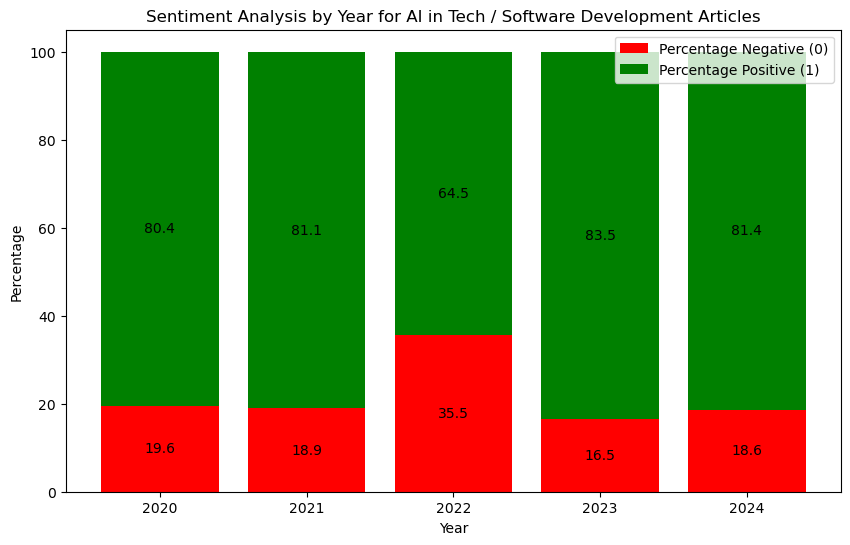

In [353]:
# Plotting
plt.figure(figsize=(10, 6))

# Stacked bar plot with custom colors
bar1 = plt.bar(grouped_df_v2.index, grouped_df_v2['percentage_0'], label='Percentage Negative (0)', color='red')
bar2 = plt.bar(grouped_df_v2.index, grouped_df_v2['percentage_1'], bottom=grouped_df_v2['percentage_0'], label='Percentage Positive (1)', color='green')

# Adding labels on top of each bar
for bars in [bar1, bar2]:
    for bar in bars:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width() / 2, bar.get_y() + bar.get_height() / 2, round(yval, 1),
                 va='center', ha='center')

# Adding labels and title
plt.xlabel('Year')
plt.ylabel('Percentage')
plt.title('Sentiment Analysis by Year for AI in Tech / Software Development Articles')
plt.legend()

# Set the x-ticks to actual year values
plt.xticks(grouped_df_v2.index)  # Assuming the index contains the actual year values

# Display the plot
plt.show()

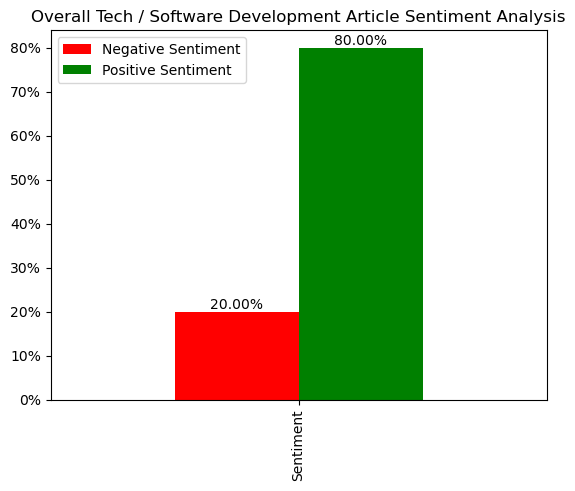

In [354]:
# Summing all values into a single row
sum_row = grouped_df_v2.sum(axis=0)

# Creating a new DataFrame with the summed values
new_df = pd.DataFrame(sum_row).transpose()
new_df = new_df[['NEGATIVE', 'POSITIVE', 'total']]
new_df['Negative Sentiment'] = round(new_df['NEGATIVE']/new_df['total'] *100,2)
new_df['Positive Sentiment'] = round(new_df['POSITIVE']/new_df['total'] *100,2)
new_df = new_df[['Negative Sentiment', 'Positive Sentiment']]


# Custom labels for the x-axis
custom_labels = ['Sentiment']
new_df.index = custom_labels


# Plotting with specified colors
ax = new_df.plot(kind='bar', color=['red', 'green'])


# Adding labels inside the bars
for p in ax.patches:
    ax.annotate(f'{p.get_height():.2f}%', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 5), 
                textcoords='offset points')

# Adding title
plt.title('Overall Tech / Software Development Article Sentiment Analysis')

# Formatting y-axis as percentage
ax.yaxis.set_major_formatter(mtick.PercentFormatter())
plt.show()

In [ ]:
['telecommunication', 'telecom', 't-mobile', 'at&t', ' lte ', 'broadband providers', 'broadband subscriber', 'fiber optic', 'internet of things', ' iot ', 'mobile network']

In [29]:
pd.set_option('display.max_colwidth', 150)

## Media & Communication Industry

In [355]:
keywords = ['media', 'broadcaster', 'social media manager', 'newsworthiness', 'writer', 'editor', 'influencer', 'content creator', 'journalism', 'journalist', 'telecommunication', 'telecom', 't-mobile', 'at&t', ' lte ', 'broadband providers', 'broadband subscriber', 'fiber optic', 'internet of things', ' iot ', 'mobile network', 'public relation']
contains_title = filtered_df['title'].str.contains('|'.join(keywords), case=False).sum()

In [356]:
contains_title

3898

In [357]:
mask = filtered_df['title'].str.contains('|'.join(keywords), case=False)

In [358]:
filtered_df2 = filtered_df[mask]

In [359]:
filtered_df2

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column
37,https://citylife.capetown/zu/uncategorized/europes-ai-chip-pioneers-shaping-the-future-of-telecommunications-and-internet-technologies/426567/,2023-11-16,Europe's AI Chip Pioneers: Shaping the Future of Telecommunications and Internet Technologies,"Europes AI Chip Pioneers: Shaping the Future of Telecommunications and Internet Technologies Yeqela kokuqukethweNgoLwesithathu. Nov 15, 2023 City LifeKwethulwa Ubuchwepheshe Obusha namandla eAI AIIzindabaSpaceUbuchwephesheIsathelayithiIsayensiUSOxhumana naye Izindaba Europes AI Chip Pioneers: Shaping the Future of Telecommunications and Internet Technologies ByNov 8, 2023 Europes AI Chip Pioneers: Shaping the Future of Telecommunications and Internet TechnologiesIn recent years, Europe has e...",europes ai chip pioneers shaping future telecommunications internet technologies yeqela kokuqukethwengolwesithathu nov city lifekwethulwa ubuchwepheshe obusha namandla eai aiizindabaspaceubuchwephesheisathelayithiisayensiusoxhumana naye izindaba europes ai chip pioneers shaping future telecommunications internet technologies bynov europes ai chip pioneers shaping future telecommunications internet technologiesin recent years europe emerged hotbed innovation field artificial intelligence ai c...,57,1,12,8.333333,Machine Learning Models for Human Tasks
43,https://digiday.com/media-buying/trade-school-founder-genna-franconi-on-the-influencer-content-business-and-future-of-ai/,2023-07-10,Trade School founder Genna Franconi on the influencer content business and future of AI - Digiday,"Trade School founder Genna Franconi on the influencer content business and future of AI Digiday Subscribe LoginHi, ReaderDigiday homepageFAQAccount OverviewLogoutNewsDigiday PodcastsEventsAwardsNewsDigiday PodcastsEventsAwardsHot TopicsThe Programmatic PublisherThe Programmatic MarketerMarketing on PlatformsLife Beyond the CookieBrands in CultureGaming EsportsModern NewsroomAll Topics LoginSubscribeMy AccountLogoutSpecial ProjectsDigiday ResearchWTF Series As users, marketers undertake Thr...",trade school founder genna franconi influencer content business future ai digiday subscribe loginhi readerdigiday homepagefaqaccount overviewlogoutnewsdigiday podcastseventsawardsnewsdigiday podcastseventsawardshot topicsthe programmatic publisherthe programmatic marketermarketing platformslife beyond cookiebrands culturegaming esportsmodern newsroomall topics loginsubscribemy accountlogoutspecial projectsdigiday researchwtf series users marketers undertake threads pread experimentationmedia...,64,1,16,6.250000,AI Applications and Technologies
56,https://exbulletin.com/tech/2159170/,2023-05-19,New Google AI tools will enable advertisers to generate media assets - ExBulletin,New Google AI tools will enable advertisers to generate media assets ExBulletinEntertainmentPoliticsFashionSportsTechBusinessContact Us Connect with us ExBulletinNew Google AI tools will enable advertisers to generate media assetsEntertainmentPoliticsFashionSportsTechBusinessContact Us TechNew Google AI tools will enable advertisers to generate media assets Advertisers and YouTube creators could benefit from a new AI solution Google is reportedly working on.Google Ads. A generative AI tool ...,new google ai tools enable advertisers generate media assets exbulletinentertainmentpoliticsfashionsportstechbusinesscontact us connect us exbulletinnew google ai tools enable advertisers generate media assetsentertainmentpoliticsfashionsportstechbusinesscontact us technew google ai tools enable advertisers generate media assets advertisers youtube creators could benefit new ai solution google reportedly working ongoogle ads generative ai tool powered palm help advertisers create media asset...,77,1,13,7.692308,AI Applications and Technologies
63,https://fnbherald.com/2020/05/05/mobile-artificial-intelligence-market-set-for-rapid-growth-qualcomm-technologies-inc-nvidia

In [360]:
# List of words to count occurrences for
words_to_count = ['media', 'broadcaster', 'social media manager', 'newsworthiness', 'writer', 'editor', 'influencer', 'content creator', 'journalism', 'journalist', 'telecommunication', 'telecom', 't-mobile', 'at&t', ' lte ', 'broadband providers', 'broadband subscriber', 'fiber optic', 'internet of things', ' iot ', 'mobile network', 'public relation']

# Create a regular expression pattern to match any of the words in the list
pattern = '|'.join(words_to_count)

# Count occurrences of words and store the counts in a new column 'Healthcare'
filtered_df2['Healthcare'] = filtered_df2['title'].str.lower().str.count(pattern, flags=re.IGNORECASE)

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\606320502.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Healthcare'] = filtered_df2['title'].str.lower().str.count(pattern, flags=re.IGNORECASE)


In [361]:
filtered_df2['Total_Words'] = filtered_df2['title'].str.split().apply(len)

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\1354618017.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Total_Words'] = filtered_df2['title'].str.split().apply(len)


In [362]:
filtered_df2['Healthcare_Percentage'] = (filtered_df2['Healthcare'] / filtered_df2['Total_Words']) * 100

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\240730045.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Healthcare_Percentage'] = (filtered_df2['Healthcare'] / filtered_df2['Total_Words']) * 100


In [363]:
telecommunication_articles = filtered_df2[filtered_df2['Healthcare_Percentage'] > 1]
telecommunication_articles.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3898 entries, 37 to 143378
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   url                    3898 non-null   object 
 1   date                   3898 non-null   object 
 2   title                  3898 non-null   object 
 3   text_clean             3898 non-null   object 
 4   text_clean_2           3898 non-null   object 
 5   ID                     3898 non-null   int64  
 6   Key_Words              3898 non-null   int64  
 7   Total_Words            3898 non-null   int64  
 8   Key_Words_Percentage   3898 non-null   float64
 9   new_column             3855 non-null   object 
 10  Healthcare             3898 non-null   int64  
 11  Healthcare_Percentage  3898 non-null   float64
dtypes: float64(2), int64(4), object(6)
memory usage: 395.9+ KB


In [364]:
telecommunication_articles['date'] = pd.to_datetime(telecommunication_articles['date'])
telecommunication_articles['year'] = telecommunication_articles['date'].dt.year
telecommunication_articles['month'] = telecommunication_articles['date'].dt.month

In [365]:
telecommunication_articles['year'].unique()

array([2023, 2020, 2022, 2021, 2024])

In [366]:
filtered_df100 = filtered_df1[['url', 'date', 'sentiment']]

# Convert the 'date' column in both DataFrames to the same data type
telecommunication_articles['date'] = pd.to_datetime(telecommunication_articles['date'])
filtered_df100['date'] = pd.to_datetime(filtered_df100['date'])

# Merge the DataFrames
merged_df = pd.merge(telecommunication_articles, filtered_df100[['url', 'date', 'sentiment']], on=['url', 'date'], how='left')


C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\136231704.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df100['date'] = pd.to_datetime(filtered_df100['date'])


In [367]:
# Assuming filtered_df1 is your DataFrame
pivot_df = merged_df.pivot_table(index=['year', 'month'], columns='sentiment', aggfunc='size', fill_value=0).reset_index()

# Rename columns
pivot_df.columns.name = None  # Remove the name of the columns axis
pivot_df.columns = ['year', 'month', 'NEGATIVE', 'POSITIVE']


# Define a function to derive the 'Majority_Sentiment' column
def derive_sentiment(row):
    if row['NEGATIVE'] > row['POSITIVE']:
        return 'NEGATIVE'
    elif row['POSITIVE'] > row['NEGATIVE']:
        return 'POSITIVE'
    else:
        return 'NEUTRAL'  # Handle the case where '0' and '1' are equal

# Apply the function to each row to derive the 'Majority_Sentiment' column
pivot_df['Majority_Sentiment'] = pivot_df.apply(derive_sentiment, axis=1)
pivot_df

,year,month,NEGATIVE,POSITIVE,Majority_Sentiment
0,2020,1,7,33,POSITIVE
1,2020,2,3,42,POSITIVE
2,2020,3,4,45,POSITIVE
3,2020,4,2,43,POSITIVE
4,2020,5,7,22,POSITIVE
5,2020,6,8,14,POSITIVE
6,2020,7,10,19,POSITIVE
7,2020,8,4,30,POSITIVE
8,2020,9,5,20,POSITIVE
9,2020,10,7,28,POSITIVE


In [368]:
grouped_df_v2 = pivot_df.groupby('year')[['NEGATIVE', 'POSITIVE']].sum()


grouped_df_v2['total'] = grouped_df_v2['NEGATIVE'] + grouped_df_v2['POSITIVE']
grouped_df_v2['percentage_0'] = grouped_df_v2['NEGATIVE'] / grouped_df_v2['total'] * 100
grouped_df_v2['percentage_1'] = grouped_df_v2['POSITIVE'] / grouped_df_v2['total'] * 100
grouped_df_v2

,NEGATIVE,POSITIVE,total,percentage_0,percentage_1
year,,,,,
2020,69,391,460,15.000000,85.000000
2021,45,294,339,13.274336,86.725664
2022,67,270,337,19.881306,80.118694
2023,900,1678,2578,34.910784,65.089216
2024,77,107,184,41.847826,58.152174


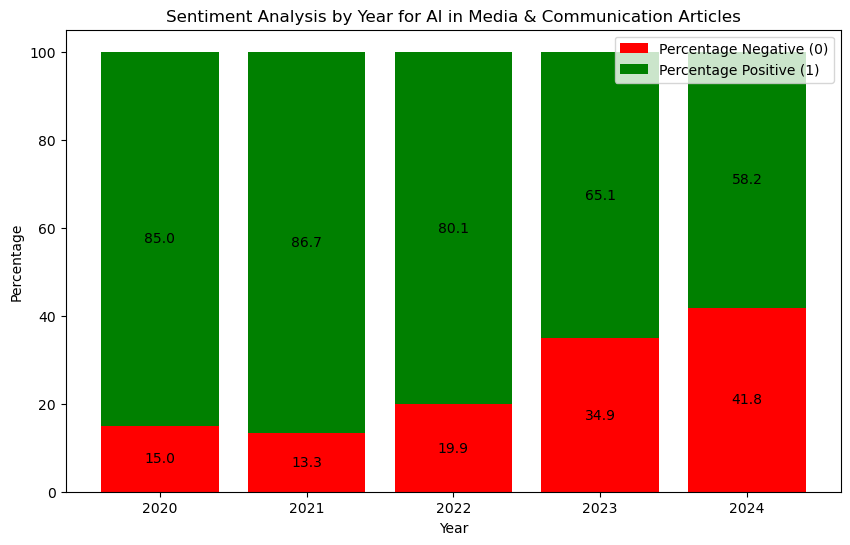

In [369]:
# Plotting
plt.figure(figsize=(10, 6))

# Stacked bar plot with custom colors
bar1 = plt.bar(grouped_df_v2.index, grouped_df_v2['percentage_0'], label='Percentage Negative (0)', color='red')
bar2 = plt.bar(grouped_df_v2.index, grouped_df_v2['percentage_1'], bottom=grouped_df_v2['percentage_0'], label='Percentage Positive (1)', color='green')

# Adding labels on top of each bar
for bars in [bar1, bar2]:
    for bar in bars:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width() / 2, bar.get_y() + bar.get_height() / 2, round(yval, 1),
                 va='center', ha='center')

# Adding labels and title
plt.xlabel('Year')
plt.ylabel('Percentage')
plt.title('Sentiment Analysis by Year for AI in Media & Communication Articles')
plt.legend()

# Set the x-ticks to actual year values
plt.xticks(grouped_df_v2.index)  # Assuming the index contains the actual year values

# Display the plot
plt.show()

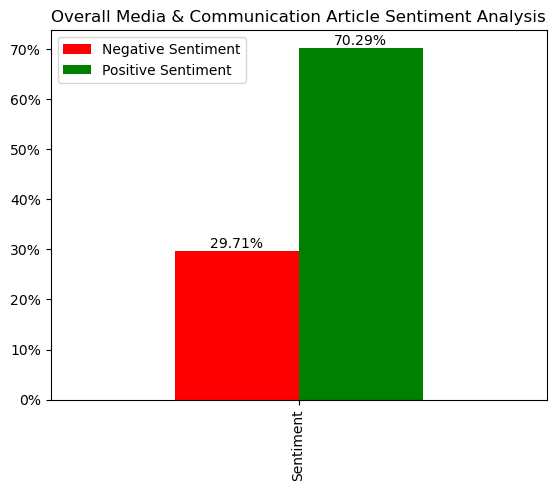

In [370]:
# Summing all values into a single row
sum_row = grouped_df_v2.sum(axis=0)

# Creating a new DataFrame with the summed values
new_df = pd.DataFrame(sum_row).transpose()
new_df = new_df[['NEGATIVE', 'POSITIVE', 'total']]
new_df['Negative Sentiment'] = round(new_df['NEGATIVE']/new_df['total'] *100,2)
new_df['Positive Sentiment'] = round(new_df['POSITIVE']/new_df['total'] *100,2)
new_df = new_df[['Negative Sentiment', 'Positive Sentiment']]


# Custom labels for the x-axis
custom_labels = ['Sentiment']
new_df.index = custom_labels


# Plotting with specified colors
ax = new_df.plot(kind='bar', color=['red', 'green'])


# Adding labels inside the bars
for p in ax.patches:
    ax.annotate(f'{p.get_height():.2f}%', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 5), 
                textcoords='offset points')

# Adding title
plt.title('Overall Media & Communication Article Sentiment Analysis')

# Formatting y-axis as percentage
ax.yaxis.set_major_formatter(mtick.PercentFormatter())
plt.show()

In [ ]:
['marketing', 'advertising', 'brand management', 'digital marketing', 'marketer', 'advertiser', 'event marketing', ' branding ']

## Marketing Industry

In [371]:
keywords = ['marketing', 'advertising', 'brand management', 'digital marketing', 'marketer', 'advertiser', 'event marketing', 'branding', 'marketing manager', 'marketing director', 'digital marketing specialist', 'content marketing strategist', 'brand manager', 'marketing analyst']
contains_title = filtered_df['title'].str.contains('|'.join(keywords), case=False).sum()

In [372]:
contains_title

1578

In [373]:
mask = filtered_df['title'].str.contains('|'.join(keywords), case=False)

In [374]:
filtered_df2 = filtered_df[mask]

In [375]:
filtered_df2

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column
56,https://exbulletin.com/tech/2159170/,2023-05-19,New Google AI tools will enable advertisers to generate media assets - ExBulletin,New Google AI tools will enable advertisers to generate media assets ExBulletinEntertainmentPoliticsFashionSportsTechBusinessContact Us Connect with us ExBulletinNew Google AI tools will enable advertisers to generate media assetsEntertainmentPoliticsFashionSportsTechBusinessContact Us TechNew Google AI tools will enable advertisers to generate media assets Advertisers and YouTube creators could benefit from a new AI solution Google is reportedly working on.Google Ads. A generative AI tool ...,new google ai tools enable advertisers generate media assets exbulletinentertainmentpoliticsfashionsportstechbusinesscontact us connect us exbulletinnew google ai tools enable advertisers generate media assetsentertainmentpoliticsfashionsportstechbusinesscontact us technew google ai tools enable advertisers generate media assets advertisers youtube creators could benefit new ai solution google reportedly working ongoogle ads generative ai tool powered palm help advertisers create media asset...,77,1,13,7.692308,AI Applications and Technologies
164,https://venturebeat.com/2020/12/15/tinyclues-takes-marketing-ai-beyond-the-hype-and-adds-enterprise-software-veteran-to-its-board-of-directors/,2020-12-15,Tinyclues Takes Marketing AI Beyond the Hype and Adds Enterprise Software Veteran to Its Board of Directors | VentureBeat,Tinyclues Takes Marketing AI Beyond the Hype and Adds Enterprise Software Veteran to Its Board of Directors VentureBeat VentureBeat HomepageThe MachineGamesBeatJobsSpecial IssueAccount SettingsLog OutBecome a MemberSign InVentureBeat HomepageVentureBeatARVRBig DataCloudCommerceDevEnterpriseEntrepreneurMarketingMediaMobileSecuritySocialTransportationFollowfollow us on Twitterfollow us on Facebookfollow us on LinkedInFollow us on RSSThe MachineAIMachine LearningComputer VisionNatural Language...,tinyclues takes marketing ai beyond hype adds enterprise software veteran board directors venturebeat venturebeat homepagethe machinegamesbeatjobsspecial issueaccount settingslog outbecome membersign inventurebeat homepageventurebeatarvrbig datacloudcommercedeventerpriseentrepreneurmarketingmediamobilesecuritysocialtransportationfollowfollow us twitterfollow us facebookfollow us linkedinfollow us rssthe machineaimachine learningcomputer visionnatural language processingrobotic process automa...,239,1,19,5.263158,Machine Learning Models for Human Tasks
291,https://www.forbes.com/sites/forbesagencycouncil/2023/03/30/how-successful-adoption-of-ai-can-change-your-marketing-approach/,2023-03-30,How Successful Adoption Of AI Can Change Your Marketing Approach,"How Successful Adoption Of AI Can Change Your Marketing ApproachSubscribe Sign InBETAThis is a BETA experience. You may optout by clicking hereMore From ForbesMar 30, 2023,07:00am EDTProtecting Your Employer Brand During Layoffs And Economic DownturnsMar 30, 2023,07:00am EDTNot Chosen For An Interview It May Have Nothing To Do With Your QualificationsMar 30, 2023,07:00am EDT5 Ways To Confront Chaotic Markets To Support GrowthMar 30, 2023,07:00am EDTChatGPT: Hold Onto Your Horses, Healthcare,...",successful adoption ai change marketing approachsubscribe sign inbetathis beta experience may optout clicking heremore forbesmar edtprotecting employer brand layoffs economic downturnsmar edtnot chosen interview may nothing qualificationsmar edt ways confront chaotic markets support growthmar edtchatgpt hold onto horses healthcare weve got game changermar pm edtwhy culture crucial success business well sportsmar pm edtchanging careers situations warrant going back schoolmar edtsmall busines...,429,1,10,10.000000,Machine Learning Models for Human Tasks
609,https://www.wbtv.com/prnewswire/2023/04/27/how-prepare-ai-innovation-revolution-marketing/,2023-04-27,How To Prep

In [376]:
# List of words to count occurrences for
words_to_count = ['marketing', 'advertising', 'brand management', 'digital marketing', 'marketer', 'advertiser', 'event marketing', 'branding', 'marketing manager', 'marketing director', 'digital marketing specialist', 'content marketing strategist', 'brand manager', 'marketing analyst']

# Create a regular expression pattern to match any of the words in the list
pattern = '|'.join(words_to_count)

# Count occurrences of words and store the counts in a new column 'Healthcare'
filtered_df2['Healthcare'] = filtered_df2['title'].str.lower().str.count(pattern, flags=re.IGNORECASE)

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\2343273642.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Healthcare'] = filtered_df2['title'].str.lower().str.count(pattern, flags=re.IGNORECASE)


In [377]:
filtered_df2['Total_Words'] = filtered_df2['title'].str.split().apply(len)

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\1354618017.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Total_Words'] = filtered_df2['title'].str.split().apply(len)


In [378]:
filtered_df2['Healthcare_Percentage'] = (filtered_df2['Healthcare'] / filtered_df2['Total_Words']) * 100

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\240730045.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Healthcare_Percentage'] = (filtered_df2['Healthcare'] / filtered_df2['Total_Words']) * 100


In [379]:
marketing_articles = filtered_df2[filtered_df2['Healthcare_Percentage'] > 1]
marketing_articles.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1578 entries, 56 to 143340
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   url                    1578 non-null   object 
 1   date                   1578 non-null   object 
 2   title                  1578 non-null   object 
 3   text_clean             1578 non-null   object 
 4   text_clean_2           1578 non-null   object 
 5   ID                     1578 non-null   int64  
 6   Key_Words              1578 non-null   int64  
 7   Total_Words            1578 non-null   int64  
 8   Key_Words_Percentage   1578 non-null   float64
 9   new_column             1559 non-null   object 
 10  Healthcare             1578 non-null   int64  
 11  Healthcare_Percentage  1578 non-null   float64
dtypes: float64(2), int64(4), object(6)
memory usage: 160.3+ KB


In [380]:
marketing_articles['date'] = pd.to_datetime(marketing_articles['date'])
marketing_articles['year'] = marketing_articles['date'].dt.year
marketing_articles['month'] = marketing_articles['date'].dt.month

In [381]:
marketing_articles['year'].unique()

array([2023, 2020, 2022, 2021, 2024])

In [382]:
filtered_df100 = filtered_df1[['url', 'date', 'sentiment']]

# Convert the 'date' column in both DataFrames to the same data type
marketing_articles['date'] = pd.to_datetime(marketing_articles['date'])
filtered_df100['date'] = pd.to_datetime(filtered_df100['date'])

# Merge the DataFrames
merged_df = pd.merge(marketing_articles, filtered_df100[['url', 'date', 'sentiment']], on=['url', 'date'], how='left')


C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\4178311382.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df100['date'] = pd.to_datetime(filtered_df100['date'])


In [383]:
# Assuming filtered_df1 is your DataFrame
pivot_df = merged_df.pivot_table(index=['year', 'month'], columns='sentiment', aggfunc='size', fill_value=0).reset_index()

# Rename columns
pivot_df.columns.name = None  # Remove the name of the columns axis
pivot_df.columns = ['year', 'month', 'NEGATIVE', 'POSITIVE']


# Define a function to derive the 'Majority_Sentiment' column
def derive_sentiment(row):
    if row['NEGATIVE'] > row['POSITIVE']:
        return 'NEGATIVE'
    elif row['POSITIVE'] > row['NEGATIVE']:
        return 'POSITIVE'
    else:
        return 'NEUTRAL'  # Handle the case where '0' and '1' are equal

# Apply the function to each row to derive the 'Majority_Sentiment' column
pivot_df['Majority_Sentiment'] = pivot_df.apply(derive_sentiment, axis=1)
pivot_df

,year,month,NEGATIVE,POSITIVE,Majority_Sentiment
0,2020,1,1,2,POSITIVE
1,2020,2,2,9,POSITIVE
2,2020,3,1,9,POSITIVE
3,2020,4,3,14,POSITIVE
4,2020,5,0,7,POSITIVE
5,2020,6,2,5,POSITIVE
6,2020,7,2,7,POSITIVE
7,2020,8,3,9,POSITIVE
8,2020,9,2,1,NEGATIVE
9,2020,10,3,19,POSITIVE


In [384]:
grouped_df_v2 = pivot_df.groupby('year')[['NEGATIVE', 'POSITIVE']].sum()


grouped_df_v2['total'] = grouped_df_v2['NEGATIVE'] + grouped_df_v2['POSITIVE']
grouped_df_v2['percentage_0'] = grouped_df_v2['NEGATIVE'] / grouped_df_v2['total'] * 100
grouped_df_v2['percentage_1'] = grouped_df_v2['POSITIVE'] / grouped_df_v2['total'] * 100
grouped_df_v2

,NEGATIVE,POSITIVE,total,percentage_0,percentage_1
year,,,,,
2020,22,101,123,17.886179,82.113821
2021,21,112,133,15.789474,84.210526
2022,43,163,206,20.873786,79.126214
2023,242,833,1075,22.511628,77.488372
2024,14,27,41,34.146341,65.853659


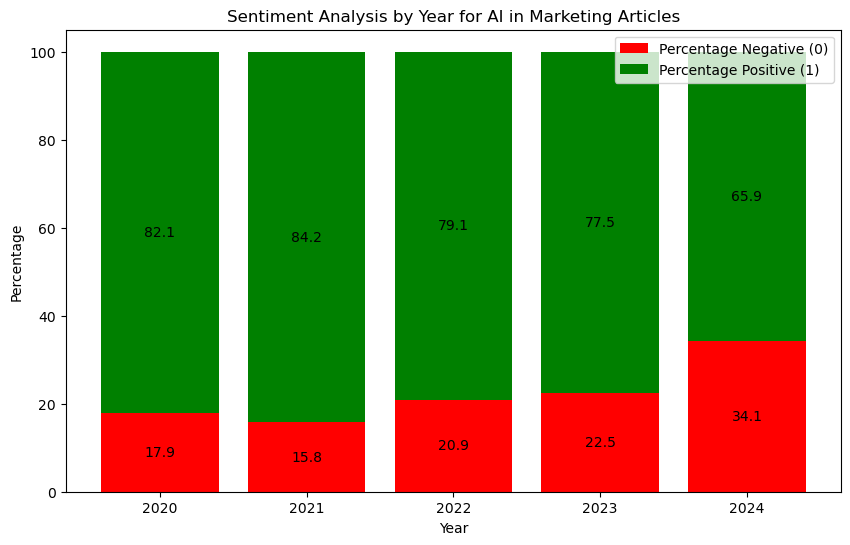

In [385]:
# Plotting
plt.figure(figsize=(10, 6))

# Stacked bar plot with custom colors
bar1 = plt.bar(grouped_df_v2.index, grouped_df_v2['percentage_0'], label='Percentage Negative (0)', color='red')
bar2 = plt.bar(grouped_df_v2.index, grouped_df_v2['percentage_1'], bottom=grouped_df_v2['percentage_0'], label='Percentage Positive (1)', color='green')

# Adding labels on top of each bar
for bars in [bar1, bar2]:
    for bar in bars:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width() / 2, bar.get_y() + bar.get_height() / 2, round(yval, 1),
                 va='center', ha='center')

# Adding labels and title
plt.xlabel('Year')
plt.ylabel('Percentage')
plt.title('Sentiment Analysis by Year for AI in Marketing Articles')
plt.legend()

# Set the x-ticks to actual year values
plt.xticks(grouped_df_v2.index)  # Assuming the index contains the actual year values

# Display the plot
plt.show()

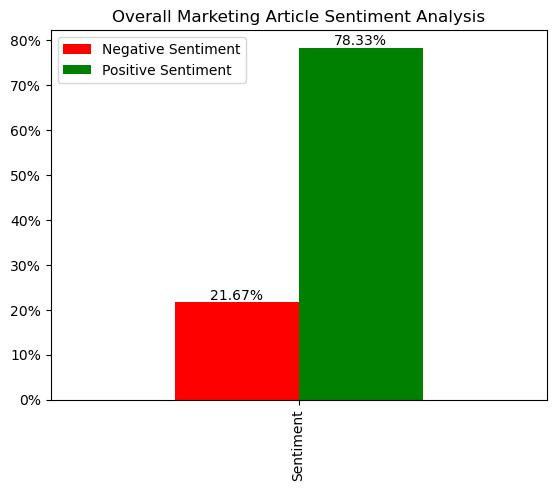

In [386]:
# Summing all values into a single row
sum_row = grouped_df_v2.sum(axis=0)

# Creating a new DataFrame with the summed values
new_df = pd.DataFrame(sum_row).transpose()
new_df = new_df[['NEGATIVE', 'POSITIVE', 'total']]
new_df['Negative Sentiment'] = round(new_df['NEGATIVE']/new_df['total'] *100,2)
new_df['Positive Sentiment'] = round(new_df['POSITIVE']/new_df['total'] *100,2)
new_df = new_df[['Negative Sentiment', 'Positive Sentiment']]


# Custom labels for the x-axis
custom_labels = ['Sentiment']
new_df.index = custom_labels


# Plotting with specified colors
ax = new_df.plot(kind='bar', color=['red', 'green'])


# Adding labels inside the bars
for p in ax.patches:
    ax.annotate(f'{p.get_height():.2f}%', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 5), 
                textcoords='offset points')

# Adding title
plt.title('Overall Marketing Article Sentiment Analysis')

# Formatting y-axis as percentage
ax.yaxis.set_major_formatter(mtick.PercentFormatter())
plt.show()

In [ ]:
['politic', 'government', 'political', 'election', ' govt ']

## Politic Industry

In [387]:
keywords = ['politic', 'government', 'political', 'election', ' govt ', 'politician', 'policy', 'congress', 'voting', 'political analyst']
contains_title = filtered_df['title'].str.contains('|'.join(keywords), case=False).sum()

In [388]:
contains_title

2362

In [389]:
mask = filtered_df['title'].str.contains('|'.join(keywords), case=False)

In [390]:
filtered_df2 = filtered_df[mask]

In [391]:
filtered_df2

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column
22,https://citylife.capetown/ai/local-governments-are-using-a-i-to-send-kids-to-magnet-school-or-set-bail-for-convicts-and-theyre-not-even-trying-to-regulate-it/324583/,2023-08-06,State Legislators Prioritize AI Regulation for Government Systems,"State Legislators Prioritize AI Regulation for Government Systems Skip to contentSun. Aug 6th, 2023 CityLifeThe Power of AI Models AIDronesMilitaryNewsSatellite TelephonySatellite InternetSpaceTechnologyContact AI State Legislators Prioritize AI Regulation for Government Systems ByMampho Brescia Aug 5, 2023 State lawmakers across the United States are taking measures to regulate artificial intelligence AI technology. Their focus is primarily on the use of AI within their state governments to...",state legislators prioritize ai regulation government systems skip contentsun aug th citylifethe power ai models aidronesmilitarynewssatellite telephonysatellite internetspacetechnologycontact ai state legislators prioritize ai regulation government systems bymampho brescia aug state lawmakers across united states taking measures regulate artificial intelligence ai technology focus primarily use ai within state governments prevent discrimination potential harms still supporting advancements ...,35,1,8,12.500000,Ethical and Legal Implications of AI
26,https://citylife.capetown/eu/uncategorized/why-your-weather-forecasts-may-soon-become-much-more-accurate/450352/,2023-11-17,Revolutionizing Weather Prediction: Google's AI Model Outperforms Government Models,"Revolutionizing Weather Prediction: Googles AI Model Outperforms Government Models Eduki nagusira joanOsteguna 16ko azaroaren 2023a Hiriko BizitzaTeknologia berriak eta AIaren boterea ezagutaraztea AIBerriakSpaceTeknologiaSateliteaZientzia:USHarremanetarako Berriak Eguraldiaren iragarpena iraultzen: Googleren AI ereduak gobernu ereduak gainditzen ditu ByVicky StavropoulouAza 14, 2023 A groundbreaking study published in Science revealed that Googles new AIpowered weather prediction model has ...",revolutionizing weather prediction googles ai model outperforms government models eduki nagusira joanosteguna ko azaroaren hiriko bizitzateknologia berriak eta aiaren boterea ezagutaraztea aiberriakspaceteknologiasateliteazientziausharremanetarako berriak eguraldiaren iragarpena iraultzen googleren ai ereduak gobernu ereduak gainditzen ditu byvicky stavropoulouaza groundbreaking study published science revealed googles new aipowered weather prediction model consistently outperformed existing...,40,1,9,11.111111,Machine Learning Models for Human Tasks
55,https://exbulletin.com/tech/2088593/,2023-03-31,Israeli Innovation Agency Releases Draft Policy on Artificial Intelligence Regulation and Ethics - Commentary - ExBulletin,Israeli Innovation Agency Releases Draft Policy on Artificial Intelligence Regulation and Ethics Commentary ExBulletin EntertainmentPoliticsFashionSportsTechBusinessContact Us Connect with us ExBulletinIsraeli Innovation Agency Releases Draft Policy on Artificial Intelligence Regulation and Ethics CommentaryEntertainmentPoliticsFashionSportsTechBusinessContact Us TechIsraeli Innovation Agency Releases Draft Policy on Artificial Intelligence Regulation and Ethics Commentary The Minister o...,israeli innovation agency releases draft policy artificial intelligence regulation ethics commentary exbulletin entertainmentpoliticsfashionsportstechbusinesscontact us connect us exbulletinisraeli innovation agency releases draft policy artificial intelligence regulation ethics commentaryentertainmentpoliticsfashionsportstechbusinesscontact us techisraeli innovation agency releases draft policy artificial intelligence regulation ethics commentary minister innovation science technology rel...,76,1,16,6.250000,AI Applications and Technologies
130,https://smdp.com/2023/11/30/californians-want-lawmakers-to-safeguard-elections-from-artificial-intelligence/,

In [392]:
# List of words to count occurrences for
words_to_count = ['politic', 'government', 'political', 'election', ' govt ', 'politician', 'policy', 'congress', 'voting', 'political analyst']

# Create a regular expression pattern to match any of the words in the list
pattern = '|'.join(words_to_count)

# Count occurrences of words and store the counts in a new column 'Healthcare'
filtered_df2['Healthcare'] = filtered_df2['title'].str.lower().str.count(pattern, flags=re.IGNORECASE)

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\2015610879.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Healthcare'] = filtered_df2['title'].str.lower().str.count(pattern, flags=re.IGNORECASE)


In [393]:
filtered_df2['Total_Words'] = filtered_df2['title'].str.split().apply(len)

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\1354618017.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Total_Words'] = filtered_df2['title'].str.split().apply(len)


In [394]:
filtered_df2['Healthcare_Percentage'] = (filtered_df2['Healthcare'] / filtered_df2['Total_Words']) * 100

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\240730045.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Healthcare_Percentage'] = (filtered_df2['Healthcare'] / filtered_df2['Total_Words']) * 100


In [395]:
politics_articles = filtered_df2[filtered_df2['Healthcare_Percentage'] > 1]
politics_articles.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2362 entries, 22 to 143273
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   url                    2362 non-null   object 
 1   date                   2362 non-null   object 
 2   title                  2362 non-null   object 
 3   text_clean             2362 non-null   object 
 4   text_clean_2           2362 non-null   object 
 5   ID                     2362 non-null   int64  
 6   Key_Words              2362 non-null   int64  
 7   Total_Words            2362 non-null   int64  
 8   Key_Words_Percentage   2362 non-null   float64
 9   new_column             2333 non-null   object 
 10  Healthcare             2362 non-null   int64  
 11  Healthcare_Percentage  2362 non-null   float64
dtypes: float64(2), int64(4), object(6)
memory usage: 239.9+ KB


In [396]:
politics_articles['date'] = pd.to_datetime(politics_articles['date'])
politics_articles['year'] = politics_articles['date'].dt.year
politics_articles['month'] = politics_articles['date'].dt.month

In [397]:
politics_articles['year'].unique()

array([2023, 2024, 2021, 2022, 2020])

In [398]:
filtered_df100 = filtered_df1[['url', 'date', 'sentiment']]

# Convert the 'date' column in both DataFrames to the same data type
politics_articles['date'] = pd.to_datetime(politics_articles['date'])
filtered_df100['date'] = pd.to_datetime(filtered_df100['date'])

# Merge the DataFrames
merged_df = pd.merge(politics_articles, filtered_df100[['url', 'date', 'sentiment']], on=['url', 'date'], how='left')


C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\2613213976.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df100['date'] = pd.to_datetime(filtered_df100['date'])


In [399]:
# Assuming filtered_df1 is your DataFrame
pivot_df = merged_df.pivot_table(index=['year', 'month'], columns='sentiment', aggfunc='size', fill_value=0).reset_index()

# Rename columns
pivot_df.columns.name = None  # Remove the name of the columns axis
pivot_df.columns = ['year', 'month', 'NEGATIVE', 'POSITIVE']


# Define a function to derive the 'Majority_Sentiment' column
def derive_sentiment(row):
    if row['NEGATIVE'] > row['POSITIVE']:
        return 'NEGATIVE'
    elif row['POSITIVE'] > row['NEGATIVE']:
        return 'POSITIVE'
    else:
        return 'NEUTRAL'  # Handle the case where '0' and '1' are equal

# Apply the function to each row to derive the 'Majority_Sentiment' column
pivot_df['Majority_Sentiment'] = pivot_df.apply(derive_sentiment, axis=1)
pivot_df

,year,month,NEGATIVE,POSITIVE,Majority_Sentiment
0,2020,1,5,10,POSITIVE
1,2020,2,5,4,NEGATIVE
2,2020,3,6,2,NEGATIVE
3,2020,4,3,4,POSITIVE
4,2020,5,5,5,NEUTRAL
5,2020,6,3,5,POSITIVE
6,2020,7,1,2,POSITIVE
7,2020,8,5,6,POSITIVE
8,2020,9,4,6,POSITIVE
9,2020,10,5,10,POSITIVE


In [400]:
grouped_df_v2 = pivot_df.groupby('year')[['NEGATIVE', 'POSITIVE']].sum()


grouped_df_v2['total'] = grouped_df_v2['NEGATIVE'] + grouped_df_v2['POSITIVE']
grouped_df_v2['percentage_0'] = grouped_df_v2['NEGATIVE'] / grouped_df_v2['total'] * 100
grouped_df_v2['percentage_1'] = grouped_df_v2['POSITIVE'] / grouped_df_v2['total'] * 100
grouped_df_v2

,NEGATIVE,POSITIVE,total,percentage_0,percentage_1
year,,,,,
2020,54,69,123,43.902439,56.097561
2021,42,45,87,48.275862,51.724138
2022,57,138,195,29.230769,70.769231
2023,935,849,1784,52.410314,47.589686
2024,120,53,173,69.364162,30.635838


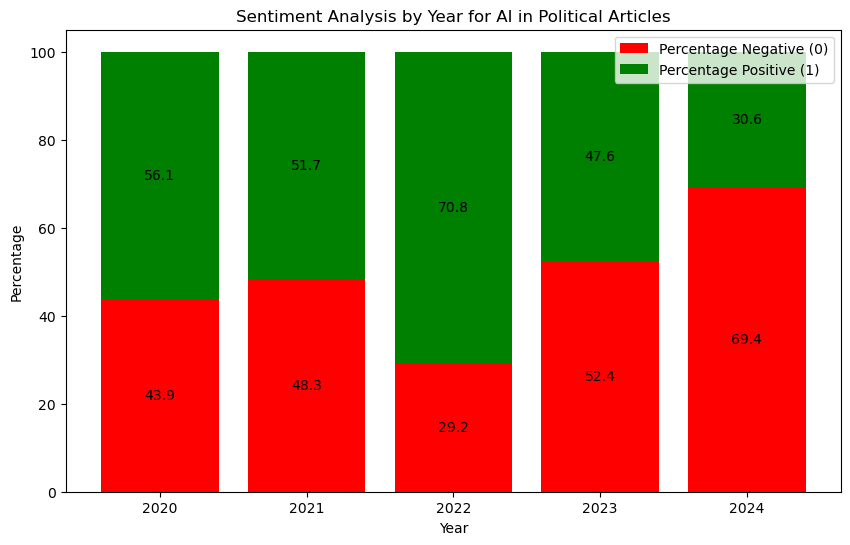

In [401]:
# Plotting
plt.figure(figsize=(10, 6))

# Stacked bar plot with custom colors
bar1 = plt.bar(grouped_df_v2.index, grouped_df_v2['percentage_0'], label='Percentage Negative (0)', color='red')
bar2 = plt.bar(grouped_df_v2.index, grouped_df_v2['percentage_1'], bottom=grouped_df_v2['percentage_0'], label='Percentage Positive (1)', color='green')

# Adding labels on top of each bar
for bars in [bar1, bar2]:
    for bar in bars:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width() / 2, bar.get_y() + bar.get_height() / 2, round(yval, 1),
                 va='center', ha='center')

# Adding labels and title
plt.xlabel('Year')
plt.ylabel('Percentage')
plt.title('Sentiment Analysis by Year for AI in Political Articles')
plt.legend()

# Set the x-ticks to actual year values
plt.xticks(grouped_df_v2.index)  # Assuming the index contains the actual year values

# Display the plot
plt.show()

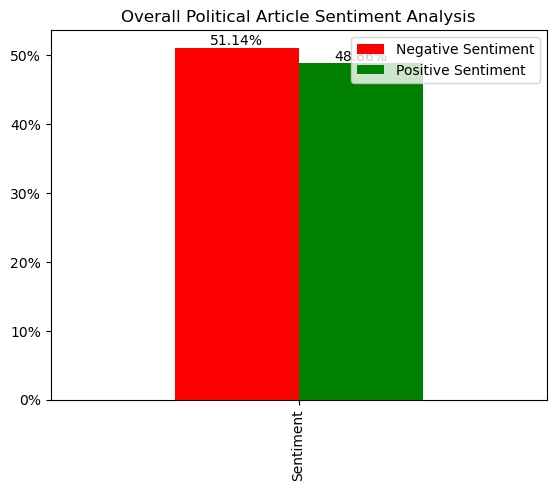

In [402]:
# Summing all values into a single row
sum_row = grouped_df_v2.sum(axis=0)

# Creating a new DataFrame with the summed values
new_df = pd.DataFrame(sum_row).transpose()
new_df = new_df[['NEGATIVE', 'POSITIVE', 'total']]
new_df['Negative Sentiment'] = round(new_df['NEGATIVE']/new_df['total'] *100,2)
new_df['Positive Sentiment'] = round(new_df['POSITIVE']/new_df['total'] *100,2)
new_df = new_df[['Negative Sentiment', 'Positive Sentiment']]


# Custom labels for the x-axis
custom_labels = ['Sentiment']
new_df.index = custom_labels


# Plotting with specified colors
ax = new_df.plot(kind='bar', color=['red', 'green'])


# Adding labels inside the bars
for p in ax.patches:
    ax.annotate(f'{p.get_height():.2f}%', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 5), 
                textcoords='offset points')

# Adding title
plt.title('Overall Political Article Sentiment Analysis')

# Formatting y-axis as percentage
ax.yaxis.set_major_formatter(mtick.PercentFormatter())
plt.show()

In [ ]:
['manufacturing', 'industry 4.0', 'quality control', 'quality assurance', '3D printing', 'industrial system', 'supply chain']

## Manufacturing Industry

In [403]:
keywords = ['manufacturing', 'industry 4.0', 'quality control', 'quality assurance', 'site manager', '3D printing', 'industrial system', 'electrician', 'machinist', 'supply chain', 'construction', 'construction management', 'welder', 'carpenter', 'plumber']

contains_title = filtered_df['title'].str.contains('|'.join(keywords), case=False).sum()

In [404]:
contains_title

1208

In [405]:
mask = filtered_df['title'].str.contains('|'.join(keywords), case=False)

In [406]:
filtered_df2 = filtered_df[mask]

In [407]:
filtered_df2

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column
60,https://feedroad.com/global-artificial-intelligence-in-construction-market-size-share-development-growth-and-demand-forecast-to-2025/,2020-04-03,"Global Artificial Intelligence In Construction Market Size, Share, Development, Growth and Demand Forecast to 2025 – Feed Road","Global Artificial Intelligence In Construction Market Size, Share, Development, Growth and Demand Forecast to 2025 Feed RoadToggle navigationHomeAboutOur AuthorsContactPrivacyCookiesEditorial Policy Feed RoadMarket Research ReportsMarket ReportsIndustry AnalyticsIndustry ReportMarket OutlookMarket ResearchAnalysis ForecastConsumption StatusFuture DemandsOpportunities Forecast Search for: Global Artificial Intelligence In Construction Market Size, Share, Development, Growth and Demand Foreca...",global artificial intelligence construction market size share development growth demand forecast feed roadtoggle navigationhomeaboutour authorscontactprivacycookieseditorial policy feed roadmarket research reportsmarket reportsindustry analyticsindustry reportmarket outlookmarket researchanalysis forecastconsumption statusfuture demandsopportunities forecast search global artificial intelligence construction market size share development growth demand forecast april offbyshubhamglobal artif...,82,2,18,11.111111,AI in Marketing
161,https://venturebeat.com/2020/05/19/microsoft-launches-project-bonsai-an-ai-development-platform-for-industrial-systems/,2020-05-19,"Microsoft launches Project Bonsai, an AI development platform for industrial systems | VentureBeat","Microsoft launches Project Bonsai, an AI development platform for industrial systems VentureBeat VentureBeat Homepage Channels GamesBeatAIARVRBig DataBusinessCloudCommerceDevEnterpriseEntrepreneurEsportsMarketingMediaMobilePC GamingSecuritySocialTransportationGot a news tipPress ReleasesWebinarsAdvertiseVB LabGuest Posts Events UpcomingTransformGB SummitMedia PartnerGot a news tipPress ReleasesWebinarsAdvertiseVB LabGuest PostsNewslettersSpecial Issue: AI and SurveillanceDealsSearch Icon He...",microsoft launches project bonsai ai development platform industrial systems venturebeat venturebeat homepage channels gamesbeataiarvrbig databusinesscloudcommercedeventerpriseentrepreneuresportsmarketingmediamobilepc gamingsecuritysocialtransportationgot news tippress releaseswebinarsadvertisevb labguest posts events upcomingtransformgb summitmedia partnergot news tippress releaseswebinarsadvertisevb labguest postsnewslettersspecial issue ai surveillancedealssearch icon helpful links got ne...,236,1,13,7.692308,Machine Learning Models for Human Tasks
209,https://www.blackhillsfox.com/prnewswire/2022/08/03/one-network-enterprises-enhances-automated-intelligence-machine-learning-improve-end-to-end-supply-chain-planning/,2022-08-03,One Network Enterprises Enhances Automated Intelligence and Machine Learning to Improve End-to-End Supply Chain Planning,One Network Enterprises Enhances Automated Intelligence and Machine Learning to Improve EndtoEnd Supply Chain PlanningSkip to contentNewsElection ResultsLocalWeatherSturgis RallyRising Star of the WestLive StreamingPhotosHomeElection ResultsLive StreamingNewsAgricultureBusinessCommunityCrimeEconomyEducationFine ArtsFoodHealthMedicalLaw EnforcementLocalMedicalMilitaryNationalRegionalScienceStateSturgis RallyTechnologyVideoWeatherDownload Our Weather AppClosingsWeather CamsWeather BlogGood Mor...,one network enterprises enhances automated intelligence machine learning improve endtoend supply chain planningskip contentnewselection resultslocalweathersturgis rallyrising star westlive streamingphotoshomeelection resultslive streamingnewsagriculturebusinesscommunitycrimeeconomyeducationfine artsfoodhealthmedicallaw enforcementlocalmedicalmilitarynationalregionalsciencestatesturgis rallytechnologyvideoweatherdownload weather appclosingsweather camsweather bloggood morning black hills se

In [408]:
# List of words to count occurrences for
words_to_count = ['manufacturing', 'industry 4.0', 'quality control', 'quality assurance', 'site manager', '3D printing', 'industrial system', 'electrician', 'machinist', 'supply chain', 'construction', 'construction management', 'welder', 'carpenter', 'plumber']

# Create a regular expression pattern to match any of the words in the list
pattern = '|'.join(words_to_count)

# Count occurrences of words and store the counts in a new column 'Healthcare'
filtered_df2['Healthcare'] = filtered_df2['title'].str.lower().str.count(pattern, flags=re.IGNORECASE)

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\2550895244.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Healthcare'] = filtered_df2['title'].str.lower().str.count(pattern, flags=re.IGNORECASE)


In [409]:
filtered_df2['Total_Words'] = filtered_df2['title'].str.split().apply(len)

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\1354618017.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Total_Words'] = filtered_df2['title'].str.split().apply(len)


In [410]:
filtered_df2['Healthcare_Percentage'] = (filtered_df2['Healthcare'] / filtered_df2['Total_Words']) * 100

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\240730045.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Healthcare_Percentage'] = (filtered_df2['Healthcare'] / filtered_df2['Total_Words']) * 100


In [411]:
manufacturing_articles = filtered_df2[filtered_df2['Healthcare_Percentage'] > 1]
manufacturing_articles.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1208 entries, 60 to 143334
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   url                    1208 non-null   object 
 1   date                   1208 non-null   object 
 2   title                  1208 non-null   object 
 3   text_clean             1208 non-null   object 
 4   text_clean_2           1208 non-null   object 
 5   ID                     1208 non-null   int64  
 6   Key_Words              1208 non-null   int64  
 7   Total_Words            1208 non-null   int64  
 8   Key_Words_Percentage   1208 non-null   float64
 9   new_column             1186 non-null   object 
 10  Healthcare             1208 non-null   int64  
 11  Healthcare_Percentage  1208 non-null   float64
dtypes: float64(2), int64(4), object(6)
memory usage: 122.7+ KB


In [412]:
manufacturing_articles['date'] = pd.to_datetime(manufacturing_articles['date'])
manufacturing_articles['year'] = manufacturing_articles['date'].dt.year
manufacturing_articles['month'] = manufacturing_articles['date'].dt.month

In [413]:
manufacturing_articles['year'].unique()

array([2020, 2022, 2023, 2021, 2024])

In [414]:
filtered_df100 = filtered_df1[['url', 'date', 'sentiment']]

# Convert the 'date' column in both DataFrames to the same data type
manufacturing_articles['date'] = pd.to_datetime(manufacturing_articles['date'])
filtered_df100['date'] = pd.to_datetime(filtered_df100['date'])

# Merge the DataFrames
merged_df = pd.merge(manufacturing_articles, filtered_df100[['url', 'date', 'sentiment']], on=['url', 'date'], how='left')


C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\3381697963.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df100['date'] = pd.to_datetime(filtered_df100['date'])


In [415]:
# Assuming filtered_df1 is your DataFrame
pivot_df = merged_df.pivot_table(index=['year', 'month'], columns='sentiment', aggfunc='size', fill_value=0).reset_index()

# Rename columns
pivot_df.columns.name = None  # Remove the name of the columns axis
pivot_df.columns = ['year', 'month', 'NEGATIVE', 'POSITIVE']


# Define a function to derive the 'Majority_Sentiment' column
def derive_sentiment(row):
    if row['NEGATIVE'] > row['POSITIVE']:
        return 'NEGATIVE'
    elif row['POSITIVE'] > row['NEGATIVE']:
        return 'POSITIVE'
    else:
        return 'NEUTRAL'  # Handle the case where '0' and '1' are equal

# Apply the function to each row to derive the 'Majority_Sentiment' column
pivot_df['Majority_Sentiment'] = pivot_df.apply(derive_sentiment, axis=1)
pivot_df

,year,month,NEGATIVE,POSITIVE,Majority_Sentiment
0,2020,1,4,21,POSITIVE
1,2020,2,4,18,POSITIVE
2,2020,3,2,26,POSITIVE
3,2020,4,0,33,POSITIVE
4,2020,5,0,17,POSITIVE
5,2020,6,0,6,POSITIVE
6,2020,7,5,7,POSITIVE
7,2020,8,3,15,POSITIVE
8,2020,9,1,10,POSITIVE
9,2020,10,3,14,POSITIVE


In [416]:
grouped_df_v2 = pivot_df.groupby('year')[['NEGATIVE', 'POSITIVE']].sum()


grouped_df_v2['total'] = grouped_df_v2['NEGATIVE'] + grouped_df_v2['POSITIVE']
grouped_df_v2['percentage_0'] = grouped_df_v2['NEGATIVE'] / grouped_df_v2['total'] * 100
grouped_df_v2['percentage_1'] = grouped_df_v2['POSITIVE'] / grouped_df_v2['total'] * 100
grouped_df_v2

,NEGATIVE,POSITIVE,total,percentage_0,percentage_1
year,,,,,
2020,26,206,232,11.206897,88.793103
2021,31,193,224,13.839286,86.160714
2022,47,218,265,17.735849,82.264151
2023,82,386,468,17.521368,82.478632
2024,6,13,19,31.578947,68.421053


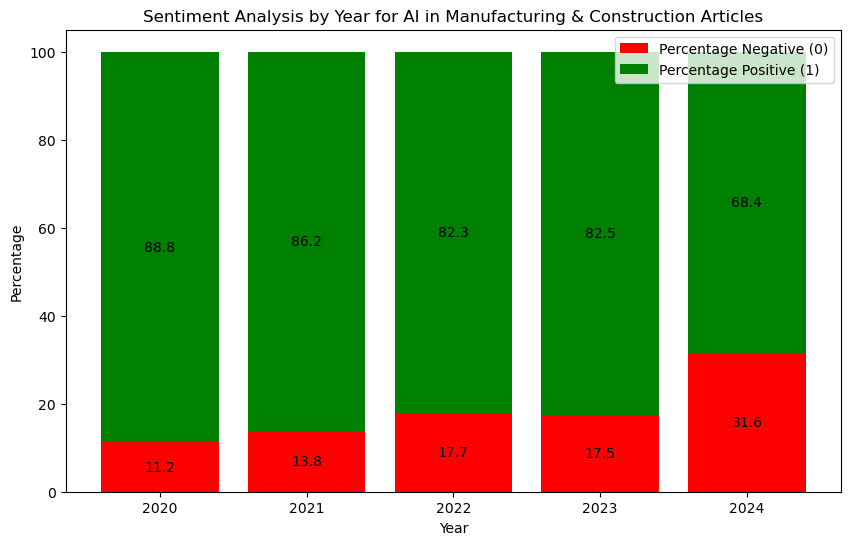

In [417]:
# Plotting
plt.figure(figsize=(10, 6))

# Stacked bar plot with custom colors
bar1 = plt.bar(grouped_df_v2.index, grouped_df_v2['percentage_0'], label='Percentage Negative (0)', color='red')
bar2 = plt.bar(grouped_df_v2.index, grouped_df_v2['percentage_1'], bottom=grouped_df_v2['percentage_0'], label='Percentage Positive (1)', color='green')

# Adding labels on top of each bar
for bars in [bar1, bar2]:
    for bar in bars:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width() / 2, bar.get_y() + bar.get_height() / 2, round(yval, 1),
                 va='center', ha='center')

# Adding labels and title
plt.xlabel('Year')
plt.ylabel('Percentage')
plt.title('Sentiment Analysis by Year for AI in Manufacturing & Construction Articles')
plt.legend()

# Set the x-ticks to actual year values
plt.xticks(grouped_df_v2.index)  # Assuming the index contains the actual year values

# Display the plot
plt.show()

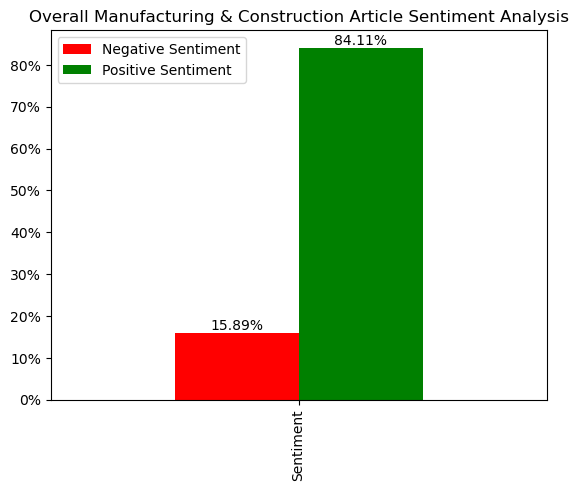

In [418]:
# Summing all values into a single row
sum_row = grouped_df_v2.sum(axis=0)

# Creating a new DataFrame with the summed values
new_df = pd.DataFrame(sum_row).transpose()
new_df = new_df[['NEGATIVE', 'POSITIVE', 'total']]
new_df['Negative Sentiment'] = round(new_df['NEGATIVE']/new_df['total'] *100,2)
new_df['Positive Sentiment'] = round(new_df['POSITIVE']/new_df['total'] *100,2)
new_df = new_df[['Negative Sentiment', 'Positive Sentiment']]


# Custom labels for the x-axis
custom_labels = ['Sentiment']
new_df.index = custom_labels


# Plotting with specified colors
ax = new_df.plot(kind='bar', color=['red', 'green'])


# Adding labels inside the bars
for p in ax.patches:
    ax.annotate(f'{p.get_height():.2f}%', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 5), 
                textcoords='offset points')

# Adding title
plt.title('Overall Manufacturing & Construction Article Sentiment Analysis')

# Formatting y-axis as percentage
ax.yaxis.set_major_formatter(mtick.PercentFormatter())
plt.show()

In [ ]:
laptop tv ['samsung', 'smart technology', 'smartphone', 'iphone', ]

In [ ]:
keywords = ['big tech ', 'facebook', ' meta ', 'google', 'apple ', 'microsoft', 'amazon', 'netflix']


## Music Industry

In [419]:
keywords = ['music', 'audio', 'voice', 'singer', 'song', 'sing', 'sound', 'soundtrack', 'tracks', 'musician', 'producer', 'album', 'songwriter', 'genre', 'lyric', ' concert ', ' choir ', 'orchestra', 'symphony']
contains_title = filtered_df['title'].str.contains('|'.join(keywords), case=False).sum()

In [420]:
contains_title

10439

In [421]:
mask = filtered_df['title'].str.contains('|'.join(keywords), case=False)

In [422]:
filtered_df2 = filtered_df[mask]


In [423]:
filtered_df2

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column
27,https://citylife.capetown/fi/uncategorized/apple-investing-quite-a-bit-in-generative-ai-but-its-ceo-is-being-tight-lipped/409869/,2023-11-05,Apple's Investment in Generative AI Signals Promising Future Applications,"Apples Investment in Generative AI Signals Promising Future Applications Hypp sisltnpe 3. marraskuuta 2023 KaupunkielmUusien teknologioiden ja tekolyn voiman paljastaminen AIUuttaTilaElektroniikkaSatelliittitiedeUSAOta yhteytt Uutta Apples Investment in Generative AI Signals Promising Future Applications ByVicky StavropoulouMarraskuu 3, 2023Apple Inc. Chief Executive Tim Cook recently revealed that the company is heavily investing in generative artificial intelligence AI, a technology popula...",apples investment generative ai signals promising future applications hypp sisltnpe marraskuuta kaupunkielmuusien teknologioiden ja tekolyn voiman paljastaminen aiuuttatilaelektroniikkasatelliittitiedeusaota yhteytt uutta apples investment generative ai signals promising future applications byvicky stavropouloumarraskuu apple inc chief executive tim cook recently revealed company heavily investing generative artificial intelligence ai technology popularized openais chatgpt cook remained tigh...,41,2,9,22.222222,AI Applications and Technologies
44,https://economictimes.indiatimes.com/news/india/to-ai-or-not-no-longer-a-question-it-majors-already-using-genai-for-several-functions/articleshow/102311931.cms,2023-08-01,AI IT companies: To AI or not no longer a question: IT majors already using GenAI for several tasks - The Economic Times,"AI IT companies: To AI or not no longer a question: IT majors already using GenAI for several tasks The Economic Times Benchmarks Nifty19,733.5520.25FEATURED FUNDSICICI Prudential Large Mid Cap Fund Direct Pla..5Y Return16.92 Invest NowFEATURED FUNDSCanara Robeco Equity Tax Saver RegularIDCW5Y Return15.44 Invest NowNewsEnglish EditionEnglish Edition Todays PaperSubscribeSign InSpecial Offer on ET PrimeHomeETPrimeMarketsNewsIndustryRisePoliticsWealthMutual FundsTechCareersOpinionNRIPanac...",ai companies ai longer question majors already using genai several tasks economic times benchmarks niftyfeatured fundsicici prudential large mid cap fund direct play return invest nowfeatured fundscanara robeco equity tax saver regularidcwy return invest nownewsenglish editionenglish edition todays papersubscribesign inspecial offer et primehomeetprimemarketsnewsindustryrisepoliticswealthmutual fundstechcareersopinionnripanacheet nowspotlightindiadecodedweb storiesmorning brief podcastnewsbl...,65,1,23,4.347826,AI Applications and Technologies
48,https://en.cedarnews.net/74850/task/youtube-will-let-you-make-songs-with-ai-clones-of-singers/,2023-11-16,YouTube Will Let You Make Songs With AI Clones of Singers – Cedar News English,"YouTube Will Let You Make Songs With AI Clones of Singers Cedar News English Skip to contentThu. Nov 16th, 2023 HomeBreakingLebanonNewsPoliticsCrimesVideoEntertainmentAR News YouTube Will Let You Make Songs With AI Clones of Singers ByNov 16, 2023clones:, singers,, songs, youtube SOPA Images Getty Images Making music is about to get a whole lot easierand potentially a lot worse too. YouTube announced Thursday that itll be releasing a product using artificial intelligence that allows users ...",youtube let make songs ai clones singers cedar news english skip contentthu nov th homebreakinglebanonnewspoliticscrimesvideoentertainmentar news youtube let make songs ai clones singers bynov clones singers songs youtube sopa images getty images making music get whole lot easierand potentially lot worse youtube announced thursday itll releasing product using artificial intelligence allows users create songs prompt tool called dream tracks available users create second tracks youtube shorts...,69,1,15,6.666667,AI in Weather Related Information or Services
67,https://gigaom.com/2020/01/09/voices-i

In [424]:
# List of words to count occurrences for
words_to_count =  ['music', 'audio', 'voice', 'singer', 'song', 'sing', 'sound', 'soundtrack', 'tracks', 'musician', 'producer', 'album', 'songwriter', 'genre', 'lyric', ' concert ', ' choir ', 'orchestra', 'symphony']

# Create a regular expression pattern to match any of the words in the list
pattern = '|'.join(words_to_count)

# Count occurrences of words and store the counts in a new column 'Healthcare'
filtered_df2['Healthcare'] = filtered_df2['title'].str.lower().str.count(pattern, flags=re.IGNORECASE)

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\2679262707.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Healthcare'] = filtered_df2['title'].str.lower().str.count(pattern, flags=re.IGNORECASE)


In [425]:
filtered_df2['Total_Words'] = filtered_df2['title'].str.split().apply(len)

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\1354618017.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Total_Words'] = filtered_df2['title'].str.split().apply(len)


In [426]:
filtered_df2['Healthcare_Percentage'] = (filtered_df2['Healthcare'] / filtered_df2['Total_Words']) * 100

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\240730045.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Healthcare_Percentage'] = (filtered_df2['Healthcare'] / filtered_df2['Total_Words']) * 100


In [427]:
bigtech_articles = filtered_df2[filtered_df2['Healthcare_Percentage'] > 1]
bigtech_articles.info()

<class 'pandas.core.frame.DataFrame'>
Index: 10439 entries, 27 to 143369
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   url                    10439 non-null  object 
 1   date                   10439 non-null  object 
 2   title                  10439 non-null  object 
 3   text_clean             10439 non-null  object 
 4   text_clean_2           10439 non-null  object 
 5   ID                     10439 non-null  int64  
 6   Key_Words              10439 non-null  int64  
 7   Total_Words            10439 non-null  int64  
 8   Key_Words_Percentage   10439 non-null  float64
 9   new_column             10286 non-null  object 
 10  Healthcare             10439 non-null  int64  
 11  Healthcare_Percentage  10439 non-null  float64
dtypes: float64(2), int64(4), object(6)
memory usage: 1.0+ MB


In [428]:
bigtech_articles['date'] = pd.to_datetime(bigtech_articles['date'])
bigtech_articles['year'] = bigtech_articles['date'].dt.year
bigtech_articles['month'] = bigtech_articles['date'].dt.month

In [429]:
bigtech_articles['year'].unique()

array([2023, 2020, 2024, 2021, 2022])

In [430]:
filtered_df100 = filtered_df1[['url', 'date', 'sentiment']]

# Convert the 'date' column in both DataFrames to the same data type
bigtech_articles['date'] = pd.to_datetime(bigtech_articles['date'])
filtered_df100['date'] = pd.to_datetime(filtered_df100['date'])

# Merge the DataFrames
merged_df = pd.merge(bigtech_articles, filtered_df100[['url', 'date', 'sentiment']], on=['url', 'date'], how='left')


C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\191937811.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df100['date'] = pd.to_datetime(filtered_df100['date'])


In [431]:
# Assuming filtered_df1 is your DataFrame
pivot_df = merged_df.pivot_table(index=['year', 'month'], columns='sentiment', aggfunc='size', fill_value=0).reset_index()

# Rename columns
pivot_df.columns.name = None  # Remove the name of the columns axis
pivot_df.columns = ['year', 'month', 'NEGATIVE', 'POSITIVE']


# Define a function to derive the 'Majority_Sentiment' column
def derive_sentiment(row):
    if row['NEGATIVE'] > row['POSITIVE']:
        return 'NEGATIVE'
    elif row['POSITIVE'] > row['NEGATIVE']:
        return 'POSITIVE'
    else:
        return 'NEUTRAL'  # Handle the case where '0' and '1' are equal

# Apply the function to each row to derive the 'Majority_Sentiment' column
pivot_df['Majority_Sentiment'] = pivot_df.apply(derive_sentiment, axis=1)
pivot_df

,year,month,NEGATIVE,POSITIVE,Majority_Sentiment
0,2020,1,18,32,POSITIVE
1,2020,2,26,47,POSITIVE
2,2020,3,18,56,POSITIVE
3,2020,4,22,56,POSITIVE
4,2020,5,16,44,POSITIVE
5,2020,6,18,28,POSITIVE
6,2020,7,19,38,POSITIVE
7,2020,8,9,38,POSITIVE
8,2020,9,15,30,POSITIVE
9,2020,10,17,63,POSITIVE


In [432]:
grouped_df_v2 = pivot_df.groupby('year')[['NEGATIVE', 'POSITIVE']].sum()


grouped_df_v2['total'] = grouped_df_v2['NEGATIVE'] + grouped_df_v2['POSITIVE']
grouped_df_v2['percentage_0'] = grouped_df_v2['NEGATIVE'] / grouped_df_v2['total'] * 100
grouped_df_v2['percentage_1'] = grouped_df_v2['POSITIVE'] / grouped_df_v2['total'] * 100
grouped_df_v2

,NEGATIVE,POSITIVE,total,percentage_0,percentage_1
year,,,,,
2020,227,529,756,30.026455,69.973545
2021,296,816,1112,26.618705,73.381295
2022,342,1033,1375,24.872727,75.127273
2023,2589,4240,6829,37.911847,62.088153
2024,136,231,367,37.057221,62.942779


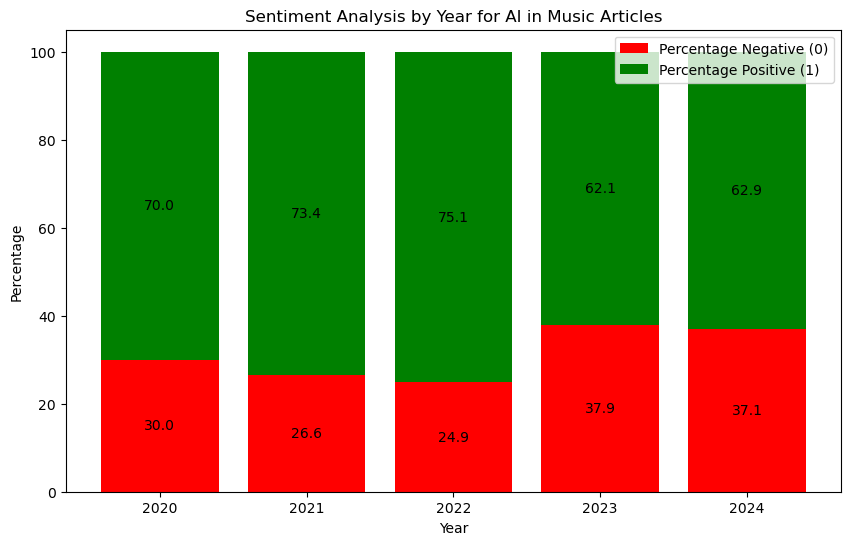

In [433]:
# Plotting
plt.figure(figsize=(10, 6))

# Stacked bar plot with custom colors
bar1 = plt.bar(grouped_df_v2.index, grouped_df_v2['percentage_0'], label='Percentage Negative (0)', color='red')
bar2 = plt.bar(grouped_df_v2.index, grouped_df_v2['percentage_1'], bottom=grouped_df_v2['percentage_0'], label='Percentage Positive (1)', color='green')

# Adding labels on top of each bar
for bars in [bar1, bar2]:
    for bar in bars:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width() / 2, bar.get_y() + bar.get_height() / 2, round(yval, 1),
                 va='center', ha='center')

# Adding labels and title
plt.xlabel('Year')
plt.ylabel('Percentage')
plt.title('Sentiment Analysis by Year for AI in Music Articles')
plt.legend()

# Set the x-ticks to actual year values
plt.xticks(grouped_df_v2.index)  # Assuming the index contains the actual year values

# Display the plot
plt.show()

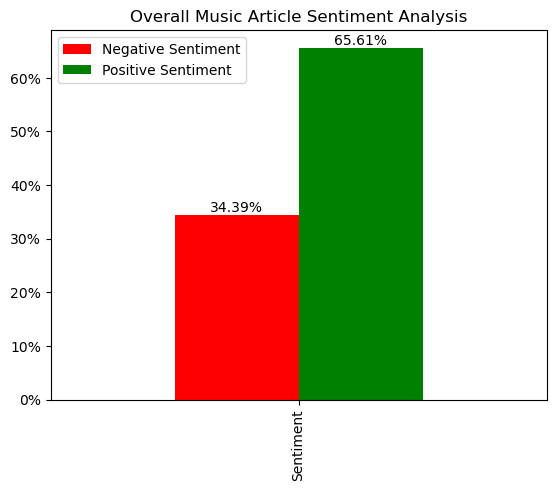

In [434]:
# Summing all values into a single row
sum_row = grouped_df_v2.sum(axis=0)

# Creating a new DataFrame with the summed values
new_df = pd.DataFrame(sum_row).transpose()
new_df = new_df[['NEGATIVE', 'POSITIVE', 'total']]
new_df['Negative Sentiment'] = round(new_df['NEGATIVE']/new_df['total'] *100,2)
new_df['Positive Sentiment'] = round(new_df['POSITIVE']/new_df['total'] *100,2)
new_df = new_df[['Negative Sentiment', 'Positive Sentiment']]


# Custom labels for the x-axis
custom_labels = ['Sentiment']
new_df.index = custom_labels


# Plotting with specified colors
ax = new_df.plot(kind='bar', color=['red', 'green'])


# Adding labels inside the bars
for p in ax.patches:
    ax.annotate(f'{p.get_height():.2f}%', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 5), 
                textcoords='offset points')

# Adding title
plt.title('Overall Music Article Sentiment Analysis')

# Formatting y-axis as percentage
ax.yaxis.set_major_formatter(mtick.PercentFormatter())
plt.show()

## Legal Industry

In [122]:
pd.set_option('display.max_colwidth', 150)

In [435]:
keywords = ['law', 'lawyer', 'paralegal', 'attorney', 'judge', 'court', 'court reporter', 'litigation', 'legal', 'legal secretary', 'legal advisor', 'legislation', 'legislative', 'solicitor', 'barrister']

contains_title = filtered_df['title'].str.contains('|'.join(keywords), case=False).sum()

In [436]:
contains_title

3425

In [437]:
mask = filtered_df['title'].str.contains('|'.join(keywords), case=False)

In [438]:
filtered_df2 = filtered_df[mask]

In [439]:
filtered_df2

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column
0,http://galusaustralis.com/2020/02/486473/legaltech-artificial-intelligence-market-2019-technology-advancement-and-future-scope-casetext-inc-catalyst-repository-systems-ebrevia/,2020-02-26,"LegalTech Artificial Intelligence Market 2019 Technology Advancement and Future Scope – Casetext Inc., Catalyst Repository Systems, eBREVIA – Galus Australis","LegalTech Artificial Intelligence Market 2019 Technology Advancement and Future Scope Casetext Inc., Catalyst Repository Systems, eBREVIA Galus Australis Galus AustralisBusinessGeneral NewsHealthcareIndustryInternationalLifestyleSciTechWednesday, February 26 2020TrendingNeedle Counters Market Comprehensive Study by Companies Medline Industries, Boen HealthcareSkin Scrub Trays Market Comprehensive Study by Companies Medline Industries, BD, DeroyalGlobal Portable Handheld Electronic Game Mac...",legaltech artificial intelligence market technology advancement future scope casetext inc catalyst repository systems ebrevia galus australis galus australisbusinessgeneral newshealthcareindustryinternationallifestylescitechwednesday february trendingneedle counters market comprehensive study companies medline industries boen healthcareskin scrub trays market comprehensive study companies medline industries bd deroyalglobal portable handheld electronic game machine market outlook business ...,0,1,20,5.000000,AI in Marketing
10,https://arstechnica.com/tech-policy/2023/08/report-potential-nyt-lawsuit-could-force-openai-to-wipe-chatgpt-and-start-over/,2023-08-18,Report: Potential NYT lawsuit could force OpenAI to wipe ChatGPT and start over | Ars Technica,Report: Potential NYT lawsuit could force OpenAI to wipe ChatGPT and start over Ars TechnicaSkip to main contentBiz ITTechSciencePolicyCarsGaming CultureStoreForumsSubscribeClose Navigate StoreSubscribeVideosFeaturesReviewsRSS FeedsMobile SiteAbout ArsStaff DirectoryContact UsAdvertise with ArsReprints Filter by topic Biz ITTechSciencePolicyCarsGaming CultureStoreForums Settings Front page layout Grid List Site themelightdark Sign in Sizing up the competition Report: Potential NYT lawsu...,report potential nyt lawsuit could force openai wipe chatgpt start ars technicaskip main contentbiz ittechsciencepolicycarsgaming culturestoreforumssubscribeclose navigate storesubscribevideosfeaturesreviewsrss feedsmobile siteabout arsstaff directorycontact usadvertise arsreprints filter topic biz ittechsciencepolicycarsgaming culturestoreforums settings front page layout grid list site themelightdark sign sizing competition report potential nyt lawsuit could force openai wipe chatgpt start...,18,2,16,12.500000,Ethical and Legal Implications of AI
97,https://murphyshockeylaw.net/uncategorized/3496722/global-artificial-intelligence-in-security-public-safety-and-national-security-market-2021-by-company-regions-type-and-application-forecast-to-2027/,2021-08-02,"Global Artificial Intelligence in Security, Public Safety and National Security Market 2021 by Company, Regions, Type and Application, Forecast to 2027 – Murphy's Hockey Law","Global Artificial Intelligence in Security, Public Safety and National Security Market 2021 by Company, Regions, Type and Application, Forecast to 2027 Murphys Hockey LawSkip to the content SearchMurphys Hockey Law MenuContact SearchSearch for:Close search Close Menu ContactCategoriesAll News Global Artificial Intelligence in Security, Public Safety and National Security Market 2021 by Company, Regions, Type and Application, Forecast to 2027Post author By anita Post date August 2, 2021 Glob...",global artificial intelligence security public safety national security market company regions type application forecast murphys hockey lawskip content searchmurphys hockey law menucontact searchsearch forclose search close menu contactcategoriesall news global artificial intelligence security public safety national security market company regions

In [440]:
# List of words to count occurrences for
words_to_count = ['law', 'lawyer', 'paralegal', 'attorney', 'judge', 'court', 'court reporter', 'litigation', 'legal', 'legal secretary', 'legal advisor', 'legislation', 'legislative', 'solicitor', 'barrister']

# Create a regular expression pattern to match any of the words in the list
pattern = '|'.join(words_to_count)

# Count occurrences of words and store the counts in a new column 'Healthcare'
filtered_df2['Healthcare'] = filtered_df2['title'].str.lower().str.count(pattern, flags=re.IGNORECASE)

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\160449285.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Healthcare'] = filtered_df2['title'].str.lower().str.count(pattern, flags=re.IGNORECASE)


In [441]:
filtered_df2['Total_Words'] = filtered_df2['title'].str.split().apply(len)

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\1354618017.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Total_Words'] = filtered_df2['title'].str.split().apply(len)


In [442]:
filtered_df2['Healthcare_Percentage'] = (filtered_df2['Healthcare'] / filtered_df2['Total_Words']) * 100

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\240730045.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df2['Healthcare_Percentage'] = (filtered_df2['Healthcare'] / filtered_df2['Total_Words']) * 100


In [443]:
legal_articles = filtered_df2[filtered_df2['Healthcare_Percentage'] > 1]
legal_articles.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3425 entries, 0 to 143310
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   url                    3425 non-null   object 
 1   date                   3425 non-null   object 
 2   title                  3425 non-null   object 
 3   text_clean             3425 non-null   object 
 4   text_clean_2           3425 non-null   object 
 5   ID                     3425 non-null   int64  
 6   Key_Words              3425 non-null   int64  
 7   Total_Words            3425 non-null   int64  
 8   Key_Words_Percentage   3425 non-null   float64
 9   new_column             3383 non-null   object 
 10  Healthcare             3425 non-null   int64  
 11  Healthcare_Percentage  3425 non-null   float64
dtypes: float64(2), int64(4), object(6)
memory usage: 347.9+ KB


In [444]:
legal_articles['date'] = pd.to_datetime(legal_articles['date'])
legal_articles['year'] = legal_articles['date'].dt.year
legal_articles['month'] = legal_articles['date'].dt.month

In [445]:
legal_articles['year'].unique()

array([2020, 2023, 2021, 2022, 2024])

In [446]:
filtered_df100 = filtered_df1[['url', 'date', 'sentiment']]

# Convert the 'date' column in both DataFrames to the same data type
legal_articles['date'] = pd.to_datetime(legal_articles['date'])
filtered_df100['date'] = pd.to_datetime(filtered_df100['date'])

# Merge the DataFrames
merged_df = pd.merge(legal_articles, filtered_df100[['url', 'date', 'sentiment']], on=['url', 'date'], how='left')


C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\1988521213.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df100['date'] = pd.to_datetime(filtered_df100['date'])


In [447]:
# Assuming filtered_df1 is your DataFrame
pivot_df = merged_df.pivot_table(index=['year', 'month'], columns='sentiment', aggfunc='size', fill_value=0).reset_index()

# Rename columns
pivot_df.columns.name = None  # Remove the name of the columns axis
pivot_df.columns = ['year', 'month', 'NEGATIVE', 'POSITIVE']


# Define a function to derive the 'Majority_Sentiment' column
def derive_sentiment(row):
    if row['NEGATIVE'] > row['POSITIVE']:
        return 'NEGATIVE'
    elif row['POSITIVE'] > row['NEGATIVE']:
        return 'POSITIVE'
    else:
        return 'NEUTRAL'  # Handle the case where '0' and '1' are equal

# Apply the function to each row to derive the 'Majority_Sentiment' column
pivot_df['Majority_Sentiment'] = pivot_df.apply(derive_sentiment, axis=1)
pivot_df

,year,month,NEGATIVE,POSITIVE,Majority_Sentiment
0,2020,1,4,8,POSITIVE
1,2020,2,2,11,POSITIVE
2,2020,3,2,11,POSITIVE
3,2020,4,3,14,POSITIVE
4,2020,5,4,8,POSITIVE
5,2020,6,10,4,NEGATIVE
6,2020,7,1,6,POSITIVE
7,2020,8,11,5,NEGATIVE
8,2020,9,0,8,POSITIVE
9,2020,10,5,12,POSITIVE


In [448]:
grouped_df_v2 = pivot_df.groupby('year')[['NEGATIVE', 'POSITIVE']].sum()


grouped_df_v2['total'] = grouped_df_v2['NEGATIVE'] + grouped_df_v2['POSITIVE']
grouped_df_v2['percentage_0'] = grouped_df_v2['NEGATIVE'] / grouped_df_v2['total'] * 100
grouped_df_v2['percentage_1'] = grouped_df_v2['POSITIVE'] / grouped_df_v2['total'] * 100
grouped_df_v2

,NEGATIVE,POSITIVE,total,percentage_0,percentage_1
year,,,,,
2020,58,171,229,25.327511,74.672489
2021,81,449,530,15.283019,84.716981
2022,110,92,202,54.455446,45.544554
2023,1205,966,2171,55.504376,44.495624
2024,163,130,293,55.631399,44.368601


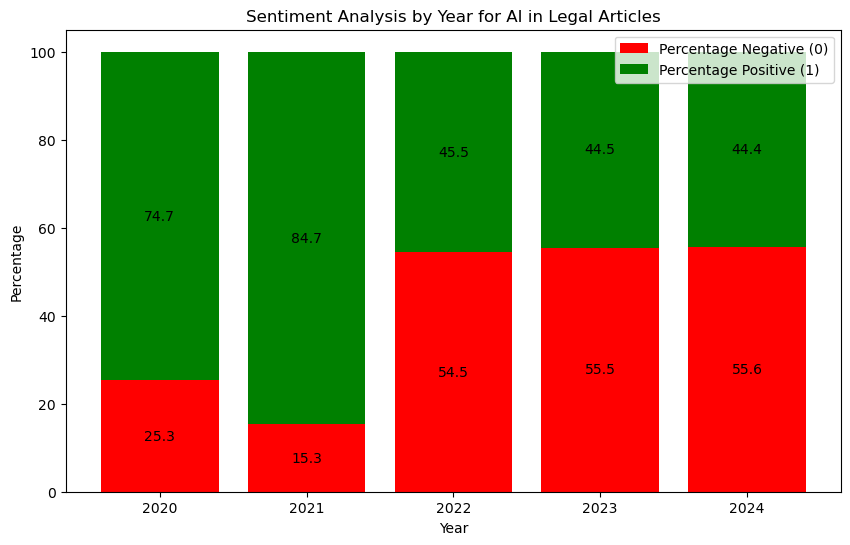

In [449]:
# Plotting
plt.figure(figsize=(10, 6))

# Stacked bar plot with custom colors
bar1 = plt.bar(grouped_df_v2.index, grouped_df_v2['percentage_0'], label='Percentage Negative (0)', color='red')
bar2 = plt.bar(grouped_df_v2.index, grouped_df_v2['percentage_1'], bottom=grouped_df_v2['percentage_0'], label='Percentage Positive (1)', color='green')

# Adding labels on top of each bar
for bars in [bar1, bar2]:
    for bar in bars:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width() / 2, bar.get_y() + bar.get_height() / 2, round(yval, 1),
                 va='center', ha='center')

# Adding labels and title
plt.xlabel('Year')
plt.ylabel('Percentage')
plt.title('Sentiment Analysis by Year for AI in Legal Articles')
plt.legend()

# Set the x-ticks to actual year values
plt.xticks(grouped_df_v2.index)  # Assuming the index contains the actual year values

# Display the plot
plt.show()

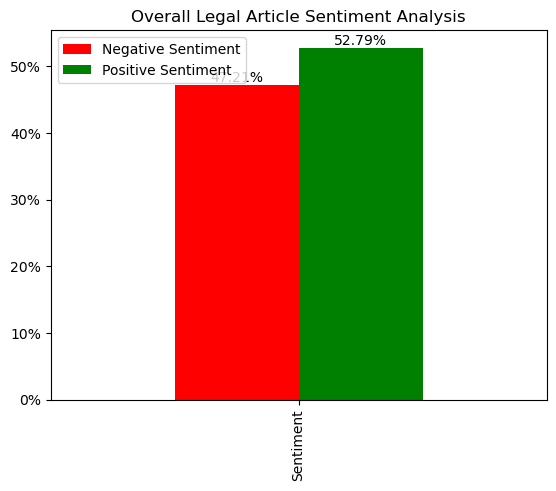

In [450]:
# Summing all values into a single row
sum_row = grouped_df_v2.sum(axis=0)

# Creating a new DataFrame with the summed values
new_df = pd.DataFrame(sum_row).transpose()
new_df = new_df[['NEGATIVE', 'POSITIVE', 'total']]
new_df['Negative Sentiment'] = round(new_df['NEGATIVE']/new_df['total'] *100,2)
new_df['Positive Sentiment'] = round(new_df['POSITIVE']/new_df['total'] *100,2)
new_df = new_df[['Negative Sentiment', 'Positive Sentiment']]


# Custom labels for the x-axis
custom_labels = ['Sentiment']
new_df.index = custom_labels


# Plotting with specified colors
ax = new_df.plot(kind='bar', color=['red', 'green'])


# Adding labels inside the bars
for p in ax.patches:
    ax.annotate(f'{p.get_height():.2f}%', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 5), 
                textcoords='offset points')

# Adding title
plt.title('Overall Legal Article Sentiment Analysis')

# Formatting y-axis as percentage
ax.yaxis.set_major_formatter(mtick.PercentFormatter())
plt.show()

## JOB ANALYSIS

In [472]:
sectors = {
    "Finance": ['bank teller', 'real estate agent', 'accountant', 'tax advisor', 'auditor', 'risk manager', 'risk analyst', 'financial analyst', 'investment banker', 'wealth manager', 'financial planner', 'insurance agent', 'portfolio manager', 'portfolio analyst', 'actuary', 'treasury analyst', 'financial advisor', 'underwriter', 'venture capitalist', 'credit analyst', 'chief financial officer'],
    "General": [' ceo ', 'chief operating officer', 'office manager', 'receptionist', 'project manager', 'human resources manager', 'hr manager', 'recruiter', 'customer service representative', 'consultant', 'business analyst', 'it support', 'sales representative', 'marketing manager', ' cmo ', 'chief marketing officer', 'operations manager', 'accountant'],
    "Legal": ['lawyer', 'paralegal', 'legal secretary', 'law clerk', 'legal consultant', 'attorney', 'legal admin', 'legal advisor', 'judge', 'court reporter', 'solicitor', 'barrister'],  
    "Political": ['policy advisor', 'politician', 'policy analyst', 'legislative assistant', 'secretary', 'speechwriter', 'government relations specialist']
    }

# Generate a flattened list of occupations
occupations = [job for sector in sectors.values() for job in sector]

occupations

['bank teller',
 'real estate agent',
 'accountant',
 'tax advisor',
 'auditor',
 'risk manager',
 'risk analyst',
 'financial analyst',
 'investment banker',
 'wealth manager',
 'financial planner',
 'insurance agent',
 'portfolio manager',
 'portfolio analyst',
 'actuary',
 'treasury analyst',
 'financial advisor',
 'underwriter',
 'venture capitalist',
 'credit analyst',
 'chief financial officer',
 ' ceo ',
 'chief operating officer',
 'office manager',
 'receptionist',
 'project manager',
 'human resources manager',
 'hr manager',
 'recruiter',
 'customer service representative',
 'consultant',
 'business analyst',
 'it support',
 'sales representative',
 'marketing manager',
 ' cmo ',
 'chief marketing officer',
 'operations manager',
 'accountant',
 'lawyer',
 'paralegal',
 'legal secretary',
 'law clerk',
 'legal consultant',
 'attorney',
 'legal admin',
 'legal advisor',
 'judge',
 'court reporter',
 'solicitor',
 'barrister',
 'policy advisor',
 'politician',
 'policy analyst

In [473]:
import pandas as pd
import matplotlib.pyplot as plt
from nltk.tokenize import word_tokenize
from nltk.probability import FreqDist
from nltk.corpus import stopwords
import nltk

# Ensure you have the necessary NLTK resources downloaded
nltk.download('punkt')
nltk.download('stopwords')

[nltk_data] Downloading package punkt to C:\Users\Jason
[nltk_data]     Sjafrudin\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to C:\Users\Jason
[nltk_data]     Sjafrudin\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [77]:
keywords = ['ceo']
contains_title = filtered_df1['text_clean_2'].str.contains('|'.join(keywords), case=False).sum()

In [78]:
contains_title

25

In [474]:
# Create an empty dictionary to store occupation frequencies
occupation_freq = {}
occupations = [occupation.lower() for occupation in occupations]

# Iterate over each occupation in the list
for occupation in occupations:
    # Count the occurrences of the occupation in the 'text_clean_2' column
    freq = filtered_df1['text_clean_2'].str.count(occupation).sum()
    
    # Store the frequency in the dictionary
    occupation_freq[occupation] = freq

# Convert the dictionary to a DataFrame
occupation_df = pd.DataFrame(list(occupation_freq.items()), columns=['occupations', 'frequency'])
occupation_df = occupation_df.sort_values(by='frequency', ascending=False)

In [475]:
occupation_df.head(50)

,occupations,frequency
21,ceo,86199
46,judge,11997
38,lawyer,10225
43,attorney,8100
54,secretary,6136
30,consultant,5225
16,financial advisor,4634
17,underwriter,2897
28,recruiter,2752
51,politician,2426


In [476]:
occupation_df = occupation_df.head(10)

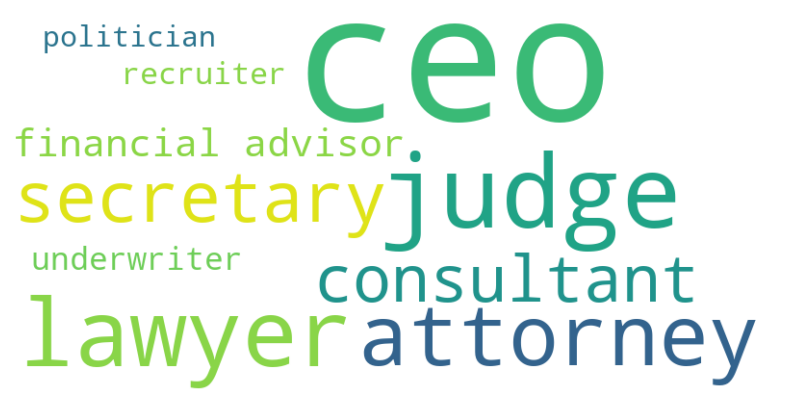

In [477]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Assuming occupation_df is your DataFrame with 'occupations' and 'frequency' columns

# Create a dictionary from 'occupations' and 'frequency' columns
word_freq_dict = dict(zip(occupation_df['occupations'], occupation_df['frequency']))

# Generate the word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_freq_dict)

# Plot the word cloud
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')  # Remove axes
plt.show()

In [486]:
occupation_df

,occupations,frequency
21,ceo,86199
46,judge,11997
38,lawyer,10225
43,attorney,8100
54,secretary,6136
30,consultant,5225
16,financial advisor,4634
17,underwriter,2897
28,recruiter,2752
51,politician,2426


## First Job

In [556]:

# Filter rows in filtered_df1 where 'text_clean_2' contains the word 'ceo'
filtered_df_with_job = filtered_df1[filtered_df1['text_clean_2'].str.contains(' financial advisor ', case=False)]
filtered_df_with_job['date'] = pd.to_datetime(filtered_df_with_job['date'])
filtered_df_with_job['year'] = filtered_df_with_job['date'].dt.year

filtered_df_with_job

C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\3730116050.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df_with_job['date'] = pd.to_datetime(filtered_df_with_job['date'])
C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_20880\3730116050.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df_with_job['year'] = filtered_df_with_job['date'].dt.year


,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column,sentiment,year
256,https://www.equities.com/news/exchange-traded-concepts-robo-global-artificial-intelligence-etf-thnq-falls-0-92-in-active-trading-on-august-26,2021-08-27,Exchange Traded Concepts - ROBO Global Artificial Intelligence ETF (THNQ) falls 0.92% in Active Trading on August 26 | Equities News,Exchange Traded Concepts ROBO Global Artificial Intelligence ETF THNQ falls 0.92 in Active Trading on August 26 Equities News Financial Markets by TradingView PreviousNext Login Register Equities.com member already Sign in hereSign in with your social account facebook twitter Password does not match Not on Equities.com yetYour Full Name:Username:EMail Address:Password:Confirm Password:Subscribe to Equities Newsletter: Register Verification code was sent to your email address .Confirm Regis...,exchange traded concepts robo global artificial intelligence etf thnq falls active trading august equities news financial markets tradingview previousnext login register equitiescom member already sign heresign social account facebook twitter password match equitiescom yetyour full nameusernameemail addresspasswordconfirm passwordsubscribe equities newsletter register verification code sent email address confirm registration try dont account register nowusername password match account yetequ...,395,1,21,4.761905,Data Science in Healthcare and Medicine,NEGATIVE,2021
427,https://www.livetradingnews.com/the-dragon-rises-how-chinas-ai-ambitions-will-fuel-exponential-growth-bidu-baba-tcehy-223774.html,2023-12-17,The Dragon Rises: How China's AI Ambitions Will Fuel Exponential Growth $BIDU $BABA $TCEHY - Live Trading News,"The Dragon Rises: How Chinas AI Ambitions Will Fuel Exponential Growth BIDU BABA TCEHY Live Trading NewsHomeLive NewsStocksBitcoinForexGoldHealthLuxuryHorse Racing SearchHomeLive NewsStocksBitcoinForexGoldHealthLuxuryHorse Racing Sunday, December 17, 2023Search Search StocksForexGoldKNIGHTSLuxuryHorse RacingTravel 2022 All Right Reserved.Home AI The Dragon Rises: How Chinas AI Ambitions Will Fuel Exponential Growth BIDU BABA TCEHYAIArtificial IntelligenceAsiaChinaChinaHeadline NewsHong Kon...",dragon rises chinas ai ambitions fuel exponential growth bidu baba tcehy live trading newshomelive newsstocksbitcoinforexgoldhealthluxuryhorse racing searchhomelive newsstocksbitcoinforexgoldhealthluxuryhorse racing sunday december search search stocksforexgoldknightsluxuryhorse racingtravel right reservedhome ai dragon rises chinas ai ambitions fuel exponential growth bidu baba tcehyaiartificial intelligenceasiachinachinaheadline newshong kongknightsbridge insightsmost popularmust readopini...,623,1,18,5.555556,AI in Marketing,POSITIVE,2023
446,https://www.nasdaq.com/articles/3-stocks-that-chatgpt-says-will-be-winners-this-holiday-season,2023-11-08,3 Stocks that ChatGPT Says Will Be Winners This Holiday Season | Nasdaq,3 Stocks that ChatGPT Says Will Be Winners This Holiday Season Nasdaq Skip to main contentNasdaqWeekly MacroScorecardMarket ActivityMarket ActivityStocksOptionsETFsMutual FundsIndexesCommoditiesCryptocurrencyCurrenciesFuturesFixed IncomeGlobal MarketsMarket RegulationU.S. RegulationEuropean Regulation Quick Links RealTime QuotesAfterHours QuotesPreMarket QuotesNasdaq100Symbol ScreenerOnline BrokersGlossarySustainable Bond NetworkSymbol Change HistoryIPO PerformanceOwnership SearchDividend H...,stocks chatgpt says winners holiday season nasdaq skip main contentnasdaqweekly macroscorecardmarket activitymarket activitystocksoptionsetfsmutual fundsindexescommoditiescryptocurrencycurrenciesfuturesfixed incomeglobal marketsmarket regulationus regulationeuropean regulation quick links realtime quotesafterhours quotespremarket quotesnasdaqsymbol screeneronline brokersglossarysustainable bond networksymbol change historyipo performanceownership searchdividend historyinvesting listsfundinsi...,654,1,13,7.692308,Generative AI in Music,NE

In [557]:
# Assuming filtered_df1 is your DataFrame
pivot_df = filtered_df_with_job.pivot_table(index=['year'], columns='sentiment', aggfunc='size', fill_value=0).reset_index()

# Rename columns
#pivot_df.columns.name = None  # Remove the name of the columns axis
#pivot_df.columns = ['year_month', 'NEGATIVE', 'POSITIVE']

pivot_df['total'] = pivot_df['NEGATIVE'] + pivot_df['POSITIVE']
pivot_df['percentage_0'] = pivot_df['NEGATIVE'] / pivot_df['total'] * 100
pivot_df['percentage_1'] = pivot_df['POSITIVE'] / pivot_df['total'] * 100

# Convert 'year_month' column to datetime objects
pivot_df

sentiment,year,NEGATIVE,POSITIVE,total,percentage_0,percentage_1
0,2020,5,16,21,23.809524,76.190476
1,2021,67,21,88,76.136364,23.863636
2,2022,17,11,28,60.714286,39.285714
3,2023,92,110,202,45.544554,54.455446
4,2024,5,10,15,33.333333,66.666667


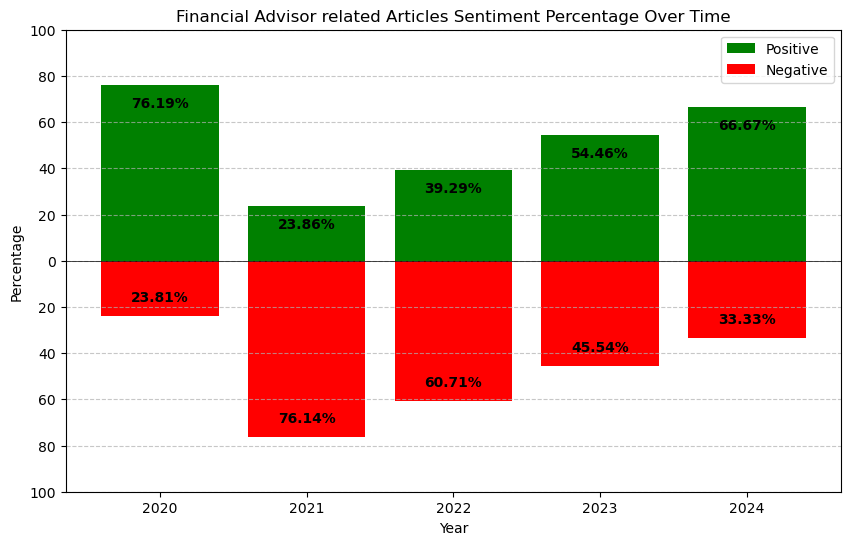

In [558]:
# Plotting
plt.figure(figsize=(10, 6))

# Plotting percentage_1 above x-axis
plt.bar(pivot_df['year'], pivot_df['percentage_1'], color='green', label='Positive')

# Plotting percentage_0 below x-axis
plt.bar(pivot_df['year'], -pivot_df['percentage_0'], color='red', label='Negative')

# Adding labels inside the bars
for index, row in pivot_df.iterrows():
    if row['percentage_1'] != 0:
        plt.text(row['year'], row['percentage_1'] - 5, f"{round(row['percentage_1'], 2)}%", ha='center', va='top', color='black', fontweight='bold')
    if row['percentage_0'] != 0:
        plt.text(row['year'], -row['percentage_0'] + 5, f"{round(row['percentage_0'], 2)}%", ha='center', va='bottom', color='black', fontweight='bold')

plt.xlabel('Year')
plt.ylabel('Percentage')
plt.title('Financial Advisor related Articles Sentiment Percentage Over Time')
plt.legend()

# Setting y-axis range and ticks
plt.yticks(range(-100, 101, 20), [abs(x) for x in range(-100, 101, 20)])

plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.axhline(0, color='black', linewidth=0.5)

plt.show()

In [551]:
# Assuming filtered_df1 is your DataFrame
pivot_df = filtered_df_with_job.pivot_table(index=['sentiment'], aggfunc='size', fill_value=0).reset_index()

# Rename columns
pivot_df.columns = ['sentiment', 'count']

# Calculate percentages
total_count = pivot_df['count'].sum()
pivot_df['percentage'] = pivot_df['count'] / total_count * 100

# Remove the 'sentiment' column name
pivot_df.columns.name = None

# Display the DataFrame
pivot_df

,sentiment,count,percentage
0,NEGATIVE,212,54.92228
1,POSITIVE,174,45.07772


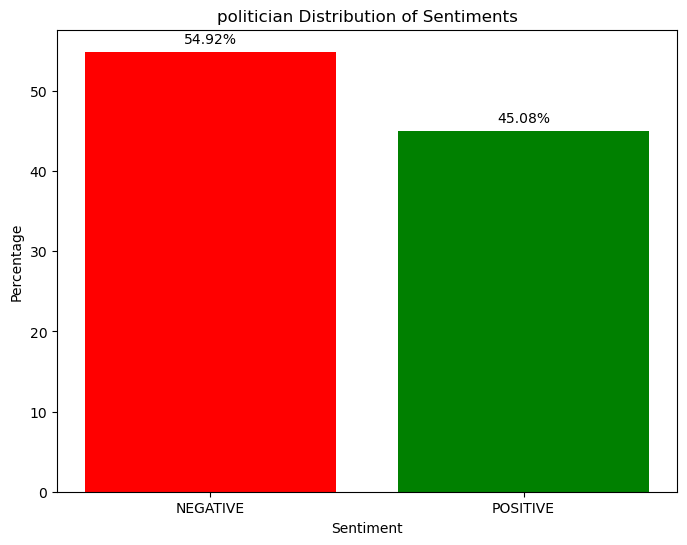

In [552]:

# Plotting
plt.figure(figsize=(8, 6))
plt.bar(pivot_df['sentiment'], pivot_df['percentage'], color=['red', 'green'])

# Adding labels and title
plt.xlabel('Sentiment')
plt.ylabel('Percentage')
plt.title('politician Distribution of Sentiments')

# Adding percentages on top of each bar
for index, row in pivot_df.iterrows():
    plt.text(row['sentiment'], row['percentage'] + 1, f"{round(row['percentage'], 2)}%", ha='center')

# Display the plot
plt.show()


## NER SPACY

In [567]:
import spacy
from spacy import displacy

C:\Users\Jason Sjafrudin\AppData\Roaming\Python\Python311\site-packages\cupy\_environment.py:216: UserWarning: CUDA path could not be detected. Set CUDA_PATH environment variable if CuPy fails to load.
  warnings.warn(
C:\Users\Jason Sjafrudin\AppData\Roaming\Python\Python311\site-packages\cupy\_environment.py:216: UserWarning: CUDA path could not be detected. Set CUDA_PATH environment variable if CuPy fails to load.
  warnings.warn(
C:\Users\Jason Sjafrudin\AppData\Roaming\Python\Python311\site-packages\cupy\_environment.py:216: UserWarning: CUDA path could not be detected. Set CUDA_PATH environment variable if CuPy fails to load.
  warnings.warn(


In [568]:
!python -m spacy download en_core_web_md

Defaulting to user installation because normal site-packages is not writeable

C:\Users\Jason Sjafrudin\AppData\Roaming\Python\Python311\site-packages\cupy\_environment.py:216: UserWarning: CUDA path could not be detected. Set CUDA_PATH environment variable if CuPy fails to load.
  warnings.warn(
C:\Users\Jason Sjafrudin\AppData\Roaming\Python\Python311\site-packages\cupy\_environment.py:216: UserWarning: CUDA path could not be detected. Set CUDA_PATH environment variable if CuPy fails to load.
  warnings.warn(
C:\Users\Jason Sjafrudin\AppData\Roaming\Python\Python311\site-packages\cupy\_environment.py:216: UserWarning: CUDA path could not be detected. Set CUDA_PATH environment variable if CuPy fails to load.
  warnings.warn(
C:\Users\Jason Sjafrudin\AppData\Roaming\Python\Python311\site-packages\cupy\_environment.py:216: UserWarning: CUDA path could not be detected. Set CUDA_PATH environment variable if CuPy fails to load.
  warnings.warn(



     ---------------------------------------- 0.0/42.8 MB ? eta -:--:--
     --------------------------------------- 0.0/42.8 MB 660.6 kB/s eta 0:01:05
     ---------------------------------------- 0.2/42.8 MB 2.0 MB/s eta 0:00:22
      --------------------------------------- 0.6/42.8 MB 4.0 MB/s eta 0:00:11
      --------------------------------------- 0.8/42.8 MB 4.6 MB/s eta 0:00:10
     - -------------------------------------- 1.1/42.8 MB 4.6 MB/s eta 0:00:10
     - -------------------------------------- 1.6/42.8 MB 5.6 MB/s eta 0:00:08
     - -------------------------------------- 2.1/42.8 MB 6.4 MB/s eta 0:00:07
     -- ------------------------------------- 2.6/42.8 MB 6.8 MB/s eta 0:00:06
     --- ------------------------------------ 3.3/42.8 MB 7.7 MB/s eta 0:00:06
     --- ------------------------------------ 4.1/42.8 MB 8.8 MB/s eta 0:00:05
     ---- ----------------------------------- 5.0/42.8 MB 9.8 MB/s eta 0:00:04
     ----- ---------------------------------- 6.1/42.8 MB

In [570]:
nlp = spacy.load("en_core_web_md")


In [571]:
entities = []
labels = []
position_start = []
position_end = []

for text in filtered_df['text_clean']:
    doc = nlp(text)
    for ent in doc.ents:
        entities.append(ent.text)
        labels.append(ent.label_)
        position_start.append(ent.start_char)
        position_end.append(ent.end_char)

df_ner_spacy_wo_text_results = pd.DataFrame({'Entities': entities, 'Labels': labels, 'Position_Start': position_start, 'Position_End': position_end})

In [572]:
df_ner_spacy_wo_text_results.to_csv('output_file500.csv', index=False)

In [7]:
df_ner_spacy_wo_text_results = pd.read_csv('C:/Users/Jason Sjafrudin/Downloads/output_file500.csv')


In [8]:
df_ner_spacy_wo_text_results

,Entities,Labels,Position_Start,Position_End
0,LegalTech,ORG,0,9
1,Casetext Inc.,ORG,87,100
2,Catalyst Repository Systems,ORG,102,129
3,Australis Galus,PERSON,146,161
4,NewsHealthcareIndustryInternationalLifestyleSc...,DATE,187,247
...,...,...,...,...
14270791,CookiesThese,NORP,6331,6343
14270792,CookiesThese,NORP,6769,6781
14270793,third,ORDINAL,6892,6897
14270794,CookiesThese,NORP,7062,7074


In [9]:
unique_labels = df_ner_spacy_wo_text_results['Labels'].unique()
unique_labels

array(['ORG', 'PERSON', 'DATE', 'CARDINAL', 'WORK_OF_ART', 'GPE', 'MONEY',
       'NORP', 'LOC', 'TIME', 'PRODUCT', 'FAC', 'LAW', 'ORDINAL',
       'PERCENT', 'LANGUAGE', 'EVENT', 'QUANTITY'], dtype=object)

In [10]:
filtered_rows = df_ner_spacy_wo_text_results[df_ner_spacy_wo_text_results['Entities'] == 'ChatGPT']
filtered_rows['Labels'].unique()

array(['PERSON', 'ORG', 'PRODUCT'], dtype=object)

## CORRECT AND/OR REMOVE SOME OF THE LABELS 

In [11]:
#UPDATE ChatGPT to PRODUCT
df_ner_spacy_wo_text_results.loc[df_ner_spacy_wo_text_results['Entities'] == 'ChatGPT', 'Labels'] = 'PRODUCT'
df_ner_spacy_wo_text_results

,Entities,Labels,Position_Start,Position_End
0,LegalTech,ORG,0,9
1,Casetext Inc.,ORG,87,100
2,Catalyst Repository Systems,ORG,102,129
3,Australis Galus,PERSON,146,161
4,NewsHealthcareIndustryInternationalLifestyleSc...,DATE,187,247
...,...,...,...,...
14270791,CookiesThese,NORP,6331,6343
14270792,CookiesThese,NORP,6769,6781
14270793,third,ORDINAL,6892,6897
14270794,CookiesThese,NORP,7062,7074


In [12]:
#REMOVE AI, Artificial Intelligence, AIgenerated, Gray Media Group

filtered_rows = df_ner_spacy_wo_text_results[df_ner_spacy_wo_text_results['Entities'] != 'AI']
filtered_rows = filtered_rows[filtered_rows['Entities'] != 'Artificial Intelligence']
filtered_rows = filtered_rows[filtered_rows['Entities'] != 'AIgenerated']
filtered_rows = filtered_rows[filtered_rows['Entities'] != 'Gray Media Group']

# Update the original DataFrame to contain only the filtered rows
df_ner_spacy_wo_text_results = filtered_rows

## ORGANIZATIONS (ORG)

In [13]:
df_ner_results_sel = df_ner_spacy_wo_text_results[['Entities', 'Labels']]
df_ner_results_sel = df_ner_results_sel[(df_ner_results_sel['Labels'] == 'ORG')]

In [15]:
# Group by 'Entities' and count occurrences
entities_counts = df_ner_results_sel.groupby('Entities').size().reset_index(name='Count')

# Select the top 13 entities
top_13_entities = entities_counts.nlargest(13, 'Count')

# Filter rows where 'Entities' is 'DLA Piper'
dla_piper_row = entities_counts[entities_counts['Entities'] == 'DLA Piper']
dla_piper_row2 = entities_counts[entities_counts['Entities'] == 'Dentons']

# Concatenate top 13 entities with DLA Piper row
top_10_entities = pd.concat([top_13_entities, dla_piper_row, dla_piper_row2])

top_10_entities

,Entities,Count
311583,Google,83979
457049,Microsoft,74458
519446,OpenAI,40136
316585,"Gray Television, Inc.",35591
57164,Amazon,23559
345613,IBM,20280
66457,Apple,16614
62742,Android,13111
262411,Facebook,12726
369975,Intel,12135


In [16]:
rows_with_law_firms = entities_counts[entities_counts['Entities'].str.contains('Dentons')]
rows_with_law_firms

,Entities,Count
91640,Autonomous Vehicles To Smart Cities: Privacy I...,1
214499,Dentons,28
214500,Dentons Dentons,7
214501,Dentons Global Advisors,1
214502,Dentons Rodyk,1
214503,Dentons Traffic Management Center,1
214504,Dentons US,2
214505,DentonsDentons,1
327404,Harvard Law School Recruiting Events in Protes...,1
393405,Kensington SwanDentons,1


In [26]:
filtered_df100 = filtered_df1

In [27]:
# Extracting year and quarter information
filtered_df100['date'] = pd.to_datetime(filtered_df100['date'])

filtered_df100['year_quarter'] = filtered_df100['date'].dt.year.astype(str) + '-Q' + \
                                filtered_df100['date'].dt.quarter.astype(str)

# Display the DataFrame with the new column

filtered_df100

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column,sentiment,year_quarter
0,http://galusaustralis.com/2020/02/486473/legal...,2020-02-26,LegalTech Artificial Intelligence Market 2019 ...,LegalTech Artificial Intelligence Market 2019 ...,legaltech artificial intelligence market techn...,0,1,20,5.000000,AI in Marketing,POSITIVE,2020-Q1
1,http://www.millenniumpost.in/big-stories/ai-ex...,2020-08-07,Two dead as AI Express flight skids off Kozhik...,Two dead as AI Express flight skids off Kozhik...,two dead ai express flight skids kozhikode air...,4,1,10,10.000000,AI in Weather Related Information or Services,NEGATIVE,2020-Q3
2,http://www.nativestew.com/2023/11/ai-took-my-j...,2023-11-20,"Native Stew - Bahamas AI Art, Photos, Videos: ...","Native Stew Bahamas AI Art, Photos, Videos: A...",native stew bahamas ai art photos videos ai to...,5,2,12,16.666667,AI Applications and Technologies,POSITIVE,2023-Q4
3,http://www.sbwire.com/press-releases/healthcar...,2022-10-06,Healthcare Artificial Intelligence Market Anal...,Healthcare Artificial Intelligence Market Anal...,healthcare artificial intelligence market anal...,8,2,11,18.181818,AI in Marketing,POSITIVE,2022-Q4
4,https://3wnews.org/industry/704499/artificial-...,2020-04-29,Artificial Intelligence As A Service Market : ...,Artificial Intelligence As A Service Market : ...,artificial intelligence service market opportu...,9,1,19,5.263158,AI in Marketing,POSITIVE,2020-Q2
...,...,...,...,...,...,...,...,...,...,...,...,...
137736,https://www.zdnet.com/article/google-cloud-exp...,2023-08-29,Google Cloud expands developer tools and data ...,Google Cloud expands developer tools and data ...,google cloud expands developer tools data anal...,200430,2,14,14.285714,NaN,POSITIVE,2023-Q3
137737,https://yen.com.gh/business-economy/231589-twi...,2023-04-12,Twitter working on AI despite Musk call for gl...,Twitter working on AI despite Musk call for gl...,twitter working ai despite musk call global pa...,200431,1,13,7.692308,NaN,NEGATIVE,2023-Q2
137738,https://zeenews.india.com/companies/one-ai-kil...,2022-12-31,'One AI Killer app will emerge...': Nothing fo...,One AI Killer app will emerge...: Nothing foun...,one ai killer app emerge nothing founder carl ...,200432,1,25,4.000000,NaN,NEGATIVE,2022-Q4
137739,https://zeenews.india.com/technology/openai-re...,2023-04-29,OpenAI Restores Access To ChatGPT In Italy Aft...,OpenAI Restores Access To ChatGPT In Italy Aft...,openai restores access chatgpt italy ban techn...,200433,2,15,13.333333,NaN,POSITIVE,2023-Q2


In [28]:

# Create a regex pattern to match mentions of entities in 'text_clean_2'
pattern = '|'.join(top_10_entities['Entities'].map(re.escape))

# Extract mentions of entities from 'text_clean_2' using regex pattern
mentions = filtered_df100['text_clean'].str.extractall(f'({pattern})').groupby(level=0)[0].apply(list)


filtered_df100['mentions'] = mentions
filtered_df100

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column,sentiment,year_quarter,mentions
0,http://galusaustralis.com/2020/02/486473/legal...,2020-02-26,LegalTech Artificial Intelligence Market 2019 ...,LegalTech Artificial Intelligence Market 2019 ...,legaltech artificial intelligence market techn...,0,1,20,5.000000,AI in Marketing,POSITIVE,2020-Q1,"[Intel, Intel, Intel, Intel, Intel, Intel, Int..."
1,http://www.millenniumpost.in/big-stories/ai-ex...,2020-08-07,Two dead as AI Express flight skids off Kozhik...,Two dead as AI Express flight skids off Kozhik...,two dead ai express flight skids kozhikode air...,4,1,10,10.000000,AI in Weather Related Information or Services,NEGATIVE,2020-Q3,NaN
2,http://www.nativestew.com/2023/11/ai-took-my-j...,2023-11-20,"Native Stew - Bahamas AI Art, Photos, Videos: ...","Native Stew Bahamas AI Art, Photos, Videos: A...",native stew bahamas ai art photos videos ai to...,5,2,12,16.666667,AI Applications and Technologies,POSITIVE,2023-Q4,"[Twitter, Facebook, Twitter]"
3,http://www.sbwire.com/press-releases/healthcar...,2022-10-06,Healthcare Artificial Intelligence Market Anal...,Healthcare Artificial Intelligence Market Anal...,healthcare artificial intelligence market anal...,8,2,11,18.181818,AI in Marketing,POSITIVE,2022-Q4,"[Intel, Intel, Intel, Intel, Intel, IBM, Micro..."
4,https://3wnews.org/industry/704499/artificial-...,2020-04-29,Artificial Intelligence As A Service Market : ...,Artificial Intelligence As A Service Market : ...,artificial intelligence service market opportu...,9,1,19,5.263158,AI in Marketing,POSITIVE,2020-Q2,"[Intel, Intel, Intel, Intel, Intel, Intel, Int..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
137736,https://www.zdnet.com/article/google-cloud-exp...,2023-08-29,Google Cloud expands developer tools and data ...,Google Cloud expands developer tools and data ...,google cloud expands developer tools data anal...,200430,2,14,14.285714,NaN,POSITIVE,2023-Q3,"[Google, Apple, Google, Intel, Amazon, Apple, ..."
137737,https://yen.com.gh/business-economy/231589-twi...,2023-04-12,Twitter working on AI despite Musk call for gl...,Twitter working on AI despite Musk call for gl...,twitter working ai despite musk call global pa...,200431,1,13,7.692308,NaN,NEGATIVE,2023-Q2,"[Twitter, Google, Twitter, Twitter, Twitter, T..."
137738,https://zeenews.india.com/companies/one-ai-kil...,2022-12-31,'One AI Killer app will emerge...': Nothing fo...,One AI Killer app will emerge...: Nothing foun...,one ai killer app emerge nothing founder carl ...,200432,1,25,4.000000,NaN,NEGATIVE,2022-Q4,"[Apple, Meta, Apple, Meta, Twitter, Meta, Appl..."
137739,https://zeenews.india.com/technology/openai-re...,2023-04-29,OpenAI Restores Access To ChatGPT In Italy Aft...,OpenAI Restores Access To ChatGPT In Italy Aft...,openai restores access chatgpt italy ban techn...,200433,2,15,13.333333,NaN,POSITIVE,2023-Q2,"[OpenAI, OpenAI, OpenAI, Microsoft, OpenAI, Ap..."


In [29]:
# Explode the mentions to create separate rows for each mention
filtered_df100_exploded = filtered_df100.explode('mentions')

# Group by 'year_quarter' and 'mentions' and count the occurrences
result_df = filtered_df100_exploded.groupby(['year_quarter', 'mentions']).size().reset_index(name='count')


In [30]:
result_df

,year_quarter,mentions,count
0,2020-Q1,Amazon,1549
1,2020-Q1,Android,358
2,2020-Q1,Apple,1087
3,2020-Q1,DLA Piper,2
4,2020-Q1,Dentons,1
...,...,...,...
235,2024-Q1,Meta,2908
236,2024-Q1,Microsoft,8061
237,2024-Q1,Nvidia,2111
238,2024-Q1,OpenAI,7861


In [33]:
import matplotlib.pyplot as plt


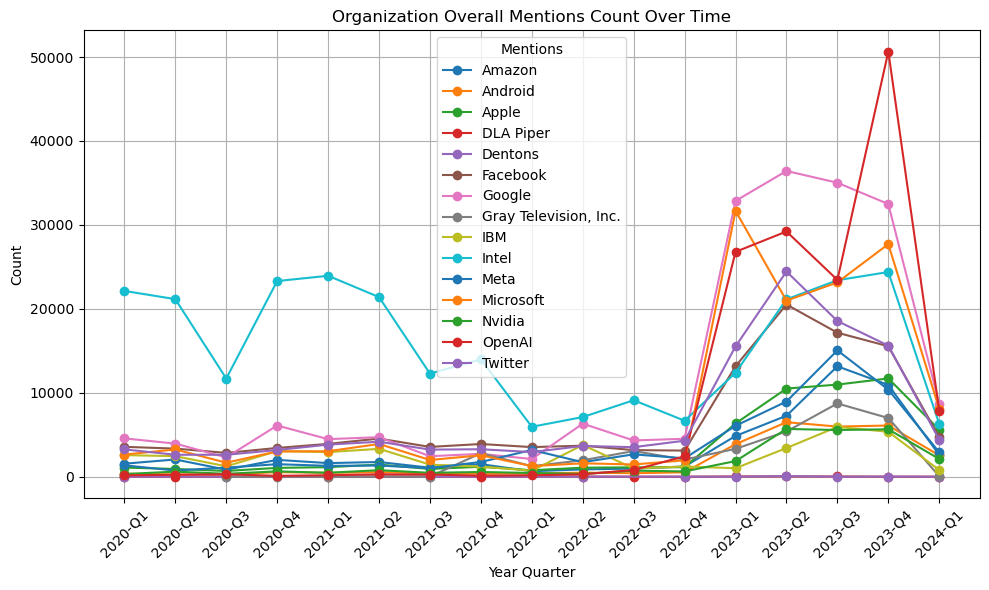

In [36]:
# Grouping by 'mentions' to plot each mention as a separate line
grouped = result_df.groupby('mentions')

plt.figure(figsize=(10, 6))

# Plotting each line for mentions
for name, group in grouped:
    plt.plot(group['year_quarter'], group['count'], marker='o', label=name)

plt.xlabel('Year Quarter')
plt.ylabel('Count')
plt.title('Organization Overall Mentions Count Over Time')
plt.xticks(rotation=45)
plt.legend(title='Mentions')
plt.grid(True)

plt.tight_layout()
plt.show()

In [37]:
# Replace NaN values with an empty list
filtered_df100['mentions'] = filtered_df100['mentions'].apply(lambda x: [] if x is np.nan else x)

# Remove duplicates from each list
filtered_df100['mentions'] = filtered_df100['mentions'].apply(lambda x: list(set(x)))

In [38]:
filtered_df100

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column,sentiment,year_quarter,mentions
0,http://galusaustralis.com/2020/02/486473/legal...,2020-02-26,LegalTech Artificial Intelligence Market 2019 ...,LegalTech Artificial Intelligence Market 2019 ...,legaltech artificial intelligence market techn...,0,1,20,5.000000,AI in Marketing,POSITIVE,2020-Q1,"[Google, Intel, Twitter, Facebook]"
1,http://www.millenniumpost.in/big-stories/ai-ex...,2020-08-07,Two dead as AI Express flight skids off Kozhik...,Two dead as AI Express flight skids off Kozhik...,two dead ai express flight skids kozhikode air...,4,1,10,10.000000,AI in Weather Related Information or Services,NEGATIVE,2020-Q3,[]
2,http://www.nativestew.com/2023/11/ai-took-my-j...,2023-11-20,"Native Stew - Bahamas AI Art, Photos, Videos: ...","Native Stew Bahamas AI Art, Photos, Videos: A...",native stew bahamas ai art photos videos ai to...,5,2,12,16.666667,AI Applications and Technologies,POSITIVE,2023-Q4,"[Twitter, Facebook]"
3,http://www.sbwire.com/press-releases/healthcar...,2022-10-06,Healthcare Artificial Intelligence Market Anal...,Healthcare Artificial Intelligence Market Anal...,healthcare artificial intelligence market anal...,8,2,11,18.181818,AI in Marketing,POSITIVE,2022-Q4,"[IBM, Intel, Microsoft]"
4,https://3wnews.org/industry/704499/artificial-...,2020-04-29,Artificial Intelligence As A Service Market : ...,Artificial Intelligence As A Service Market : ...,artificial intelligence service market opportu...,9,1,19,5.263158,AI in Marketing,POSITIVE,2020-Q2,"[IBM, Intel, Amazon, Microsoft, Meta, Google]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
137736,https://www.zdnet.com/article/google-cloud-exp...,2023-08-29,Google Cloud expands developer tools and data ...,Google Cloud expands developer tools and data ...,google cloud expands developer tools data anal...,200430,2,14,14.285714,NaN,POSITIVE,2023-Q3,"[Intel, Amazon, Microsoft, Google, Twitter, Ap..."
137737,https://yen.com.gh/business-economy/231589-twi...,2023-04-12,Twitter working on AI despite Musk call for gl...,Twitter working on AI despite Musk call for gl...,twitter working ai despite musk call global pa...,200431,1,13,7.692308,NaN,NEGATIVE,2023-Q2,"[OpenAI, Microsoft, Google, Twitter, Meta, App..."
137738,https://zeenews.india.com/companies/one-ai-kil...,2022-12-31,'One AI Killer app will emerge...': Nothing fo...,One AI Killer app will emerge...: Nothing foun...,one ai killer app emerge nothing founder carl ...,200432,1,25,4.000000,NaN,NEGATIVE,2022-Q4,"[Meta, Apple, Twitter]"
137739,https://zeenews.india.com/technology/openai-re...,2023-04-29,OpenAI Restores Access To ChatGPT In Italy Aft...,OpenAI Restores Access To ChatGPT In Italy Aft...,openai restores access chatgpt italy ban techn...,200433,2,15,13.333333,NaN,POSITIVE,2023-Q2,"[OpenAI, Apple, Microsoft]"


In [39]:

# Explode the mentions to create separate rows for each mention
filtered_df100_exploded2 = filtered_df100.explode('mentions')

# Group by 'year_quarter' and 'mentions' and count the occurrences
result_df = filtered_df100_exploded2.groupby(['year_quarter', 'mentions']).size().reset_index(name='count')


In [40]:
result_df

,year_quarter,mentions,count
0,2020-Q1,Amazon,744
1,2020-Q1,Android,193
2,2020-Q1,Apple,470
3,2020-Q1,DLA Piper,2
4,2020-Q1,Dentons,1
...,...,...,...
235,2024-Q1,Meta,964
236,2024-Q1,Microsoft,1682
237,2024-Q1,Nvidia,465
238,2024-Q1,OpenAI,1508


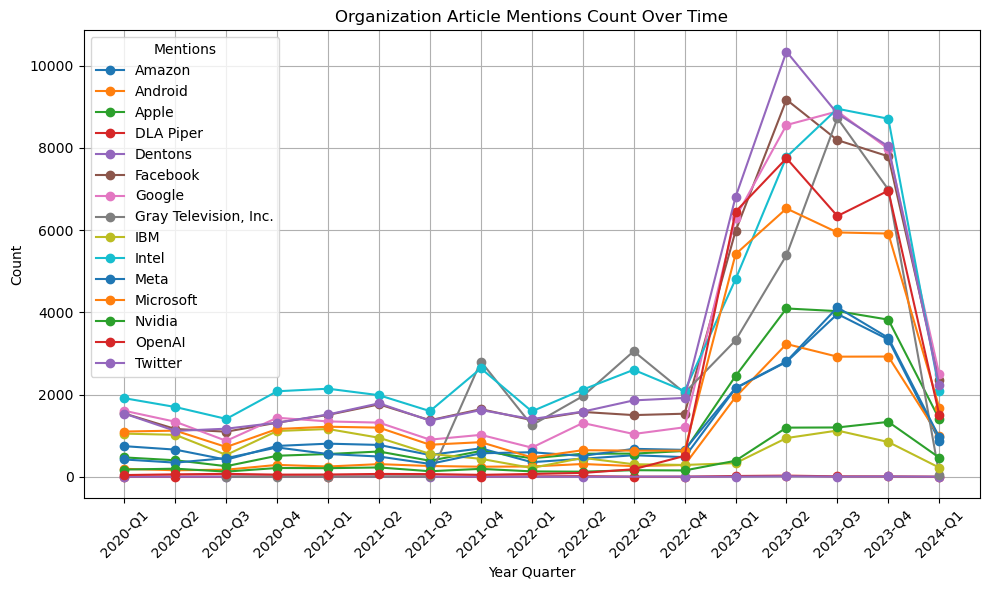

In [41]:

# Grouping by 'mentions' to plot each mention as a separate line
grouped = result_df.groupby('mentions')

plt.figure(figsize=(10, 6))

# Plotting each line for mentions
for name, group in grouped:
    plt.plot(group['year_quarter'], group['count'], marker='o', label=name)

plt.xlabel('Year Quarter')
plt.ylabel('Count')
plt.title('Organization Article Mentions Count Over Time')
plt.xticks(rotation=45)
plt.legend(title='Mentions')
plt.grid(True)

plt.tight_layout()
plt.show()

## 1st Organization

In [42]:
filtered_df100_exploded_unique = filtered_df100_exploded[['url', 'year_quarter', 'sentiment', 'mentions']].drop_duplicates()
filtered_df100_exploded_unique

,url,year_quarter,sentiment,mentions
0,http://galusaustralis.com/2020/02/486473/legal...,2020-Q1,POSITIVE,Intel
0,http://galusaustralis.com/2020/02/486473/legal...,2020-Q1,POSITIVE,Facebook
0,http://galusaustralis.com/2020/02/486473/legal...,2020-Q1,POSITIVE,Twitter
0,http://galusaustralis.com/2020/02/486473/legal...,2020-Q1,POSITIVE,Google
1,http://www.millenniumpost.in/big-stories/ai-ex...,2020-Q3,NEGATIVE,NaN
...,...,...,...,...
137738,https://zeenews.india.com/companies/one-ai-kil...,2022-Q4,NEGATIVE,Twitter
137739,https://zeenews.india.com/technology/openai-re...,2023-Q2,POSITIVE,OpenAI
137739,https://zeenews.india.com/technology/openai-re...,2023-Q2,POSITIVE,Microsoft
137739,https://zeenews.india.com/technology/openai-re...,2023-Q2,POSITIVE,Apple


In [142]:
lega_tech_df = filtered_df100_exploded_unique[filtered_df100_exploded_unique['mentions'] == 'Meta'][['year_quarter', 'mentions', 'sentiment']]
lega_tech_df

,year_quarter,mentions,sentiment
4,2020-Q2,Meta,POSITIVE
7,2023-Q4,Meta,NEGATIVE
18,2023-Q2,Meta,NEGATIVE
20,2023-Q2,Meta,POSITIVE
24,2023-Q4,Meta,NEGATIVE
...,...,...,...
137711,2023-Q3,Meta,POSITIVE
137717,2023-Q3,Meta,NEGATIVE
137735,2023-Q4,Meta,POSITIVE
137737,2023-Q2,Meta,NEGATIVE


In [143]:
# Assuming filtered_df1 is your DataFrame
pivot_df = lega_tech_df.pivot_table(index=['year_quarter'], columns='sentiment', aggfunc='size', fill_value=0).reset_index()


pivot_df['total'] = pivot_df['NEGATIVE'] + pivot_df['POSITIVE']
pivot_df['percentage_0'] = pivot_df['NEGATIVE'] / pivot_df['total'] * 100
pivot_df['percentage_1'] = pivot_df['POSITIVE'] / pivot_df['total'] * 100

# Convert 'year_month' column to datetime objects
pivot_df

sentiment,year_quarter,NEGATIVE,POSITIVE,total,percentage_0,percentage_1
0,2020-Q1,110,310,420,26.190476,73.809524
1,2020-Q2,58,285,343,16.909621,83.090379
2,2020-Q3,127,326,453,28.035320,71.964680
3,2020-Q4,143,569,712,20.084270,79.915730
4,2021-Q1,150,403,553,27.124774,72.875226
5,2021-Q2,157,335,492,31.910569,68.089431
6,2021-Q3,159,153,312,50.961538,49.038462
7,2021-Q4,192,379,571,33.625219,66.374781
8,2022-Q1,255,341,596,42.785235,57.214765
9,2022-Q2,227,280,507,44.773176,55.226824


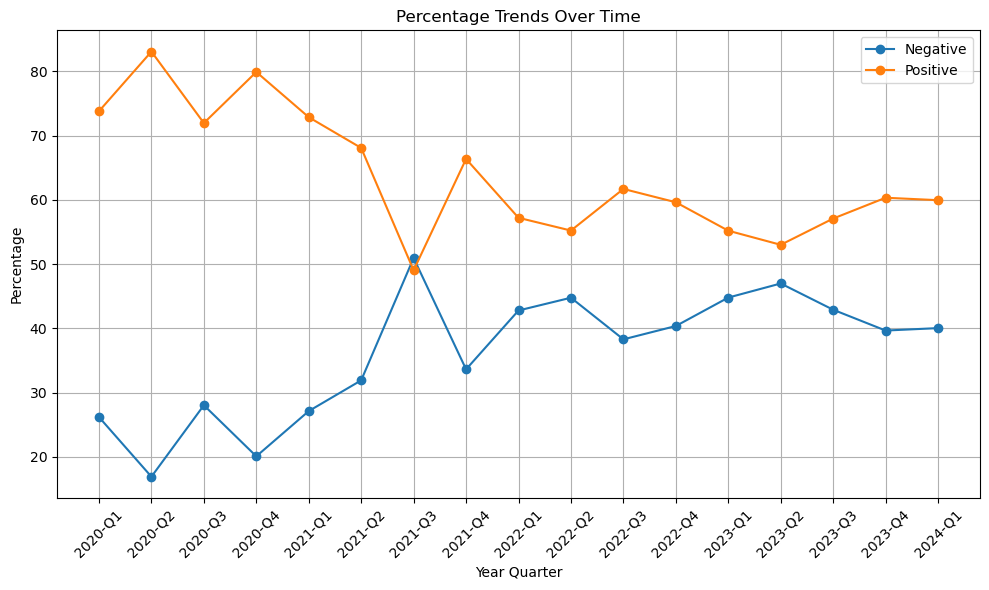

In [144]:

plt.figure(figsize=(10, 6))

# Plotting percentage_0
plt.plot(pivot_df['year_quarter'], pivot_df['percentage_0'], marker='o', label='Negative')

# Plotting percentage_1
plt.plot(pivot_df['year_quarter'], pivot_df['percentage_1'], marker='o', label='Positive')

plt.xlabel('Year Quarter')
plt.ylabel('Percentage')
plt.title('Percentage Trends Over Time')
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()

In [137]:
# Aggregate sum of 'NEGATIVE' and 'POSITIVE' into one row
agg_row = pivot_df[['NEGATIVE', 'POSITIVE', 'total']].sum()

# Calculate the percentages
percentage_0 = agg_row['NEGATIVE'] / agg_row['total'] * 100
percentage_1 = agg_row['POSITIVE'] / agg_row['total'] * 100

# Create a new DataFrame with the aggregated values
agg_df = pd.DataFrame({
    'NEGATIVE': [agg_row['NEGATIVE']],
    'POSITIVE': [agg_row['POSITIVE']],
    'total': [agg_row['total']],
    'percentage_0': [percentage_0],
    'percentage_1': [percentage_1]
})

# Print the aggregated DataFrame
agg_df

,NEGATIVE,POSITIVE,total,percentage_0,percentage_1
0,21876,32570,54446,40.17926,59.82074


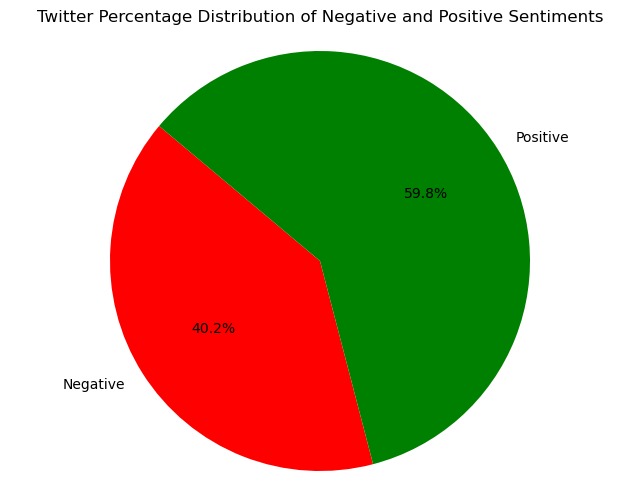

In [138]:


# Extract data for plotting
percentages = ['percentage_0', 'percentage_1']
values = agg_df[percentages].values.flatten()  # Flatten values for plotting
labels = ['Negative', 'Positive']  # Create labels for the pie chart

# Plot the pie chart
plt.figure(figsize=(8, 6))
plt.pie(values, labels=labels, autopct='%1.1f%%', colors=['red', 'green'], startangle=140)
plt.title('Twitter Percentage Distribution of Negative and Positive Sentiments')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle

plt.show()

## PERSON (PER)

In [149]:
df_ner_results_sel = df_ner_spacy_wo_text_results[['Entities', 'Labels']]
df_ner_results_sel = df_ner_results_sel[(df_ner_results_sel['Labels'] == 'PERSON')]

In [152]:
entities_counts = df_ner_results_sel.groupby('Entities').size().reset_index(name='Count')
top_10_entities = entities_counts.nlargest(30, 'Count')
top_10_entities

,Entities,Count
294934,Sam Altman,14614
22480,Altman,9514
106884,Elon Musk,9221
47257,Biden,9207
42180,Bard,8765
236221,Musk,7943
240763,NavigationClose NavigationSearchPlease,5045
14378,AdvertisingAt Gray,4673
168588,Joe Biden,3662
48589,Bing,3589


In [147]:
#UPDATE I nstagram to ORG
df_ner_spacy_wo_text_results.loc[df_ner_spacy_wo_text_results['Entities'] == 'Instagram', 'Labels'] = 'ORG'
df_ner_spacy_wo_text_results

,Entities,Labels,Position_Start,Position_End
0,LegalTech,ORG,0,9
1,Casetext Inc.,ORG,87,100
2,Catalyst Repository Systems,ORG,102,129
3,Australis Galus,PERSON,146,161
4,NewsHealthcareIndustryInternationalLifestyleSc...,DATE,187,247
...,...,...,...,...
14270791,CookiesThese,NORP,6331,6343
14270792,CookiesThese,NORP,6769,6781
14270793,third,ORDINAL,6892,6897
14270794,CookiesThese,NORP,7062,7074


In [154]:
# Specify the entities you want to filter for
entities_of_interest = ['Sam Altman', 'Elon Musk', 'Joe Biden', 'Satya Nadella', 'Sundar Pichai', 'Mark Zuckerberg', 'Donald Trump', 'Greg Brockman']

# Filter the DataFrame based on the specified entities
top_10_entities = top_10_entities[top_10_entities['Entities'].isin(entities_of_interest)]
top_10_entities

,Entities,Count
294934,Sam Altman,14614
106884,Elon Musk,9221
168588,Joe Biden,3662
299228,Satya Nadella,3227
324026,Sundar Pichai,2525
215877,Mark Zuckerberg,2213
98011,Donald Trump,2183
136430,Greg Brockman,2180


In [155]:
filtered_df100 = filtered_df1

# Extracting year and quarter information
filtered_df100['date'] = pd.to_datetime(filtered_df100['date'])

filtered_df100['year_quarter'] = filtered_df100['date'].dt.year.astype(str) + '-Q' + \
                                filtered_df100['date'].dt.quarter.astype(str)

# Display the DataFrame with the new column

filtered_df100

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column,sentiment,year_quarter,mentions
0,http://galusaustralis.com/2020/02/486473/legal...,2020-02-26,LegalTech Artificial Intelligence Market 2019 ...,LegalTech Artificial Intelligence Market 2019 ...,legaltech artificial intelligence market techn...,0,1,20,5.000000,AI in Marketing,POSITIVE,2020-Q1,"[Google, Intel, Twitter, Facebook]"
1,http://www.millenniumpost.in/big-stories/ai-ex...,2020-08-07,Two dead as AI Express flight skids off Kozhik...,Two dead as AI Express flight skids off Kozhik...,two dead ai express flight skids kozhikode air...,4,1,10,10.000000,AI in Weather Related Information or Services,NEGATIVE,2020-Q3,[]
2,http://www.nativestew.com/2023/11/ai-took-my-j...,2023-11-20,"Native Stew - Bahamas AI Art, Photos, Videos: ...","Native Stew Bahamas AI Art, Photos, Videos: A...",native stew bahamas ai art photos videos ai to...,5,2,12,16.666667,AI Applications and Technologies,POSITIVE,2023-Q4,"[Twitter, Facebook]"
3,http://www.sbwire.com/press-releases/healthcar...,2022-10-06,Healthcare Artificial Intelligence Market Anal...,Healthcare Artificial Intelligence Market Anal...,healthcare artificial intelligence market anal...,8,2,11,18.181818,AI in Marketing,POSITIVE,2022-Q4,"[IBM, Intel, Microsoft]"
4,https://3wnews.org/industry/704499/artificial-...,2020-04-29,Artificial Intelligence As A Service Market : ...,Artificial Intelligence As A Service Market : ...,artificial intelligence service market opportu...,9,1,19,5.263158,AI in Marketing,POSITIVE,2020-Q2,"[IBM, Intel, Amazon, Microsoft, Meta, Google]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
137736,https://www.zdnet.com/article/google-cloud-exp...,2023-08-29,Google Cloud expands developer tools and data ...,Google Cloud expands developer tools and data ...,google cloud expands developer tools data anal...,200430,2,14,14.285714,NaN,POSITIVE,2023-Q3,"[Intel, Amazon, Microsoft, Google, Twitter, Ap..."
137737,https://yen.com.gh/business-economy/231589-twi...,2023-04-12,Twitter working on AI despite Musk call for gl...,Twitter working on AI despite Musk call for gl...,twitter working ai despite musk call global pa...,200431,1,13,7.692308,NaN,NEGATIVE,2023-Q2,"[OpenAI, Microsoft, Google, Twitter, Meta, App..."
137738,https://zeenews.india.com/companies/one-ai-kil...,2022-12-31,'One AI Killer app will emerge...': Nothing fo...,One AI Killer app will emerge...: Nothing foun...,one ai killer app emerge nothing founder carl ...,200432,1,25,4.000000,NaN,NEGATIVE,2022-Q4,"[Meta, Apple, Twitter]"
137739,https://zeenews.india.com/technology/openai-re...,2023-04-29,OpenAI Restores Access To ChatGPT In Italy Aft...,OpenAI Restores Access To ChatGPT In Italy Aft...,openai restores access chatgpt italy ban techn...,200433,2,15,13.333333,NaN,POSITIVE,2023-Q2,"[OpenAI, Apple, Microsoft]"


In [156]:

# Create a regex pattern to match mentions of entities in 'text_clean_2'
pattern = '|'.join(top_10_entities['Entities'].map(re.escape))

# Extract mentions of entities from 'text_clean_2' using regex pattern
mentions = filtered_df100['text_clean'].str.extractall(f'({pattern})').groupby(level=0)[0].apply(list)


filtered_df100['mentions'] = mentions

In [157]:
# Explode the mentions to create separate rows for each mention
filtered_df100_exploded = filtered_df100.explode('mentions')

# Group by 'year_quarter' and 'mentions' and count the occurrences
result_df = filtered_df100_exploded.groupby(['year_quarter', 'mentions']).size().reset_index(name='count')
result_df

,year_quarter,mentions,count
0,2020-Q1,Donald Trump,130
1,2020-Q1,Elon Musk,122
2,2020-Q1,Greg Brockman,9
3,2020-Q1,Joe Biden,13
4,2020-Q1,Mark Zuckerberg,37
...,...,...,...
129,2024-Q1,Joe Biden,198
130,2024-Q1,Mark Zuckerberg,197
131,2024-Q1,Sam Altman,1160
132,2024-Q1,Satya Nadella,270


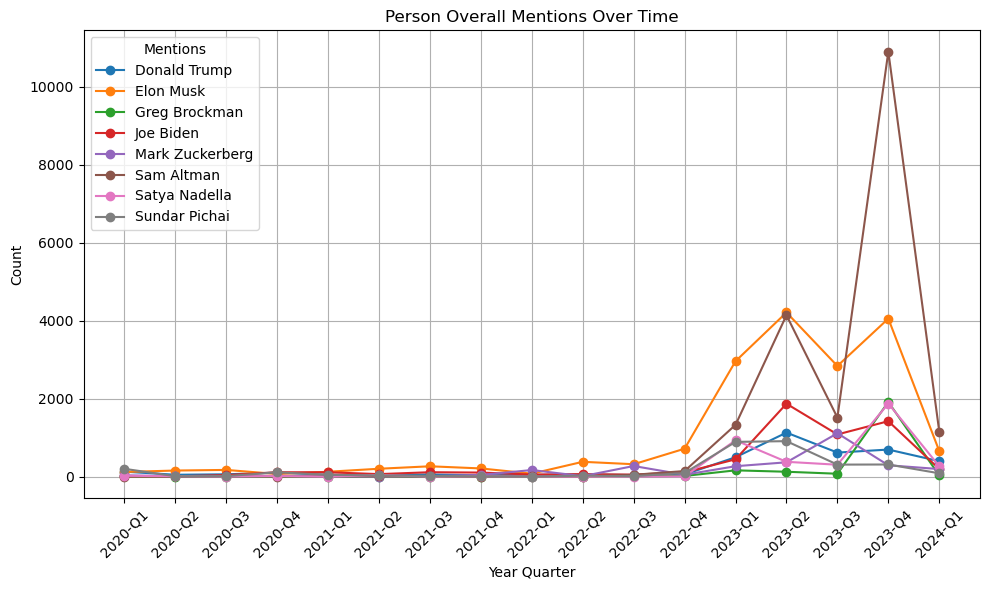

In [159]:
# Grouping by 'mentions' to plot each mention as a separate line
grouped = result_df.groupby('mentions')

plt.figure(figsize=(10, 6))

# Plotting each line for mentions
for name, group in grouped:
    plt.plot(group['year_quarter'], group['count'], marker='o', label=name)

plt.xlabel('Year Quarter')
plt.ylabel('Count')
plt.title('Person Overall Mentions Over Time')
plt.xticks(rotation=45)
plt.legend(title='Mentions')
plt.grid(True)

plt.tight_layout()
plt.show()

In [160]:
# Replace NaN values with an empty list
filtered_df100['mentions'] = filtered_df100['mentions'].apply(lambda x: [] if x is np.nan else x)

# Remove duplicates from each list
filtered_df100['mentions'] = filtered_df100['mentions'].apply(lambda x: list(set(x)))

# Explode the mentions to create separate rows for each mention
filtered_df100_exploded2 = filtered_df100.explode('mentions')

# Group by 'year_quarter' and 'mentions' and count the occurrences
result_df = filtered_df100_exploded2.groupby(['year_quarter', 'mentions']).size().reset_index(name='count')


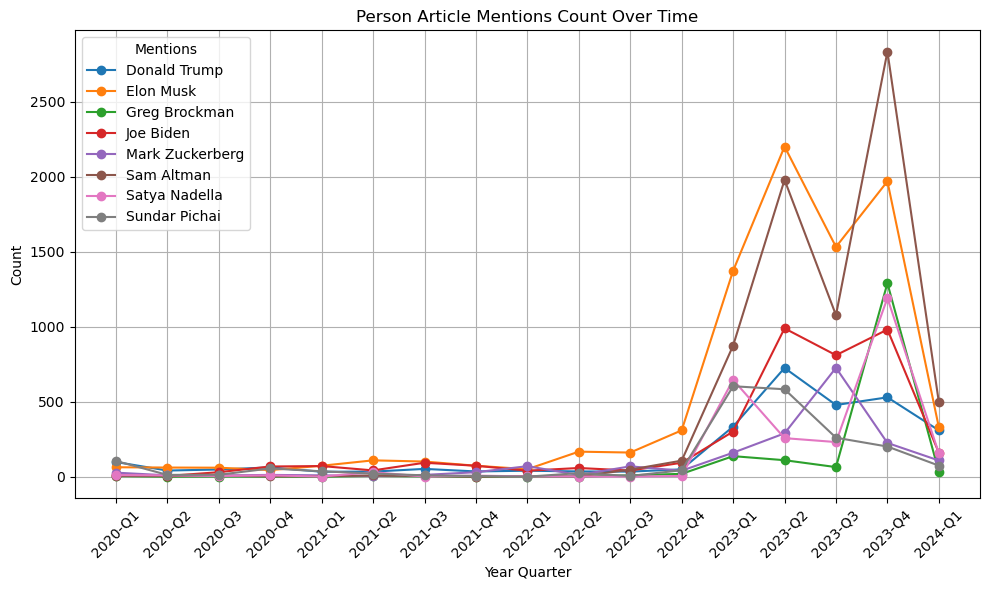

In [161]:

# Grouping by 'mentions' to plot each mention as a separate line
grouped = result_df.groupby('mentions')

plt.figure(figsize=(10, 6))

# Plotting each line for mentions
for name, group in grouped:
    plt.plot(group['year_quarter'], group['count'], marker='o', label=name)

plt.xlabel('Year Quarter')
plt.ylabel('Count')
plt.title('Person Article Mentions Count Over Time')
plt.xticks(rotation=45)
plt.legend(title='Mentions')
plt.grid(True)

plt.tight_layout()
plt.show()

## 1ST PERSON

In [162]:
filtered_df100_exploded_unique = filtered_df100_exploded[['url', 'year_quarter', 'sentiment', 'mentions']].drop_duplicates()


In [227]:
lega_tech_df = filtered_df100_exploded_unique[filtered_df100_exploded_unique['mentions'] == 'Joe Biden'][['year_quarter', 'mentions', 'sentiment']]
lega_tech_df

,year_quarter,mentions,sentiment
110,2023-Q3,Joe Biden,NEGATIVE
114,2021-Q1,Joe Biden,POSITIVE
123,2023-Q4,Joe Biden,NEGATIVE
124,2023-Q4,Joe Biden,POSITIVE
128,2021-Q1,Joe Biden,NEGATIVE
...,...,...,...
137605,2023-Q4,Joe Biden,POSITIVE
137649,2023-Q2,Joe Biden,POSITIVE
137665,2023-Q2,Joe Biden,NEGATIVE
137680,2023-Q2,Joe Biden,POSITIVE


In [228]:
# Assuming filtered_df1 is your DataFrame
pivot_df = lega_tech_df.pivot_table(index=['year_quarter'], columns='sentiment', aggfunc='size', fill_value=0).reset_index()


pivot_df['total'] = pivot_df['NEGATIVE'] + pivot_df['POSITIVE']
pivot_df['percentage_0'] = pivot_df['NEGATIVE'] / pivot_df['total'] * 100
pivot_df['percentage_1'] = pivot_df['POSITIVE'] / pivot_df['total'] * 100

# Convert 'year_month' column to datetime objects
pivot_df

sentiment,year_quarter,NEGATIVE,POSITIVE,total,percentage_0,percentage_1
0,2020-Q1,8,4,12,66.666667,33.333333
1,2020-Q2,6,0,6,100.000000,0.000000
2,2020-Q3,20,11,31,64.516129,35.483871
3,2020-Q4,29,40,69,42.028986,57.971014
4,2021-Q1,29,43,72,40.277778,59.722222
5,2021-Q2,23,20,43,53.488372,46.511628
6,2021-Q3,69,25,94,73.404255,26.595745
7,2021-Q4,52,22,74,70.270270,29.729730
8,2022-Q1,21,20,41,51.219512,48.780488
9,2022-Q2,40,19,59,67.796610,32.203390


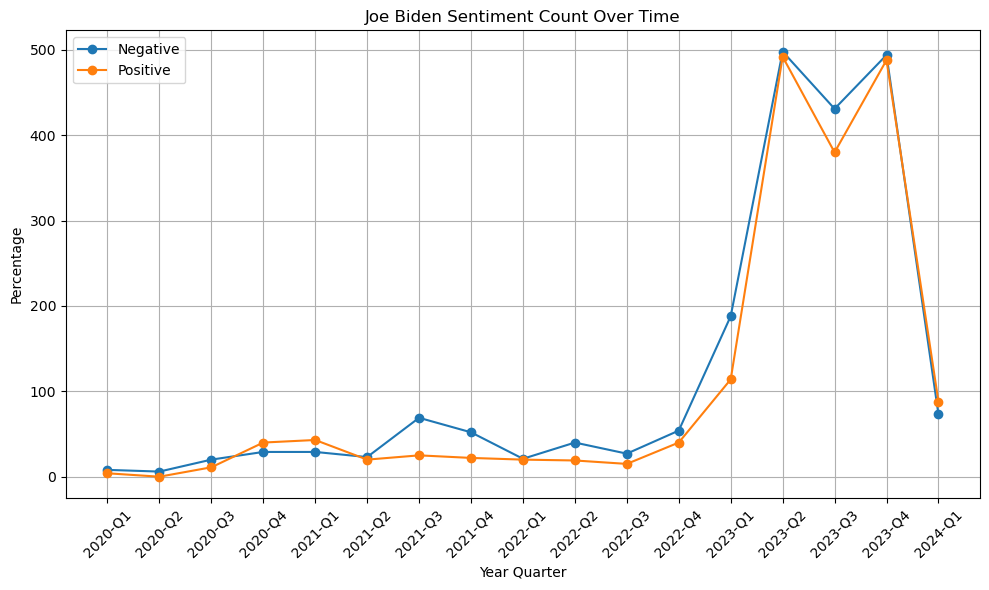

In [230]:

plt.figure(figsize=(10, 6))

# Plotting percentage_0
plt.plot(pivot_df['year_quarter'], pivot_df['NEGATIVE'], marker='o', label='Negative')

# Plotting percentage_1
plt.plot(pivot_df['year_quarter'], pivot_df['POSITIVE'], marker='o', label='Positive')

plt.xlabel('Year Quarter')
plt.ylabel('Percentage')
plt.title('Joe Biden Sentiment Count Over Time')
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()

In [216]:
# Aggregate sum of 'NEGATIVE' and 'POSITIVE' into one row
agg_row = pivot_df[['NEGATIVE', 'POSITIVE', 'total']].sum()

# Calculate the percentages
percentage_0 = agg_row['NEGATIVE'] / agg_row['total'] * 100
percentage_1 = agg_row['POSITIVE'] / agg_row['total'] * 100

# Create a new DataFrame with the aggregated values
agg_df = pd.DataFrame({
    'NEGATIVE': [agg_row['NEGATIVE']],
    'POSITIVE': [agg_row['POSITIVE']],
    'total': [agg_row['total']],
    'percentage_0': [percentage_0],
    'percentage_1': [percentage_1]
})

# Print the aggregated DataFrame
agg_df


,NEGATIVE,POSITIVE,total,percentage_0,percentage_1
0,1156,910,2066,55.953533,44.046467


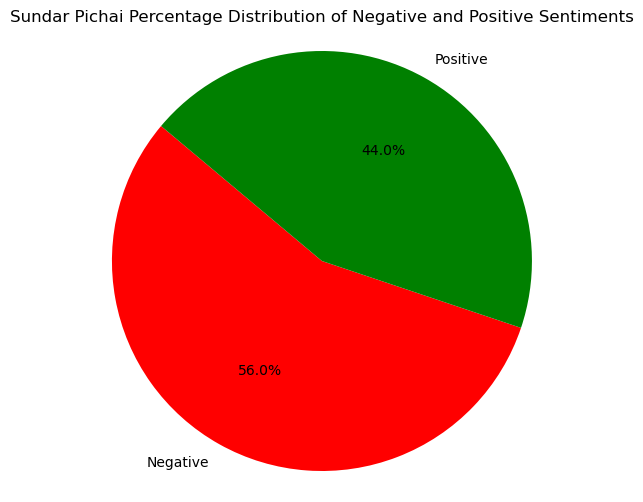

In [218]:

# Extract data for plotting
percentages = ['percentage_0', 'percentage_1']
values = agg_df[percentages].values.flatten()  # Flatten values for plotting
labels = ['Negative', 'Positive']  # Create labels for the pie chart

# Plot the pie chart
plt.figure(figsize=(8, 6))
plt.pie(values, labels=labels, autopct='%1.1f%%', colors=['red', 'green'], startangle=140)
plt.title('Sundar Pichai Percentage Distribution of Negative and Positive Sentiments')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle

plt.show()

In [ ]:
'U.S.', 'India', 'China', 'UK', 'Canada', 'Japan', 'Australia', 'France', 'Germany', 'London', 'Russia',
'Ukraine', 'Italy','Israel', 'Brazil', 'South Korea', 'Taiwan', 'Mexico', 'Singapore', 'Pakistan', 'Spain', 'South Africa',
'Malaysia', 'Turkey', 'Dubai', 'Switzerland', 'Hongkong', 'Indonesia', 'Saudi Arabia', 'Philippines', 'Netherlands', 'Egypt'

## LOCATION (LOC) im going with country actually GPE

In [231]:
df_ner_results_sel = df_ner_spacy_wo_text_results[['Entities', 'Labels']]
df_ner_results_sel = df_ner_results_sel[(df_ner_results_sel['Labels'] == 'GPE')]

In [241]:
entities_counts = df_ner_results_sel.groupby('Entities').size().reset_index(name='Count')
top_10_entities = entities_counts.nlargest(80, 'Count')
top_10_entities

,Entities,Count
54666,US,60959
54406,U.S.,46621
23302,India,35361
40319,PRNewswire,34324
10208,China,33837
...,...,...
34629,NC,2171
31212,Maine,2154
16508,FL,2108
7837,Britain,2091


In [242]:
# List of countries
countries = ['U.S.', 'India', 'China', 'UK', 'Canada', 'Japan', 'Australia', 'France', 'Germany', 'London', 'Russia', 'Ukraine', 'Italy','Israel', 'Brazil', 'South Korea', 'Taiwan', 'Mexico', 'Singapore', 'Pakistan', 'Spain', 'South Africa', 'Malaysia', 'Turkey', 'Dubai', 'Switzerland', 'Hongkong', 'Indonesia', 'Saudi Arabia', 'Philippines', 'Netherlands', 'Egypt']

# Filter the DataFrame based on the specified countries
top_10_entities = top_10_entities[top_10_entities['Entities'].isin(countries)]

In [243]:
top_10_entities

,Entities,Count
54406,U.S.,46621
23302,India,35361
10208,China,33837
54537,UK,24068
9138,Canada,13306
24810,Japan,13033
4457,Australia,10157
17569,France,9989
44893,Russia,8739
18700,Germany,8512


In [244]:
filtered_df100 = filtered_df1

# Extracting year and quarter information
filtered_df100['date'] = pd.to_datetime(filtered_df100['date'])

filtered_df100['year_quarter'] = filtered_df100['date'].dt.year.astype(str) + '-Q' + \
                                filtered_df100['date'].dt.quarter.astype(str)


In [245]:

# Create a regex pattern to match mentions of entities in 'text_clean_2'
pattern = '|'.join(top_10_entities['Entities'].map(re.escape))

# Extract mentions of entities from 'text_clean_2' using regex pattern
mentions = filtered_df100['text_clean'].str.extractall(f'({pattern})').groupby(level=0)[0].apply(list)


filtered_df100['mentions'] = mentions

In [246]:
# Explode the mentions to create separate rows for each mention
filtered_df100_exploded = filtered_df100.explode('mentions')

# Group by 'year_quarter' and 'mentions' and count the occurrences
result_df = filtered_df100_exploded.groupby(['year_quarter', 'mentions']).size().reset_index(name='count')
result_df

,year_quarter,mentions,count
0,2020-Q1,Australia,825
1,2020-Q1,Brazil,630
2,2020-Q1,Canada,1030
3,2020-Q1,China,2768
4,2020-Q1,Dubai,104
...,...,...,...
522,2024-Q1,Taiwan,911
523,2024-Q1,Turkey,647
524,2024-Q1,U.S.,3894
525,2024-Q1,UK,2655


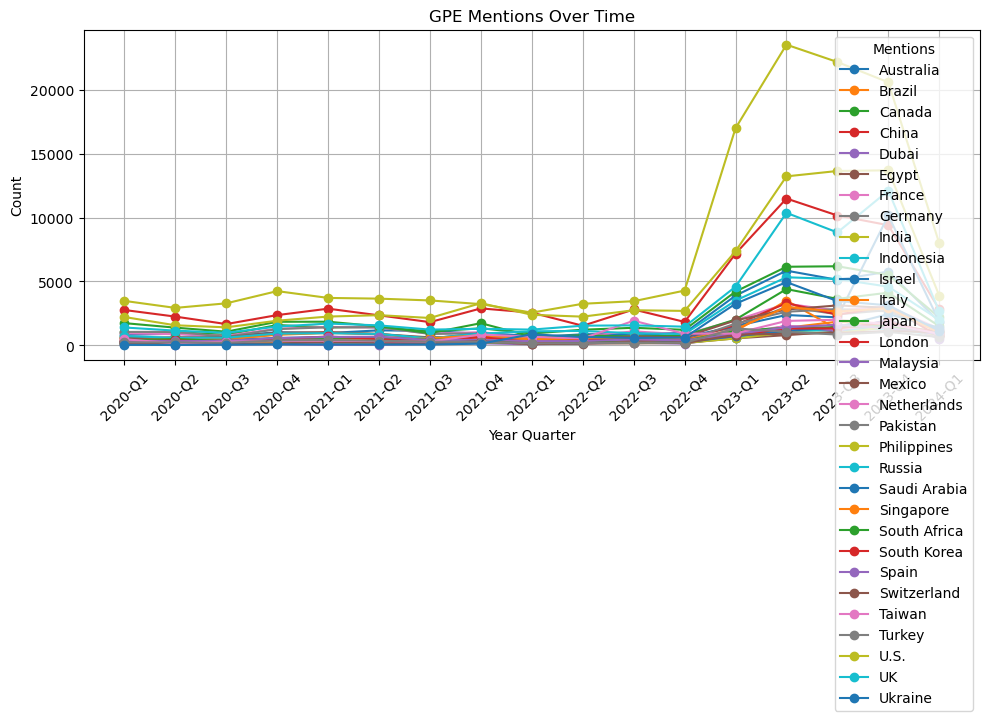

In [247]:
# Grouping by 'mentions' to plot each mention as a separate line
grouped = result_df.groupby('mentions')

plt.figure(figsize=(10, 6))

# Plotting each line for mentions
for name, group in grouped:
    plt.plot(group['year_quarter'], group['count'], marker='o', label=name)

plt.xlabel('Year Quarter')
plt.ylabel('Count')
plt.title('GPE Mentions Over Time')
plt.xticks(rotation=45)
plt.legend(title='Mentions')
plt.grid(True)

plt.tight_layout()
plt.show()

In [248]:
# Replace NaN values with an empty list
filtered_df100['mentions'] = filtered_df100['mentions'].apply(lambda x: [] if x is np.nan else x)

# Remove duplicates from each list
filtered_df100['mentions'] = filtered_df100['mentions'].apply(lambda x: list(set(x)))

# Explode the mentions to create separate rows for each mention
filtered_df100_exploded2 = filtered_df100.explode('mentions')


In [250]:
filtered_df100_exploded2

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column,sentiment,year_quarter,mentions
0,http://galusaustralis.com/2020/02/486473/legal...,2020-02-26,LegalTech Artificial Intelligence Market 2019 ...,LegalTech Artificial Intelligence Market 2019 ...,legaltech artificial intelligence market techn...,0,1,20,5.000000,AI in Marketing,POSITIVE,2020-Q1,Japan
0,http://galusaustralis.com/2020/02/486473/legal...,2020-02-26,LegalTech Artificial Intelligence Market 2019 ...,LegalTech Artificial Intelligence Market 2019 ...,legaltech artificial intelligence market techn...,0,1,20,5.000000,AI in Marketing,POSITIVE,2020-Q1,India
0,http://galusaustralis.com/2020/02/486473/legal...,2020-02-26,LegalTech Artificial Intelligence Market 2019 ...,LegalTech Artificial Intelligence Market 2019 ...,legaltech artificial intelligence market techn...,0,1,20,5.000000,AI in Marketing,POSITIVE,2020-Q1,China
1,http://www.millenniumpost.in/big-stories/ai-ex...,2020-08-07,Two dead as AI Express flight skids off Kozhik...,Two dead as AI Express flight skids off Kozhik...,two dead ai express flight skids kozhikode air...,4,1,10,10.000000,AI in Weather Related Information or Services,NEGATIVE,2020-Q3,Dubai
1,http://www.millenniumpost.in/big-stories/ai-ex...,2020-08-07,Two dead as AI Express flight skids off Kozhik...,Two dead as AI Express flight skids off Kozhik...,two dead ai express flight skids kozhikode air...,4,1,10,10.000000,AI in Weather Related Information or Services,NEGATIVE,2020-Q3,India
...,...,...,...,...,...,...,...,...,...,...,...,...,...
137739,https://zeenews.india.com/technology/openai-re...,2023-04-29,OpenAI Restores Access To ChatGPT In Italy Aft...,OpenAI Restores Access To ChatGPT In Italy Aft...,openai restores access chatgpt italy ban techn...,200433,2,15,13.333333,NaN,POSITIVE,2023-Q2,Australia
137739,https://zeenews.india.com/technology/openai-re...,2023-04-29,OpenAI Restores Access To ChatGPT In Italy Aft...,OpenAI Restores Access To ChatGPT In Italy Aft...,openai restores access chatgpt italy ban techn...,200433,2,15,13.333333,NaN,POSITIVE,2023-Q2,Israel
137740,https://zeenews.india.com/technology/young-kol...,2023-08-05,Young Kolkata Girl Loses 90% Of Her Income As ...,Young Kolkata Girl Loses 90 Of Her Income As A...,young kolkata girl loses income copywriter due...,200434,1,26,3.846154,NaN,NEGATIVE,2023-Q3,India
137740,https://zeenews.india.com/technology/young-kol...,2023-08-05,Young Kolkata Girl Loses 90% Of Her Income As ...,Young Kolkata Girl Loses 90 Of Her Income As A...,young kolkata girl loses income copywriter due...,200434,1,26,3.846154,NaN,NEGATIVE,2023-Q3,UK


In [254]:
# Group by 'mentions' column and count occurrences of 'POSITIVE' and 'NEGATIVE' sentiments
mentions_sentiment_counts = filtered_df100_exploded2.groupby(['mentions', 'sentiment']).size().unstack(fill_value=0)

# Reset index to make 'mentions' a column again
mentions_sentiment_counts.reset_index(inplace=True)


In [258]:
mentions_sentiment_counts['total'] = mentions_sentiment_counts['NEGATIVE'] + mentions_sentiment_counts['POSITIVE']
mentions_sentiment_counts['percentage_negative'] = mentions_sentiment_counts['NEGATIVE'] / mentions_sentiment_counts['total'] * 100
mentions_sentiment_counts['percentage_positive'] = mentions_sentiment_counts['POSITIVE'] / mentions_sentiment_counts['total'] * 100
mentions_sentiment_counts

sentiment,mentions,NEGATIVE,POSITIVE,total,percentage_negative,percentage_positive
0,Australia,5315,11033,16348,32.511622,67.488378
1,Brazil,3288,7461,10749,30.588892,69.411108
2,Canada,6166,12947,19113,32.260765,67.739235
3,China,8605,17966,26571,32.384931,67.615069
4,Dubai,638,1689,2327,27.417275,72.582725
5,Egypt,1255,4653,5908,21.242383,78.757617
6,France,5152,11074,16226,31.751510,68.248490
7,Germany,4349,11017,15366,28.302746,71.697254
8,India,11407,23673,35080,32.517104,67.482896
9,Indonesia,1506,4378,5884,25.594833,74.405167


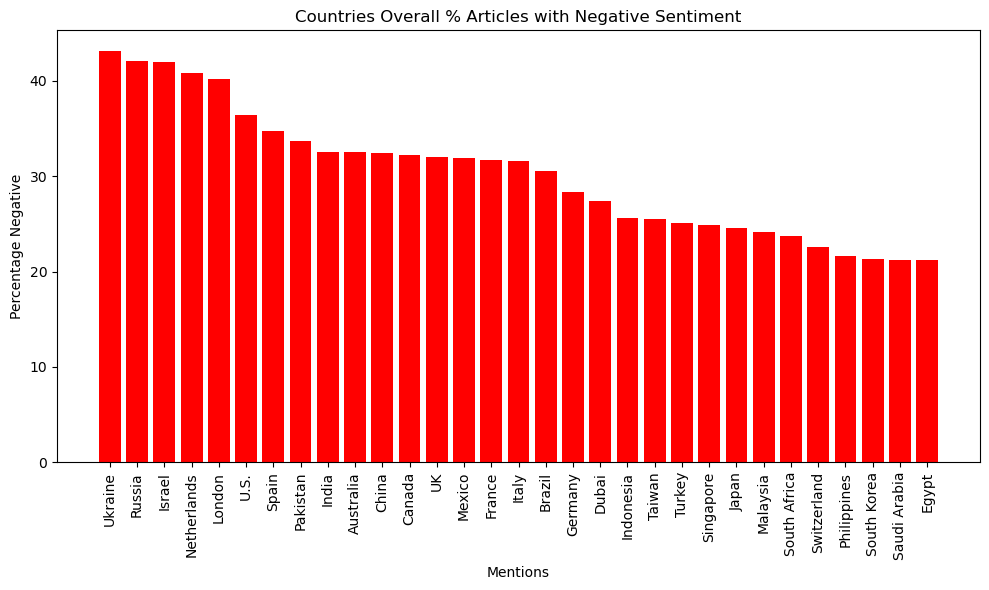

In [261]:
# Sort the DataFrame by percentage_negative column in descending order
sorted_df = mentions_sentiment_counts.sort_values(by='percentage_negative', ascending=False)

# Plot the sorted DataFrame
plt.figure(figsize=(10, 6))
plt.bar(sorted_df['mentions'], sorted_df['percentage_negative'], color='red')
plt.xlabel('Mentions')
plt.ylabel('Percentage Negative')
plt.title('Countries Overall % Articles with Negative Sentiment')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
plt.tight_layout()  # Adjust layout to prevent clipping of labels
plt.show()

In [264]:
filtered_df100_exploded2['year'] = filtered_df100_exploded2['date'].dt.year
filtered_df100_exploded2 = filtered_df100_exploded2[filtered_df100_exploded2['year'].isin([2023, 2024])]


In [265]:
filtered_df100_exploded2

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column,sentiment,year_quarter,mentions,year
2,http://www.nativestew.com/2023/11/ai-took-my-j...,2023-11-20,"Native Stew - Bahamas AI Art, Photos, Videos: ...","Native Stew Bahamas AI Art, Photos, Videos: A...",native stew bahamas ai art photos videos ai to...,5,2,12,16.666667,AI Applications and Technologies,POSITIVE,2023-Q4,NaN,2023
6,https://9to5toys.com/2024/01/02/put-your-best-...,2024-01-02,Put your best AI self forward with vidBoard Cr...,Put your best AI self forward with vidBoard Cr...,put best ai self forward vidboard creative ai ...,12,2,13,15.384615,AI Applications and Technologies,POSITIVE,2024-Q1,NaN,2024
7,https://abc7chicago.com/ai-act-artificial-inte...,2023-12-12,"The European Union releases the AI Act, the wo...","The European Union releases the AI Act, the wo...",european union releases ai act worlds first se...,14,2,19,10.526316,Ethical and Legal Implications of AI,NEGATIVE,2023-Q4,India,2023
7,https://abc7chicago.com/ai-act-artificial-inte...,2023-12-12,"The European Union releases the AI Act, the wo...","The European Union releases the AI Act, the wo...",european union releases ai act worlds first se...,14,2,19,10.526316,Ethical and Legal Implications of AI,NEGATIVE,2023-Q4,U.S.,2023
9,https://arstechnica.com/tech-policy/2023/03/ft...,2023-03-31,GPT-4 poses too many risks and releases should...,GPT4 poses too many risks and releases should ...,gpt poses many risks releases halted ai group ...,17,1,17,5.882353,Ethical and Legal Implications of AI,NEGATIVE,2023-Q1,NaN,2023
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
137739,https://zeenews.india.com/technology/openai-re...,2023-04-29,OpenAI Restores Access To ChatGPT In Italy Aft...,OpenAI Restores Access To ChatGPT In Italy Aft...,openai restores access chatgpt italy ban techn...,200433,2,15,13.333333,NaN,POSITIVE,2023-Q2,Australia,2023
137739,https://zeenews.india.com/technology/openai-re...,2023-04-29,OpenAI Restores Access To ChatGPT In Italy Aft...,OpenAI Restores Access To ChatGPT In Italy Aft...,openai restores access chatgpt italy ban techn...,200433,2,15,13.333333,NaN,POSITIVE,2023-Q2,Israel,2023
137740,https://zeenews.india.com/technology/young-kol...,2023-08-05,Young Kolkata Girl Loses 90% Of Her Income As ...,Young Kolkata Girl Loses 90 Of Her Income As A...,young kolkata girl loses income copywriter due...,200434,1,26,3.846154,NaN,NEGATIVE,2023-Q3,India,2023
137740,https://zeenews.india.com/technology/young-kol...,2023-08-05,Young Kolkata Girl Loses 90% Of Her Income As ...,Young Kolkata Girl Loses 90 Of Her Income As A...,young kolkata girl loses income copywriter due...,200434,1,26,3.846154,NaN,NEGATIVE,2023-Q3,UK,2023


In [266]:
# Group by 'mentions' column and count occurrences of 'POSITIVE' and 'NEGATIVE' sentiments
mentions_sentiment_counts = filtered_df100_exploded2.groupby(['mentions', 'sentiment']).size().unstack(fill_value=0)

# Reset index to make 'mentions' a column again
mentions_sentiment_counts.reset_index(inplace=True)

mentions_sentiment_counts['total'] = mentions_sentiment_counts['NEGATIVE'] + mentions_sentiment_counts['POSITIVE']
mentions_sentiment_counts['percentage_negative'] = mentions_sentiment_counts['NEGATIVE'] / mentions_sentiment_counts['total'] * 100
mentions_sentiment_counts['percentage_positive'] = mentions_sentiment_counts['POSITIVE'] / mentions_sentiment_counts['total'] * 100
mentions_sentiment_counts

sentiment,mentions,NEGATIVE,POSITIVE,total,percentage_negative,percentage_positive
0,Australia,3970,6019,9989,39.743718,60.256282
1,Brazil,1698,2919,4617,36.777128,63.222872
2,Canada,3858,6246,10104,38.182898,61.817102
3,China,6214,8683,14897,41.713097,58.286903
4,Dubai,527,1258,1785,29.523810,70.476190
5,Egypt,988,2364,3352,29.474940,70.525060
6,France,3124,4863,7987,39.113560,60.886440
7,Germany,2416,4576,6992,34.553776,65.446224
8,India,8186,12696,20882,39.201226,60.798774
9,Indonesia,1107,2190,3297,33.575978,66.424022


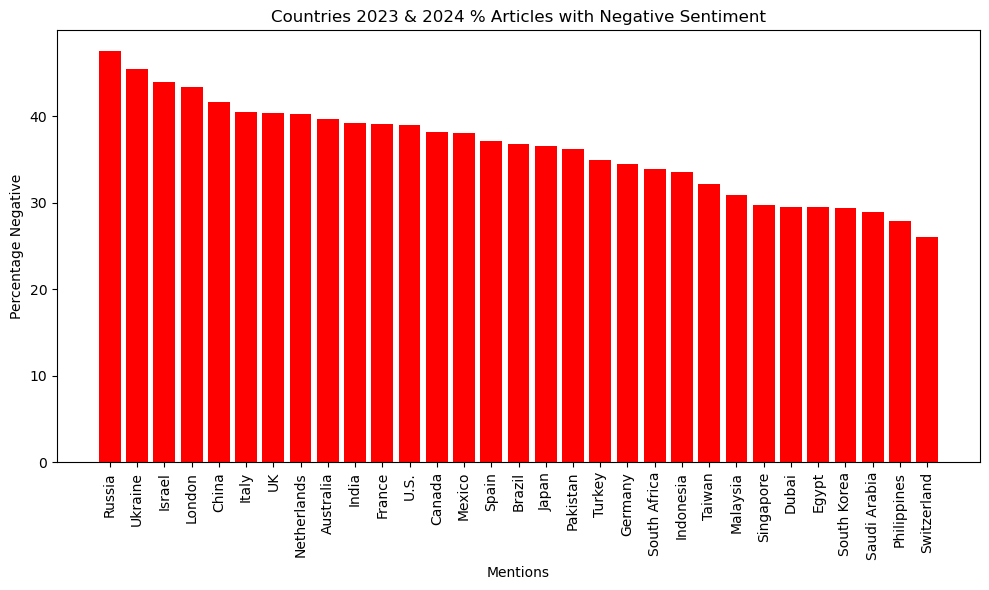

In [267]:
# Sort the DataFrame by percentage_negative column in descending order
sorted_df = mentions_sentiment_counts.sort_values(by='percentage_negative', ascending=False)

# Plot the sorted DataFrame
plt.figure(figsize=(10, 6))
plt.bar(sorted_df['mentions'], sorted_df['percentage_negative'], color='red')
plt.xlabel('Mentions')
plt.ylabel('Percentage Negative')
plt.title('Countries 2023 & 2024 % Articles with Negative Sentiment')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
plt.tight_layout()  # Adjust layout to prevent clipping of labels
plt.show()

## 1ST GPE

In [ ]:
filtered_df100_exploded_unique = filtered_df100_exploded[['url', 'year_quarter', 'sentiment', 'mentions']].drop_duplicates()


In [ ]:
lega_tech_df = filtered_df100_exploded_unique[filtered_df100_exploded_unique['mentions'] == 'Artificial Intelligence'][['year_quarter', 'mentions', 'sentiment']]


In [ ]:
# Assuming filtered_df1 is your DataFrame
pivot_df = lega_tech_df.pivot_table(index=['year_quarter'], columns='sentiment', aggfunc='size', fill_value=0).reset_index()


pivot_df['total'] = pivot_df['NEGATIVE'] + pivot_df['POSITIVE']
pivot_df['percentage_0'] = pivot_df['NEGATIVE'] / pivot_df['total'] * 100
pivot_df['percentage_1'] = pivot_df['POSITIVE'] / pivot_df['total'] * 100

# Convert 'year_month' column to datetime objects
pivot_df

In [ ]:

plt.figure(figsize=(10, 6))

# Plotting percentage_0
plt.plot(pivot_df['year_quarter'], pivot_df['percentage_0'], marker='o', label='Negative')

# Plotting percentage_1
plt.plot(pivot_df['year_quarter'], pivot_df['percentage_1'], marker='o', label='Positive')

plt.xlabel('Year Quarter')
plt.ylabel('Percentage')
plt.title('Percentage Trends Over Time')
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()

In [285]:
pd.set_option('display.max_colwidth', 500)

df_ner_spacy_wo_text_results[df_ner_spacy_wo_text_results['Entities'] == 'JavaScript']


## PRODUCT (PRODUCT)

In [370]:
df_ner_results_sel = df_ner_spacy_wo_text_results[['Entities', 'Labels']]
df_ner_results_sel = df_ner_results_sel[(df_ner_results_sel['Labels'] == 'PRODUCT')]

In [399]:
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'AIdriven']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'BureauInvestigate']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'PlayGet Weather']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'CoFounder']

df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'ReportFCC']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'Generative AI']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'AgencyFor']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'JerseyNew MexicoNew YorkNorth CarolinaNorth DakotaOhioOklahomaOregonPennsylvaniaRhode']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'Twitter']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'RepublicEast']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'HelpSupport']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'NewsPlugin']


df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'USCambodiaCameroonCanadaCape']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'Google Clouds']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'Midjourney']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'Plus']

df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'Windows 11']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'Shield AI']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'Inspection FileFCC Applicationspublicfile']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'AddEdit SymbolsCreate']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'MarketScape']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'ETShare']


df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'SE']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'Google']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'NewsNational']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'VerpackungenLogistik']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'RadarRadar']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'WSIRadar']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'LifestyleGray DC']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'PhotosGolden Apple AwardsBerks HeroesAdopt Lehigh Valley KidsFurry FriendsEmploymentBusinessBusiness']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'CareersClosed']



df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'RoadworkPump']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'MultimediaAll']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'CareersClosed']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'MissSouthern']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'PolicyJoin']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'SucheAd hocMitteilungen']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'Inspection FileFCC']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'UsAdvertise']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'AInative']


df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'Reddit']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'Coinbase']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'EnterpriseFor']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'Icertis']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'RSSGamesBeatGamesEsportsPC GamingFollowfollow']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'LLM']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'Amazons']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'Nvidia']

df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'CamsShop']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'Shield']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'Russellville RoadBowling Green']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'IdeasTechnicalsFrom']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'Aetina']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'LiveDownload']

df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'NewsBusiness']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'WeekStats']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'LevelsRoad']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'HistoryVolunteer CentralPower']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'ChampionsWeatherHeadlinesHurricane']


df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'ExpertsShop']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'Red ZoneStats']
df_ner_results_sel = df_ner_results_sel[df_ner_results_sel['Entities'] != 'LevelsRoad']


In [498]:
entities_counts = df_ner_results_sel.groupby('Entities').size().reset_index(name='Count')
top_10_entities = entities_counts.nlargest(28, 'Count')
top_10_entities = top_10_entities.head(9)
top_10_entities

,Entities,Count
14042,ChatGPT,61610
26591,Google Cloud,5122
51333,SaaS,2757
63442,Windows,2052
41339,NewsLocal,1777
51485,Salesforce,1620
21519,Excel,1402
24478,GPT3.5,1359
30507,JavaScript,1197


In [499]:
filtered_df100 = filtered_df1

# Extracting year and quarter information
filtered_df100['date'] = pd.to_datetime(filtered_df100['date'])

filtered_df100['year_quarter'] = filtered_df100['date'].dt.year.astype(str) + '-Q' + \
                                filtered_df100['date'].dt.quarter.astype(str)

# Display the DataFrame with the new column

filtered_df100

,url,date,title,text_clean,text_clean_2,ID,Key_Words,Total_Words,Key_Words_Percentage,new_column,sentiment,year_quarter,mentions
0,http://galusaustralis.com/2020/02/486473/legaltech-artificial-intelligence-market-2019-technology-advancement-and-future-scope-casetext-inc-catalyst-repository-systems-ebrevia/,2020-02-26,"LegalTech Artificial Intelligence Market 2019 Technology Advancement and Future Scope – Casetext Inc., Catalyst Repository Systems, eBREVIA – Galus Australis","LegalTech Artificial Intelligence Market 2019 Technology Advancement and Future Scope Casetext Inc., Catalyst Repository Systems, eBREVIA Galus Australis Galus AustralisBusinessGeneral NewsHealthcareIndustryInternationalLifestyleSciTechWednesday, February 26 2020TrendingNeedle Counters Market Comprehensive Study by Companies Medline Industries, Boen HealthcareSkin Scrub Trays Market Comprehensive Study by Companies Medline Industries, BD, DeroyalGlobal Portable Handheld Electronic Game Mac...",legaltech artificial intelligence market technology advancement future scope casetext inc catalyst repository systems ebrevia galus australis galus australisbusinessgeneral newshealthcareindustryinternationallifestylescitechwednesday february trendingneedle counters market comprehensive study companies medline industries boen healthcareskin scrub trays market comprehensive study companies medline industries bd deroyalglobal portable handheld electronic game machine market outlook business ...,0,1,20,5.000000,AI in Marketing,POSITIVE,2020-Q1,NaN
1,http://www.millenniumpost.in/big-stories/ai-express-aircraft-skids-off-runaway-in-kozhikode-rescue-ops-on-414926,2020-08-07,Two dead as AI Express flight skids off Kozhikode airport,Two dead as AI Express flight skids off Kozhikode airportTopLoginSubscribeToggle navigationFeaturesDelhiKolkataNationOpinionEditorialBusinessSportsSunday PostBeyond BygoneEpic PowerIn RetrospectGlobal EyeInlandRoutesBeaconInsightGame OnSafariTrendingCandid TalkGastronomyFact FilesMapping the states of IndiaXsundaypostbeyondbygonesundaypostepicpowerfactfilesiansfeedssundaypostinretrospectmappingthestatesofindiapujaspecialReminiscencesponsoredsundaypostglobaleyefeaturesnationworldtechnologySaf...,two dead ai express flight skids kozhikode airporttoploginsubscribetoggle navigationfeaturesdelhikolkatanationopinioneditorialbusinesssportssunday postbeyond bygoneepic powerin retrospectglobal eyeinlandroutesbeaconinsightgame onsafaritrendingcandid talkgastronomyfact filesmapping states indiaxsundaypostbeyondbygonesundaypostepicpowerfactfilesiansfeedssundaypostinretrospectmappingthestatesofindiapujaspecialreminiscencesponsoredsundaypostglobaleyefeaturesnationworldtechnologysafarisundayposte...,4,1,10,10.000000,AI in Weather Related Information or Services,NEGATIVE,2020-Q3,NaN
2,http://www.nativestew.com/2023/11/ai-took-my-job.html,2023-11-20,"Native Stew - Bahamas AI Art, Photos, Videos: AI Took My Job","Native Stew Bahamas AI Art, Photos, Videos: AI Took My JobPagesHomePeoplePlacesThingsMonday, November 20, 2023AI Took My Job AI Took My Job AI artA. Derek CatalanoatNovember 20, 2023Email ThisBlogThisShare to TwitterShare to FacebookShare to PinterestLabels:Art,PeopleNewer PostOlder PostHomeGo Fund MeMy daughterinlaw Gayle. Please help.TranslateAbout MeA. Derek CatalanoPhotos, videos and art featuring the people, places and things of The Bahamas. Ive traveled to many islands of The Bahamas...",native stew bahamas ai art photos videos ai took jobpageshomepeopleplacesthingsmonday november ai took job ai took job ai arta derek catalanoatnovember email thisblogthisshare twittershare facebookshare pinterestlabelsartpeoplenewer postolder posthomego fund memy daughterinlaw gayle please helptranslateabout mea derek catalanophotos videos art featuring people places things bahamas ive traveled many islands bahamas taking lots photos ive worked television many years experience video shooting...,5,2,12,16.666667,AI Applications and Technologies,POSITIVE,2023-Q4,NaN
3

In [500]:

# Create a regex pattern to match mentions of entities in 'text_clean_2'
pattern = '|'.join(top_10_entities['Entities'].map(re.escape))

# Extract mentions of entities from 'text_clean_2' using regex pattern
mentions = filtered_df100['text_clean'].str.extractall(f'({pattern})').groupby(level=0)[0].apply(list)


filtered_df100['mentions'] = mentions

In [501]:
# Explode the mentions to create separate rows for each mention
filtered_df100_exploded = filtered_df100.explode('mentions')

# Group by 'year_quarter' and 'mentions' and count the occurrences
result_df = filtered_df100_exploded.groupby(['year_quarter', 'mentions']).size().reset_index(name='count')
result_df

,year_quarter,mentions,count
0,2020-Q1,Excel,226
1,2020-Q1,Google Cloud,170
2,2020-Q1,JavaScript,71
3,2020-Q1,NewsLocal,156
4,2020-Q1,SaaS,91
...,...,...,...
126,2024-Q1,JavaScript,83
127,2024-Q1,NewsLocal,525
128,2024-Q1,SaaS,221
129,2024-Q1,Salesforce,216


In [502]:
# Sort the DataFrame by 'year_quarter' column in ascending order
result_df_sorted = result_df.sort_values(by='year_quarter')
# Sort the DataFrame by 'year_quarter' column in ascending order
result_df_sorted = result_df.sort_values(by='year_quarter')

result_df_sorted

,year_quarter,mentions,count
0,2020-Q1,Excel,226
1,2020-Q1,Google Cloud,170
2,2020-Q1,JavaScript,71
3,2020-Q1,NewsLocal,156
4,2020-Q1,SaaS,91
...,...,...,...
124,2024-Q1,GPT3.5,60
123,2024-Q1,Excel,310
122,2024-Q1,ChatGPT,8151
125,2024-Q1,Google Cloud,307


C:\Users\Jason Sjafrudin\AppData\Local\Temp\ipykernel_3352\336347496.py:1: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  result_df_sorted['year_quarter'] = pd.to_datetime(result_df_sorted['year_quarter'])


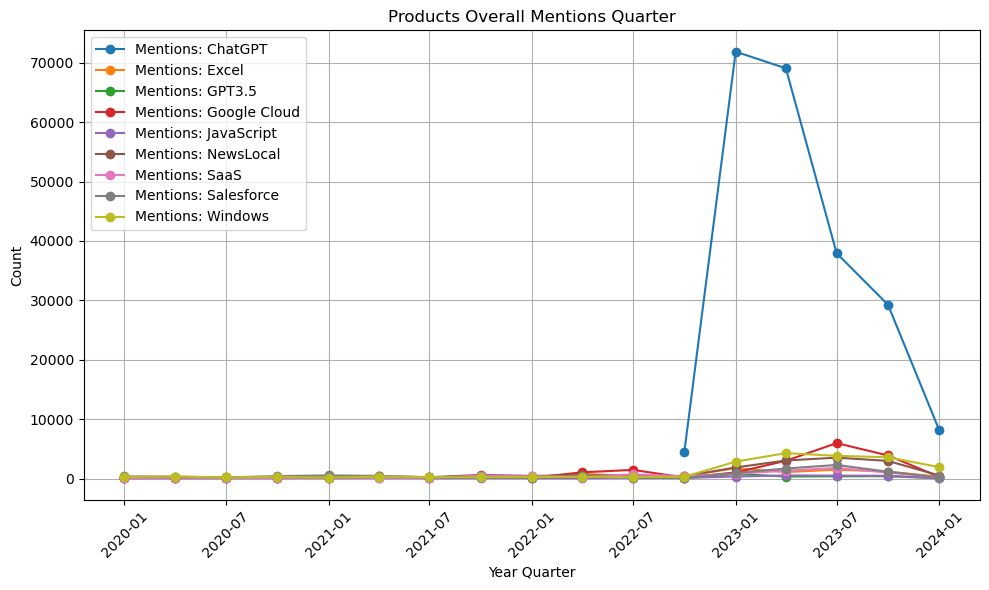

In [503]:
result_df_sorted['year_quarter'] = pd.to_datetime(result_df_sorted['year_quarter'])

# Sort DataFrame by year_quarter
result_df_sorted.sort_values(by='year_quarter', inplace=True)

# Plotting
plt.figure(figsize=(10, 6))

# Group by mentions and iterate over each group
for mention, group in result_df_sorted.groupby('mentions'):
    plt.plot(group['year_quarter'], group['count'], marker='o', label=f'Mentions: {mention}')

plt.title('Products Overall Mentions Quarter')
plt.xlabel('Year Quarter')
plt.ylabel('Count')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)  # Rotating x-axis labels for better readability

plt.tight_layout()
plt.show()

In [484]:
# Replace NaN values with an empty list
filtered_df100['mentions'] = filtered_df100['mentions'].apply(lambda x: [] if x is np.nan else x)

# Remove duplicates from each list
filtered_df100['mentions'] = filtered_df100['mentions'].apply(lambda x: list(set(x)))

# Explode the mentions to create separate rows for each mention
filtered_df100_exploded2 = filtered_df100.explode('mentions')


KeyboardInterrupt: 

In [470]:
# Group by 'mentions' column and count occurrences of 'POSITIVE' and 'NEGATIVE' sentiments
mentions_sentiment_counts = filtered_df100_exploded2.groupby(['mentions', 'sentiment']).size().unstack(fill_value=0)

# Reset index to make 'mentions' a column again
mentions_sentiment_counts.reset_index(inplace=True)

mentions_sentiment_counts['total'] = mentions_sentiment_counts['NEGATIVE'] + mentions_sentiment_counts['POSITIVE']
mentions_sentiment_counts['percentage_negative'] = mentions_sentiment_counts['NEGATIVE'] / mentions_sentiment_counts['total'] * 100
mentions_sentiment_counts['percentage_positive'] = mentions_sentiment_counts['POSITIVE'] / mentions_sentiment_counts['total'] * 100
mentions_sentiment_counts

sentiment,mentions,NEGATIVE,POSITIVE,total,percentage_negative,percentage_positive
0,ChatGPT,17981,20262,38243,47.017755,52.982245
1,Excel,1117,4653,5770,19.358752,80.641248
2,GPT3.5,409,733,1142,35.814361,64.185639
3,Google Cloud,608,3204,3812,15.949633,84.050367
4,JavaScript,942,1388,2330,40.429185,59.570815
5,NewsLocal,4003,9097,13100,30.557252,69.442748
6,SaaS,532,4475,5007,10.625125,89.374875
7,Salesforce,966,3500,4466,21.630094,78.369906
8,Windows,1577,3981,5558,28.373516,71.626484


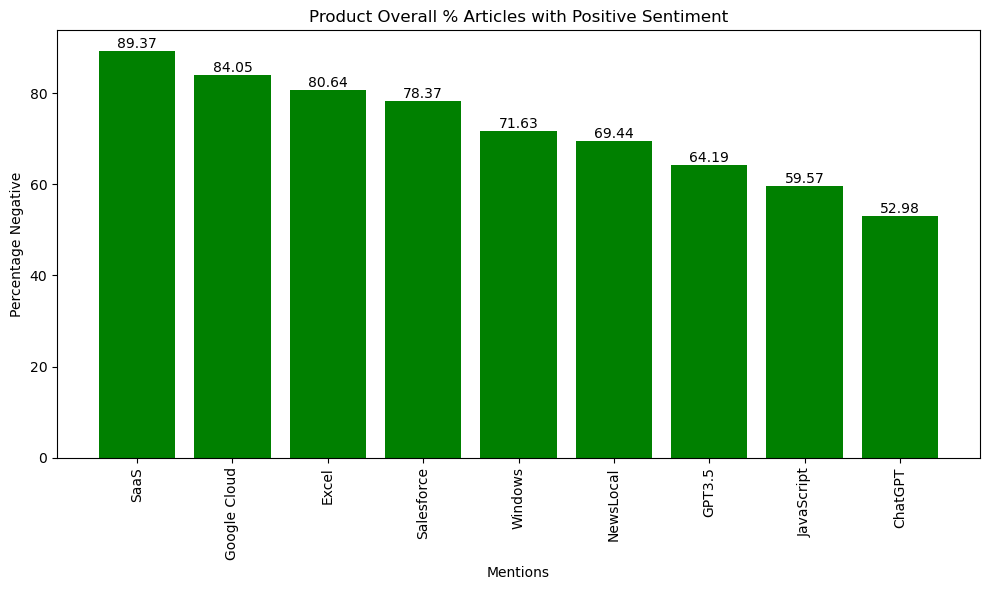

In [471]:
# Sort the DataFrame by percentage_negative column in descending order
sorted_df = mentions_sentiment_counts.sort_values(by='percentage_positive', ascending=False)

# Plot the sorted DataFrame
plt.figure(figsize=(10, 6))
bars = plt.bar(sorted_df['mentions'], sorted_df['percentage_positive'], color='green')
plt.xlabel('Mentions')
plt.ylabel('Percentage Negative')
plt.title('Product Overall % Articles with Positive Sentiment')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability

# Add labels to the bars
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, round(yval, 2), va='bottom', ha='center')

plt.tight_layout()  # Adjust layout to prevent clipping of labels
plt.show()

In [472]:
filtered_df100_exploded2['year'] = filtered_df100_exploded2['date'].dt.year
filtered_df100_exploded2 = filtered_df100_exploded2[filtered_df100_exploded2['year'].isin([2023, 2024])]


In [473]:
# Group by 'mentions' column and count occurrences of 'POSITIVE' and 'NEGATIVE' sentiments
mentions_sentiment_counts = filtered_df100_exploded2.groupby(['mentions', 'sentiment']).size().unstack(fill_value=0)

# Reset index to make 'mentions' a column again
mentions_sentiment_counts.reset_index(inplace=True)

mentions_sentiment_counts['total'] = mentions_sentiment_counts['NEGATIVE'] + mentions_sentiment_counts['POSITIVE']
mentions_sentiment_counts['percentage_negative'] = mentions_sentiment_counts['NEGATIVE'] / mentions_sentiment_counts['total'] * 100
mentions_sentiment_counts['percentage_positive'] = mentions_sentiment_counts['POSITIVE'] / mentions_sentiment_counts['total'] * 100
mentions_sentiment_counts

sentiment,mentions,NEGATIVE,POSITIVE,total,percentage_negative,percentage_positive
0,ChatGPT,17744,20052,37796,46.946767,53.053233
1,Excel,768,2640,3408,22.535211,77.464789
2,GPT3.5,394,717,1111,35.463546,64.536454
3,Google Cloud,367,2017,2384,15.394295,84.605705
4,JavaScript,578,786,1364,42.375367,57.624633
5,NewsLocal,3287,6900,10187,32.266614,67.733386
6,SaaS,270,2657,2927,9.224462,90.775538
7,Salesforce,747,1700,2447,30.527176,69.472824
8,Windows,1245,2842,4087,30.462442,69.537558


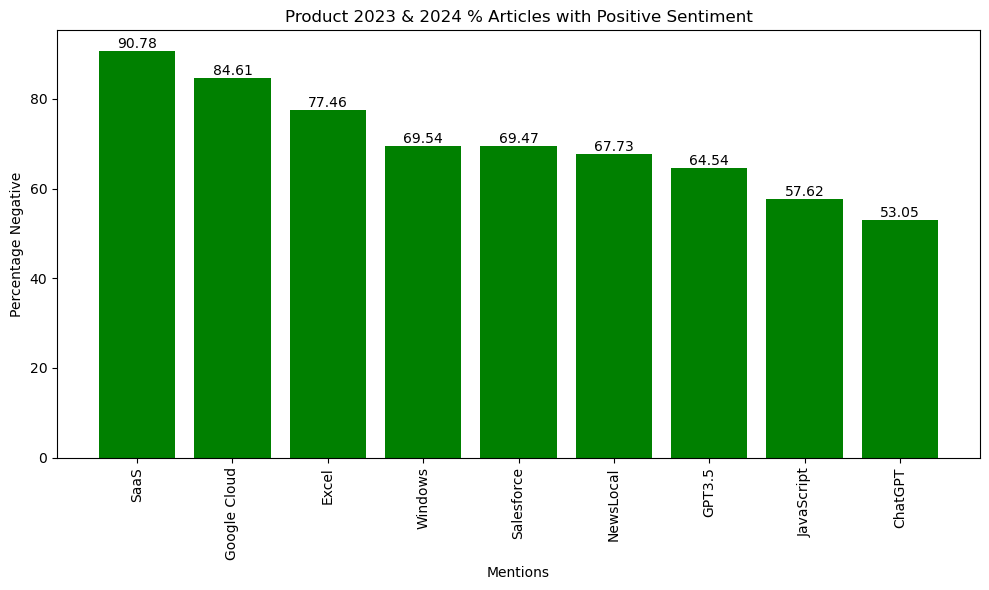

In [474]:
# Sort the DataFrame by percentage_negative column in descending order
sorted_df = mentions_sentiment_counts.sort_values(by='percentage_positive', ascending=False)

# Plot the sorted DataFrame
plt.figure(figsize=(10, 6))
bars = plt.bar(sorted_df['mentions'], sorted_df['percentage_positive'], color='green')
plt.xlabel('Mentions')
plt.ylabel('Percentage Negative')
plt.title('Product 2023 & 2024 % Articles with Positive Sentiment')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability

# Add labels to the bars
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, round(yval, 2), va='bottom', ha='center')

plt.tight_layout()  # Adjust layout to prevent clipping of labels
plt.show()

## 1st Product

In [ ]:
filtered_df100_exploded_unique = filtered_df100_exploded[['url', 'year_quarter', 'sentiment', 'mentions']].drop_duplicates()


In [ ]:
lega_tech_df = filtered_df100_exploded_unique[filtered_df100_exploded_unique['mentions'] == 'Artificial Intelligence'][['year_quarter', 'mentions', 'sentiment']]


In [ ]:
# Assuming filtered_df1 is your DataFrame
pivot_df = lega_tech_df.pivot_table(index=['year_quarter'], columns='sentiment', aggfunc='size', fill_value=0).reset_index()


pivot_df['total'] = pivot_df['NEGATIVE'] + pivot_df['POSITIVE']
pivot_df['percentage_0'] = pivot_df['NEGATIVE'] / pivot_df['total'] * 100
pivot_df['percentage_1'] = pivot_df['POSITIVE'] / pivot_df['total'] * 100

# Convert 'year_month' column to datetime objects
pivot_df

In [ ]:

plt.figure(figsize=(10, 6))

# Plotting percentage_0
plt.plot(pivot_df['year_quarter'], pivot_df['percentage_0'], marker='o', label='Negative')

# Plotting percentage_1
plt.plot(pivot_df['year_quarter'], pivot_df['percentage_1'], marker='o', label='Positive')

plt.xlabel('Year Quarter')
plt.ylabel('Percentage')
plt.title('Percentage Trends Over Time')
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()